<a href="https://colab.research.google.com/github/jcalandra/audiosynthesis_dl/blob/master/src/Pict2Audio_thickness.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Pict2Audio : A Neural Network that associates Pictures to Audio Descriptors

## Pict2Audio_thickness
This is the independant code for the thickness neural network. This code aims to test the efficiency of every possibilities of databases and architectures for this neural network.

**You will find the multilabel version at the following link :**
[https://colab.research.google.com/drive/1_ZTdR2CG_eekUUtqAG9Bqa7RixHL8v93](https://colab.research.google.com/drive/1_ZTdR2CG_eekUUtqAG9Bqa7RixHL8v93)

## Importation of the libraries

First, we need to import all the package and libraries necessary to run the code.

The backend Tensorflow is used with the library Keras to implement the neural network.

In [0]:
from __future__ import print_function
import os
from PIL import Image

import numpy as np
import random

import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, BatchNormalization,Dropout, Conv2D, MaxPooling2D, Flatten
from keras.optimizers import RMSprop
from keras.preprocessing import image
from keras import callbacks
print('tensorflow:', tf.__version__)
print('keras:', keras.__version__)

tensorflow: 1.13.1
keras: 2.2.4


Using TensorFlow backend.



## Importation of the Dataset :

the dataset is imported from github, using the repository audiosynthesis_dl. In this repository, you can also find documentation about sound synthesis using Neural Networks.

In [0]:
# First, import git repository
! git clone https://github.com/jcalandra/audiosynthesis_dl.git


Cloning into 'audiosynthesis_dl'...
remote: Enumerating objects: 290, done.
remote: Counting objects: 100% (290/290), done.
remote: Compressing objects: 100% (275/275), done.
remote: Total 629 (delta 21), reused 266 (delta 10), pack-reused 339
Receiving objects: 100% (629/629), 9.72 MiB | 46.94 MiB/s, done.
Resolving deltas: 100% (92/92), done.


Then, run the following script in the same environment :

https://colab.research.google.com/drive/1lJELWVC4DmQSNOw0fat4KrzTo_GmVbpZ

To avoid downloading a heavy set of data on the computer, I chose to generate the pictures directly and load them from google colab

In [0]:
import cv2
from google.colab.patches import cv2_imshow
from google.colab import files

In [0]:
## GLOBAL VALUES

NB_PITCH = 12
NB_THICK = 3
NB_COLOR = 8
NB_CLASS = NB_THICK
PICT_WIDTH = 400
NB_CHANNEL = 3
LINE_WIDTH = PICT_WIDTH//NB_PITCH #33

NB_CARACTERISTICS = 1

# number of versions for a same pitch
NB_VERSION_TRAIN = 2
NB_VERSION_VALIDATION = 1

# number of trained and validation pictures
NB_TRAIN = NB_VERSION_TRAIN*NB_THICK*NB_COLOR*NB_PITCH
NB_VALIDATION = NB_VERSION_VALIDATION*NB_THICK*NB_COLOR*NB_PITCH

In [0]:
## LOADING THE BASELINE

baseline = cv2.imread('audiosynthesis_dl/data/base_quadrillage.png')
#cv2_imshow(baseline)

In [0]:
## PICTURE GENERATION

# generating exactly the same path line for every color, pitch and thickness

def generate_pict(nb_version_pict, folder, outline_value, pic_type): # pic_type = [PITCH, THICK, COLOR] with 0 if no, 1 if yes
  """ creates nb_pictures of pitch-lines and saves them permanently in the folder img_'folder'.
      Folder has to be a string and nb_pict is an integer."""
  
  # default values if pitches, thicknesses and/or colors don't change
  height = (3%NB_PITCH)*LINE_WIDTH + (LINE_WIDTH + 5)//2
  thickness = 6
  sat = hue = val = 0
  # default indices
  pitch_ind = 0
  thick_ind = 0
  color_ind = 0
  
  # beginning value for thickness if there is a variation of thickness
  if (pic_type[1] == 1):
    thickness = 12
  # tab of color values if there is a variation of colors
  hueval_tab = [[(i*180)/(NB_COLOR//2), 90] for i in range(NB_COLOR//2)] + [[(i*180)/(NB_COLOR//2), 210] for i in range(NB_COLOR//2)]
  #tab of available thicknesses if there is a variotion of thicknesses
  thickness_tab = [2,7,12]
  global_line_path = np.empty((PICT_WIDTH),dtype=int)
  
  for i in range (nb_version_pict) :
    
    # generation of lines path :   
    outline = outline_value 
    delta = (LINE_WIDTH - (thickness*2))//2 + outline    
    variation = np.random.randint(0,delta - outline)   # the line begin at a random point in delta
    intervalle_max = np.random.randint(2,50)           # interval allowed to keep the same height between each variation
    
    for l in range(PICT_WIDTH):
      intervalle = np.random.randint(1,intervalle_max) # to avoid a sharp variation, we keep the same variation height for each 'intervalle'
      if (l%intervalle == 0) :                         # if we want to change the height of the line
        tmp_var = np.random.randint(-1, 2)             # each variation is an increase or a decrease of 1 (or same height)
        if abs(variation + tmp_var) < delta :
          variation = variation + tmp_var
        else :
          variation = variation             
      global_line_path[l] = PICT_WIDTH + variation
    
    # pitch affiliation :    
    for p in range(NB_PITCH):
      if (pic_type[0] == 1 ):
        pitch_ind = 69 + p #69 is pitch for la440
        height = p*LINE_WIDTH + (LINE_WIDTH + 5)//2       
      line_path = global_line_path - height - 1

      
      # generation of the pictures. There are nb_version_pict*NB_COLOR*NB_PITCH pictures :
      for m in range(NB_COLOR):  
        
        # creation of the baseline, quadrilled picture :       
        line_image_rgb = baseline.copy()

                
        # color affiliation :
        line_image_hsv = cv2.cvtColor(line_image_rgb, cv2.COLOR_RGB2HSV)
        h, s, v = cv2.split(line_image_hsv)
      
        if( pic_type[2] == 1):
          color_ind = m
          color = hueval_tab[color_ind]
          sat = 150
          hue = color[0]
          val = color[1]
          
        #thickness affiliation :
        for t in range(NB_THICK): 
          thick_ind = t
          thickness = thickness_tab[thick_ind]

          for j in range(PICT_WIDTH):

            # creation of the line :
            if( line_path[j] > 0 and line_path[j] < 400 ) :
              h[line_path[j]][PICT_WIDTH - j - 1] = hue      
              s[line_path[j]][PICT_WIDTH - j - 1] = sat 
              v[line_path[j]][PICT_WIDTH - j - 1] = val 

            # and its thickness :
            for k in range (thickness) :
              if( line_path[j] - k > 0 and line_path[j] - k < 400 ) :
                h[line_path[j] - k][PICT_WIDTH - j - 1] = hue 
                s[line_path[j] - k][PICT_WIDTH - j - 1] = sat
                v[line_path[j] - k][PICT_WIDTH - j - 1] = val

              if( line_path[j] + k > 0 and line_path[j] + k < 400 ) :
                h[line_path[j] + k][PICT_WIDTH - j - 1] = hue
                s[line_path[j] + k][PICT_WIDTH - j - 1] = sat
                v[line_path[j] + k][PICT_WIDTH - j - 1] = val

          line_image_hsv = cv2.merge((h,s,v))
          line_image = cv2.cvtColor(line_image_hsv, cv2.COLOR_HSV2RGB)


          cv2_imshow(line_image) #showing the images for tests
          name = 'pitch'+str(pitch_ind)+ '_thick' + str(thick_ind) + '_color' + str(color_ind) +'_'+str(i) + '_'+folder+'.png'
          print(name)

          # save the picture in google colab :
          cv2.imwrite('./audiosynthesis_dl/data/pitch_img/img_'+folder+'/'+ name, line_image)


[INFO] generating training dataset...


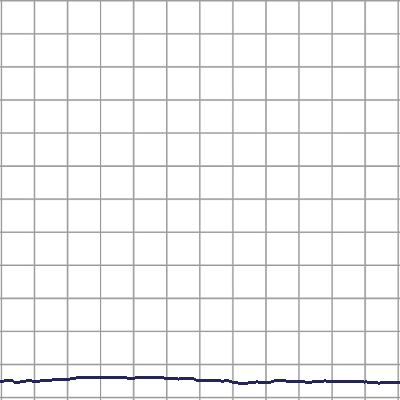

pitch69_thick0_color0_0_train.png


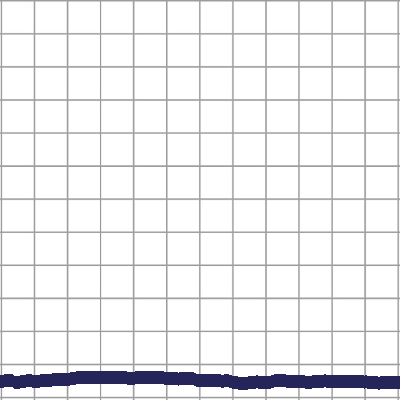

pitch69_thick1_color0_0_train.png


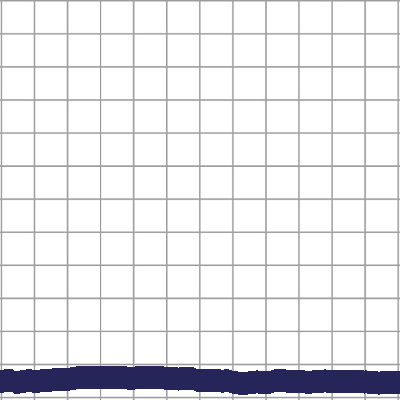

pitch69_thick2_color0_0_train.png


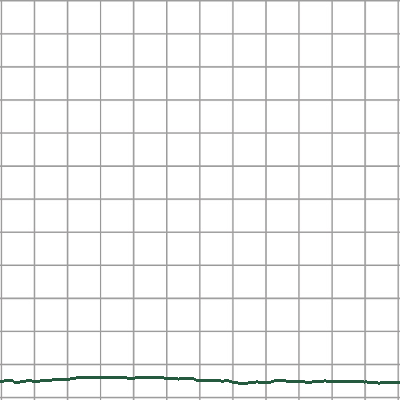

pitch69_thick0_color1_0_train.png


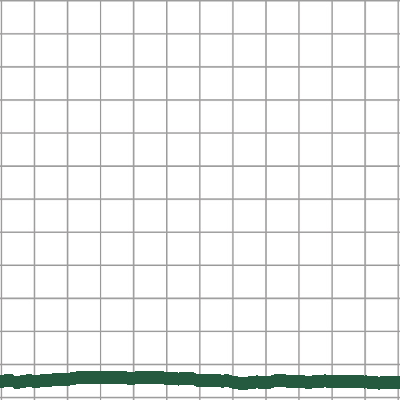

pitch69_thick1_color1_0_train.png


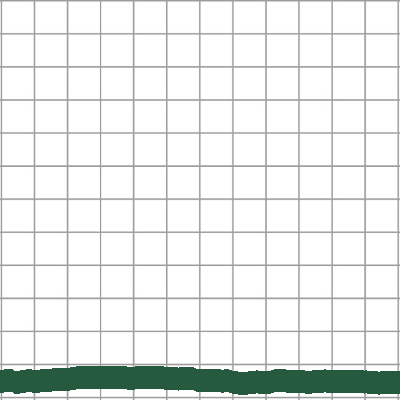

pitch69_thick2_color1_0_train.png


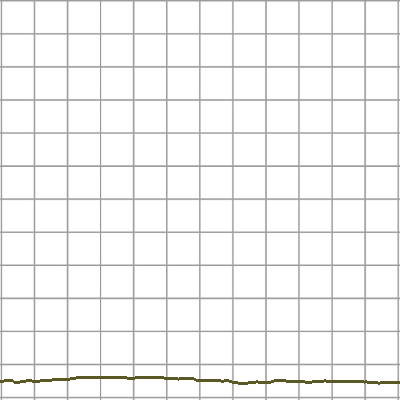

pitch69_thick0_color2_0_train.png


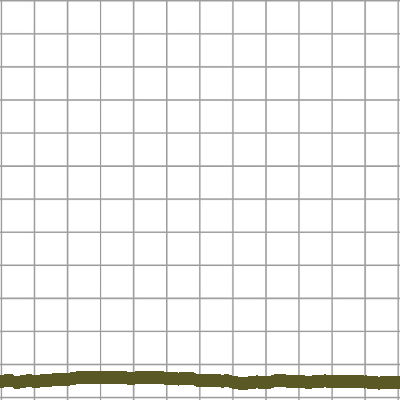

pitch69_thick1_color2_0_train.png


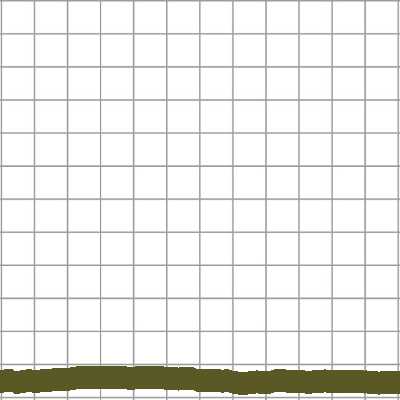

pitch69_thick2_color2_0_train.png


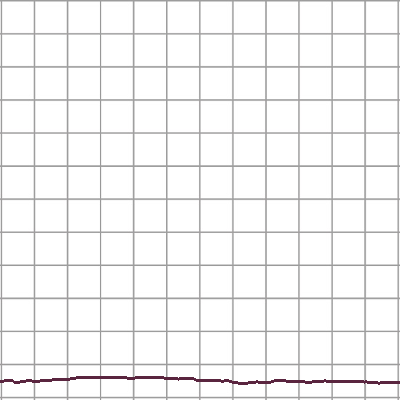

pitch69_thick0_color3_0_train.png


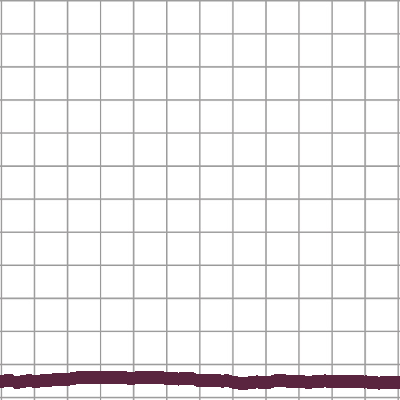

pitch69_thick1_color3_0_train.png


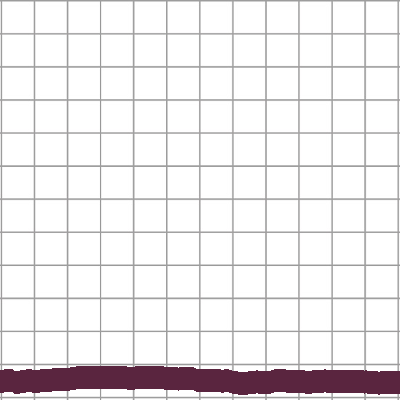

pitch69_thick2_color3_0_train.png


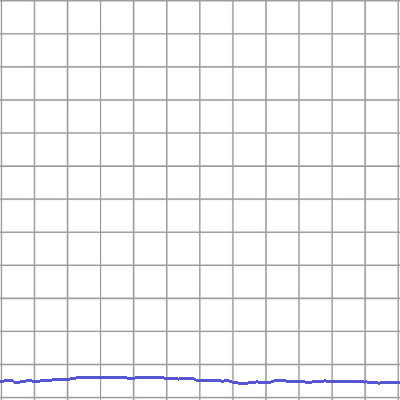

pitch69_thick0_color4_0_train.png


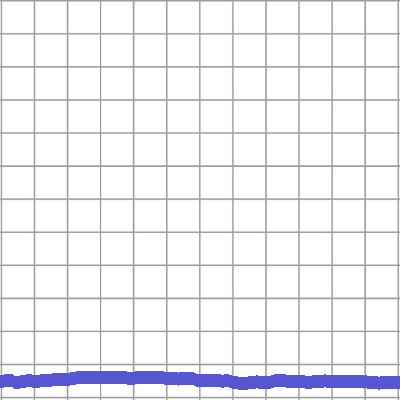

pitch69_thick1_color4_0_train.png


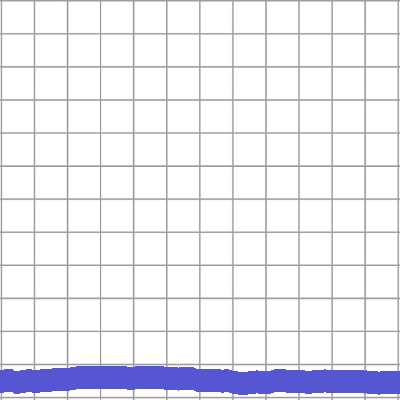

pitch69_thick2_color4_0_train.png


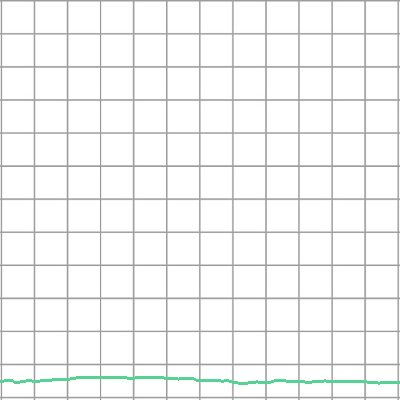

pitch69_thick0_color5_0_train.png


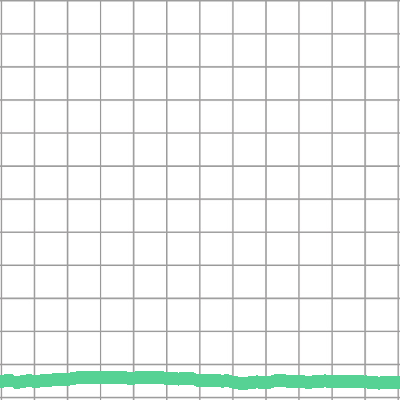

pitch69_thick1_color5_0_train.png


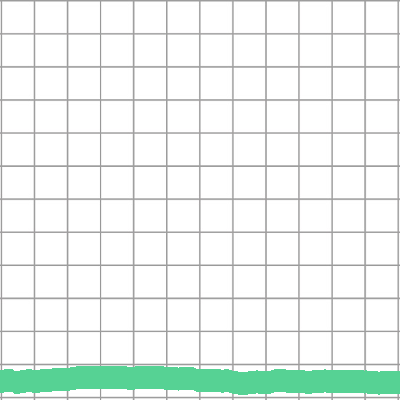

pitch69_thick2_color5_0_train.png


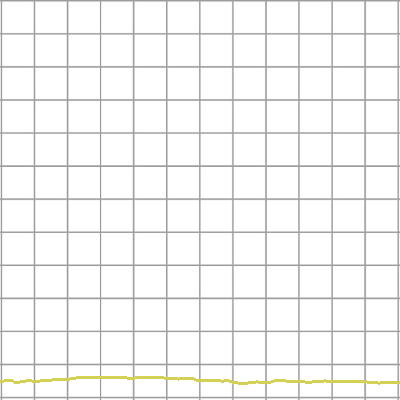

pitch69_thick0_color6_0_train.png


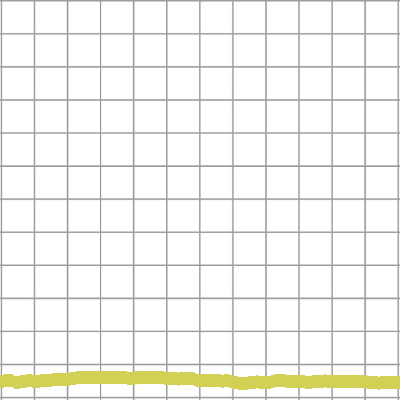

pitch69_thick1_color6_0_train.png


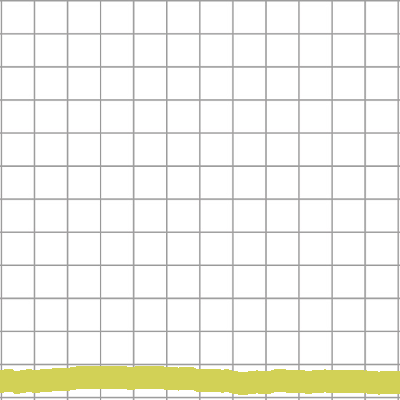

pitch69_thick2_color6_0_train.png


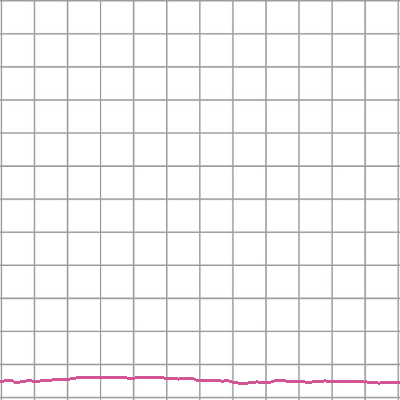

pitch69_thick0_color7_0_train.png


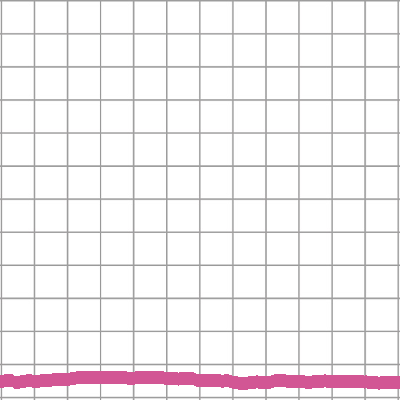

pitch69_thick1_color7_0_train.png


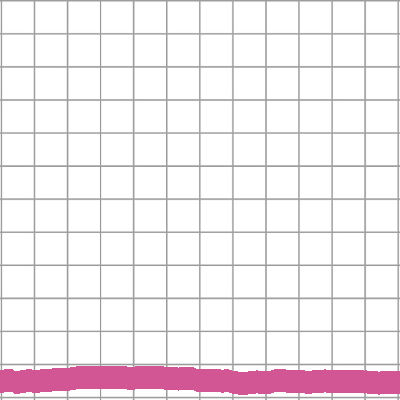

pitch69_thick2_color7_0_train.png


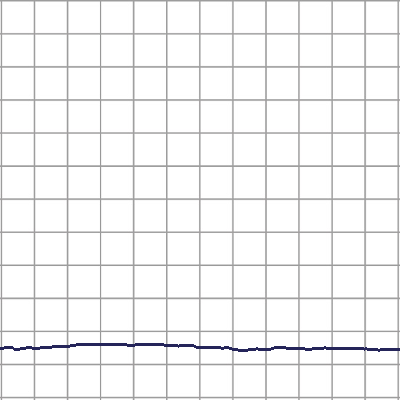

pitch70_thick0_color0_0_train.png


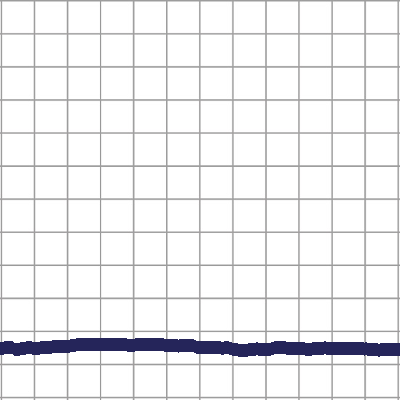

pitch70_thick1_color0_0_train.png


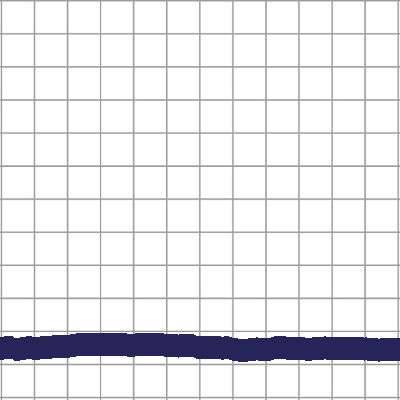

pitch70_thick2_color0_0_train.png


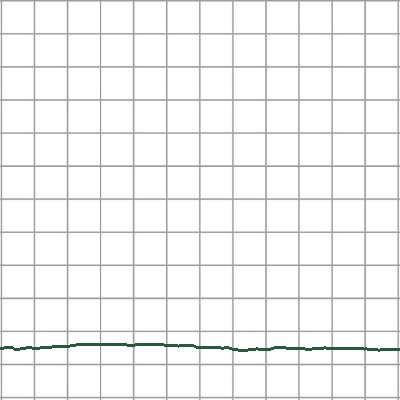

pitch70_thick0_color1_0_train.png


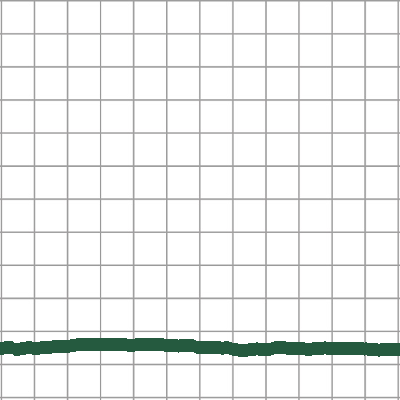

pitch70_thick1_color1_0_train.png


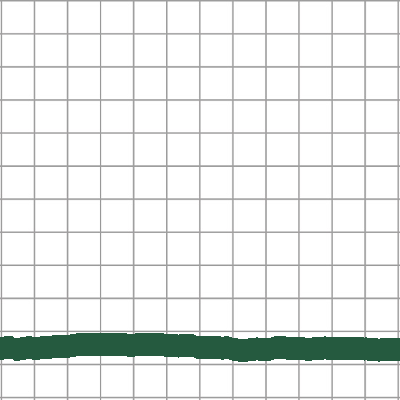

pitch70_thick2_color1_0_train.png


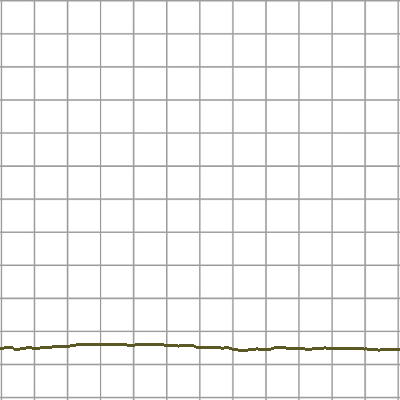

pitch70_thick0_color2_0_train.png


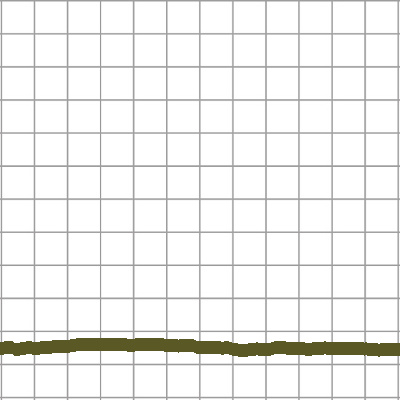

pitch70_thick1_color2_0_train.png


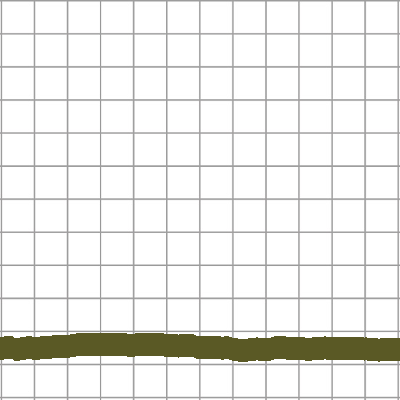

pitch70_thick2_color2_0_train.png


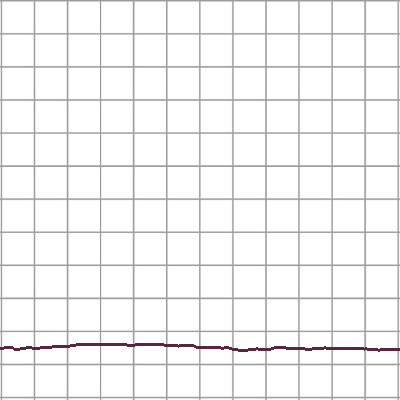

pitch70_thick0_color3_0_train.png


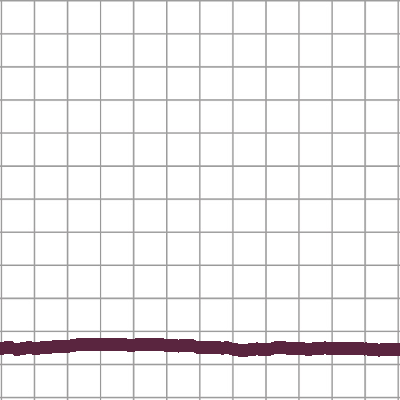

pitch70_thick1_color3_0_train.png


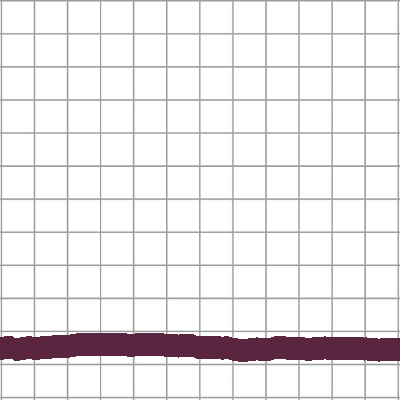

pitch70_thick2_color3_0_train.png


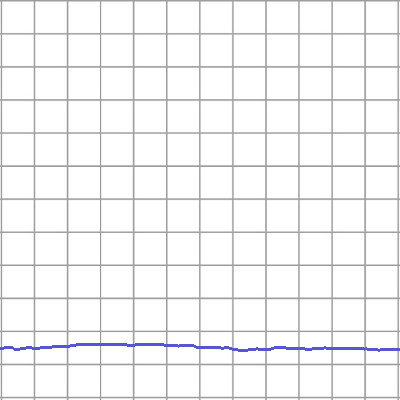

pitch70_thick0_color4_0_train.png


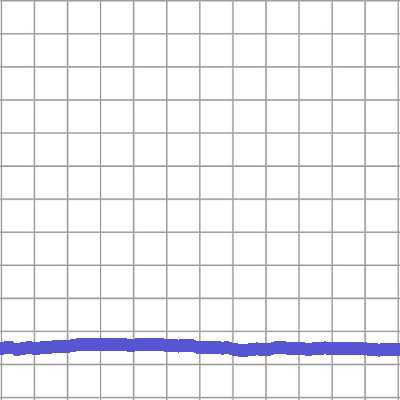

pitch70_thick1_color4_0_train.png


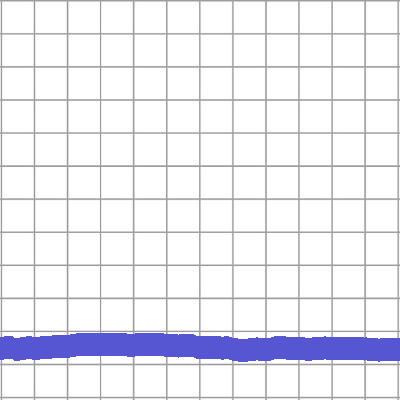

pitch70_thick2_color4_0_train.png


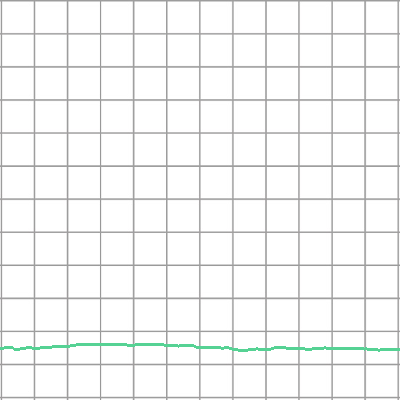

pitch70_thick0_color5_0_train.png


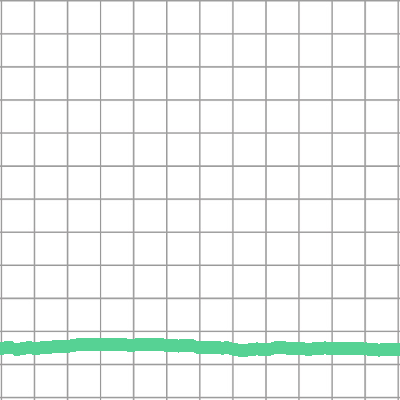

pitch70_thick1_color5_0_train.png


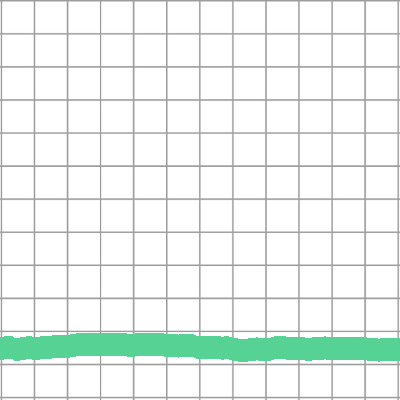

pitch70_thick2_color5_0_train.png


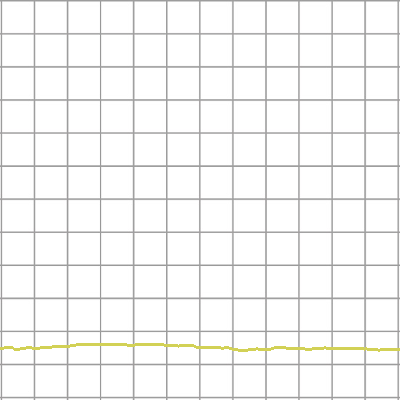

pitch70_thick0_color6_0_train.png


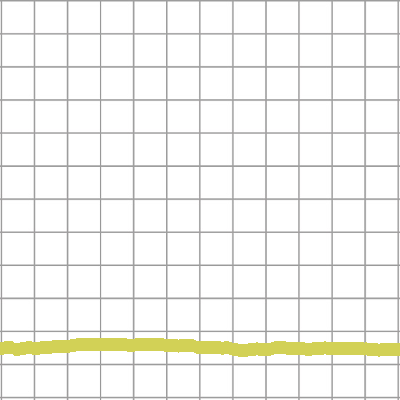

pitch70_thick1_color6_0_train.png


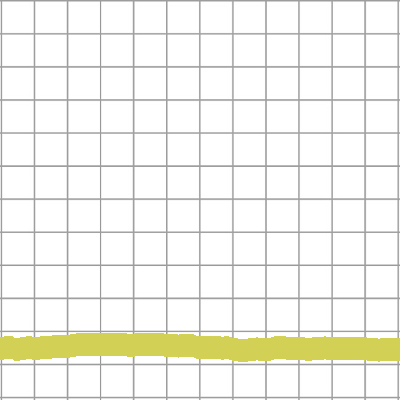

pitch70_thick2_color6_0_train.png


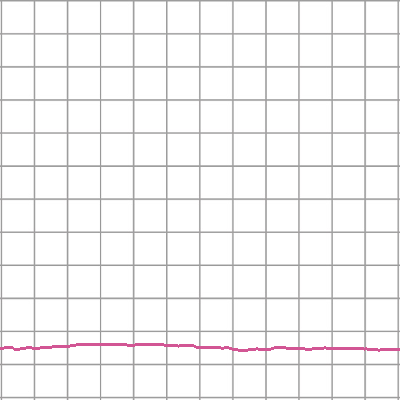

pitch70_thick0_color7_0_train.png


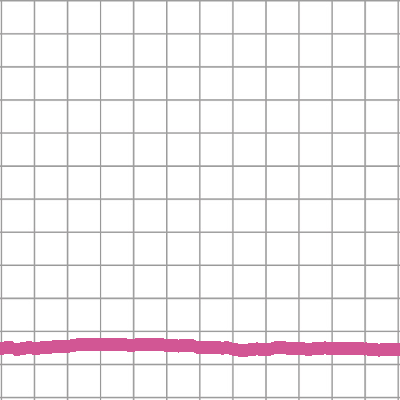

pitch70_thick1_color7_0_train.png


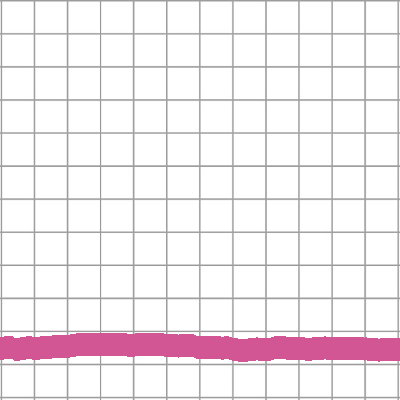

pitch70_thick2_color7_0_train.png


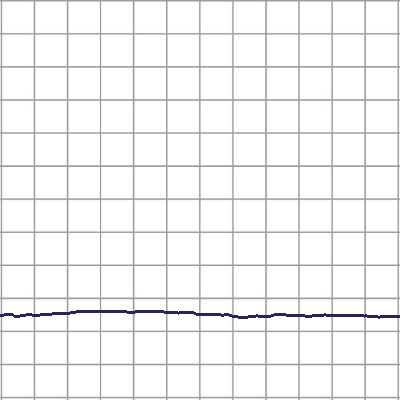

pitch71_thick0_color0_0_train.png


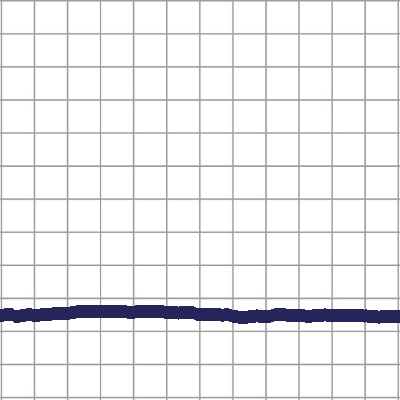

pitch71_thick1_color0_0_train.png


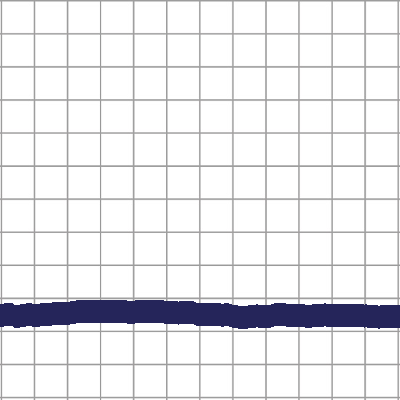

pitch71_thick2_color0_0_train.png


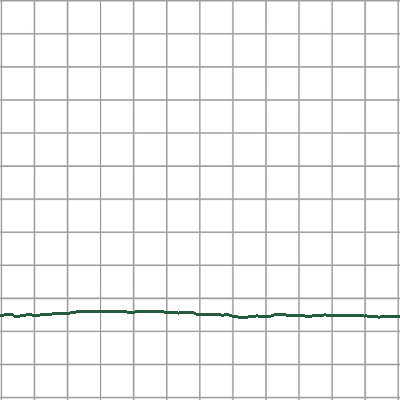

pitch71_thick0_color1_0_train.png


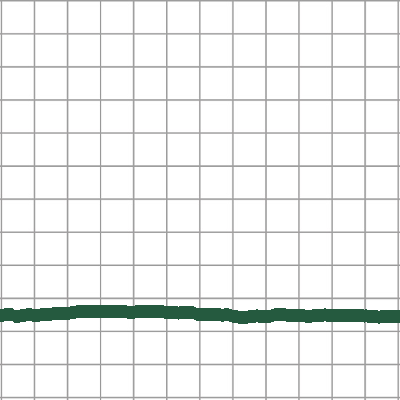

pitch71_thick1_color1_0_train.png


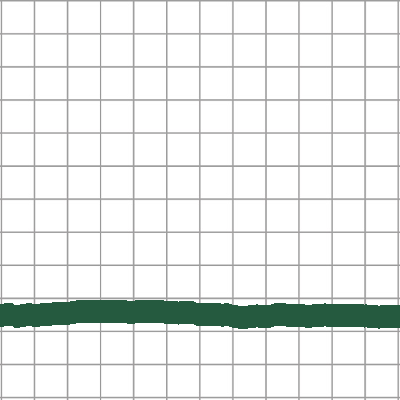

pitch71_thick2_color1_0_train.png


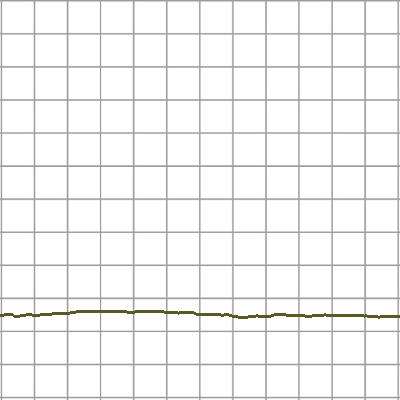

pitch71_thick0_color2_0_train.png


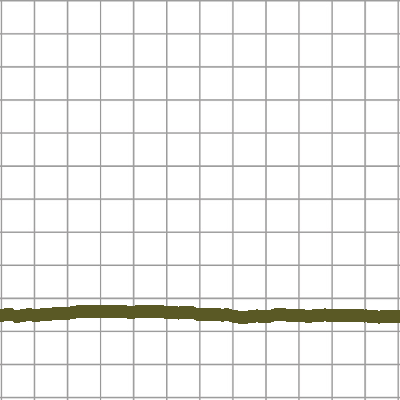

pitch71_thick1_color2_0_train.png


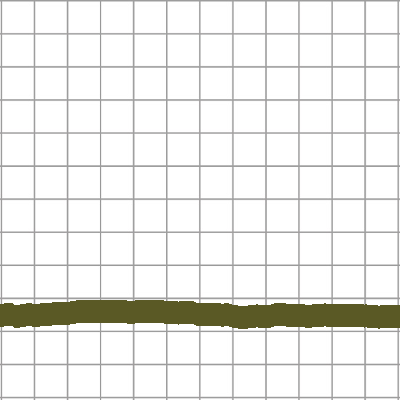

pitch71_thick2_color2_0_train.png


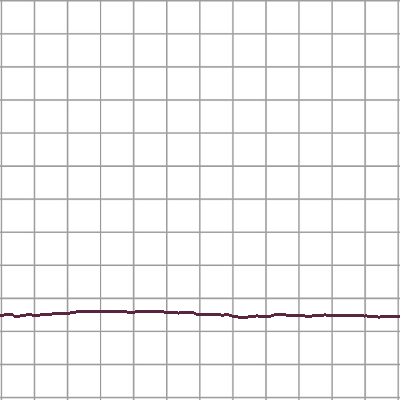

pitch71_thick0_color3_0_train.png


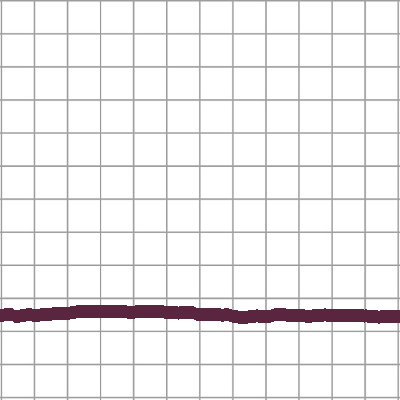

pitch71_thick1_color3_0_train.png


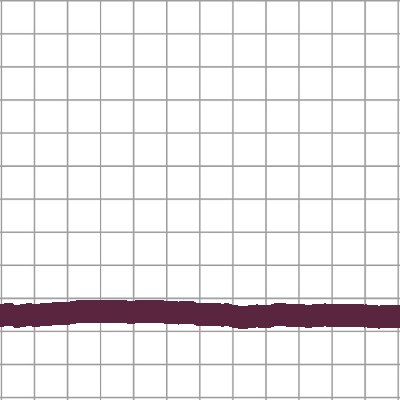

pitch71_thick2_color3_0_train.png


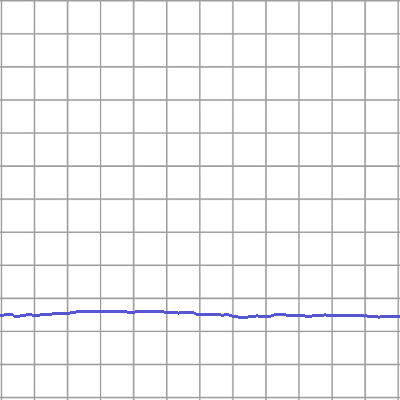

pitch71_thick0_color4_0_train.png


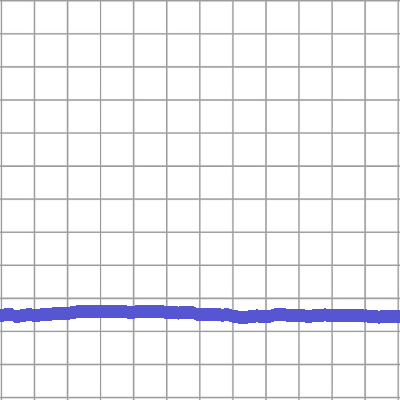

pitch71_thick1_color4_0_train.png


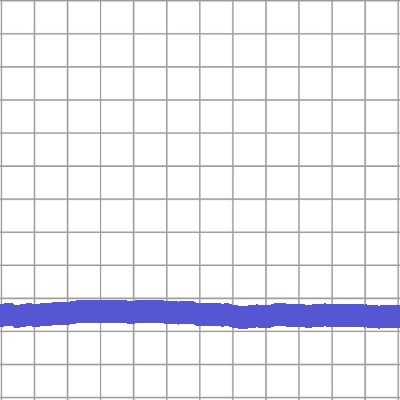

pitch71_thick2_color4_0_train.png


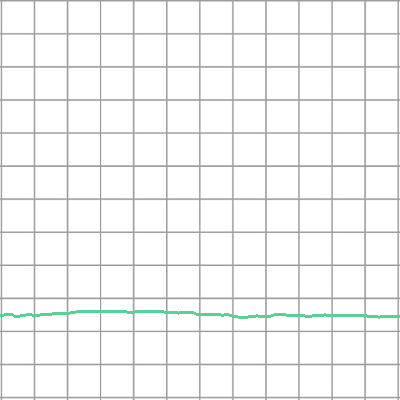

pitch71_thick0_color5_0_train.png


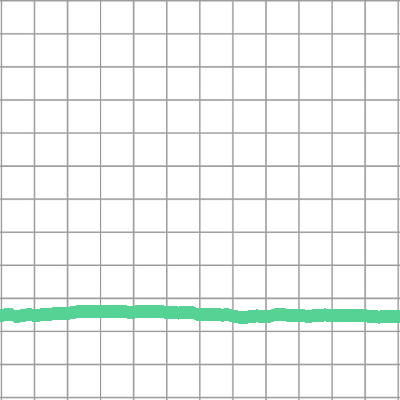

pitch71_thick1_color5_0_train.png


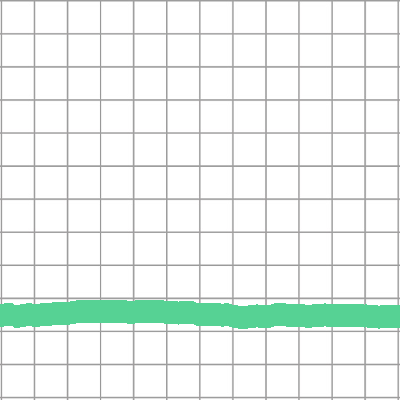

pitch71_thick2_color5_0_train.png


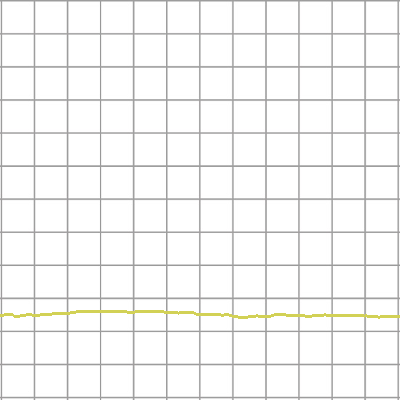

pitch71_thick0_color6_0_train.png


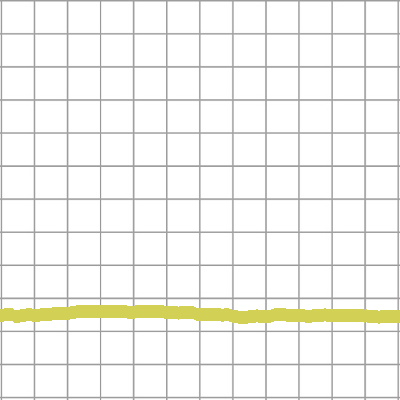

pitch71_thick1_color6_0_train.png


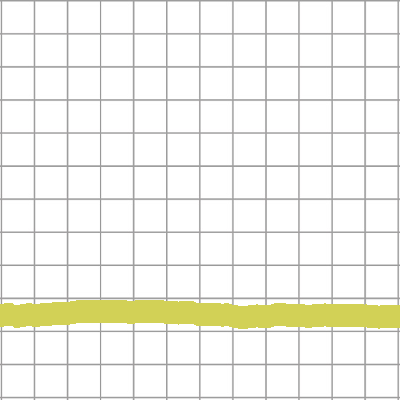

pitch71_thick2_color6_0_train.png


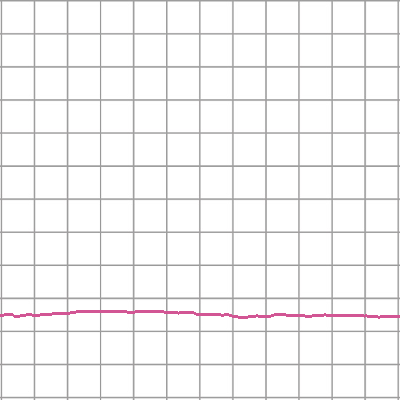

pitch71_thick0_color7_0_train.png


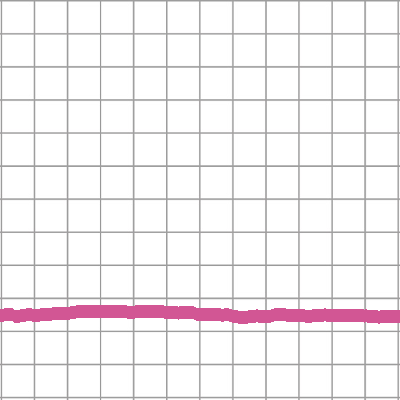

pitch71_thick1_color7_0_train.png


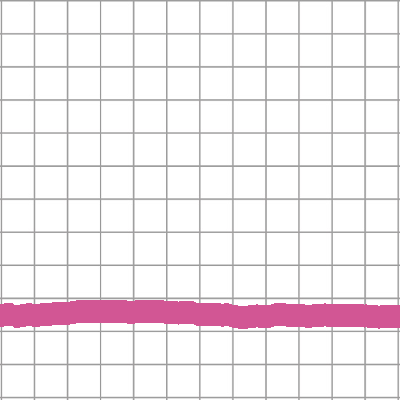

pitch71_thick2_color7_0_train.png


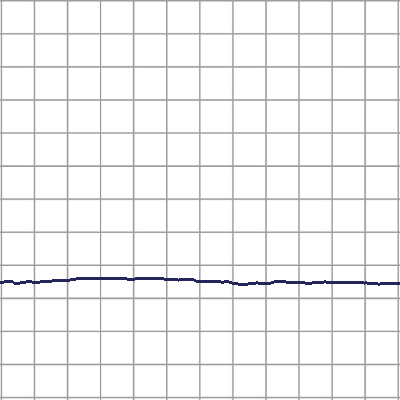

pitch72_thick0_color0_0_train.png


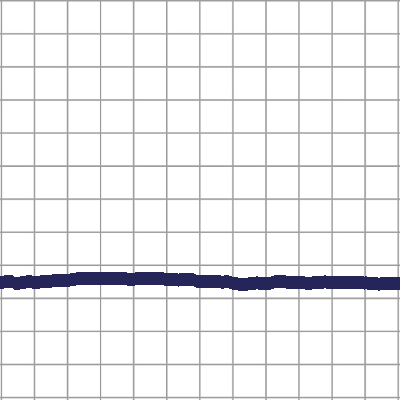

pitch72_thick1_color0_0_train.png


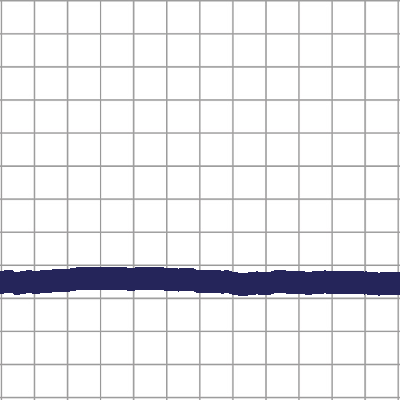

pitch72_thick2_color0_0_train.png


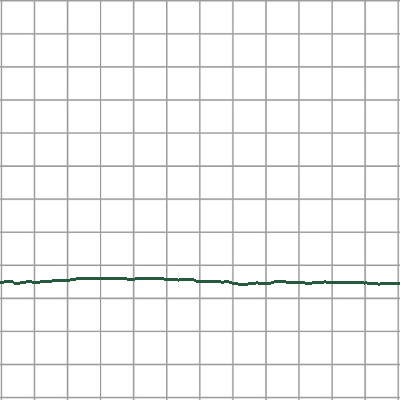

pitch72_thick0_color1_0_train.png


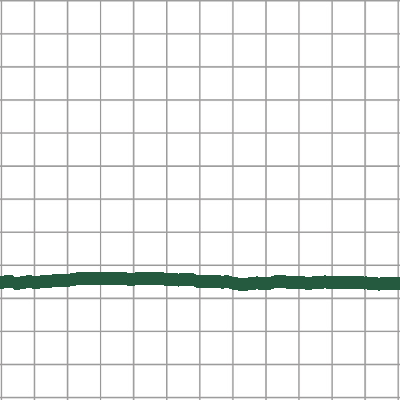

pitch72_thick1_color1_0_train.png


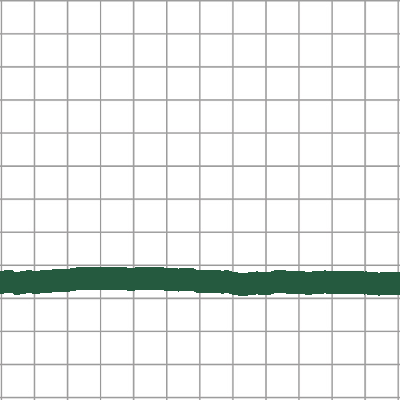

pitch72_thick2_color1_0_train.png


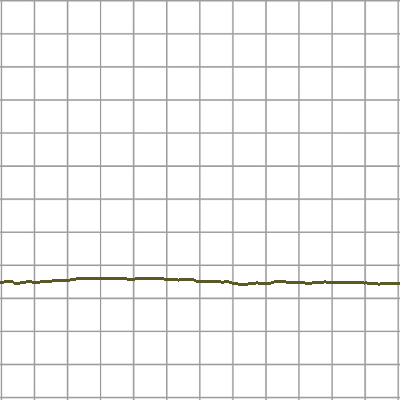

pitch72_thick0_color2_0_train.png


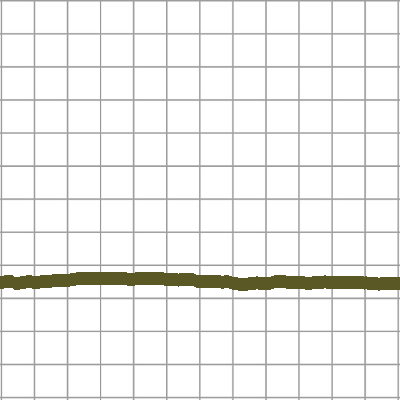

pitch72_thick1_color2_0_train.png


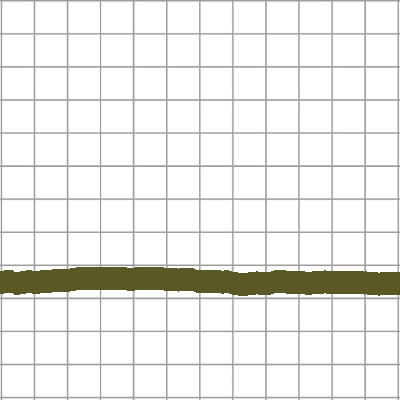

pitch72_thick2_color2_0_train.png


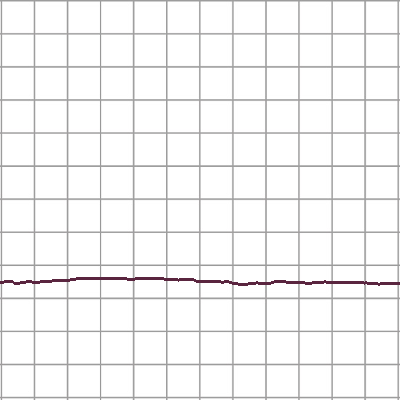

pitch72_thick0_color3_0_train.png


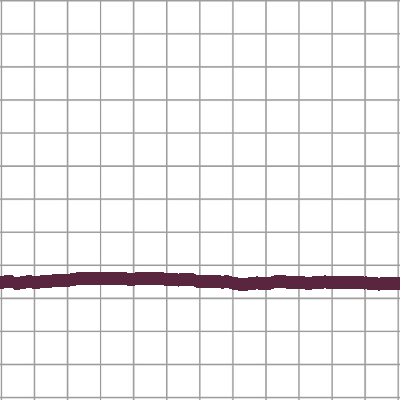

pitch72_thick1_color3_0_train.png


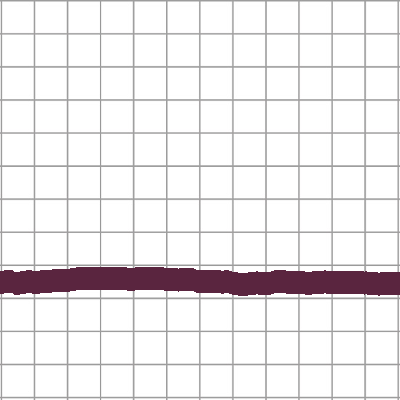

pitch72_thick2_color3_0_train.png


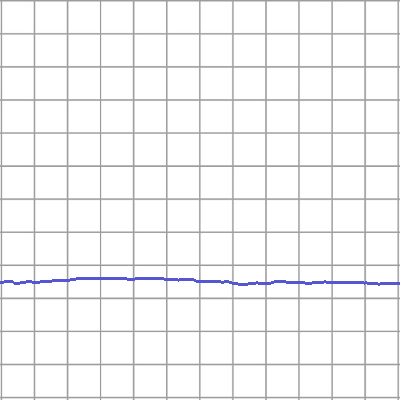

pitch72_thick0_color4_0_train.png


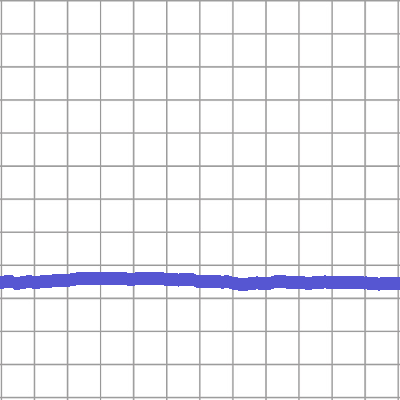

pitch72_thick1_color4_0_train.png


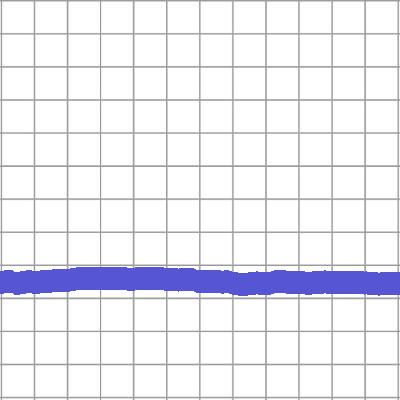

pitch72_thick2_color4_0_train.png


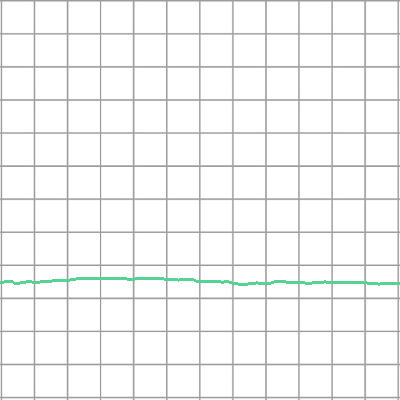

pitch72_thick0_color5_0_train.png


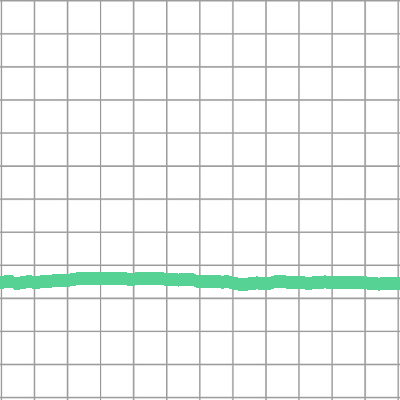

pitch72_thick1_color5_0_train.png


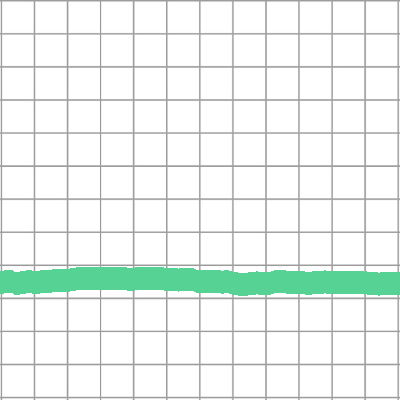

pitch72_thick2_color5_0_train.png


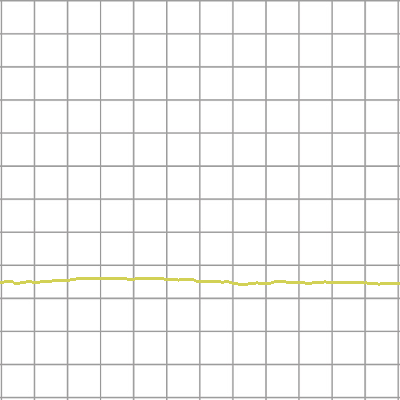

pitch72_thick0_color6_0_train.png


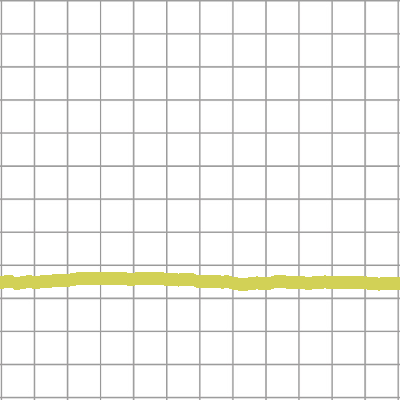

pitch72_thick1_color6_0_train.png


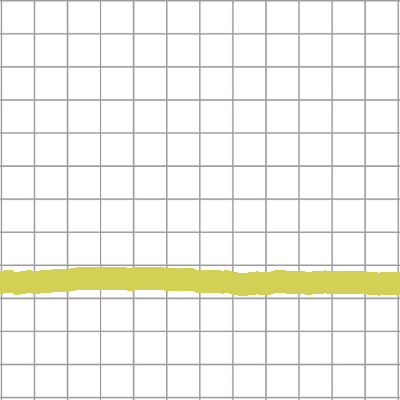

pitch72_thick2_color6_0_train.png


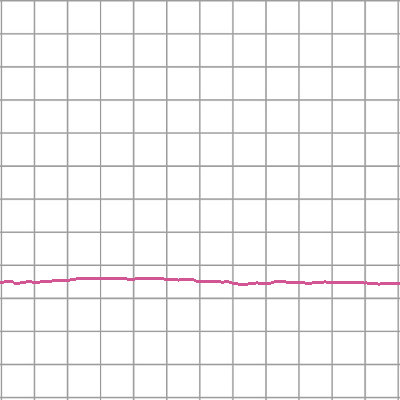

pitch72_thick0_color7_0_train.png


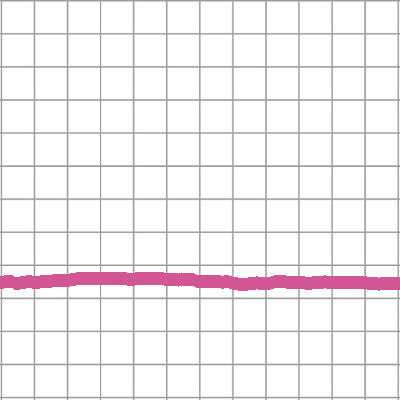

pitch72_thick1_color7_0_train.png


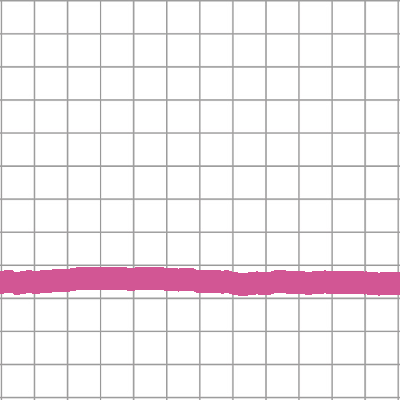

pitch72_thick2_color7_0_train.png


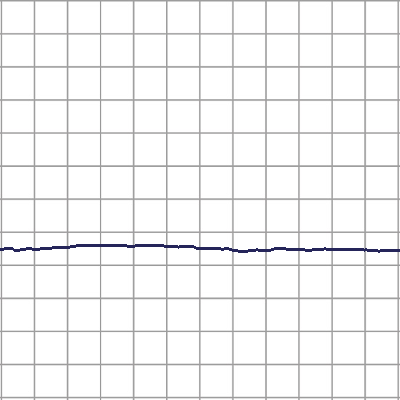

pitch73_thick0_color0_0_train.png


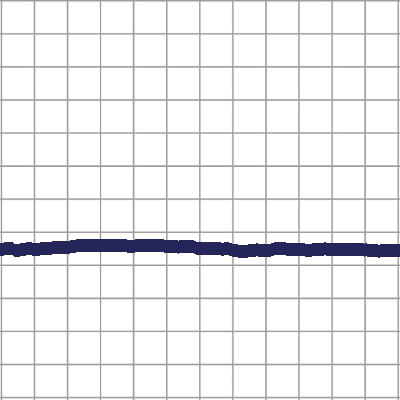

pitch73_thick1_color0_0_train.png


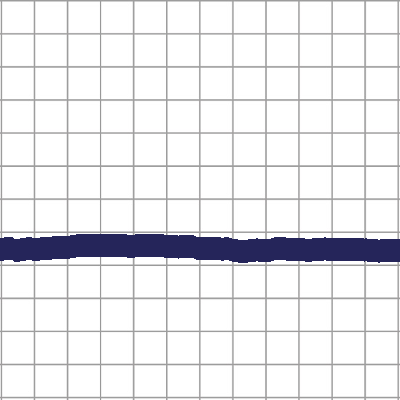

pitch73_thick2_color0_0_train.png


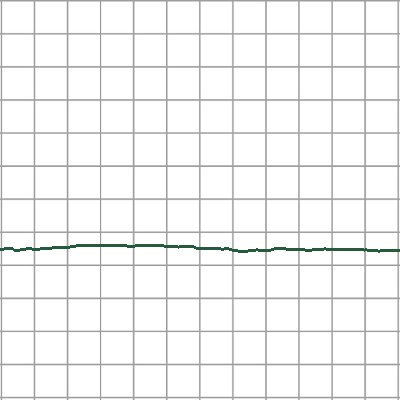

pitch73_thick0_color1_0_train.png


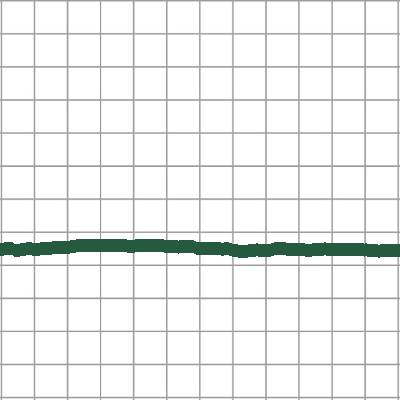

pitch73_thick1_color1_0_train.png


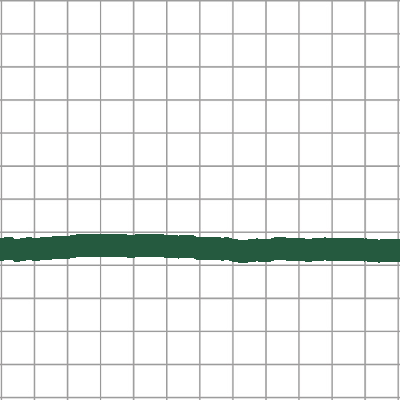

pitch73_thick2_color1_0_train.png


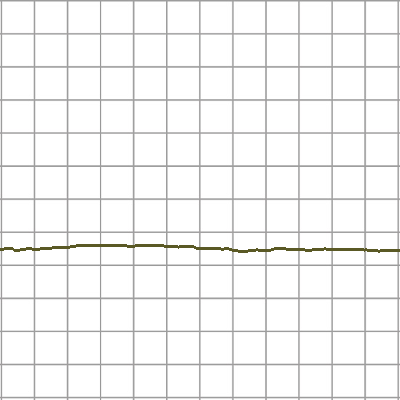

pitch73_thick0_color2_0_train.png


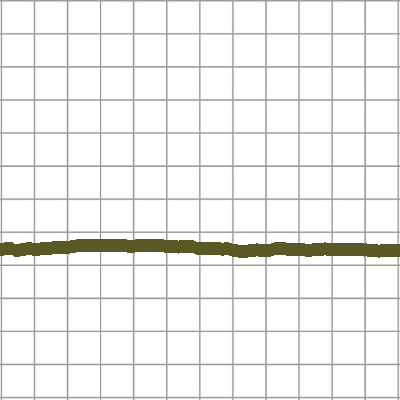

pitch73_thick1_color2_0_train.png


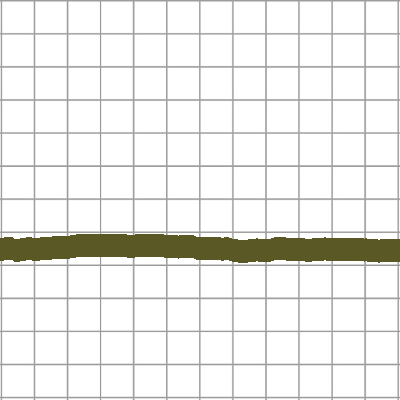

pitch73_thick2_color2_0_train.png


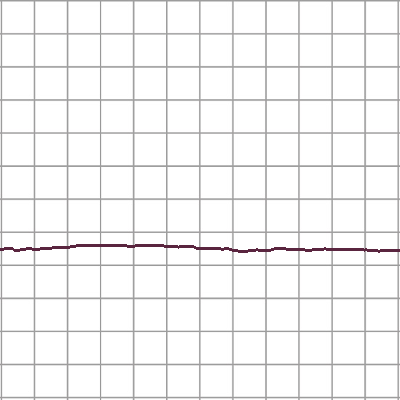

pitch73_thick0_color3_0_train.png


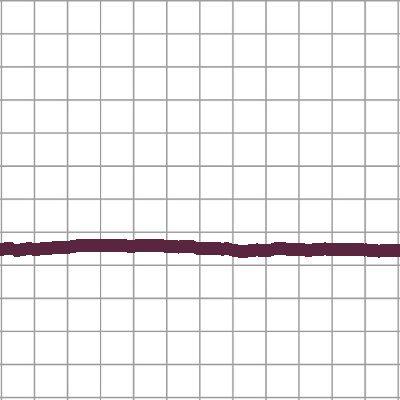

pitch73_thick1_color3_0_train.png


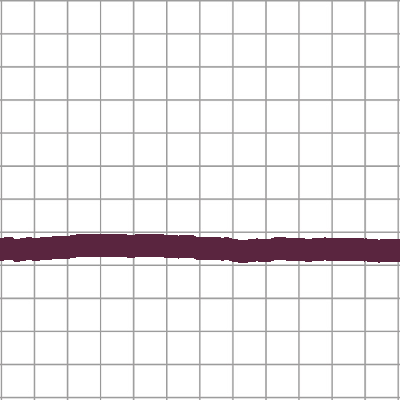

pitch73_thick2_color3_0_train.png


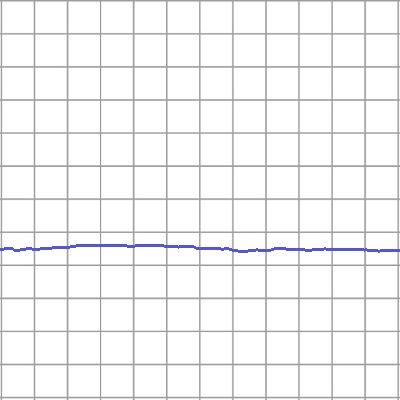

pitch73_thick0_color4_0_train.png


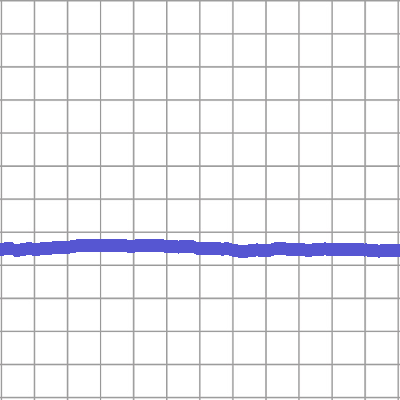

pitch73_thick1_color4_0_train.png


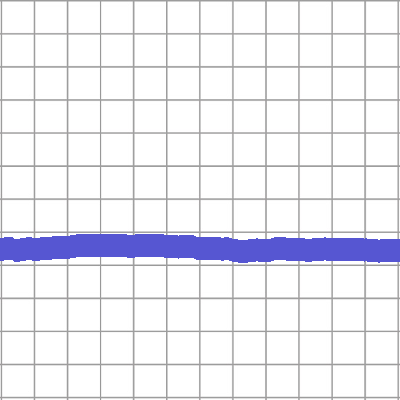

pitch73_thick2_color4_0_train.png


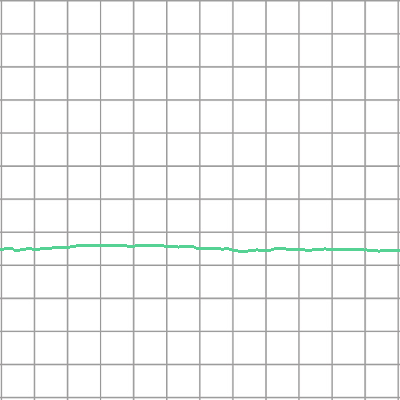

pitch73_thick0_color5_0_train.png


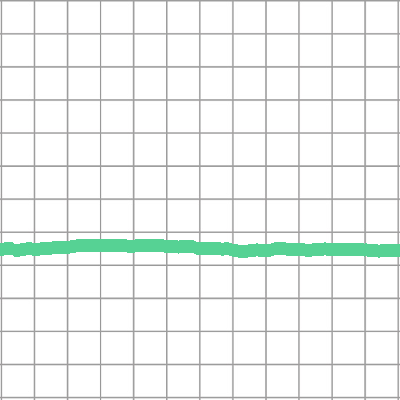

pitch73_thick1_color5_0_train.png


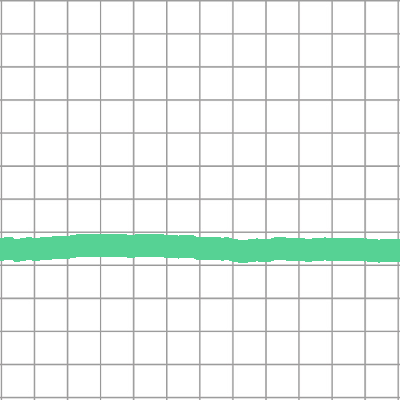

pitch73_thick2_color5_0_train.png


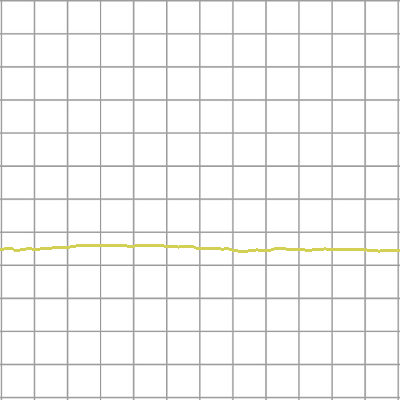

pitch73_thick0_color6_0_train.png


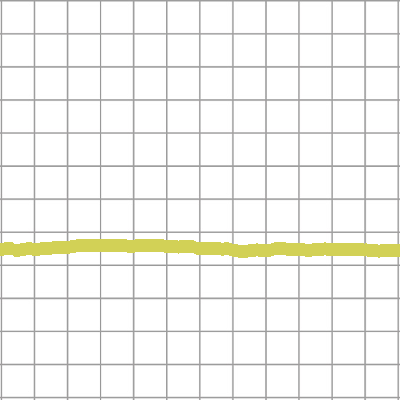

pitch73_thick1_color6_0_train.png


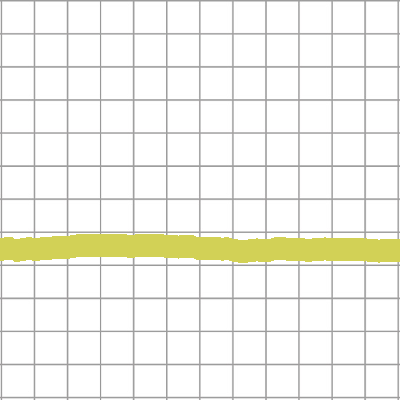

pitch73_thick2_color6_0_train.png


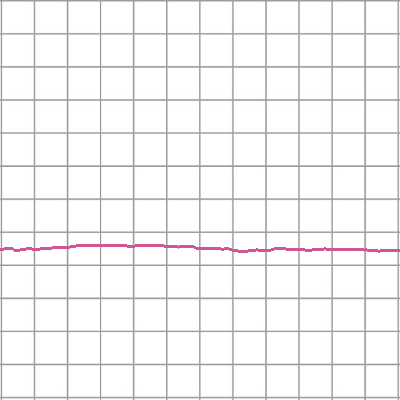

pitch73_thick0_color7_0_train.png


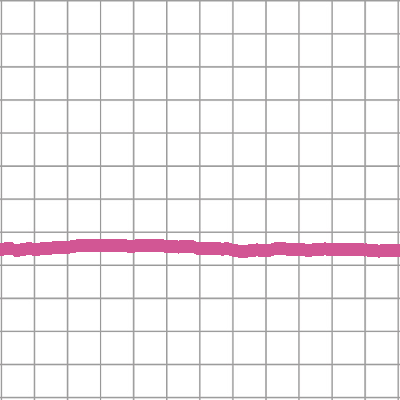

pitch73_thick1_color7_0_train.png


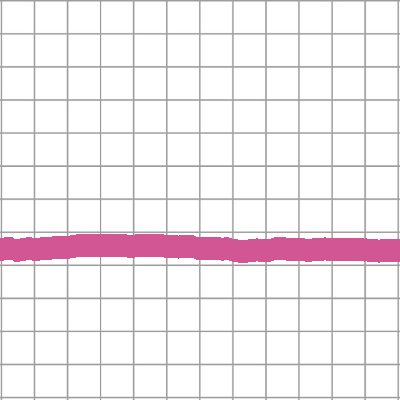

pitch73_thick2_color7_0_train.png


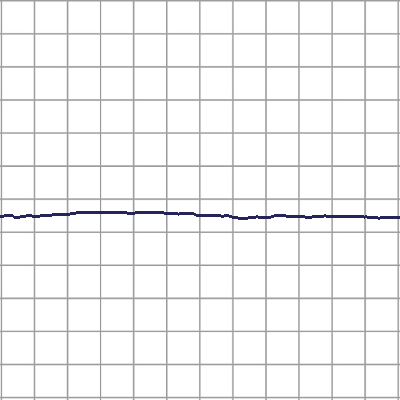

pitch74_thick0_color0_0_train.png


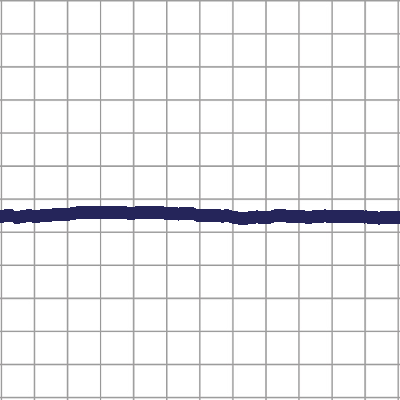

pitch74_thick1_color0_0_train.png


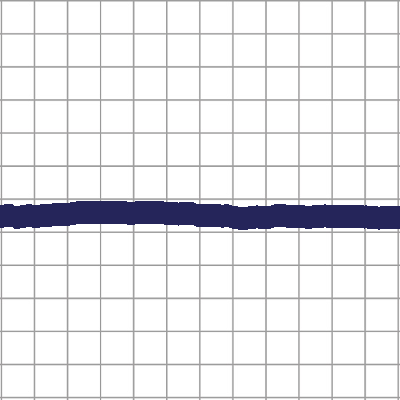

pitch74_thick2_color0_0_train.png


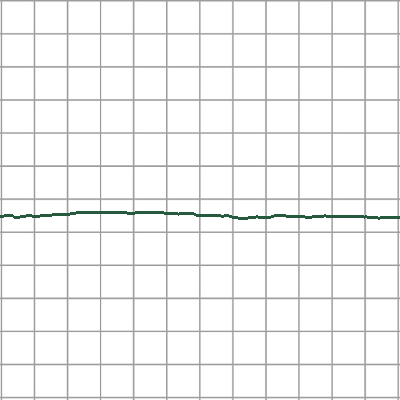

pitch74_thick0_color1_0_train.png


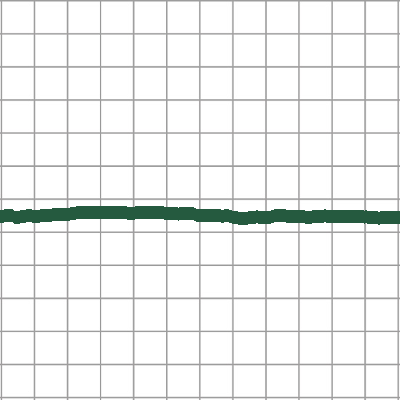

pitch74_thick1_color1_0_train.png


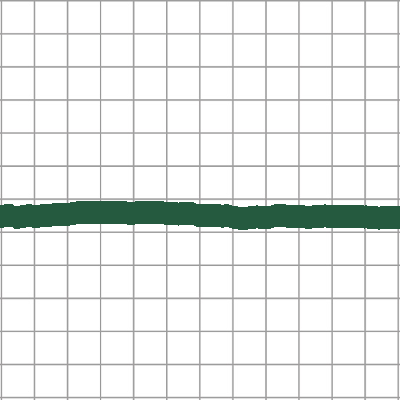

pitch74_thick2_color1_0_train.png


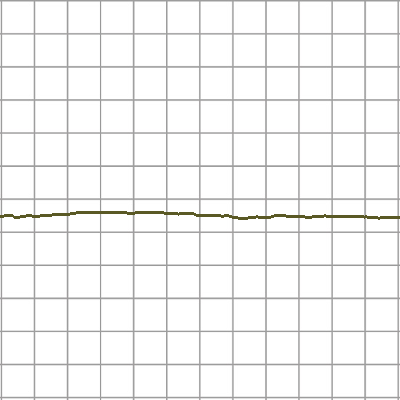

pitch74_thick0_color2_0_train.png


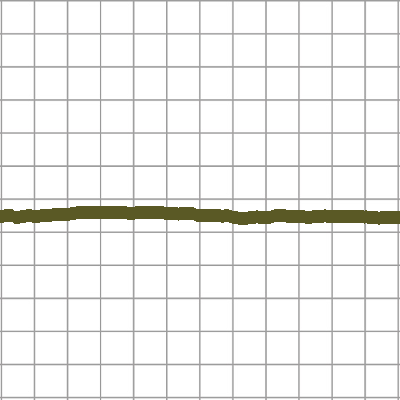

pitch74_thick1_color2_0_train.png


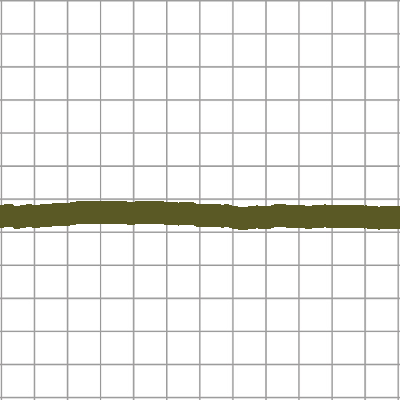

pitch74_thick2_color2_0_train.png


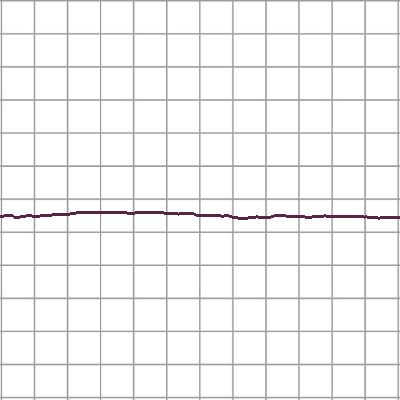

pitch74_thick0_color3_0_train.png


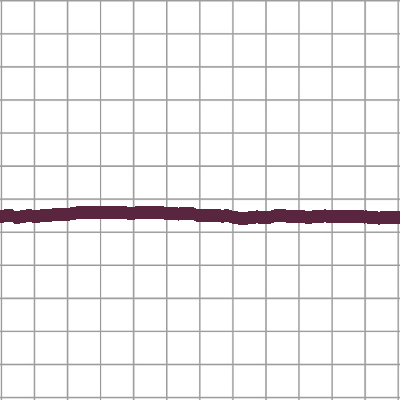

pitch74_thick1_color3_0_train.png


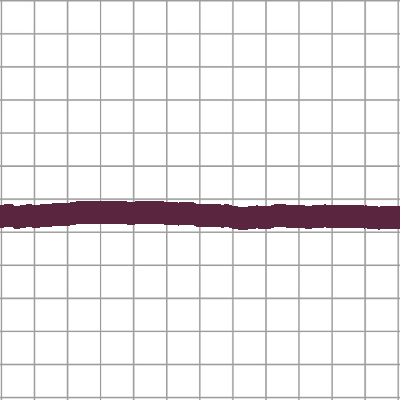

pitch74_thick2_color3_0_train.png


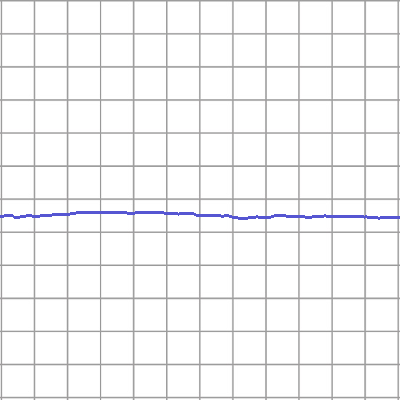

pitch74_thick0_color4_0_train.png


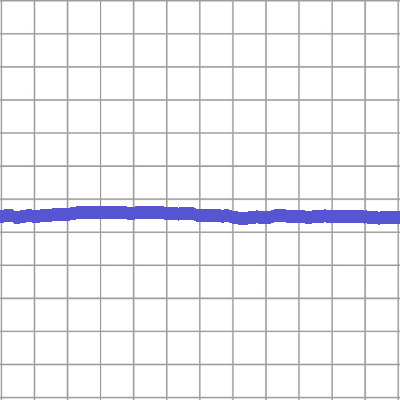

pitch74_thick1_color4_0_train.png


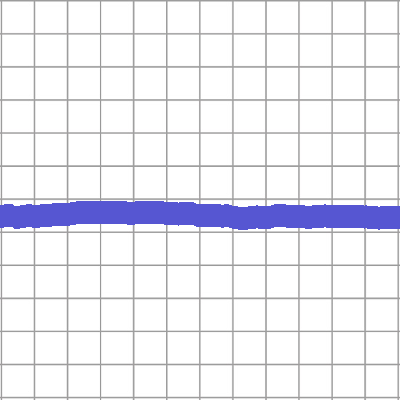

pitch74_thick2_color4_0_train.png


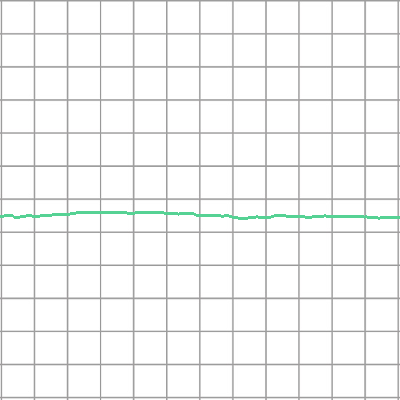

pitch74_thick0_color5_0_train.png


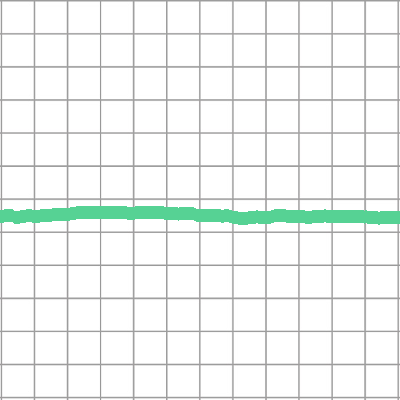

pitch74_thick1_color5_0_train.png


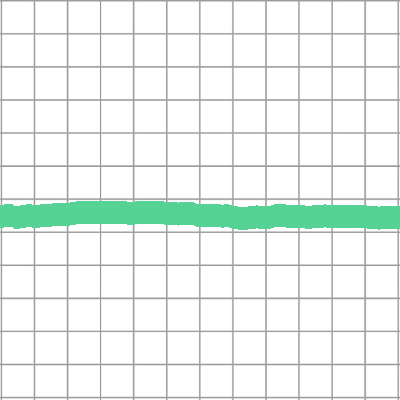

pitch74_thick2_color5_0_train.png


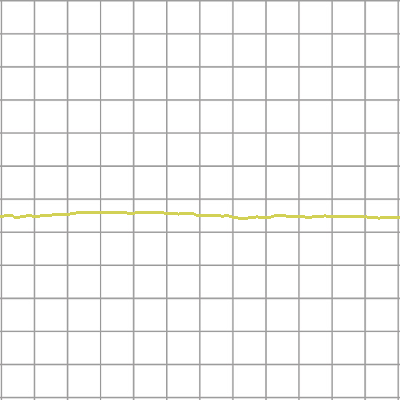

pitch74_thick0_color6_0_train.png


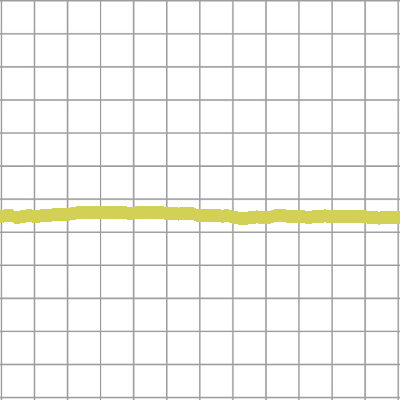

pitch74_thick1_color6_0_train.png


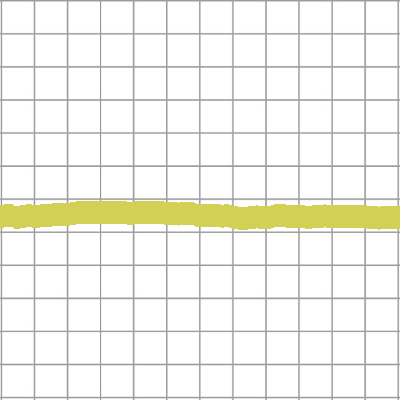

pitch74_thick2_color6_0_train.png


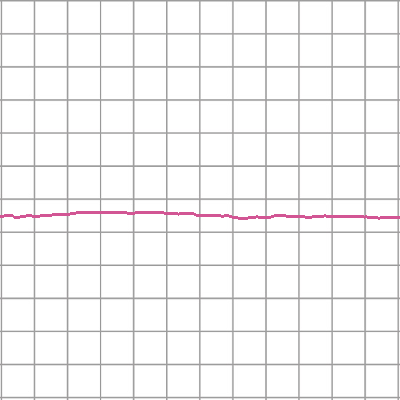

pitch74_thick0_color7_0_train.png


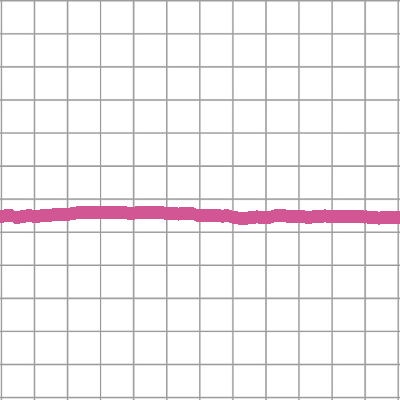

pitch74_thick1_color7_0_train.png


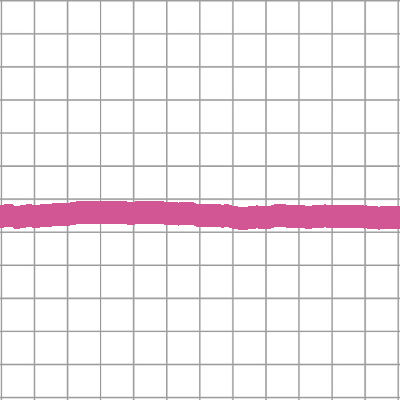

pitch74_thick2_color7_0_train.png


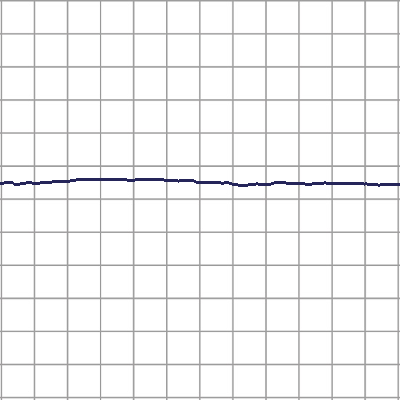

pitch75_thick0_color0_0_train.png


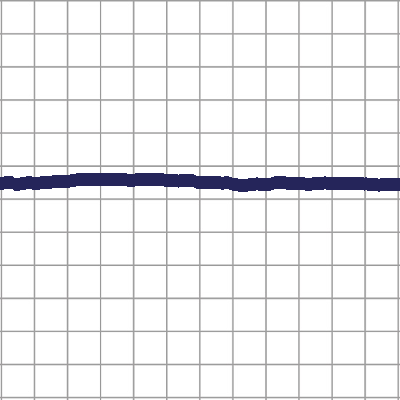

pitch75_thick1_color0_0_train.png


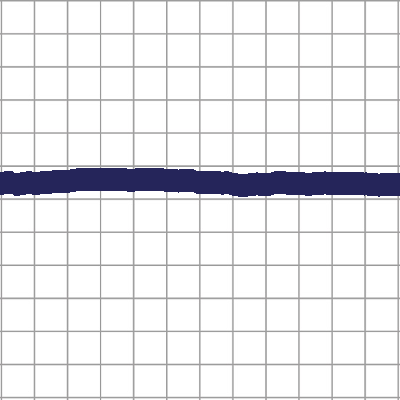

pitch75_thick2_color0_0_train.png


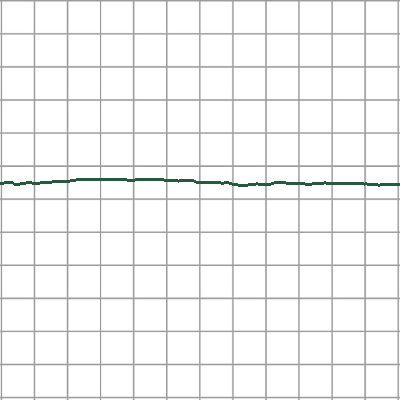

pitch75_thick0_color1_0_train.png


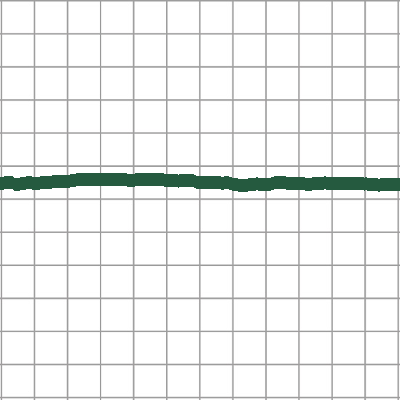

pitch75_thick1_color1_0_train.png


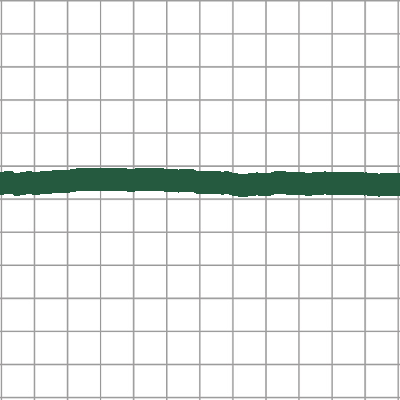

pitch75_thick2_color1_0_train.png


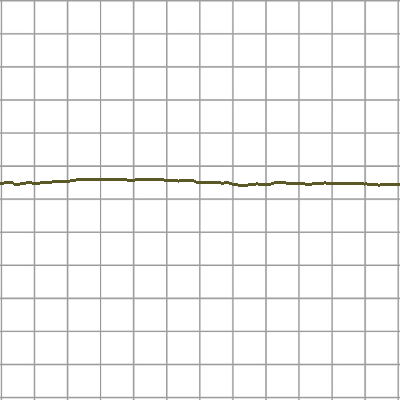

pitch75_thick0_color2_0_train.png


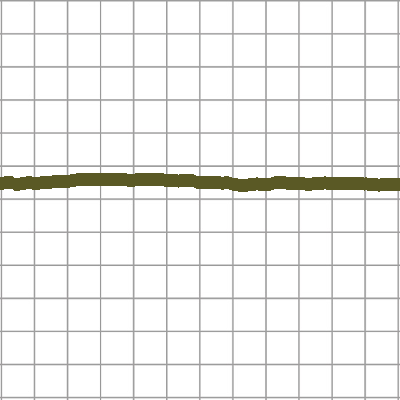

pitch75_thick1_color2_0_train.png


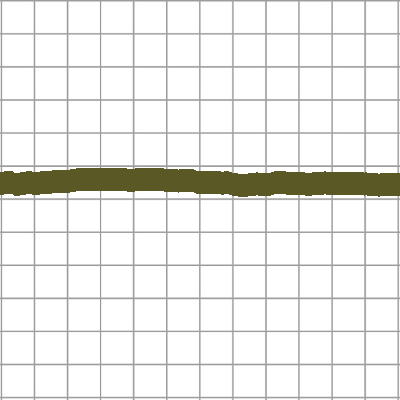

pitch75_thick2_color2_0_train.png


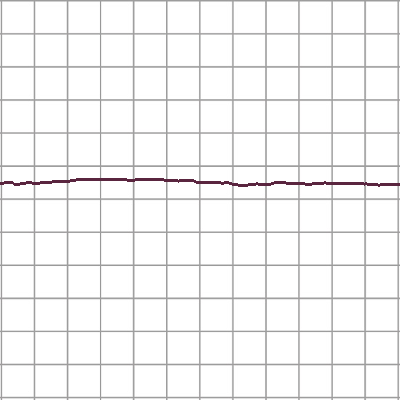

pitch75_thick0_color3_0_train.png


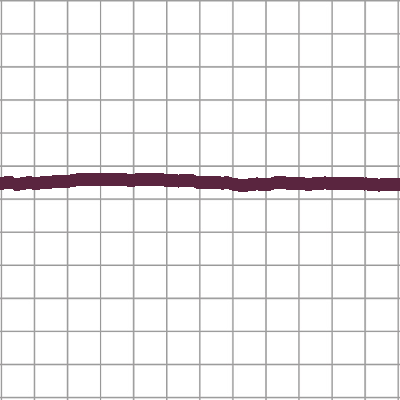

pitch75_thick1_color3_0_train.png


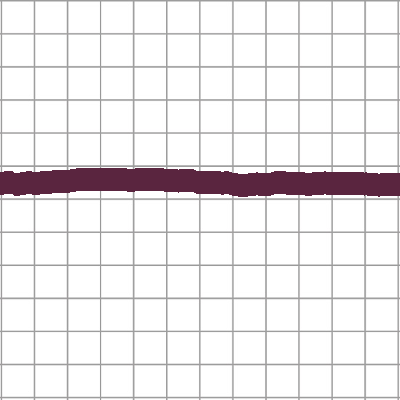

pitch75_thick2_color3_0_train.png


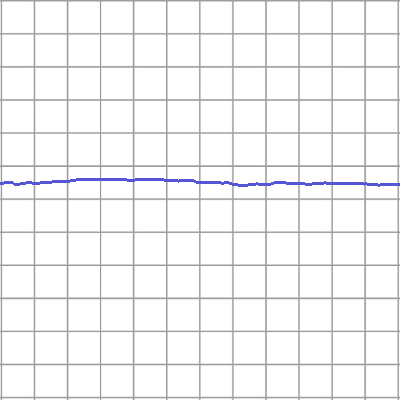

pitch75_thick0_color4_0_train.png


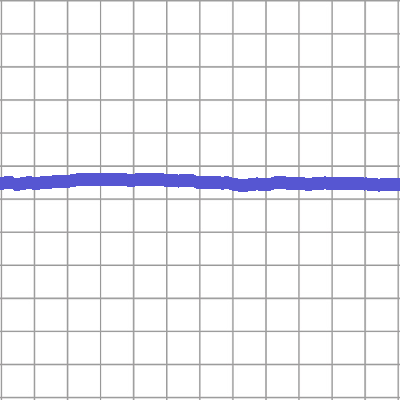

pitch75_thick1_color4_0_train.png


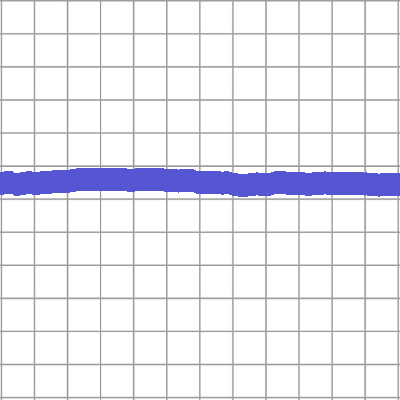

pitch75_thick2_color4_0_train.png


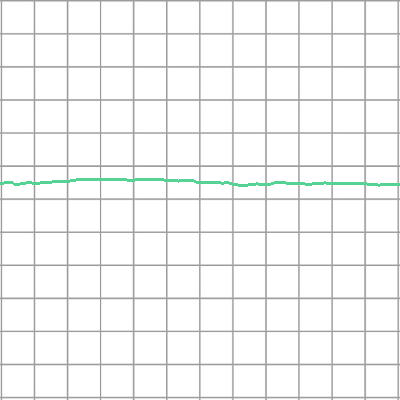

pitch75_thick0_color5_0_train.png


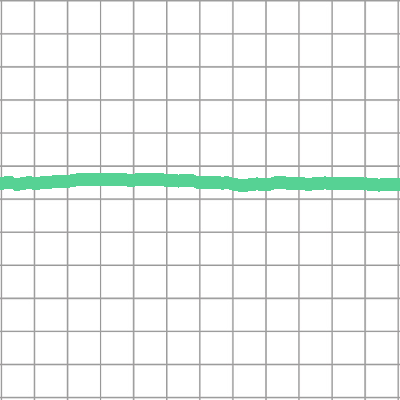

pitch75_thick1_color5_0_train.png


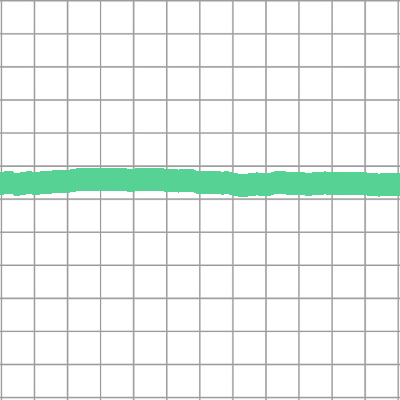

pitch75_thick2_color5_0_train.png


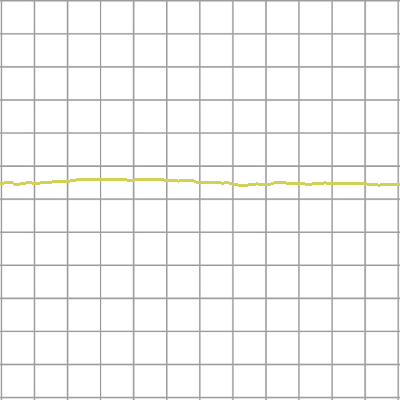

pitch75_thick0_color6_0_train.png


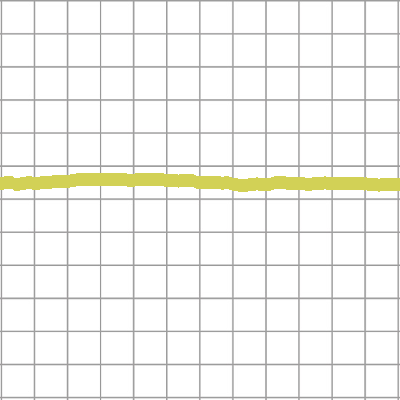

pitch75_thick1_color6_0_train.png


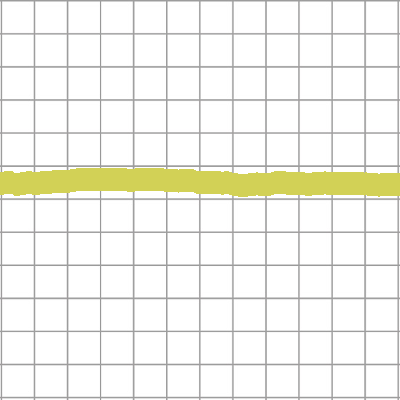

pitch75_thick2_color6_0_train.png


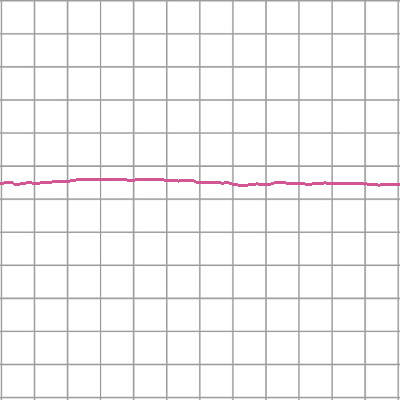

pitch75_thick0_color7_0_train.png


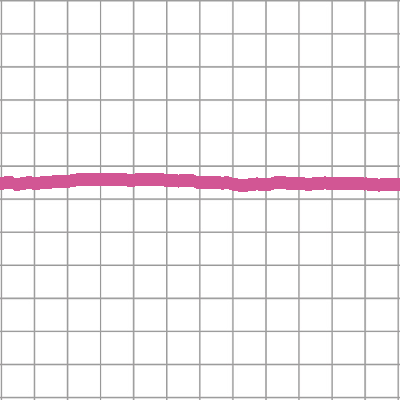

pitch75_thick1_color7_0_train.png


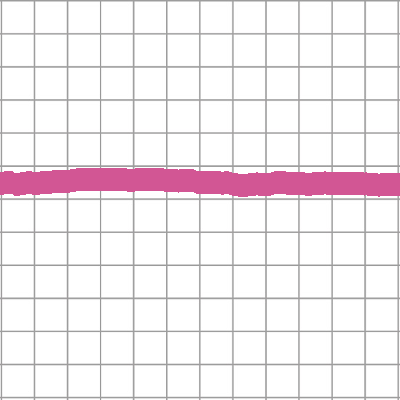

pitch75_thick2_color7_0_train.png


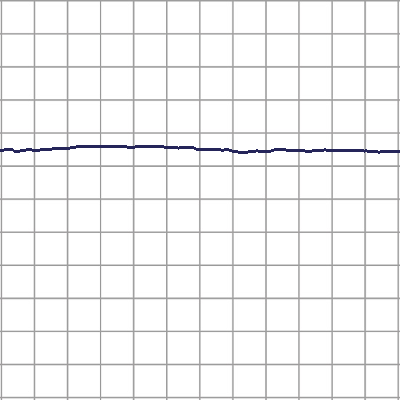

pitch76_thick0_color0_0_train.png


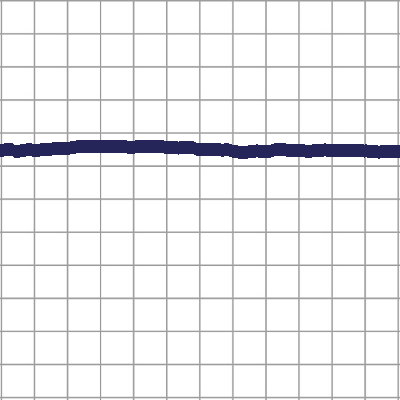

pitch76_thick1_color0_0_train.png


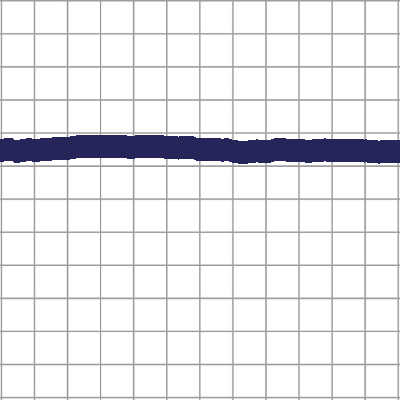

pitch76_thick2_color0_0_train.png


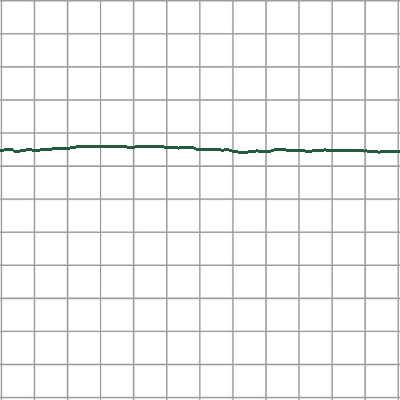

pitch76_thick0_color1_0_train.png


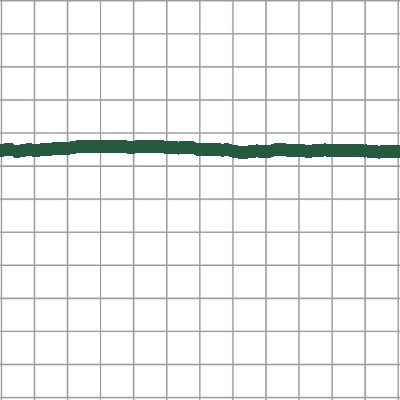

pitch76_thick1_color1_0_train.png


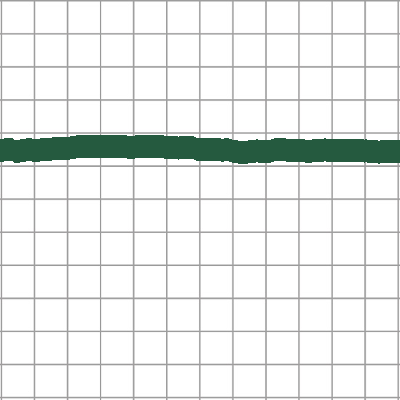

pitch76_thick2_color1_0_train.png


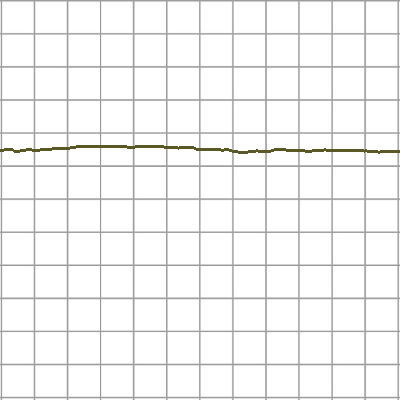

pitch76_thick0_color2_0_train.png


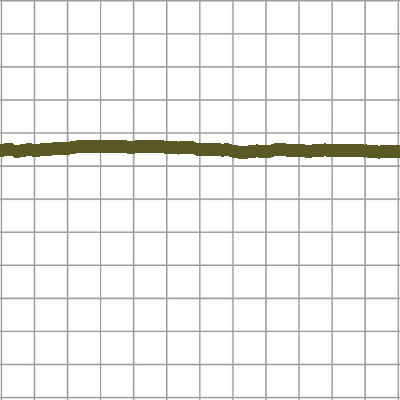

pitch76_thick1_color2_0_train.png


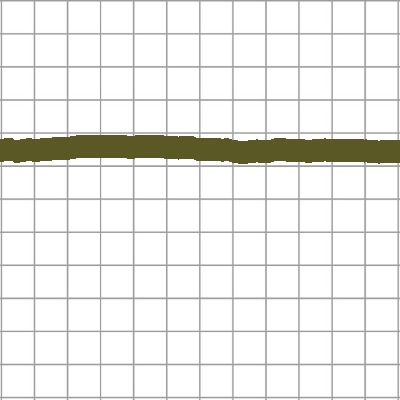

pitch76_thick2_color2_0_train.png


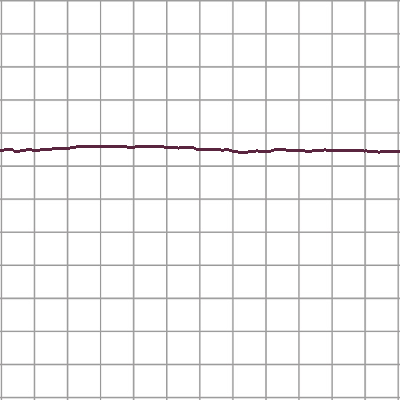

pitch76_thick0_color3_0_train.png


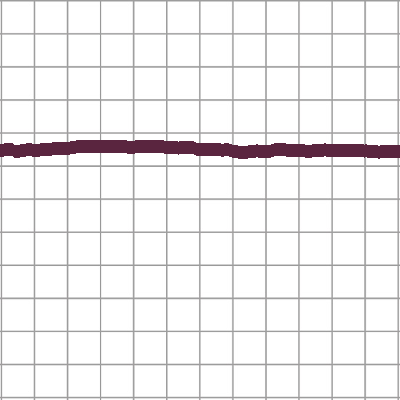

pitch76_thick1_color3_0_train.png


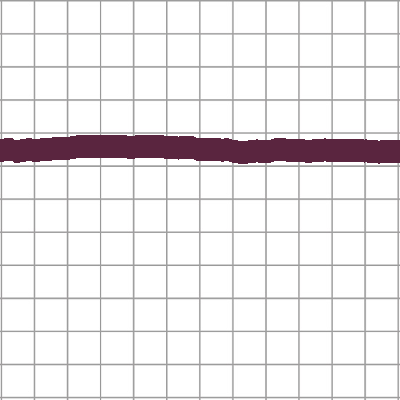

pitch76_thick2_color3_0_train.png


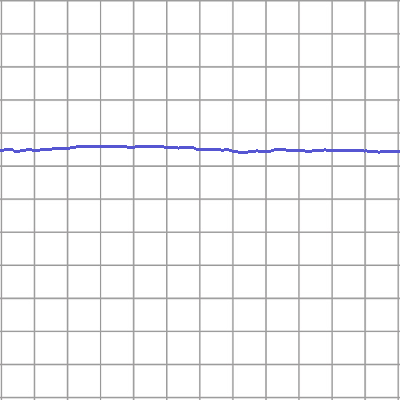

pitch76_thick0_color4_0_train.png


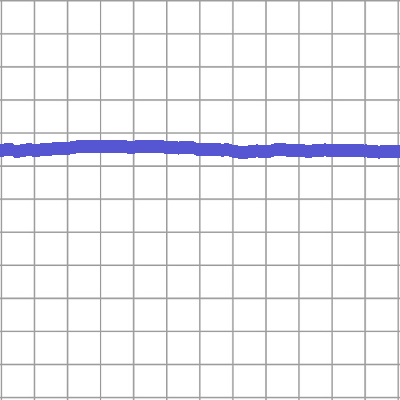

pitch76_thick1_color4_0_train.png


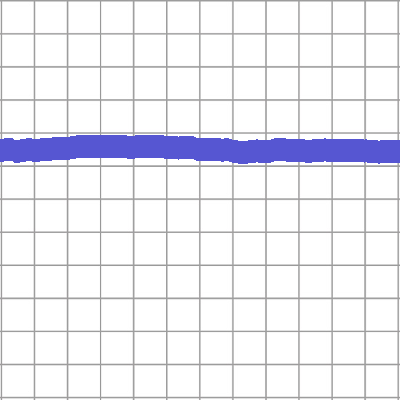

pitch76_thick2_color4_0_train.png


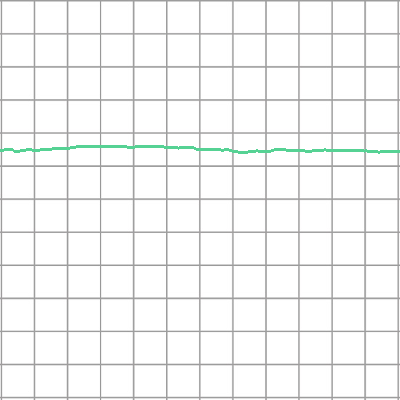

pitch76_thick0_color5_0_train.png


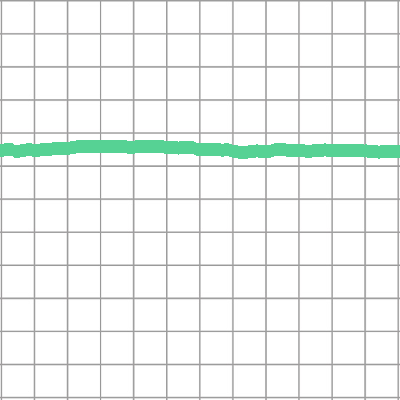

pitch76_thick1_color5_0_train.png


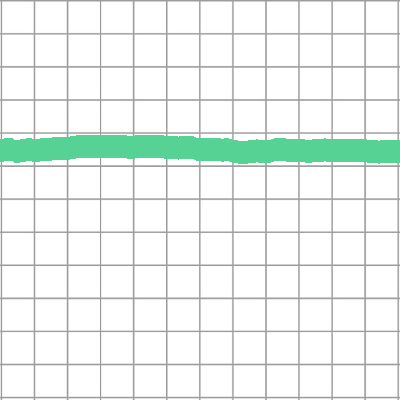

pitch76_thick2_color5_0_train.png


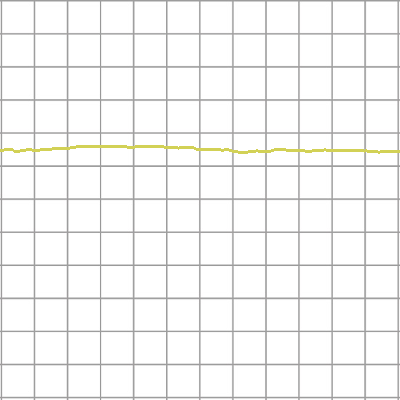

pitch76_thick0_color6_0_train.png


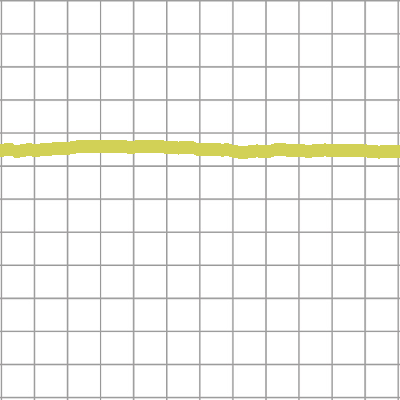

pitch76_thick1_color6_0_train.png


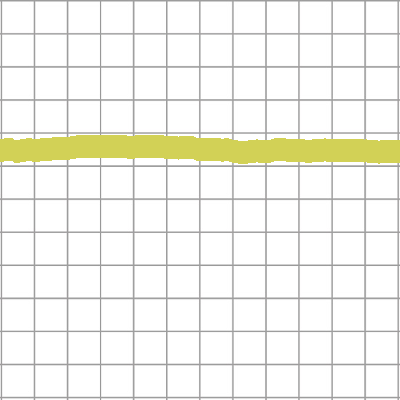

pitch76_thick2_color6_0_train.png


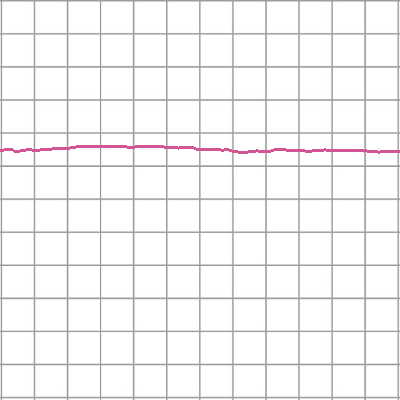

pitch76_thick0_color7_0_train.png


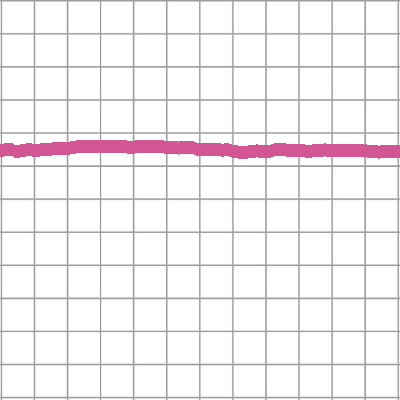

pitch76_thick1_color7_0_train.png


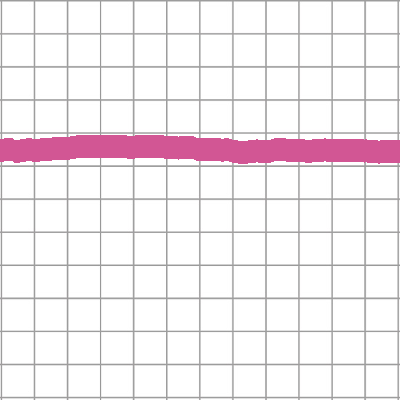

pitch76_thick2_color7_0_train.png


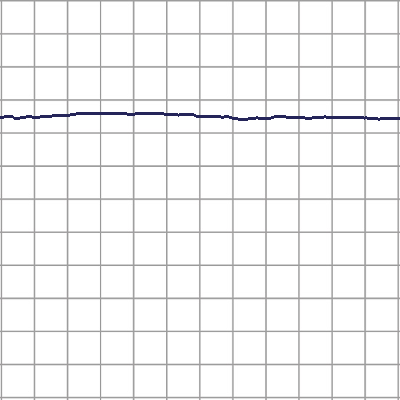

pitch77_thick0_color0_0_train.png


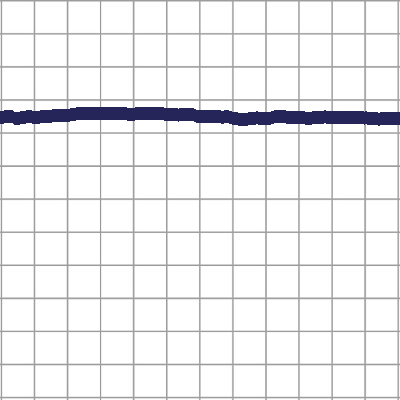

pitch77_thick1_color0_0_train.png


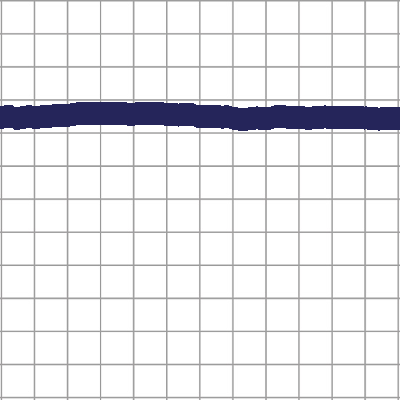

pitch77_thick2_color0_0_train.png


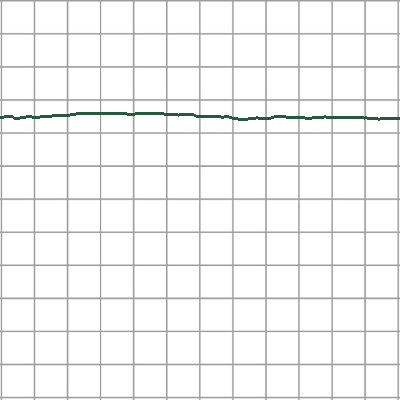

pitch77_thick0_color1_0_train.png


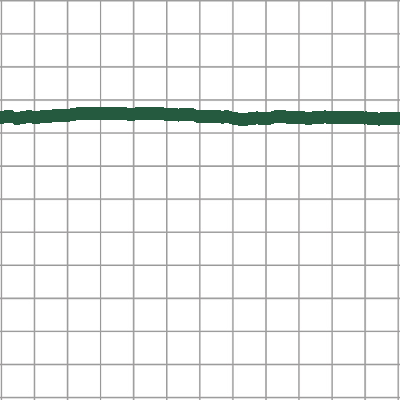

pitch77_thick1_color1_0_train.png


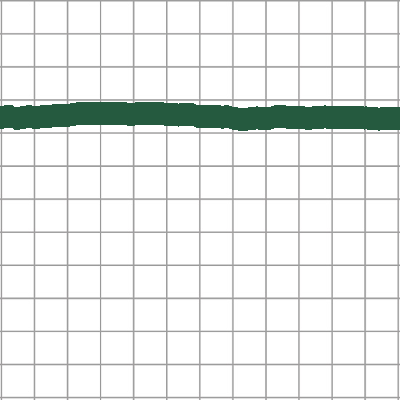

pitch77_thick2_color1_0_train.png


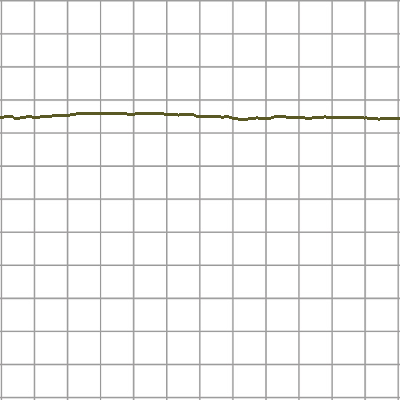

pitch77_thick0_color2_0_train.png


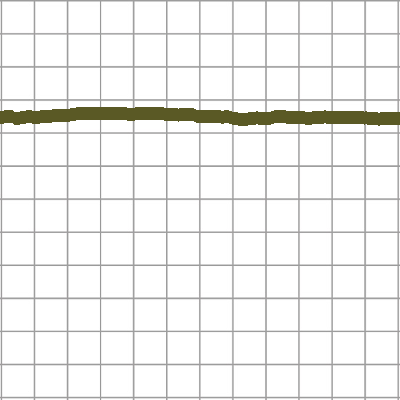

pitch77_thick1_color2_0_train.png


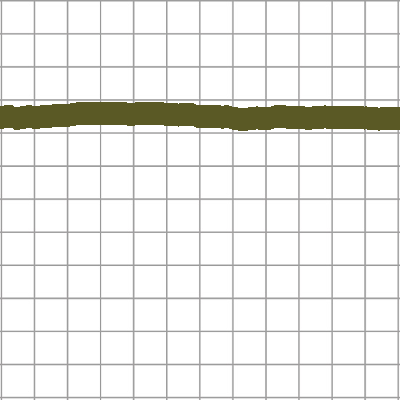

pitch77_thick2_color2_0_train.png


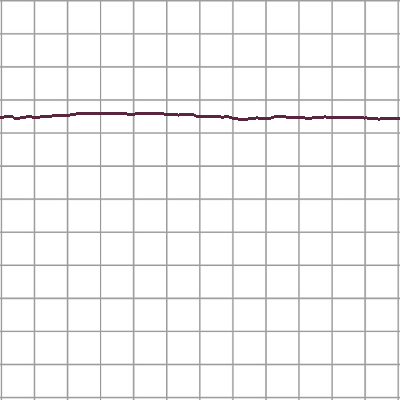

pitch77_thick0_color3_0_train.png


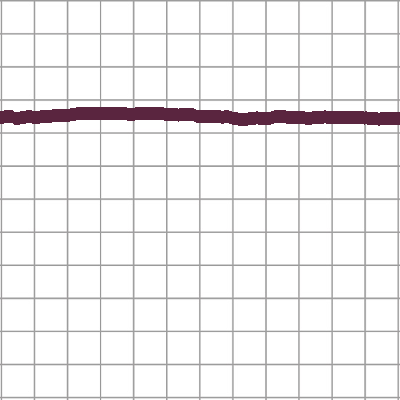

pitch77_thick1_color3_0_train.png


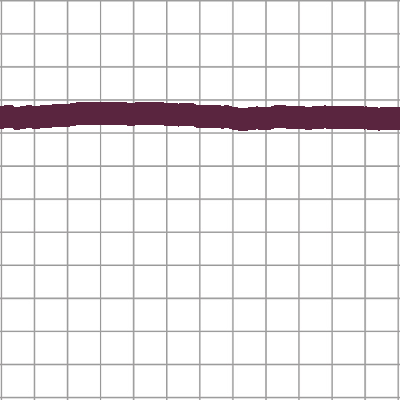

pitch77_thick2_color3_0_train.png


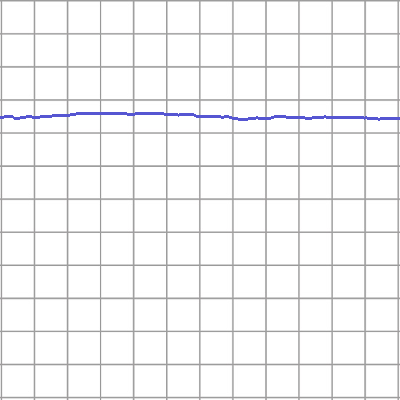

pitch77_thick0_color4_0_train.png


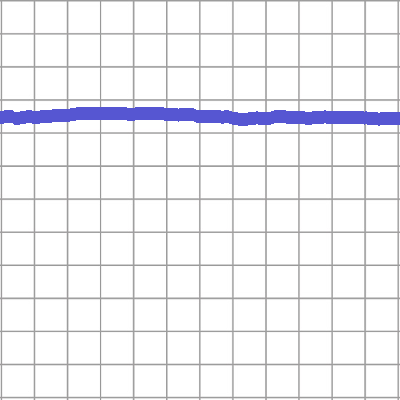

pitch77_thick1_color4_0_train.png


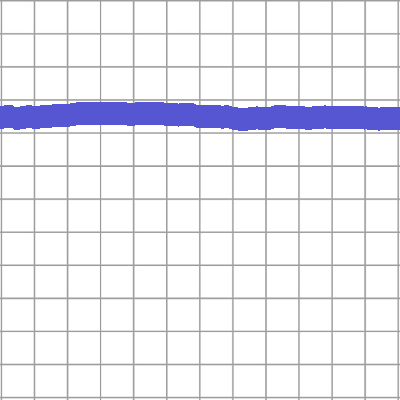

pitch77_thick2_color4_0_train.png


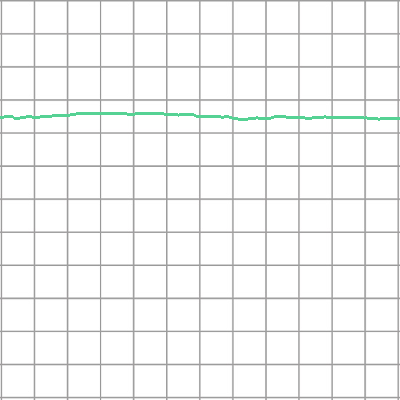

pitch77_thick0_color5_0_train.png


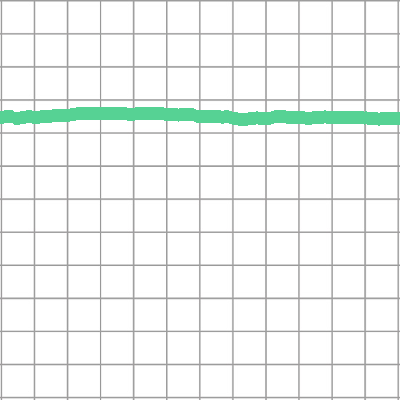

pitch77_thick1_color5_0_train.png


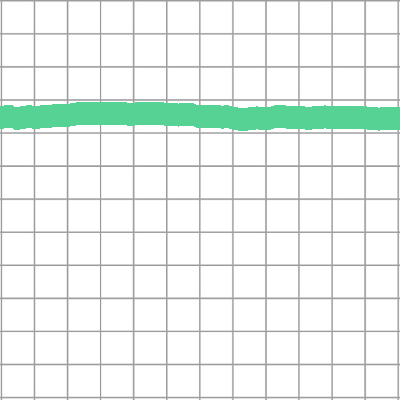

pitch77_thick2_color5_0_train.png


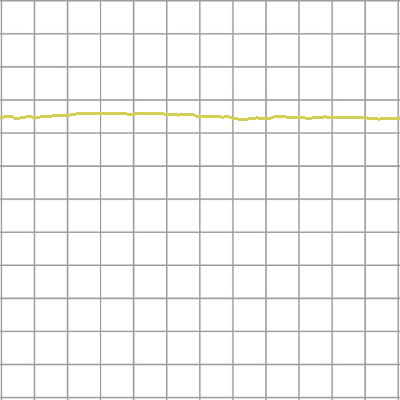

pitch77_thick0_color6_0_train.png


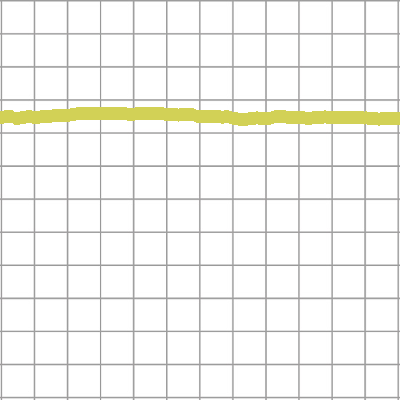

pitch77_thick1_color6_0_train.png


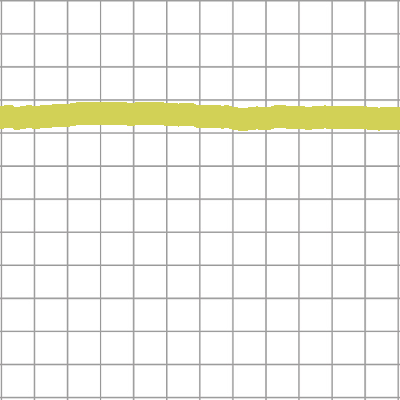

pitch77_thick2_color6_0_train.png


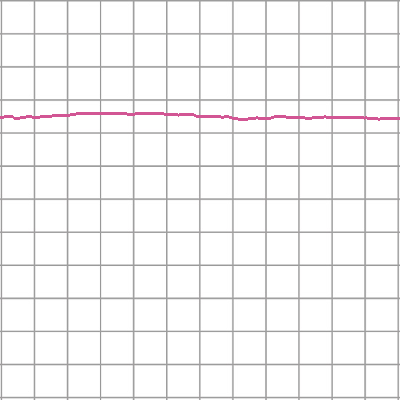

pitch77_thick0_color7_0_train.png


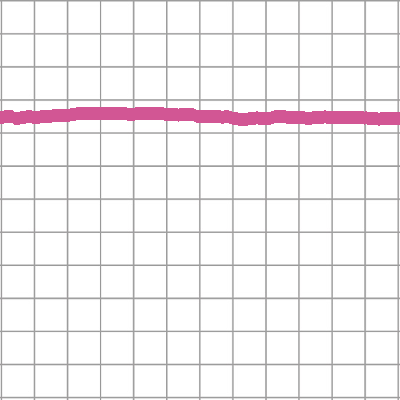

pitch77_thick1_color7_0_train.png


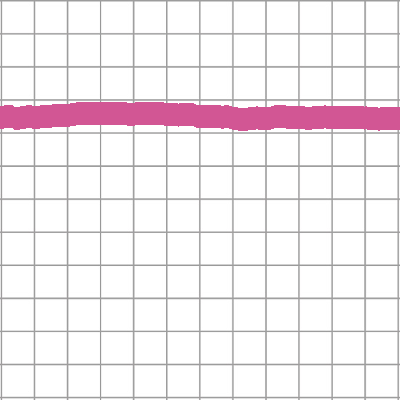

pitch77_thick2_color7_0_train.png


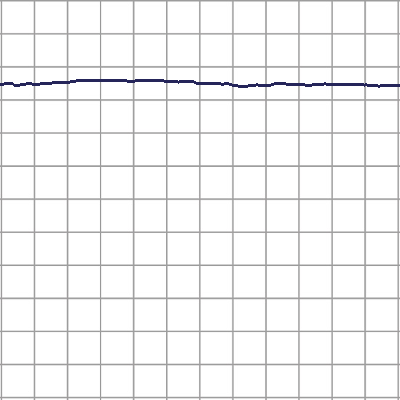

pitch78_thick0_color0_0_train.png


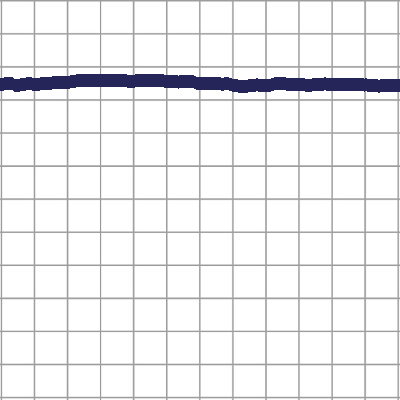

pitch78_thick1_color0_0_train.png


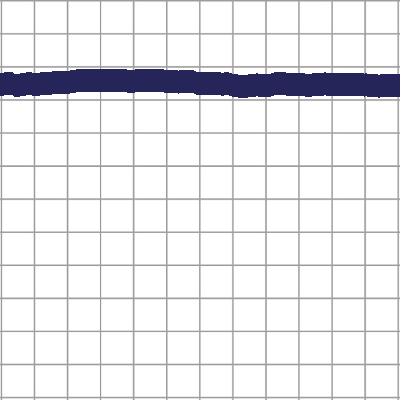

pitch78_thick2_color0_0_train.png


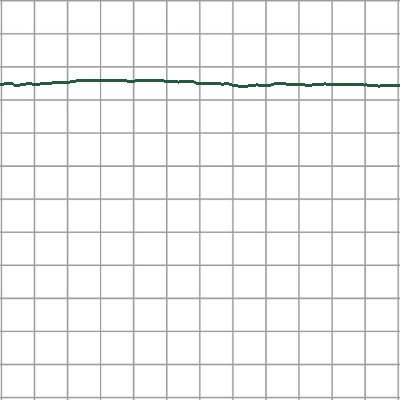

pitch78_thick0_color1_0_train.png


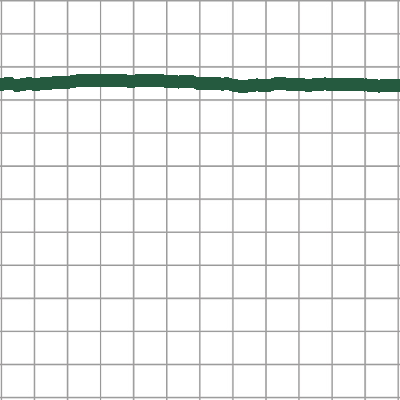

pitch78_thick1_color1_0_train.png


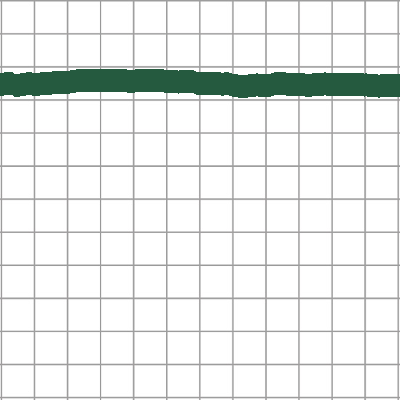

pitch78_thick2_color1_0_train.png


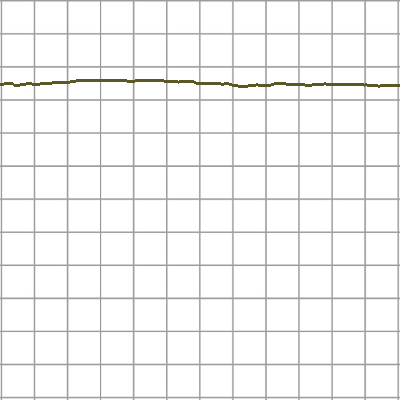

pitch78_thick0_color2_0_train.png


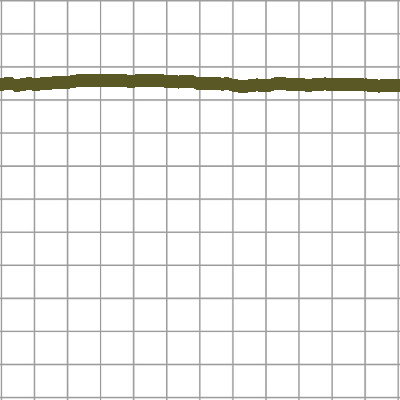

pitch78_thick1_color2_0_train.png


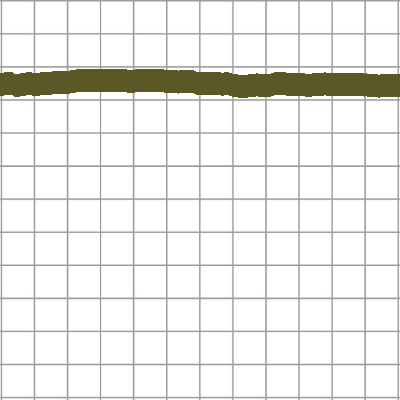

pitch78_thick2_color2_0_train.png


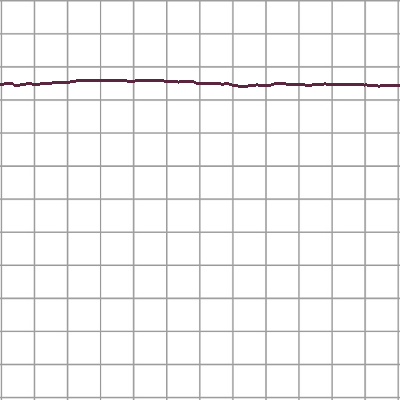

pitch78_thick0_color3_0_train.png


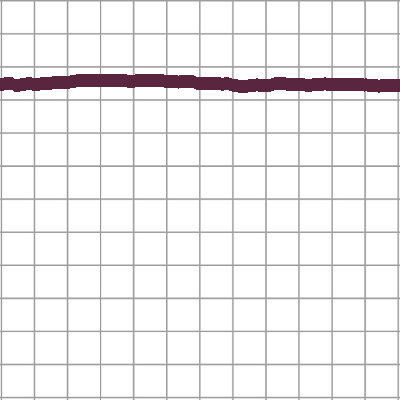

pitch78_thick1_color3_0_train.png


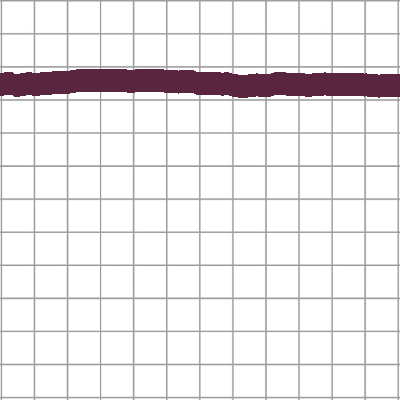

pitch78_thick2_color3_0_train.png


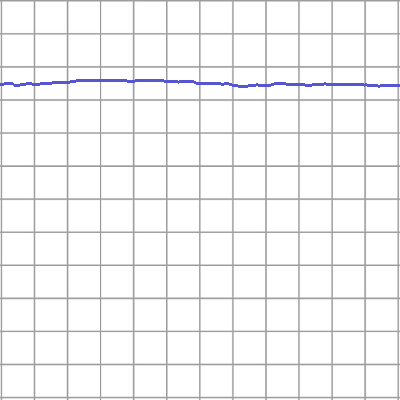

pitch78_thick0_color4_0_train.png


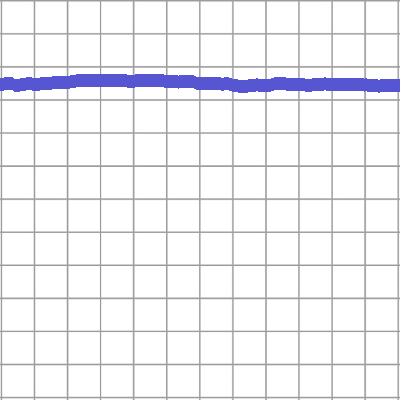

pitch78_thick1_color4_0_train.png


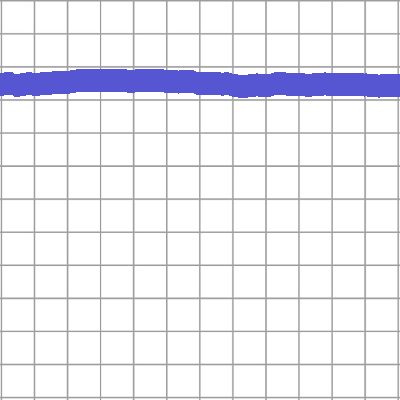

pitch78_thick2_color4_0_train.png


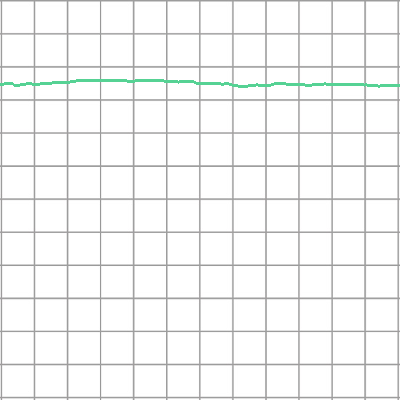

pitch78_thick0_color5_0_train.png


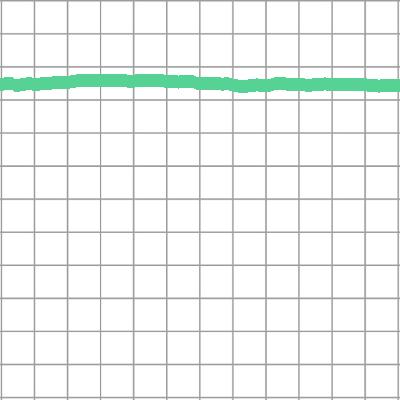

pitch78_thick1_color5_0_train.png


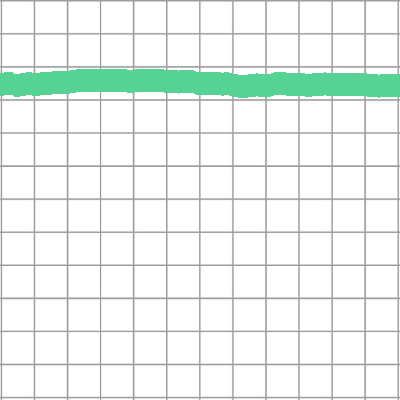

pitch78_thick2_color5_0_train.png


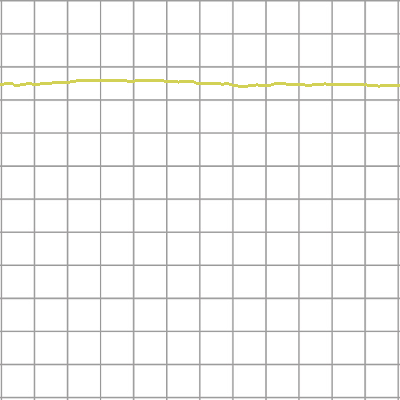

pitch78_thick0_color6_0_train.png


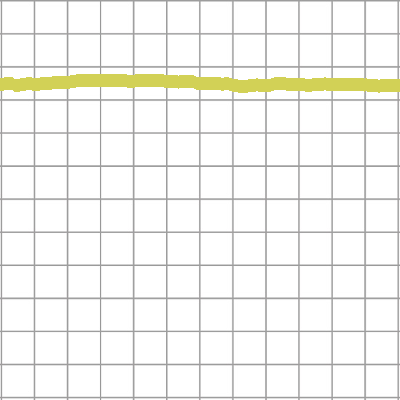

pitch78_thick1_color6_0_train.png


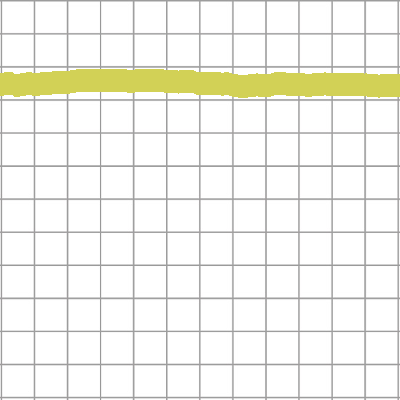

pitch78_thick2_color6_0_train.png


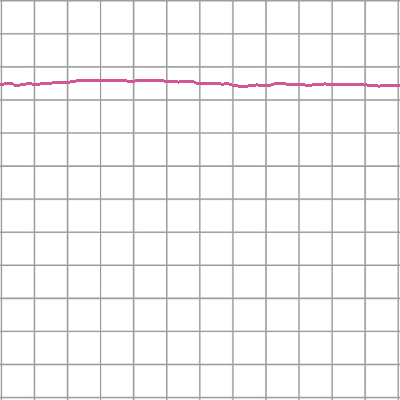

pitch78_thick0_color7_0_train.png


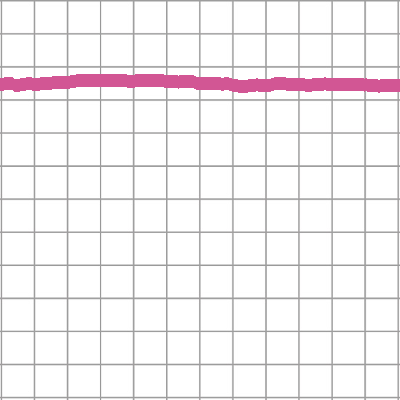

pitch78_thick1_color7_0_train.png


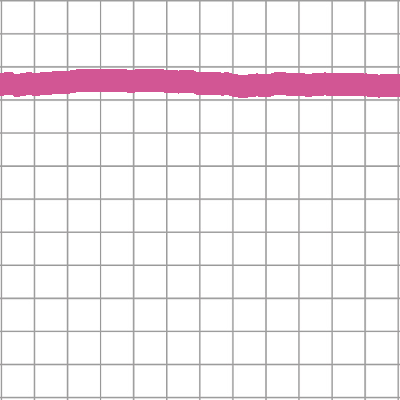

pitch78_thick2_color7_0_train.png


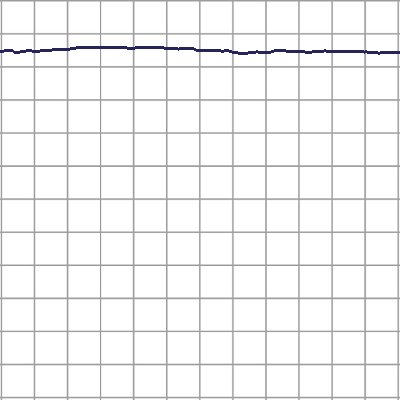

pitch79_thick0_color0_0_train.png


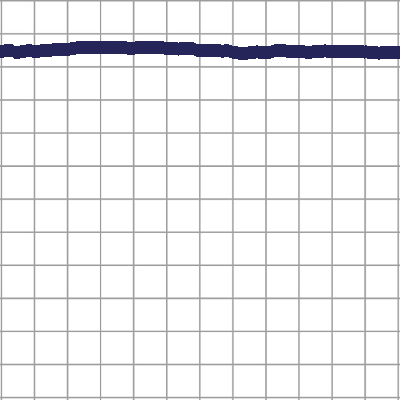

pitch79_thick1_color0_0_train.png


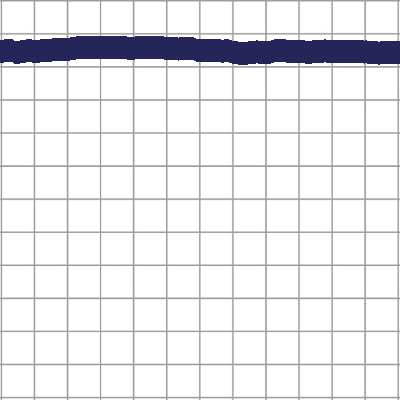

pitch79_thick2_color0_0_train.png


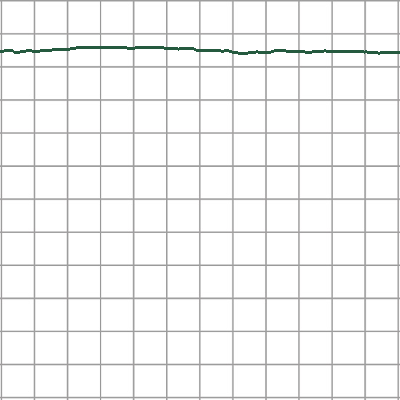

pitch79_thick0_color1_0_train.png


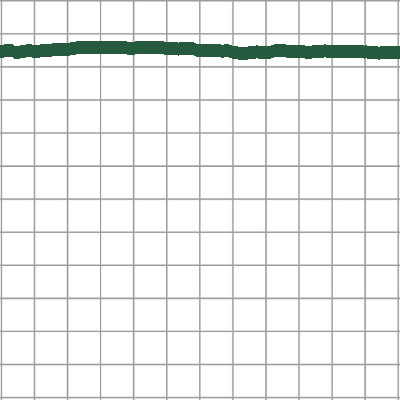

pitch79_thick1_color1_0_train.png


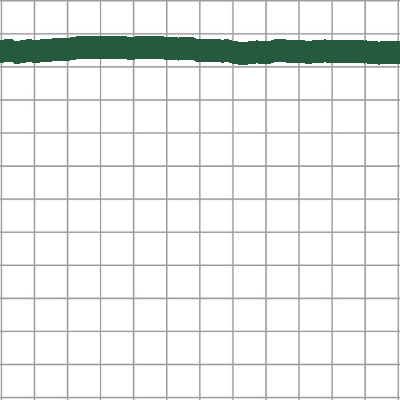

pitch79_thick2_color1_0_train.png


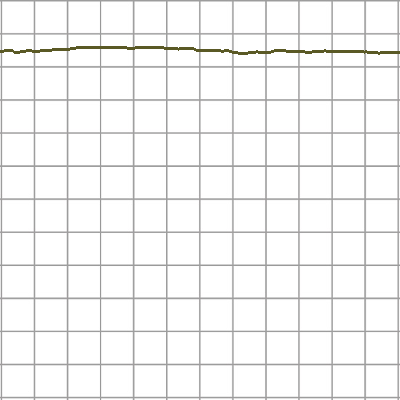

pitch79_thick0_color2_0_train.png


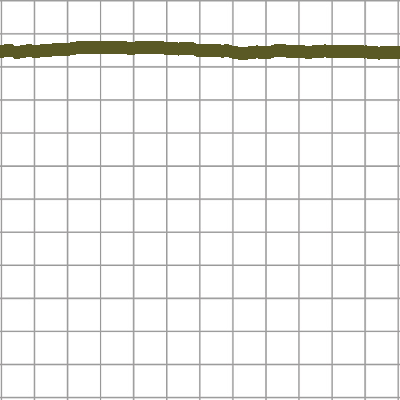

pitch79_thick1_color2_0_train.png


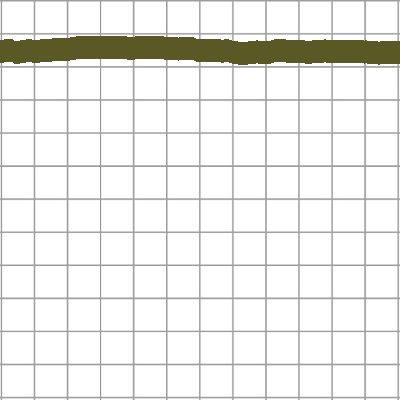

pitch79_thick2_color2_0_train.png


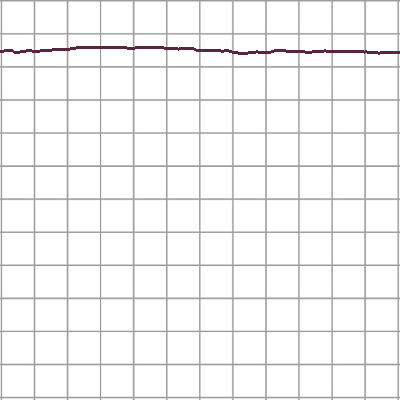

pitch79_thick0_color3_0_train.png


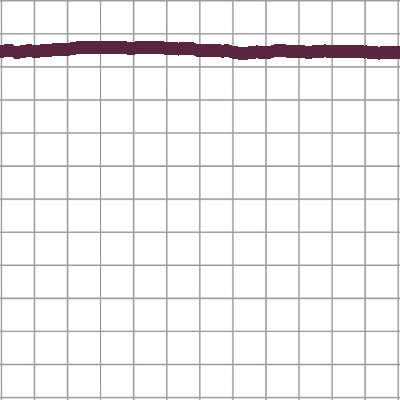

pitch79_thick1_color3_0_train.png


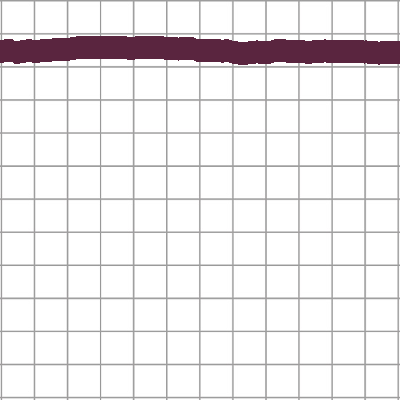

pitch79_thick2_color3_0_train.png


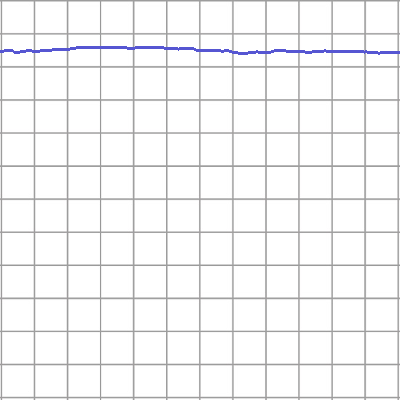

pitch79_thick0_color4_0_train.png


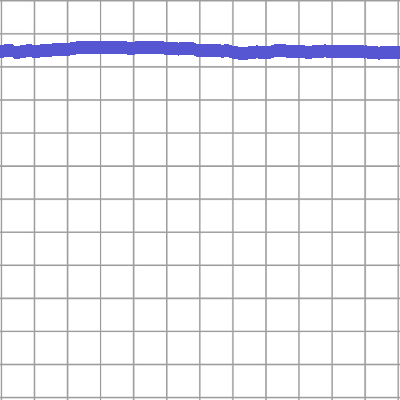

pitch79_thick1_color4_0_train.png


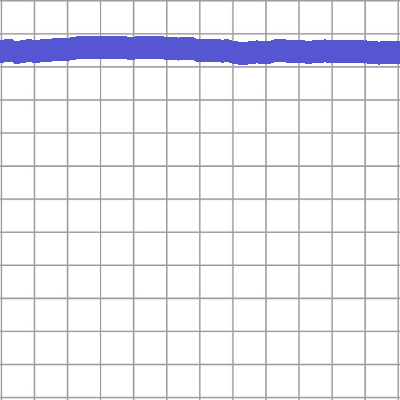

pitch79_thick2_color4_0_train.png


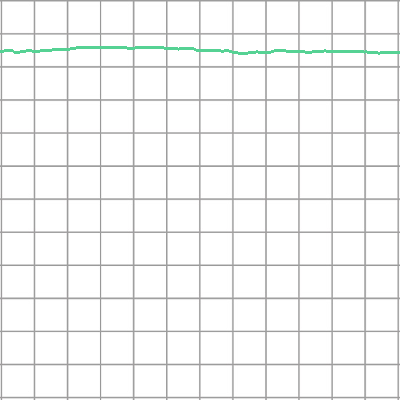

pitch79_thick0_color5_0_train.png


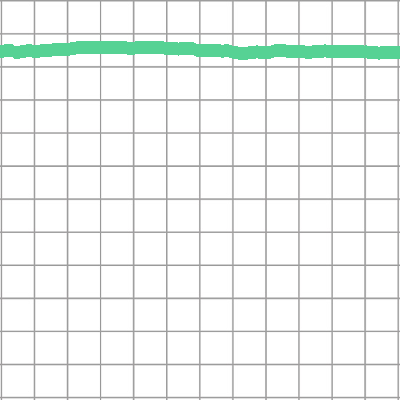

pitch79_thick1_color5_0_train.png


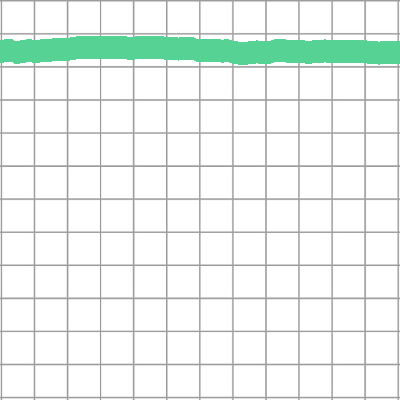

pitch79_thick2_color5_0_train.png


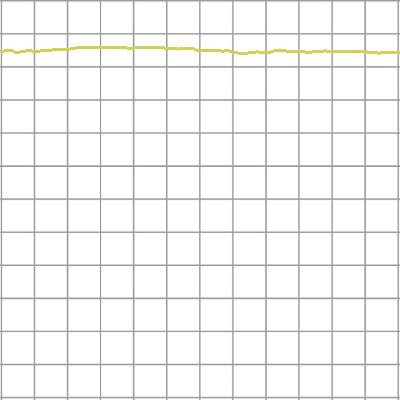

pitch79_thick0_color6_0_train.png


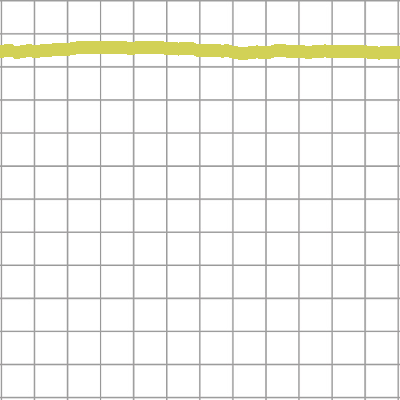

pitch79_thick1_color6_0_train.png


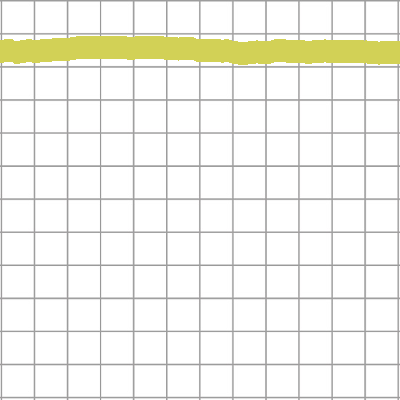

pitch79_thick2_color6_0_train.png


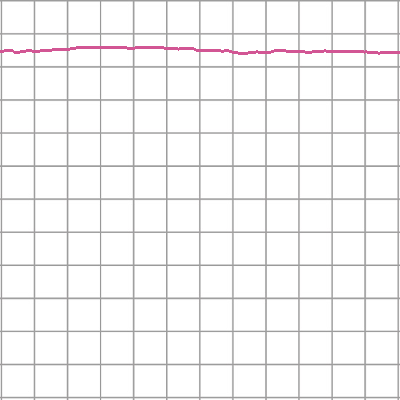

pitch79_thick0_color7_0_train.png


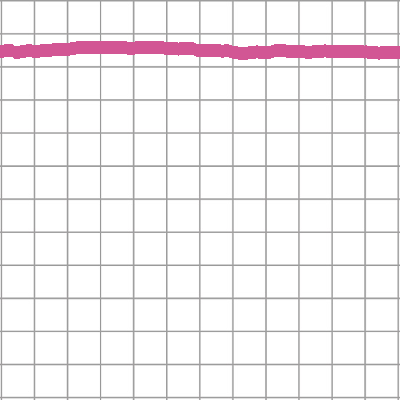

pitch79_thick1_color7_0_train.png


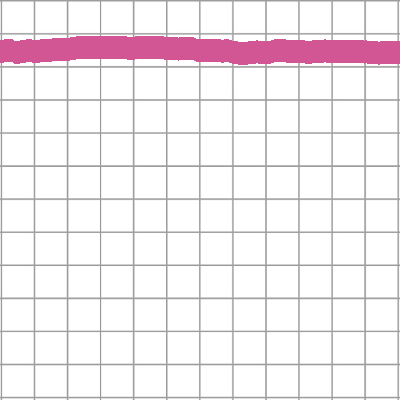

pitch79_thick2_color7_0_train.png


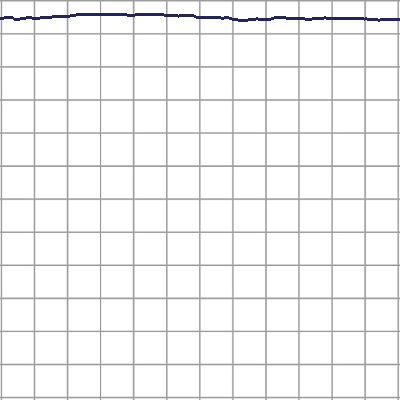

pitch80_thick0_color0_0_train.png


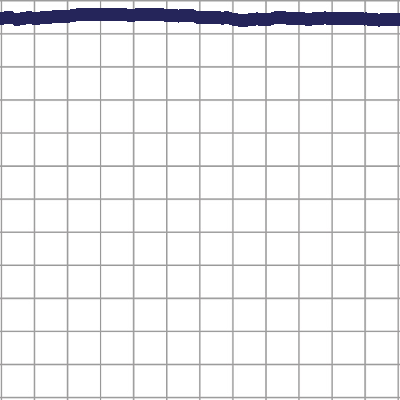

pitch80_thick1_color0_0_train.png


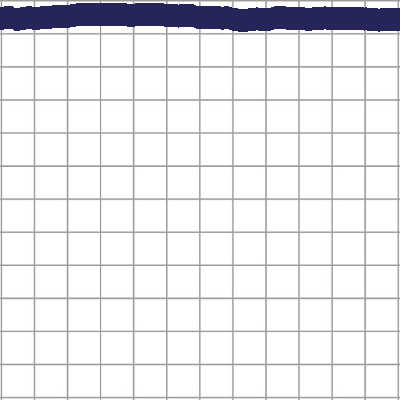

pitch80_thick2_color0_0_train.png


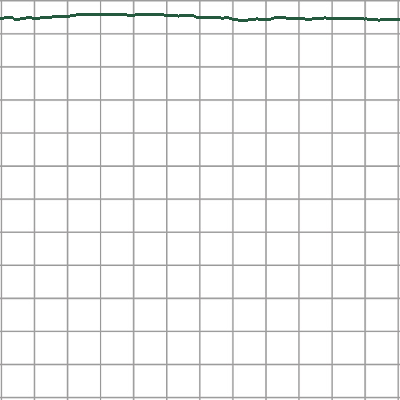

pitch80_thick0_color1_0_train.png


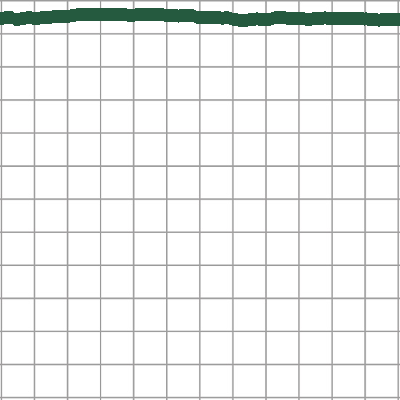

pitch80_thick1_color1_0_train.png


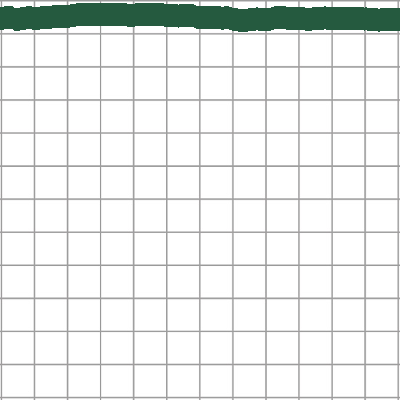

pitch80_thick2_color1_0_train.png


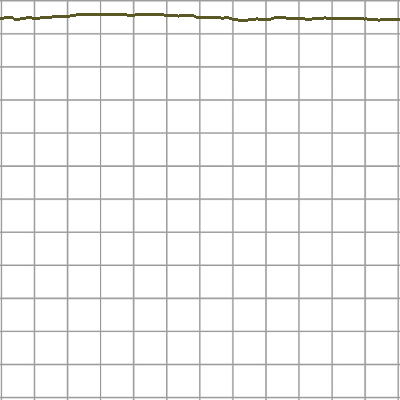

pitch80_thick0_color2_0_train.png


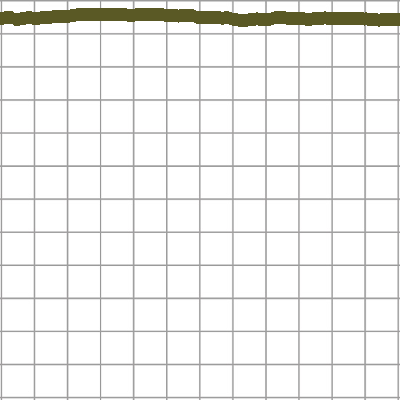

pitch80_thick1_color2_0_train.png


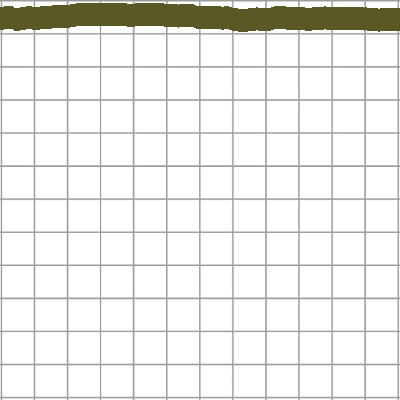

pitch80_thick2_color2_0_train.png


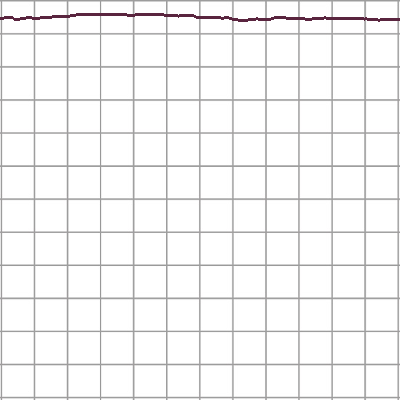

pitch80_thick0_color3_0_train.png


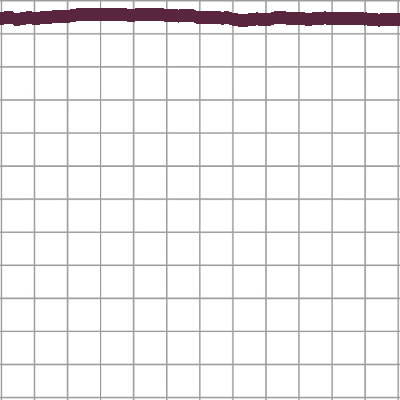

pitch80_thick1_color3_0_train.png


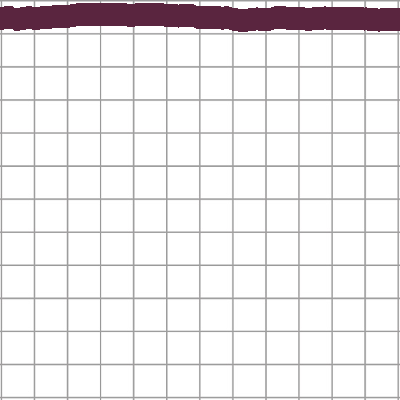

pitch80_thick2_color3_0_train.png


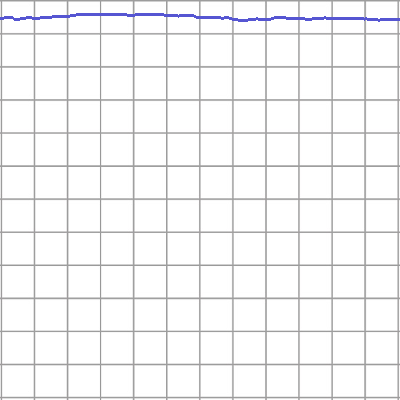

pitch80_thick0_color4_0_train.png


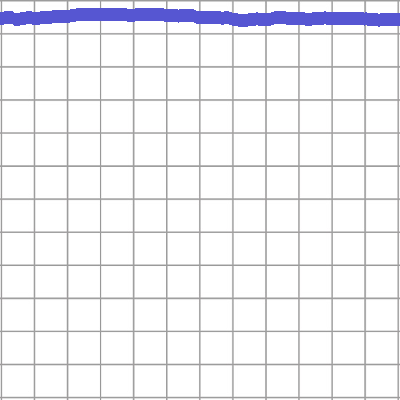

pitch80_thick1_color4_0_train.png


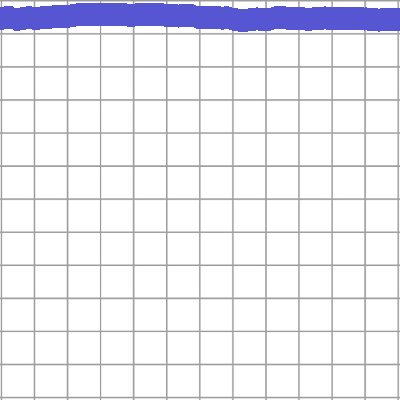

pitch80_thick2_color4_0_train.png


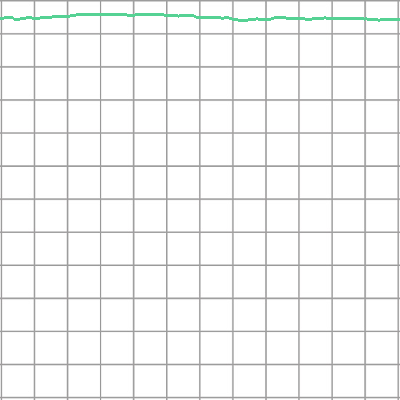

pitch80_thick0_color5_0_train.png


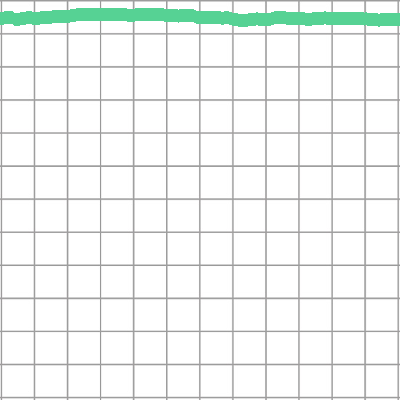

pitch80_thick1_color5_0_train.png


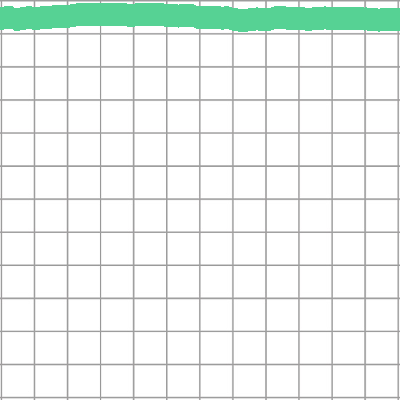

pitch80_thick2_color5_0_train.png


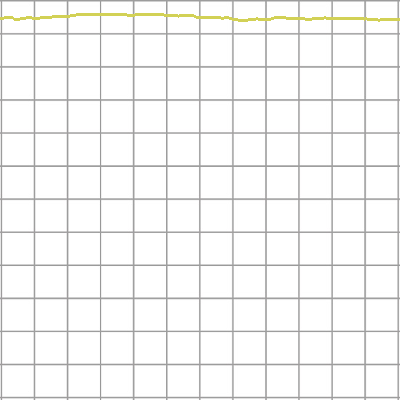

pitch80_thick0_color6_0_train.png


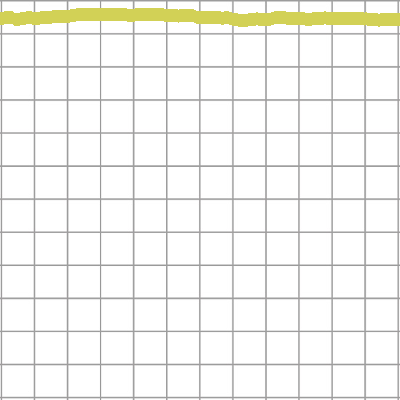

pitch80_thick1_color6_0_train.png


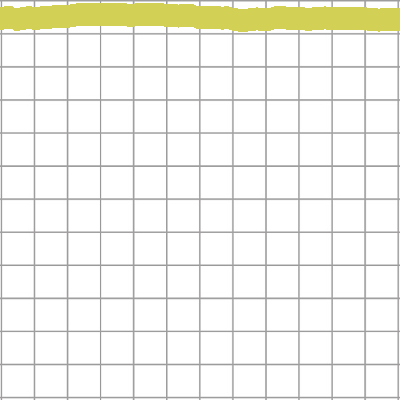

pitch80_thick2_color6_0_train.png


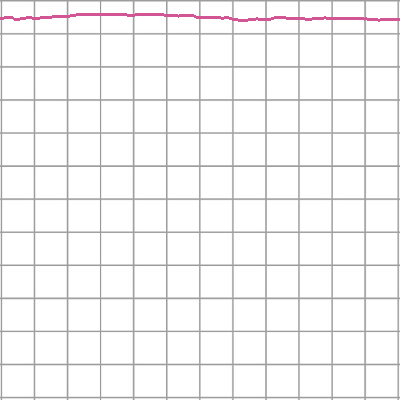

pitch80_thick0_color7_0_train.png


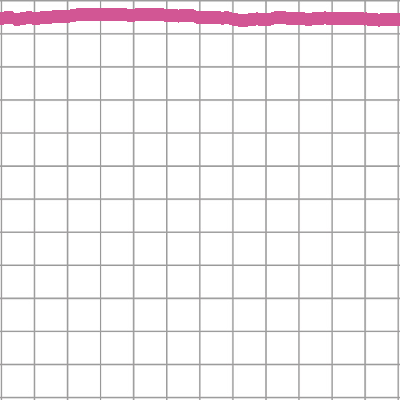

pitch80_thick1_color7_0_train.png


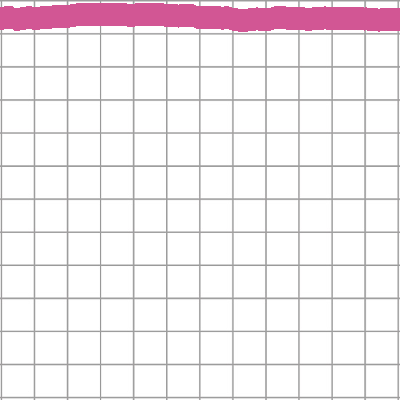

pitch80_thick2_color7_0_train.png


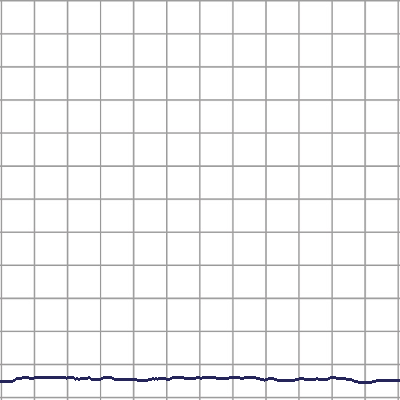

pitch69_thick0_color0_1_train.png


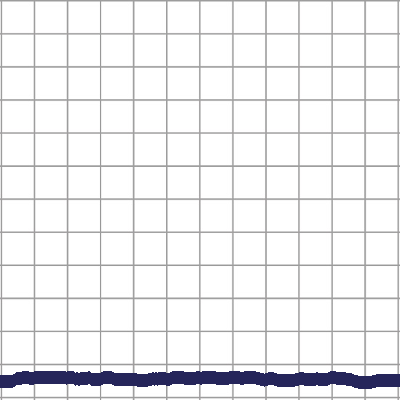

pitch69_thick1_color0_1_train.png


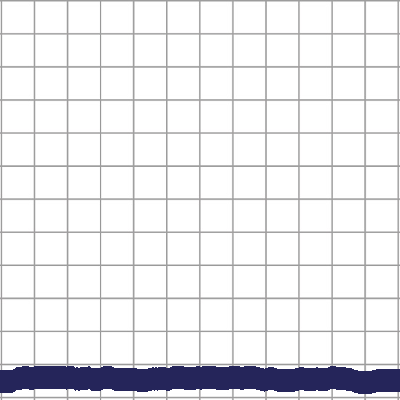

pitch69_thick2_color0_1_train.png


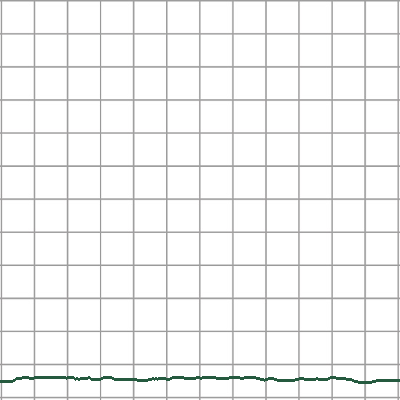

pitch69_thick0_color1_1_train.png


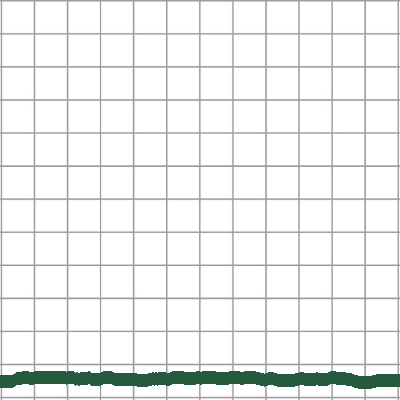

pitch69_thick1_color1_1_train.png


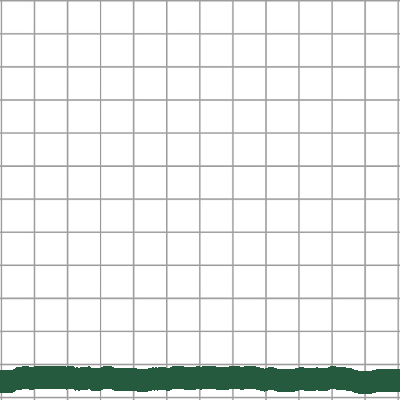

pitch69_thick2_color1_1_train.png


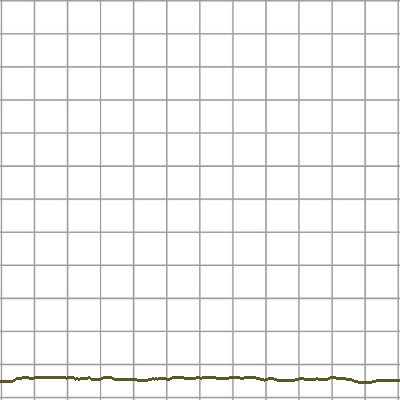

pitch69_thick0_color2_1_train.png


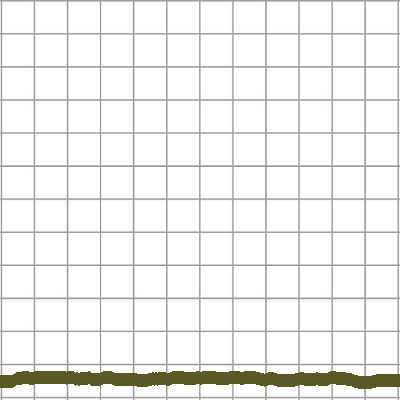

pitch69_thick1_color2_1_train.png


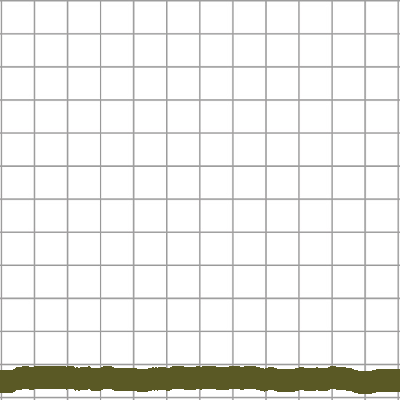

pitch69_thick2_color2_1_train.png


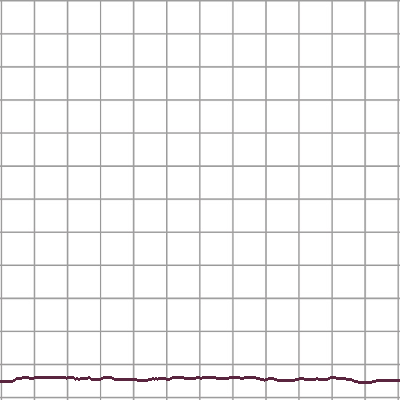

pitch69_thick0_color3_1_train.png


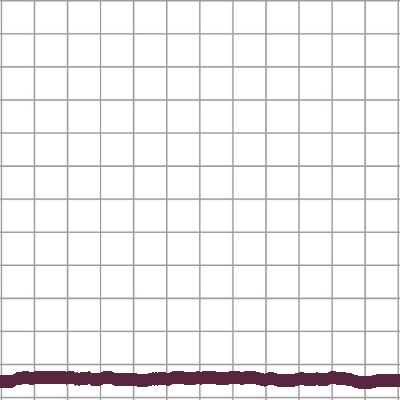

pitch69_thick1_color3_1_train.png


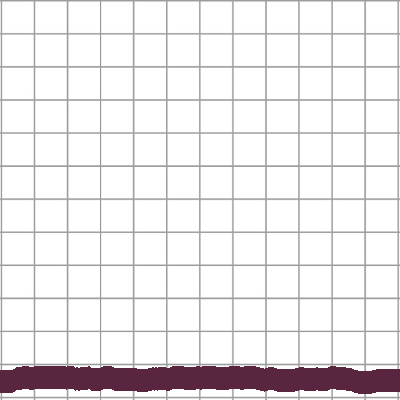

pitch69_thick2_color3_1_train.png


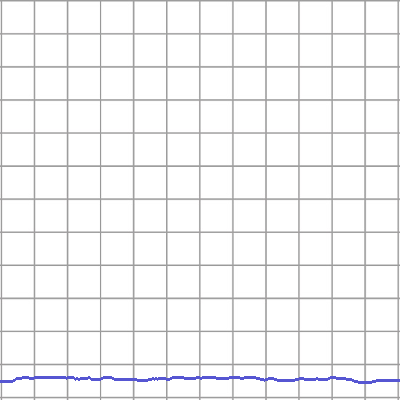

pitch69_thick0_color4_1_train.png


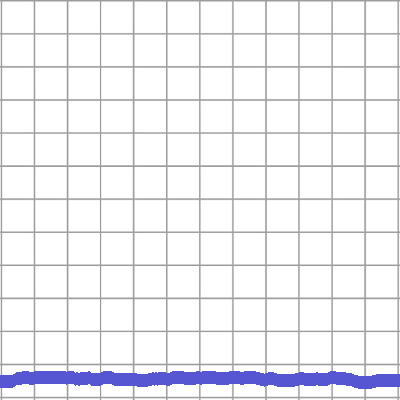

pitch69_thick1_color4_1_train.png


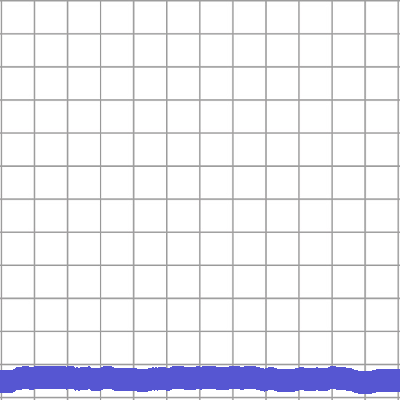

pitch69_thick2_color4_1_train.png


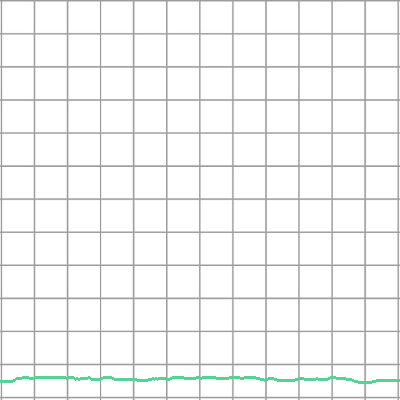

pitch69_thick0_color5_1_train.png


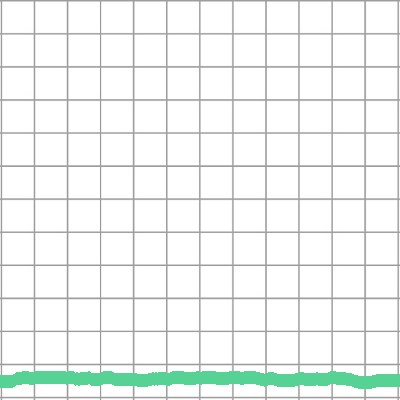

pitch69_thick1_color5_1_train.png


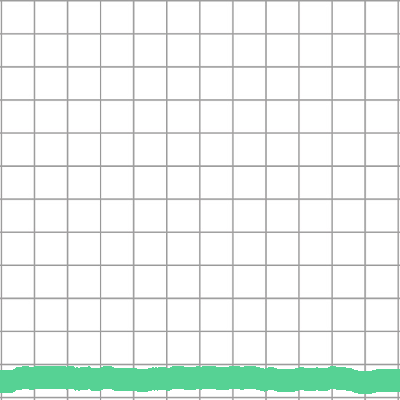

pitch69_thick2_color5_1_train.png


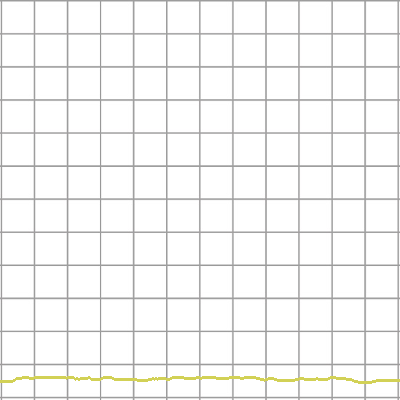

pitch69_thick0_color6_1_train.png


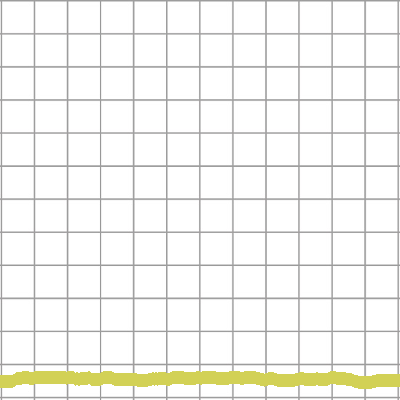

pitch69_thick1_color6_1_train.png


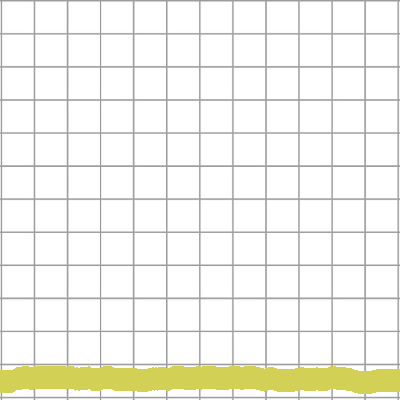

pitch69_thick2_color6_1_train.png


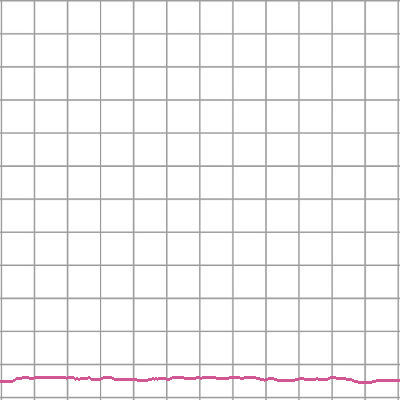

pitch69_thick0_color7_1_train.png


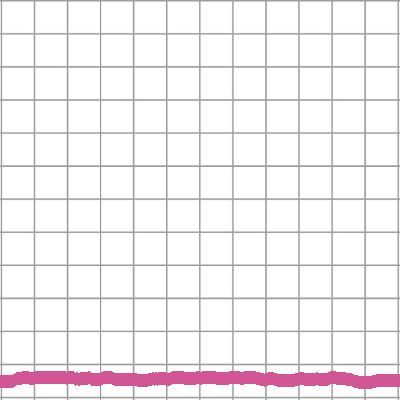

pitch69_thick1_color7_1_train.png


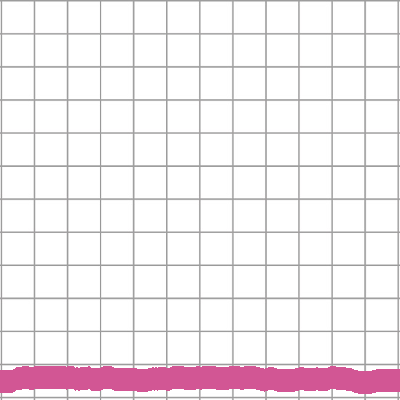

pitch69_thick2_color7_1_train.png


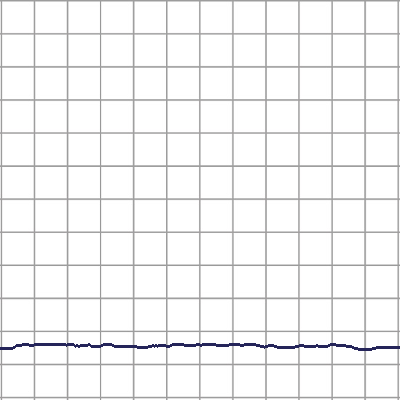

pitch70_thick0_color0_1_train.png


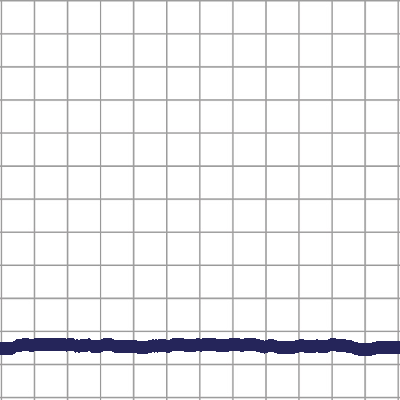

pitch70_thick1_color0_1_train.png


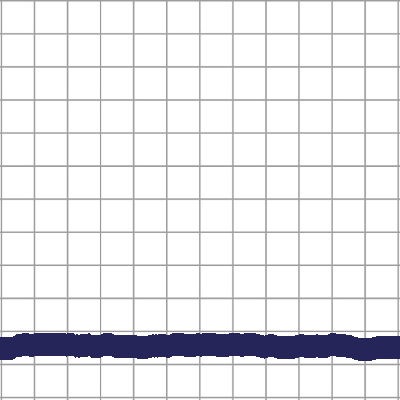

pitch70_thick2_color0_1_train.png


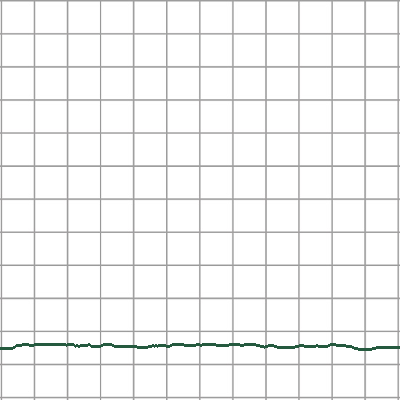

pitch70_thick0_color1_1_train.png


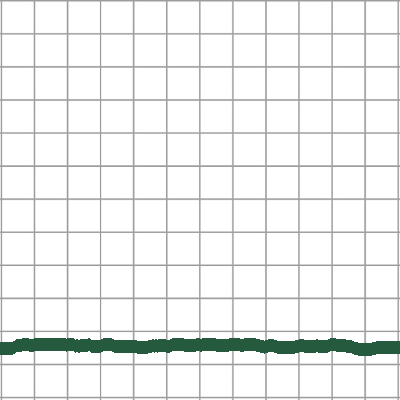

pitch70_thick1_color1_1_train.png


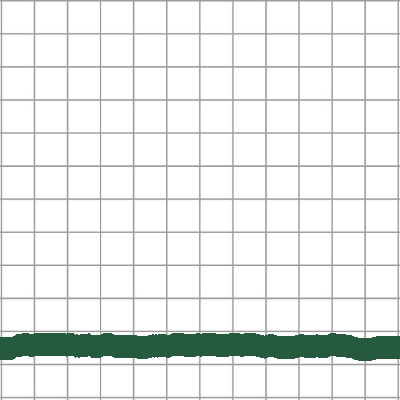

pitch70_thick2_color1_1_train.png


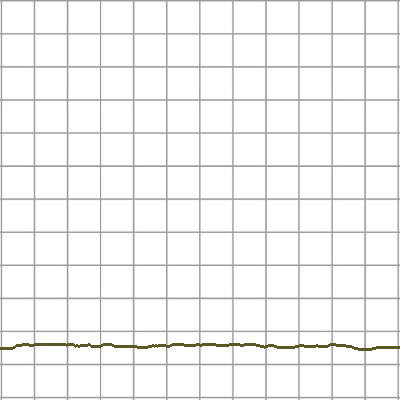

pitch70_thick0_color2_1_train.png


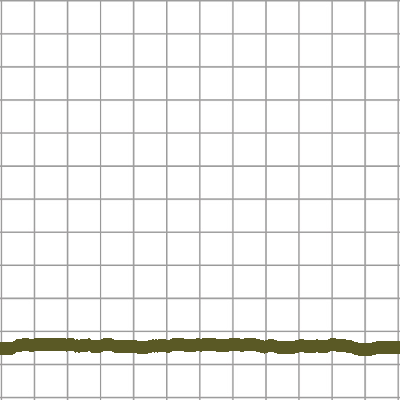

pitch70_thick1_color2_1_train.png


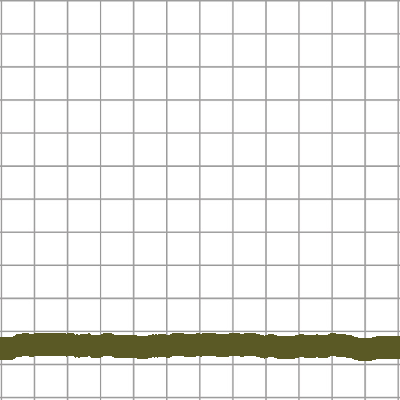

pitch70_thick2_color2_1_train.png


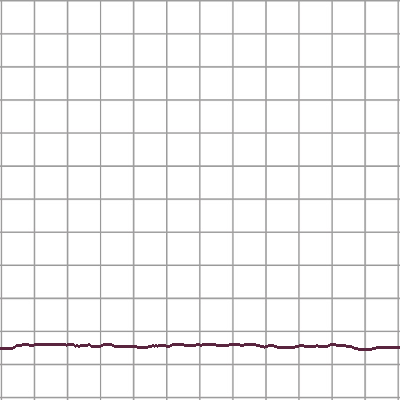

pitch70_thick0_color3_1_train.png


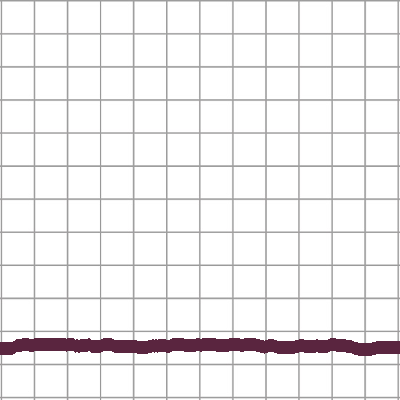

pitch70_thick1_color3_1_train.png


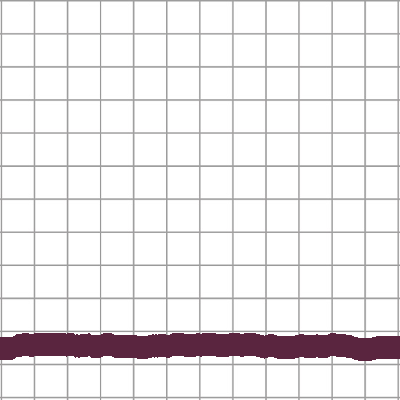

pitch70_thick2_color3_1_train.png


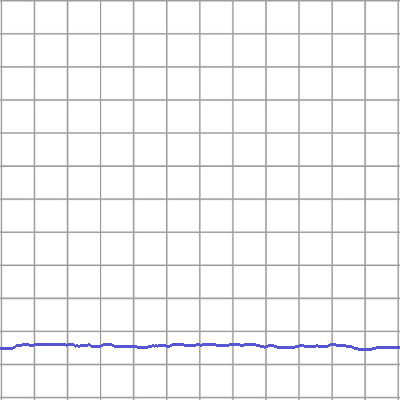

pitch70_thick0_color4_1_train.png


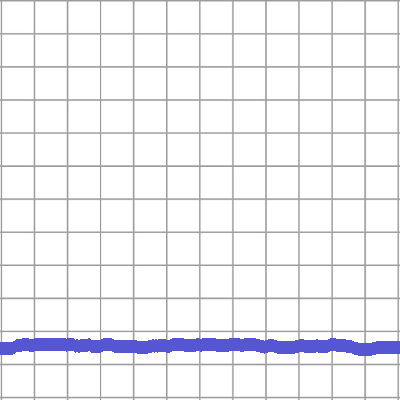

pitch70_thick1_color4_1_train.png


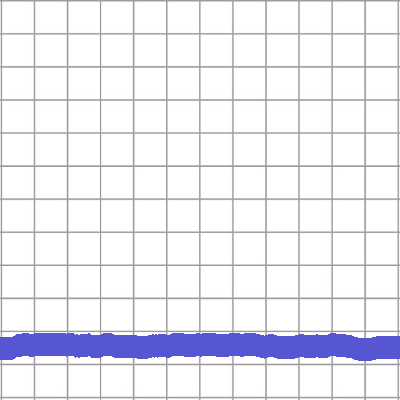

pitch70_thick2_color4_1_train.png


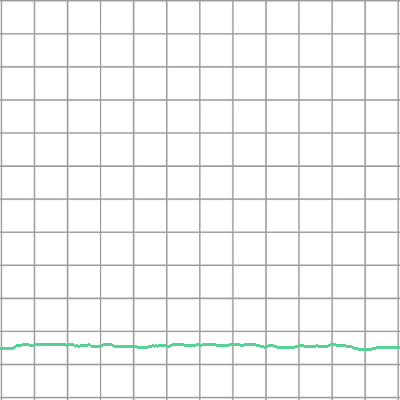

pitch70_thick0_color5_1_train.png


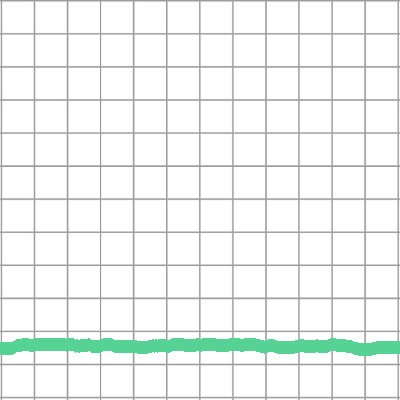

pitch70_thick1_color5_1_train.png


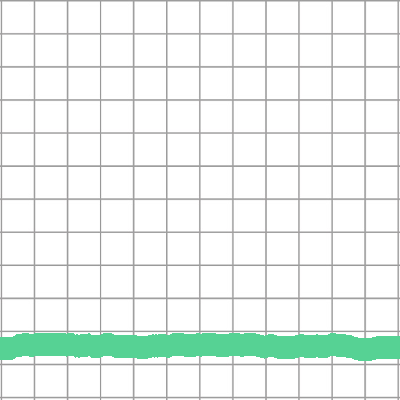

pitch70_thick2_color5_1_train.png


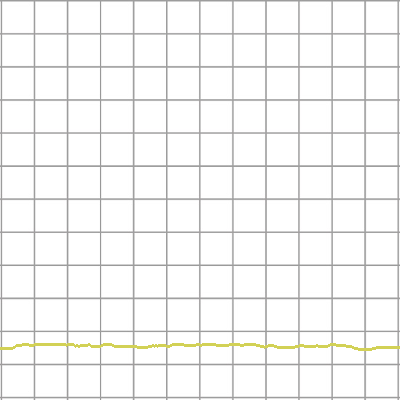

pitch70_thick0_color6_1_train.png


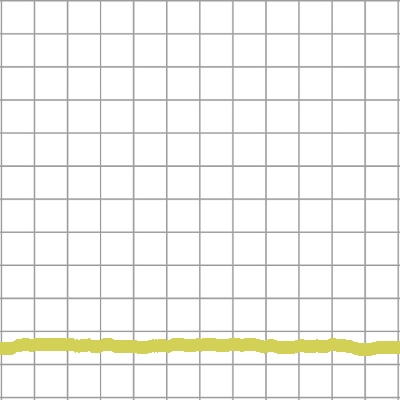

pitch70_thick1_color6_1_train.png


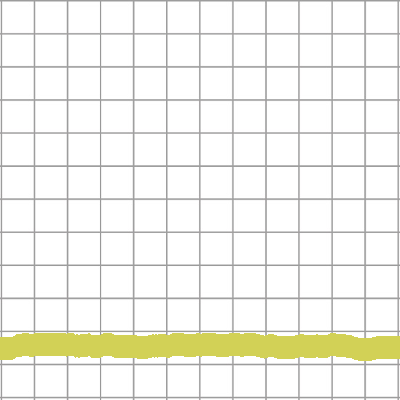

pitch70_thick2_color6_1_train.png


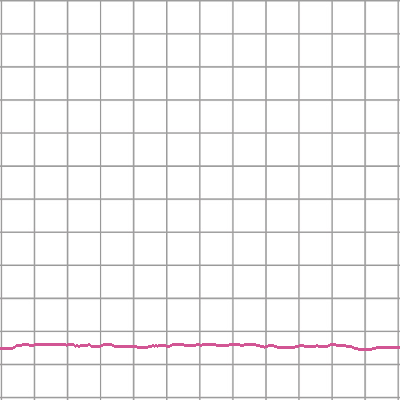

pitch70_thick0_color7_1_train.png


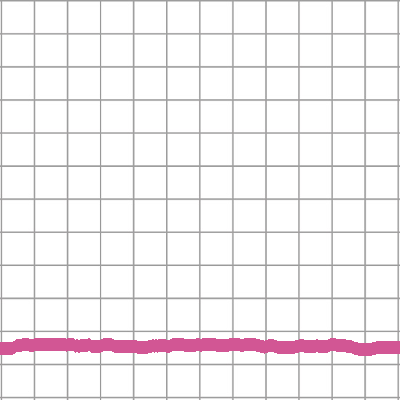

pitch70_thick1_color7_1_train.png


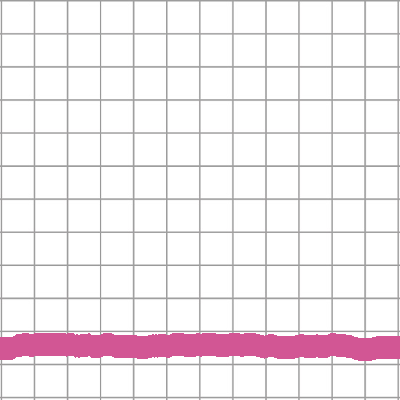

pitch70_thick2_color7_1_train.png


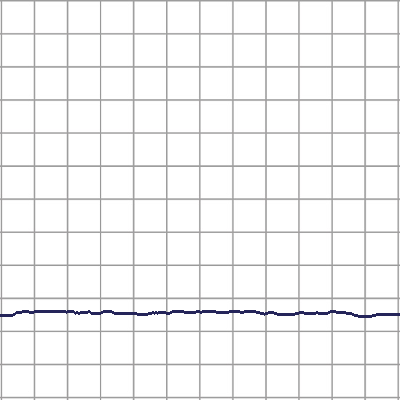

pitch71_thick0_color0_1_train.png


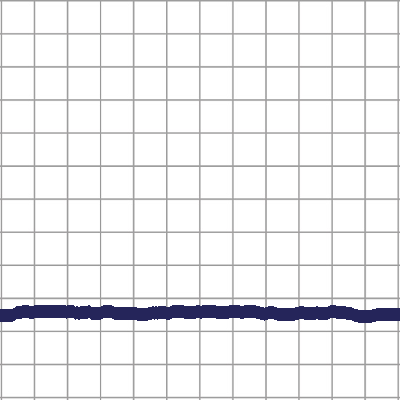

pitch71_thick1_color0_1_train.png


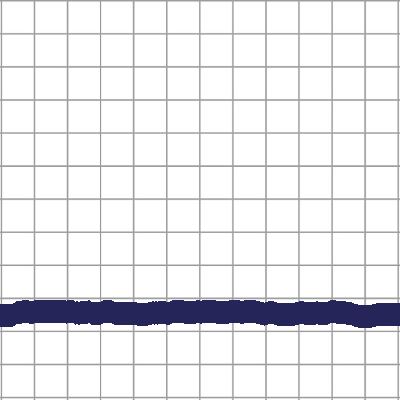

pitch71_thick2_color0_1_train.png


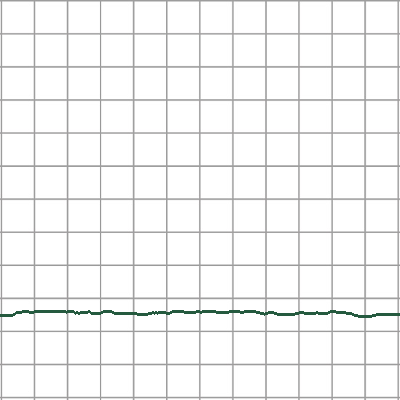

pitch71_thick0_color1_1_train.png


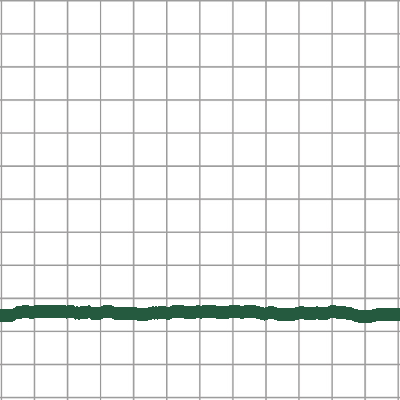

pitch71_thick1_color1_1_train.png


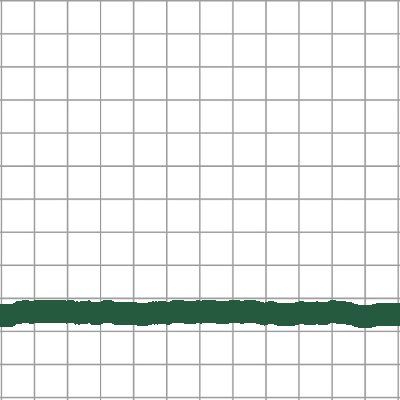

pitch71_thick2_color1_1_train.png


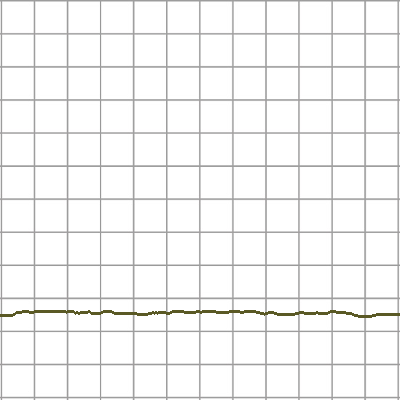

pitch71_thick0_color2_1_train.png


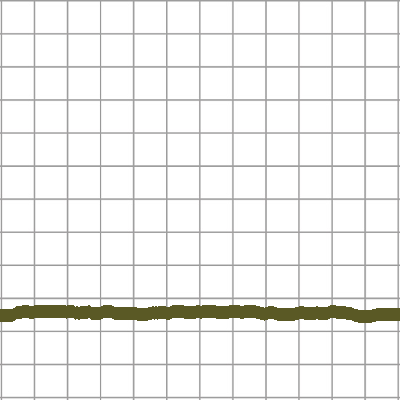

pitch71_thick1_color2_1_train.png


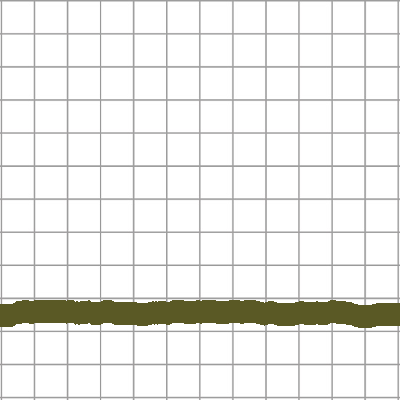

pitch71_thick2_color2_1_train.png


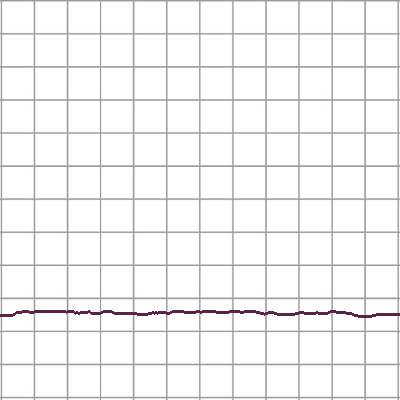

pitch71_thick0_color3_1_train.png


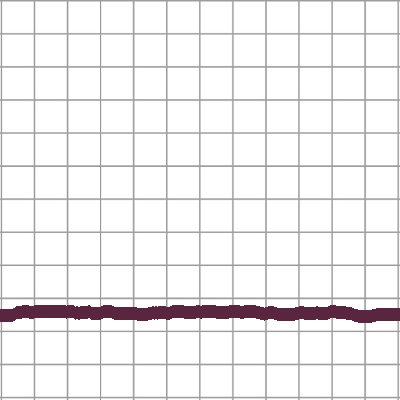

pitch71_thick1_color3_1_train.png


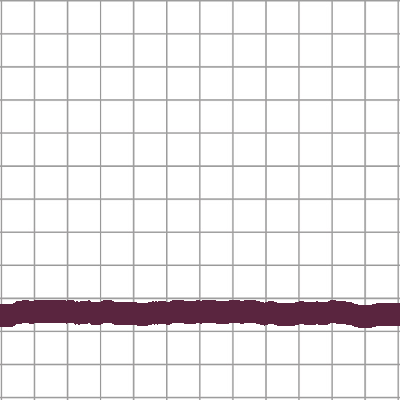

pitch71_thick2_color3_1_train.png


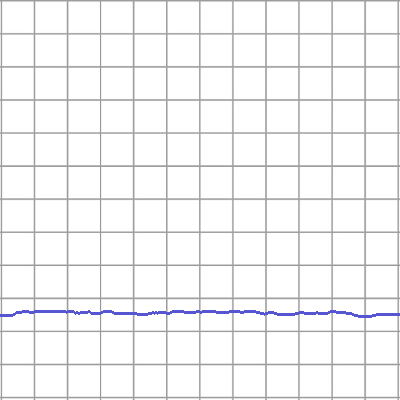

pitch71_thick0_color4_1_train.png


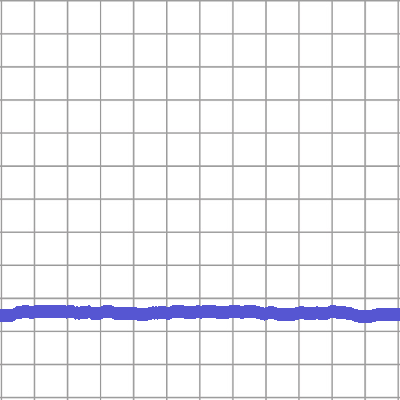

pitch71_thick1_color4_1_train.png


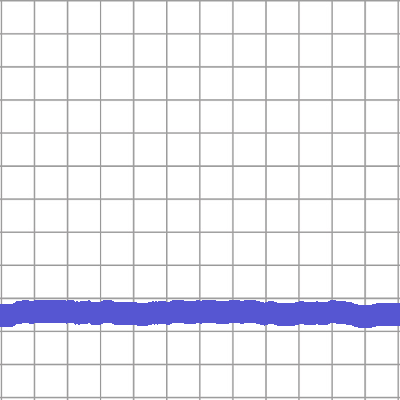

pitch71_thick2_color4_1_train.png


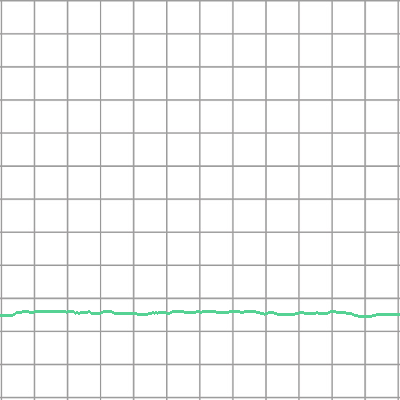

pitch71_thick0_color5_1_train.png


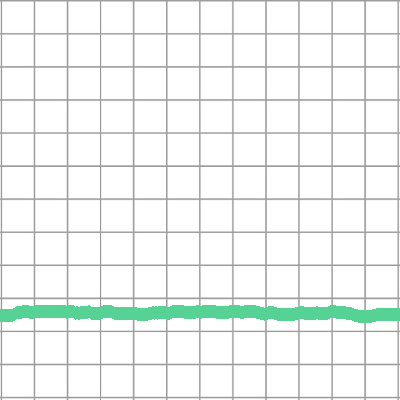

pitch71_thick1_color5_1_train.png


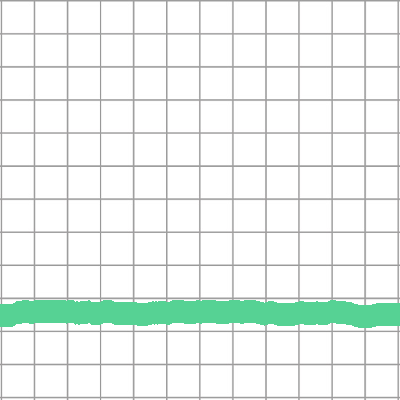

pitch71_thick2_color5_1_train.png


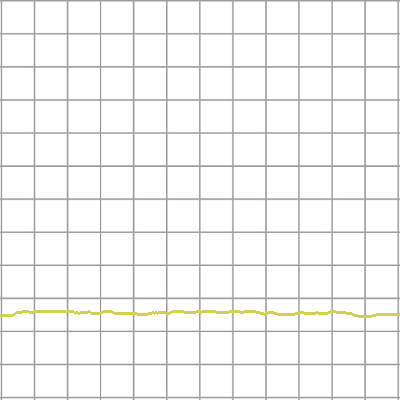

pitch71_thick0_color6_1_train.png


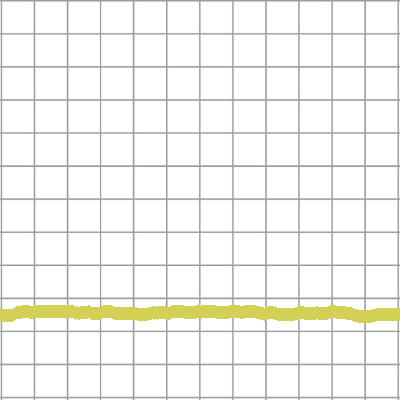

pitch71_thick1_color6_1_train.png


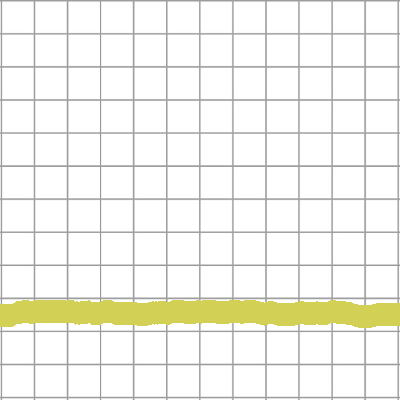

pitch71_thick2_color6_1_train.png


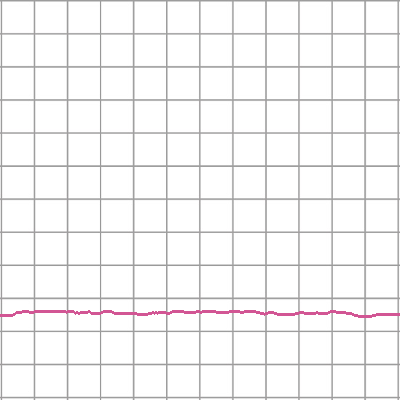

pitch71_thick0_color7_1_train.png


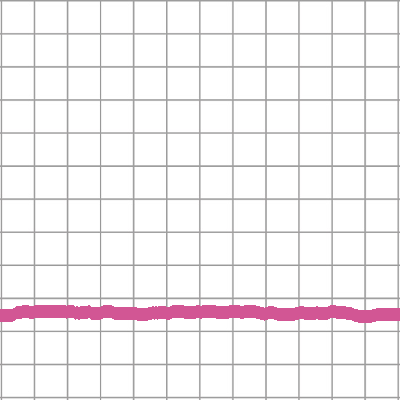

pitch71_thick1_color7_1_train.png


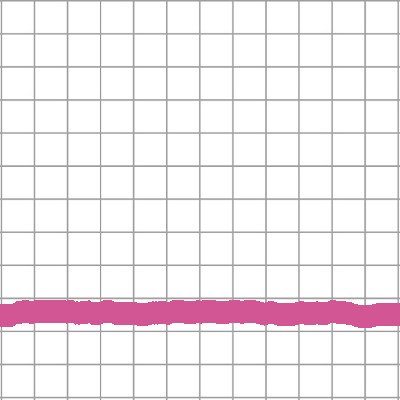

pitch71_thick2_color7_1_train.png


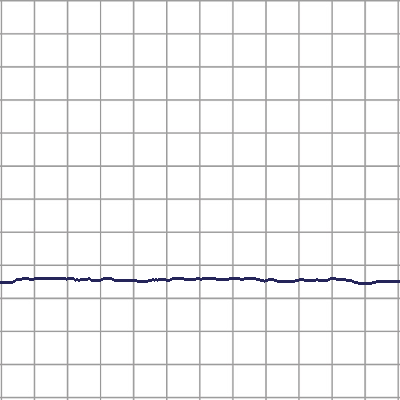

pitch72_thick0_color0_1_train.png


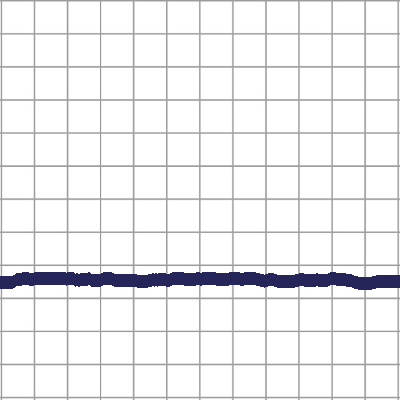

pitch72_thick1_color0_1_train.png


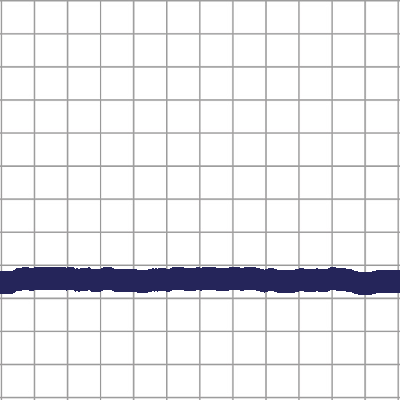

pitch72_thick2_color0_1_train.png


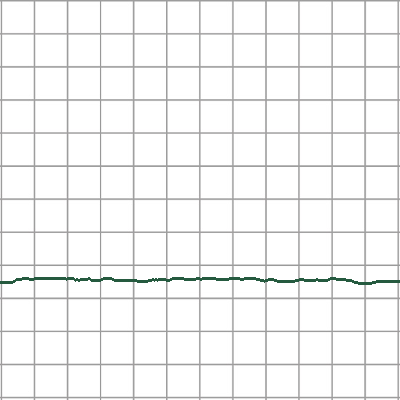

pitch72_thick0_color1_1_train.png


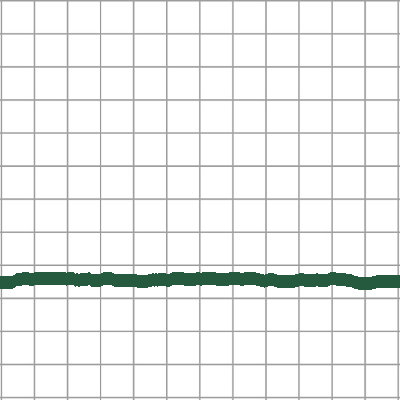

pitch72_thick1_color1_1_train.png


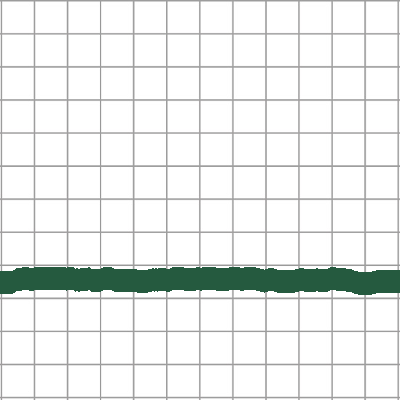

pitch72_thick2_color1_1_train.png


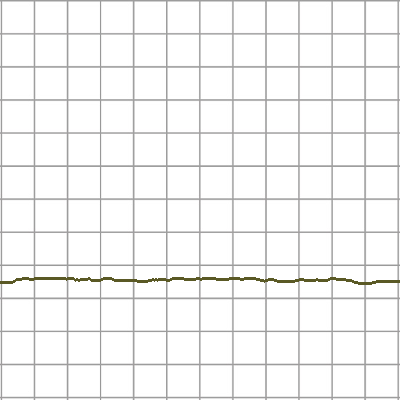

pitch72_thick0_color2_1_train.png


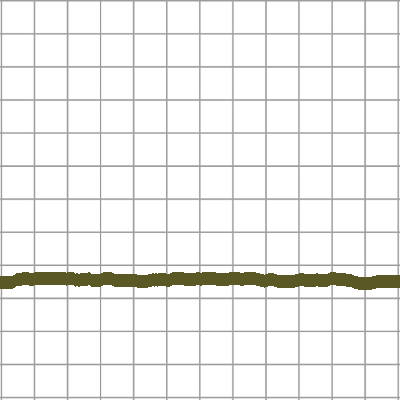

pitch72_thick1_color2_1_train.png


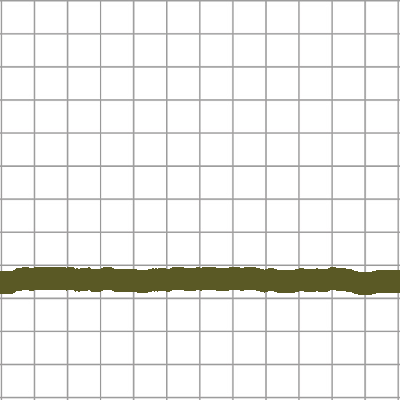

pitch72_thick2_color2_1_train.png


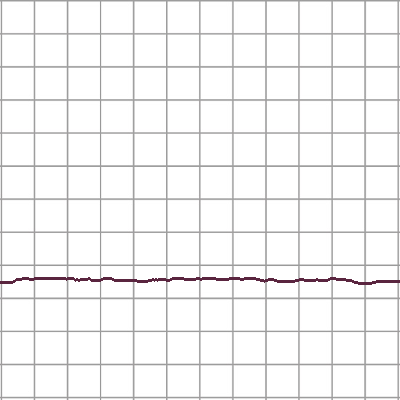

pitch72_thick0_color3_1_train.png


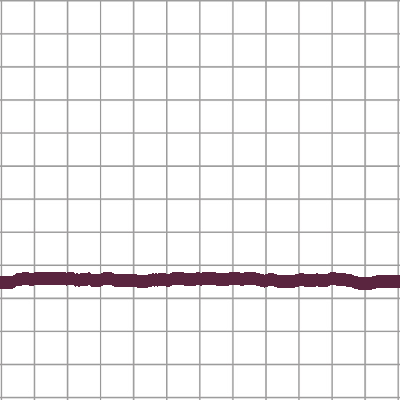

pitch72_thick1_color3_1_train.png


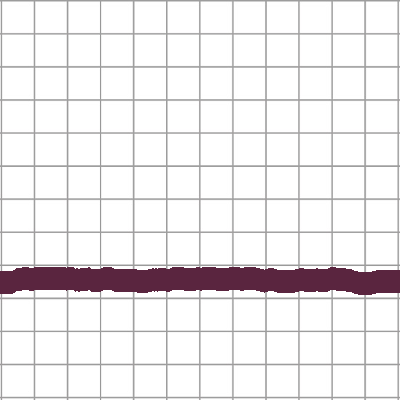

pitch72_thick2_color3_1_train.png


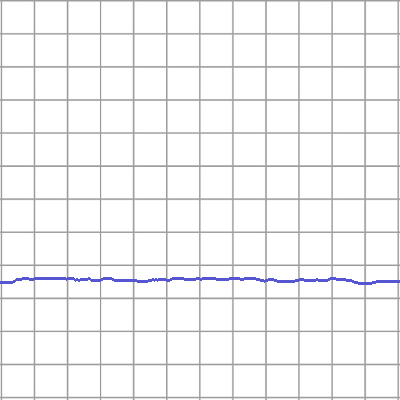

pitch72_thick0_color4_1_train.png


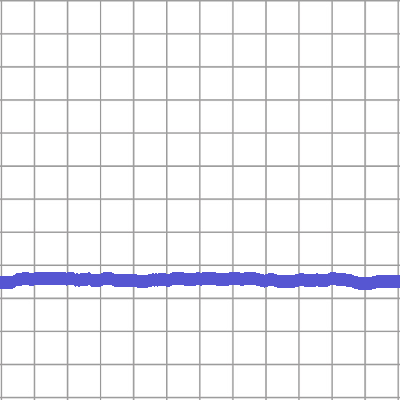

pitch72_thick1_color4_1_train.png


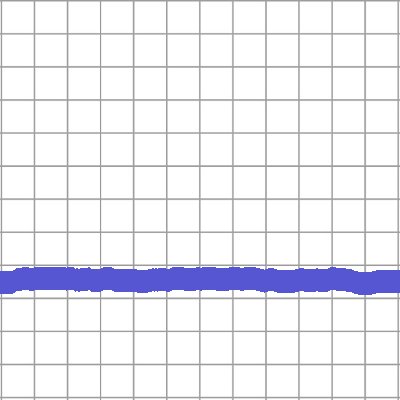

pitch72_thick2_color4_1_train.png


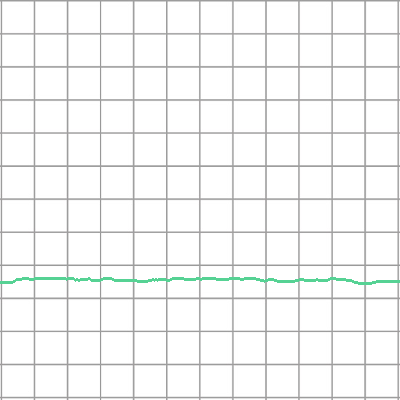

pitch72_thick0_color5_1_train.png


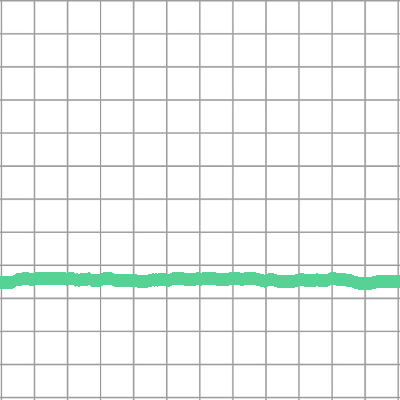

pitch72_thick1_color5_1_train.png


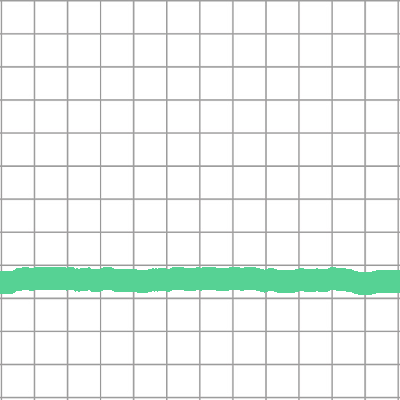

pitch72_thick2_color5_1_train.png


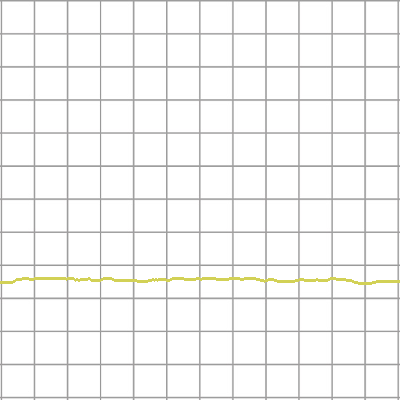

pitch72_thick0_color6_1_train.png


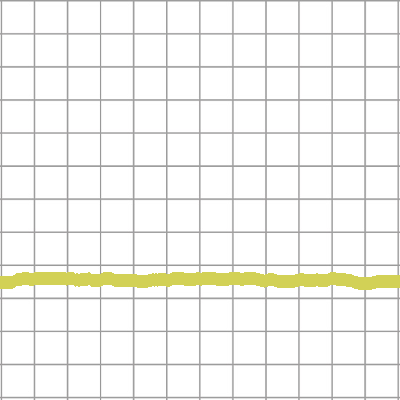

pitch72_thick1_color6_1_train.png


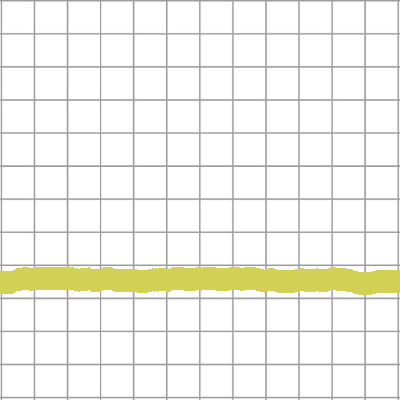

pitch72_thick2_color6_1_train.png


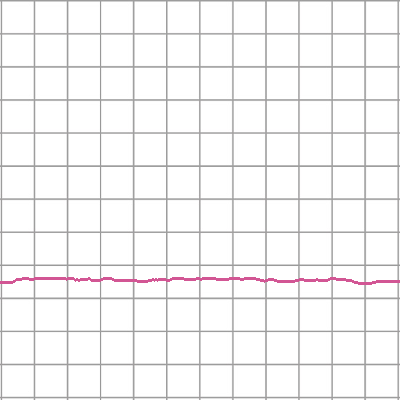

pitch72_thick0_color7_1_train.png


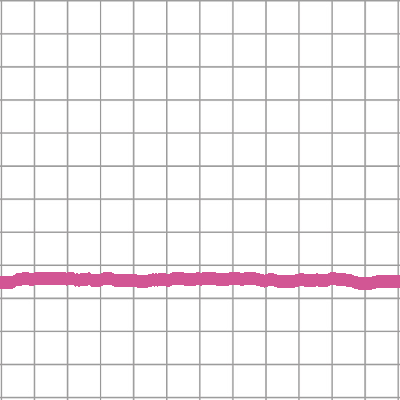

pitch72_thick1_color7_1_train.png


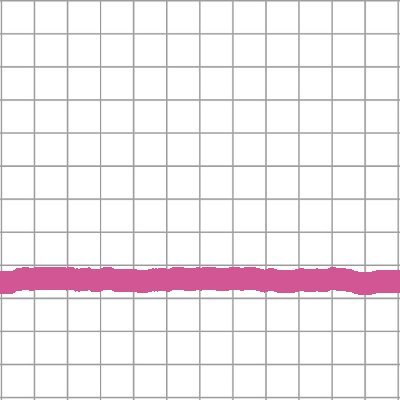

pitch72_thick2_color7_1_train.png


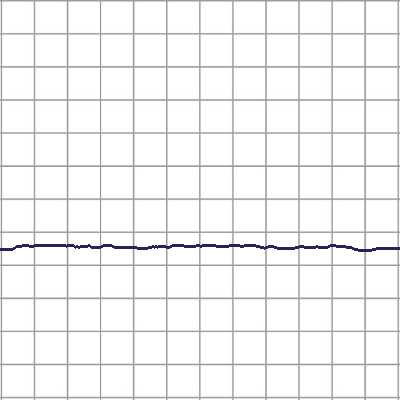

pitch73_thick0_color0_1_train.png


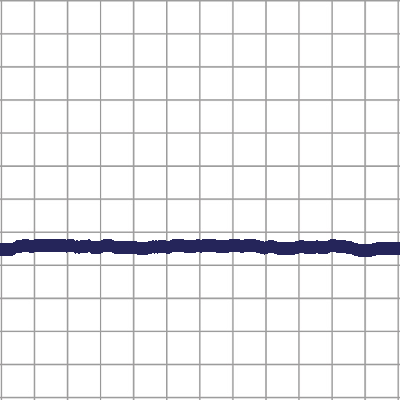

pitch73_thick1_color0_1_train.png


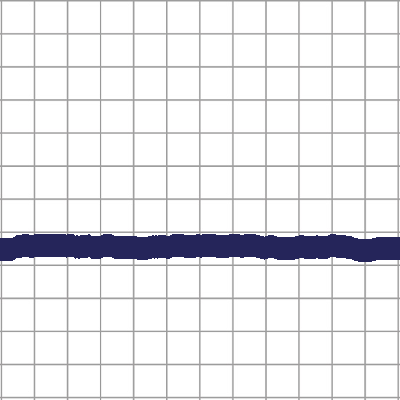

pitch73_thick2_color0_1_train.png


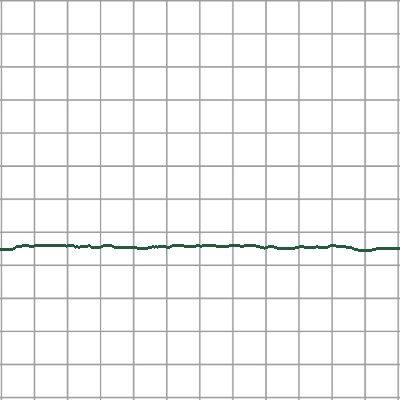

pitch73_thick0_color1_1_train.png


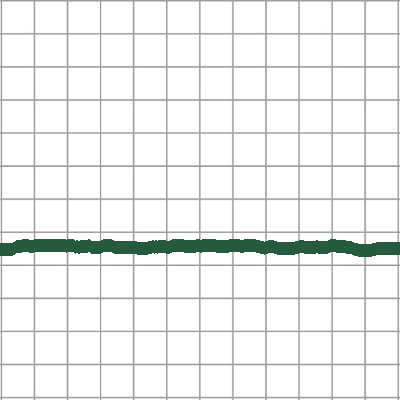

pitch73_thick1_color1_1_train.png


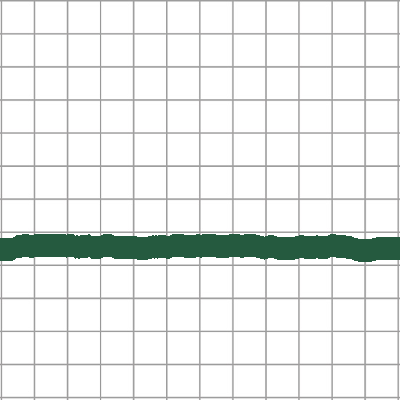

pitch73_thick2_color1_1_train.png


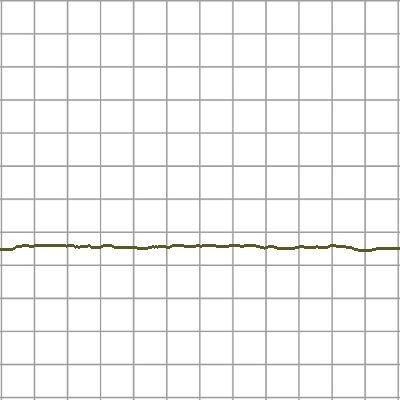

pitch73_thick0_color2_1_train.png


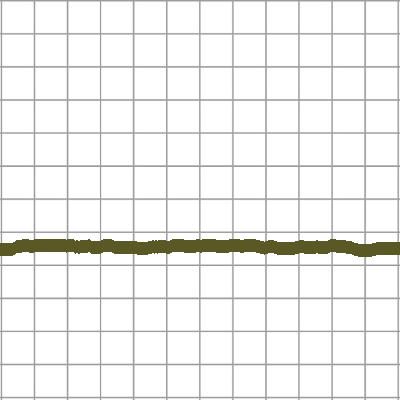

pitch73_thick1_color2_1_train.png


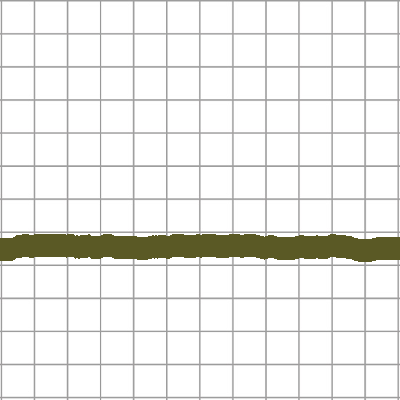

pitch73_thick2_color2_1_train.png


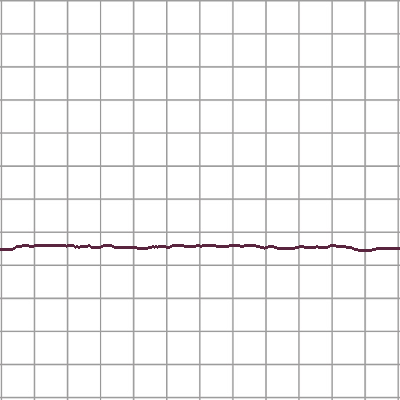

pitch73_thick0_color3_1_train.png


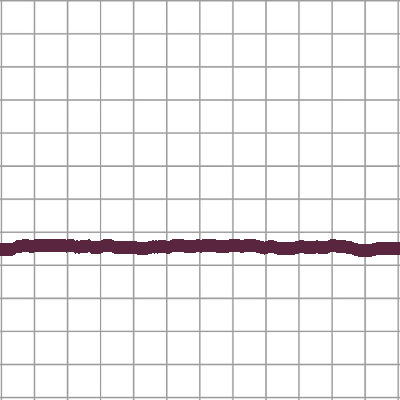

pitch73_thick1_color3_1_train.png


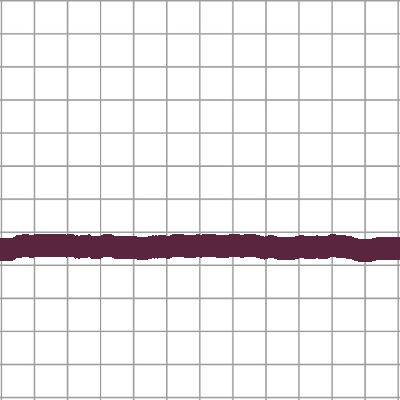

pitch73_thick2_color3_1_train.png


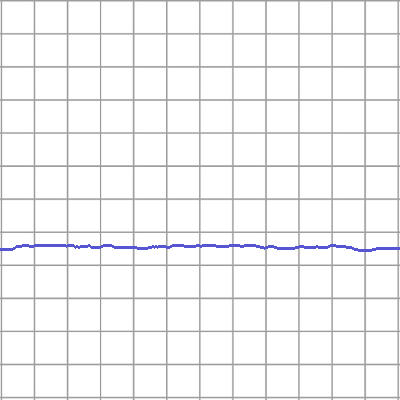

pitch73_thick0_color4_1_train.png


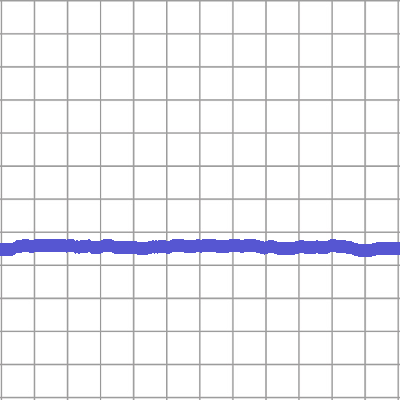

pitch73_thick1_color4_1_train.png


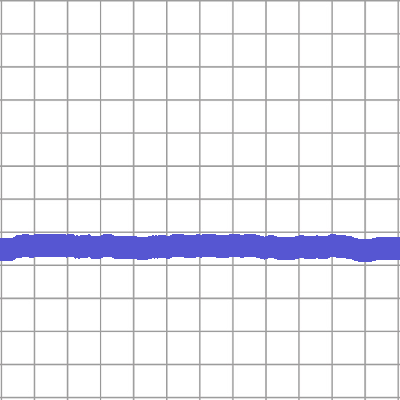

pitch73_thick2_color4_1_train.png


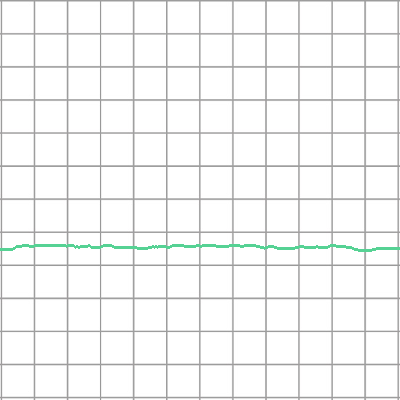

pitch73_thick0_color5_1_train.png


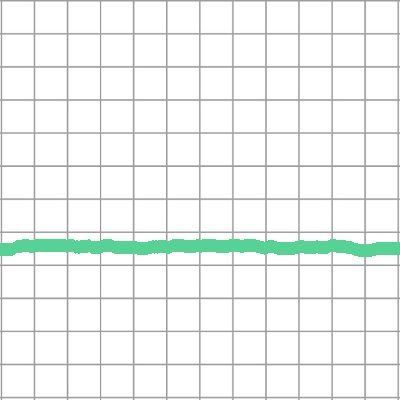

pitch73_thick1_color5_1_train.png


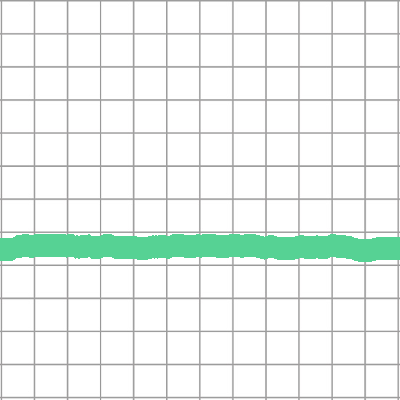

pitch73_thick2_color5_1_train.png


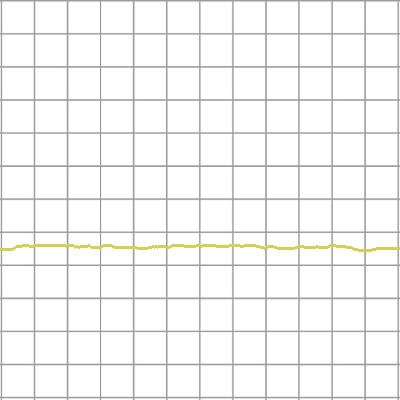

pitch73_thick0_color6_1_train.png


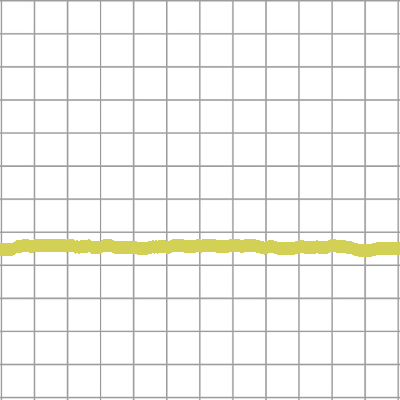

pitch73_thick1_color6_1_train.png


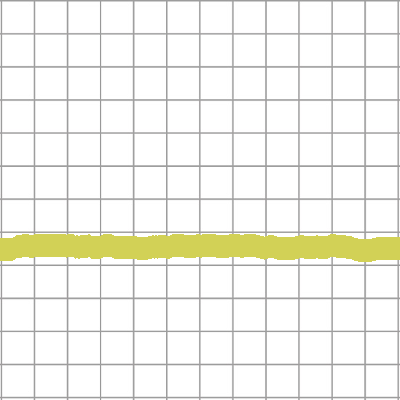

pitch73_thick2_color6_1_train.png


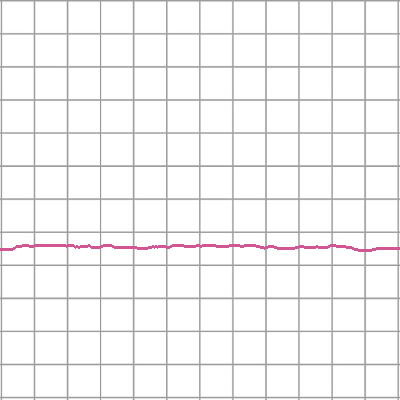

pitch73_thick0_color7_1_train.png


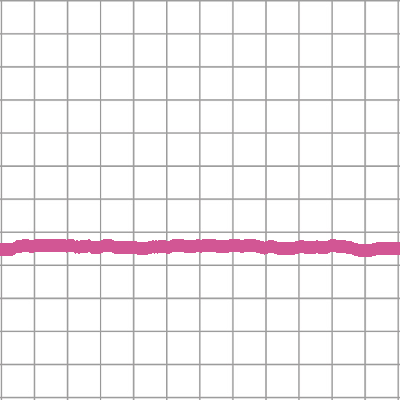

pitch73_thick1_color7_1_train.png


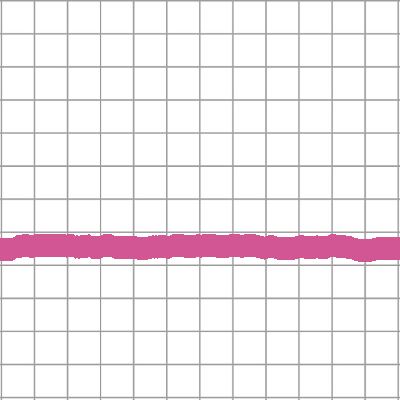

pitch73_thick2_color7_1_train.png


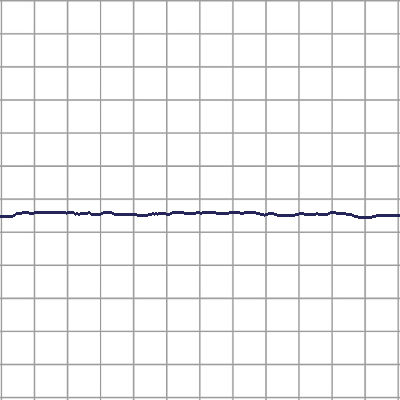

pitch74_thick0_color0_1_train.png


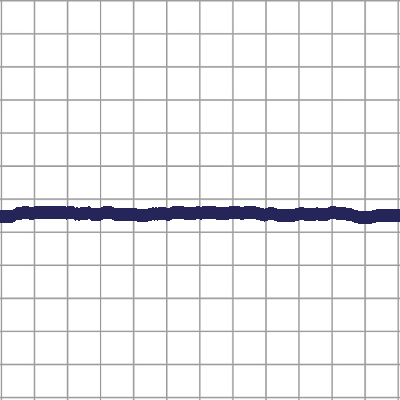

pitch74_thick1_color0_1_train.png


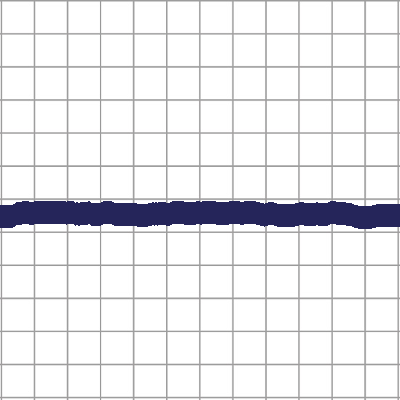

pitch74_thick2_color0_1_train.png


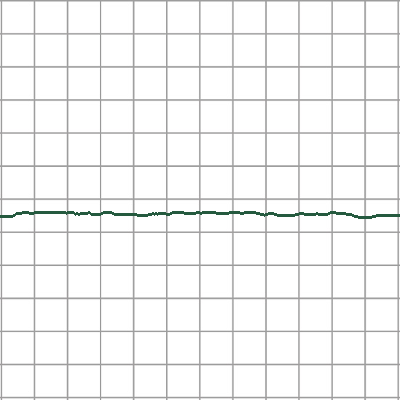

pitch74_thick0_color1_1_train.png


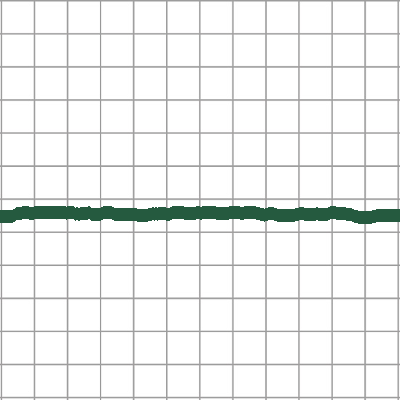

pitch74_thick1_color1_1_train.png


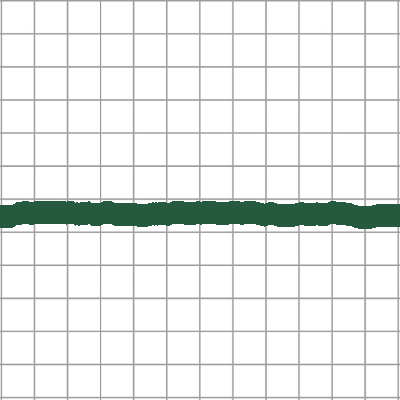

pitch74_thick2_color1_1_train.png


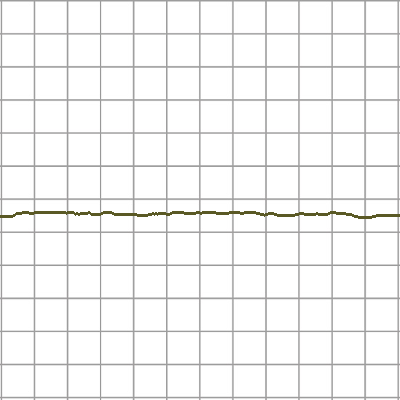

pitch74_thick0_color2_1_train.png


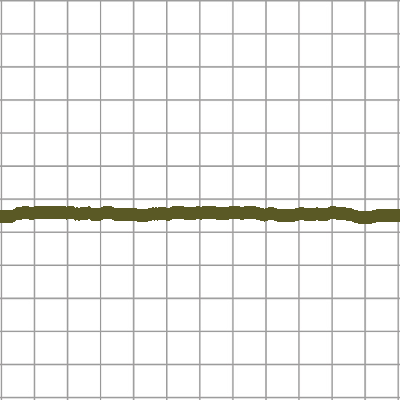

pitch74_thick1_color2_1_train.png


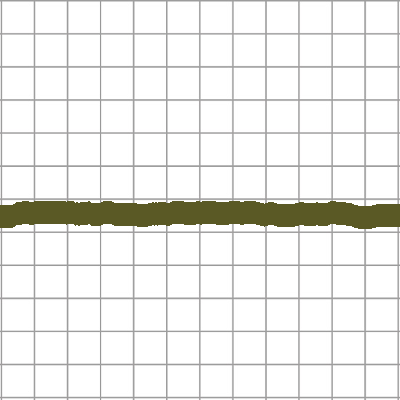

pitch74_thick2_color2_1_train.png


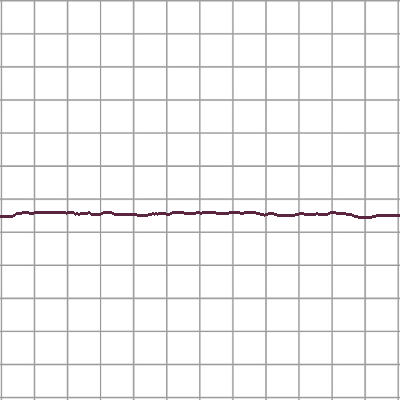

pitch74_thick0_color3_1_train.png


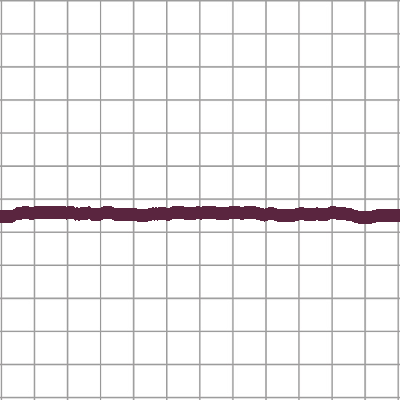

pitch74_thick1_color3_1_train.png


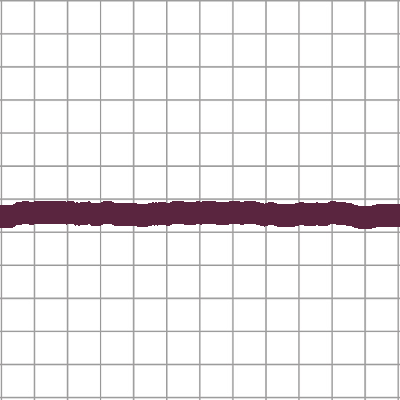

pitch74_thick2_color3_1_train.png


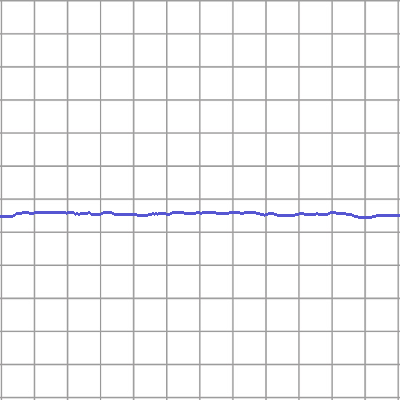

pitch74_thick0_color4_1_train.png


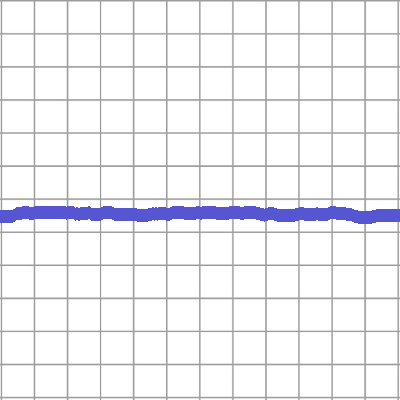

pitch74_thick1_color4_1_train.png


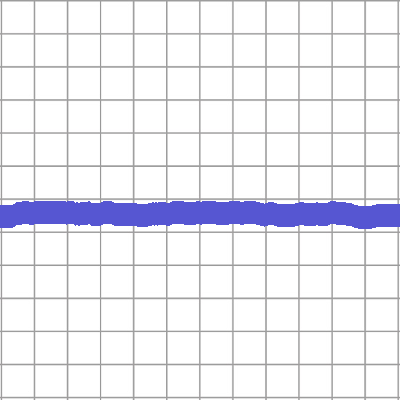

pitch74_thick2_color4_1_train.png


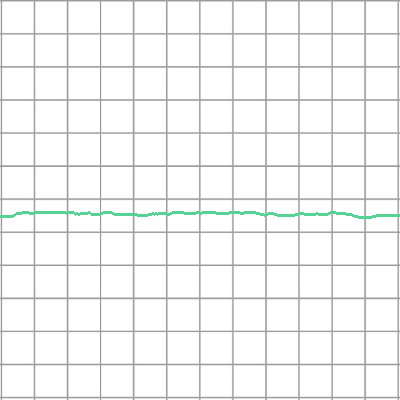

pitch74_thick0_color5_1_train.png


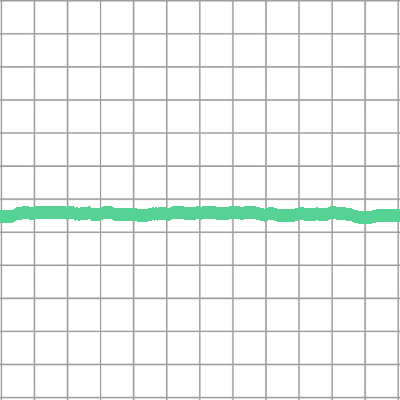

pitch74_thick1_color5_1_train.png


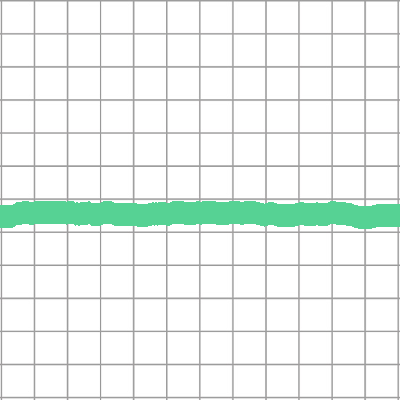

pitch74_thick2_color5_1_train.png


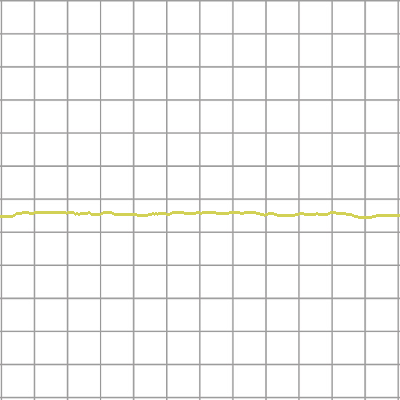

pitch74_thick0_color6_1_train.png


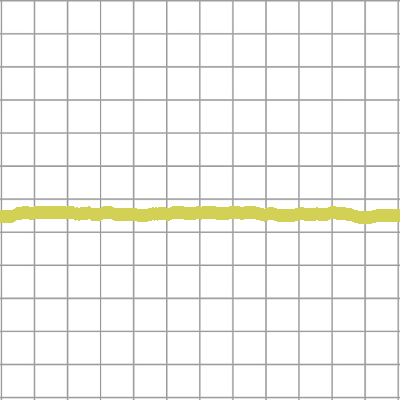

pitch74_thick1_color6_1_train.png


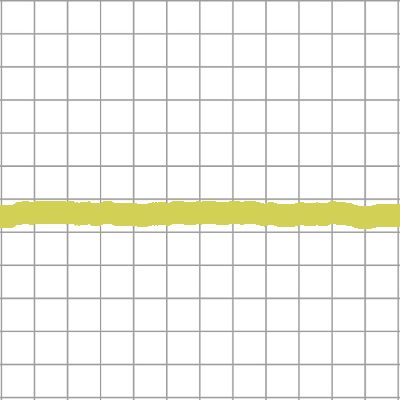

pitch74_thick2_color6_1_train.png


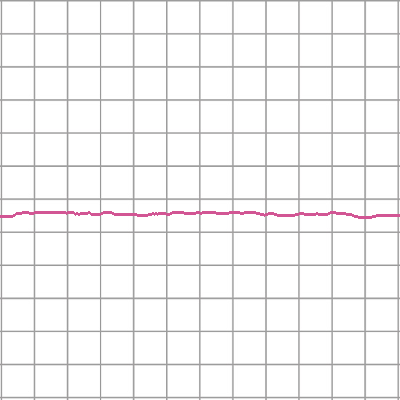

pitch74_thick0_color7_1_train.png


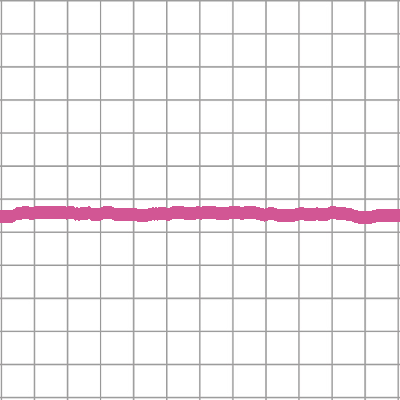

pitch74_thick1_color7_1_train.png


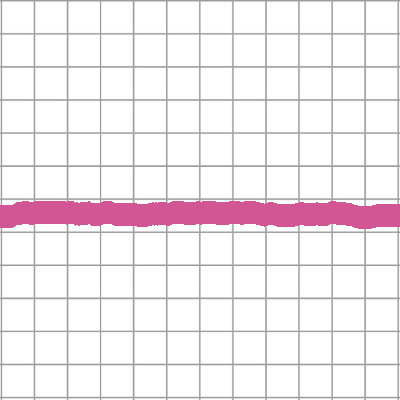

pitch74_thick2_color7_1_train.png


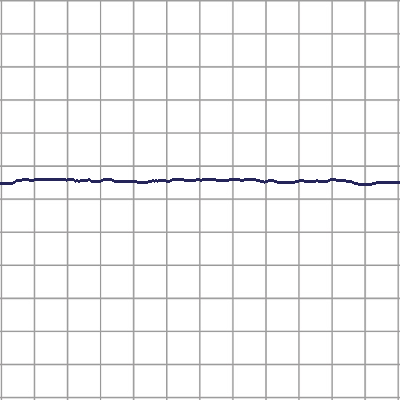

pitch75_thick0_color0_1_train.png


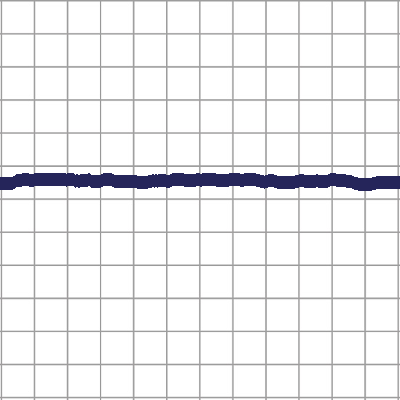

pitch75_thick1_color0_1_train.png


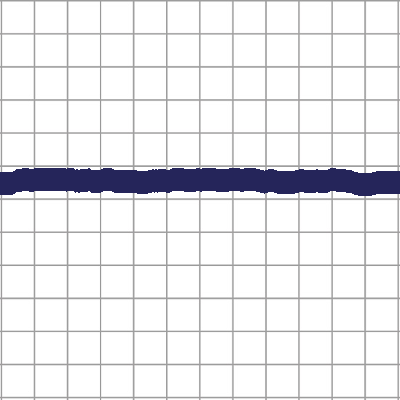

pitch75_thick2_color0_1_train.png


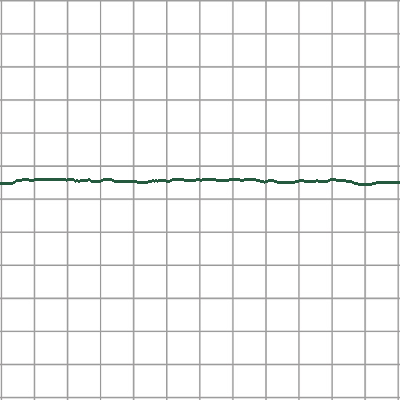

pitch75_thick0_color1_1_train.png


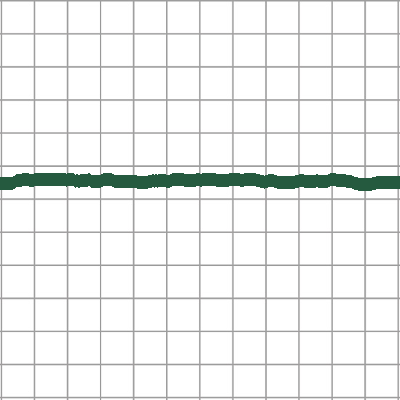

pitch75_thick1_color1_1_train.png


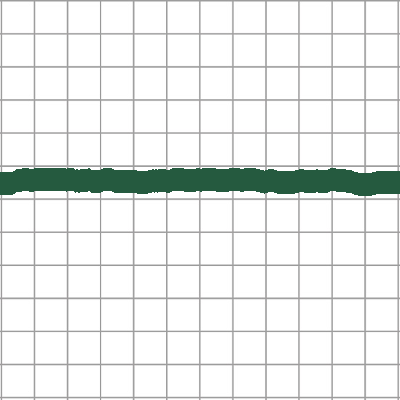

pitch75_thick2_color1_1_train.png


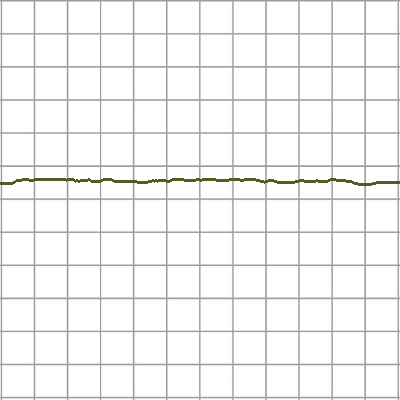

pitch75_thick0_color2_1_train.png


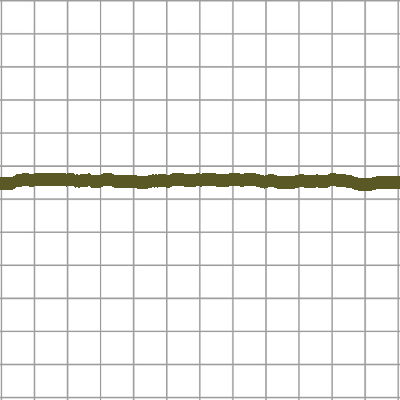

pitch75_thick1_color2_1_train.png


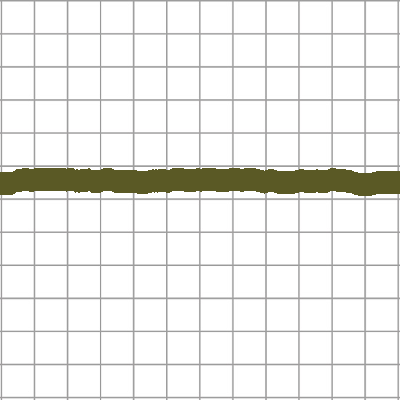

pitch75_thick2_color2_1_train.png


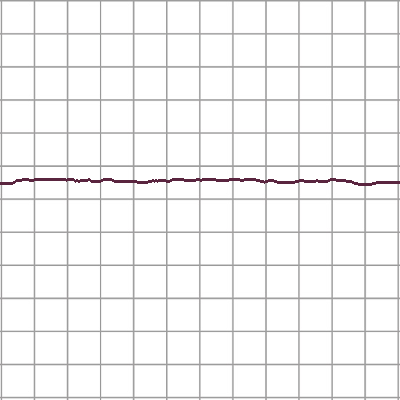

pitch75_thick0_color3_1_train.png


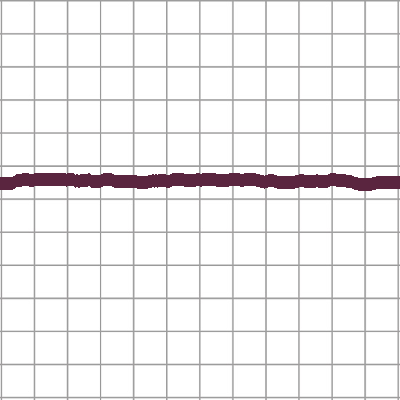

pitch75_thick1_color3_1_train.png


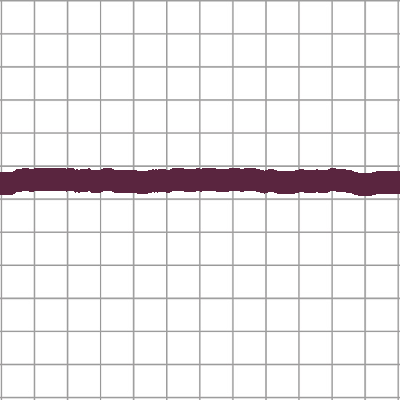

pitch75_thick2_color3_1_train.png


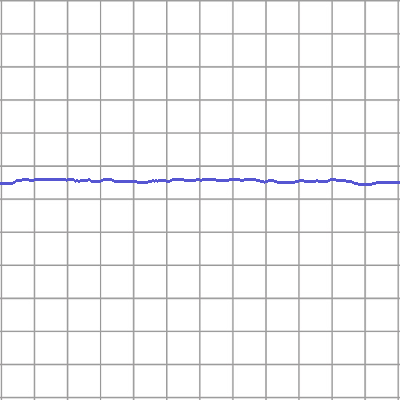

pitch75_thick0_color4_1_train.png


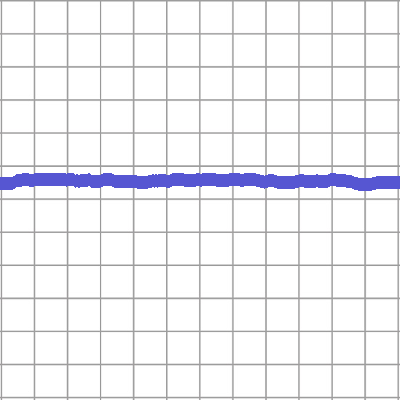

pitch75_thick1_color4_1_train.png


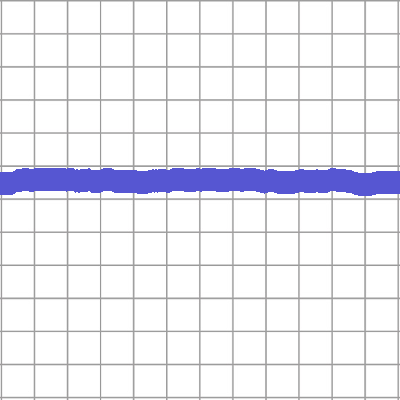

pitch75_thick2_color4_1_train.png


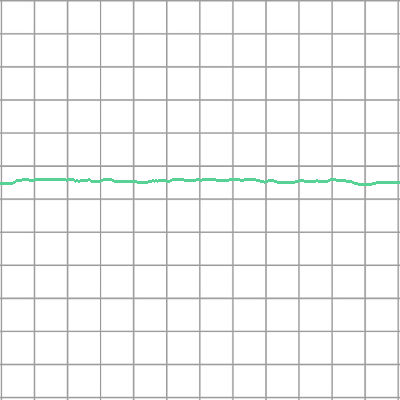

pitch75_thick0_color5_1_train.png


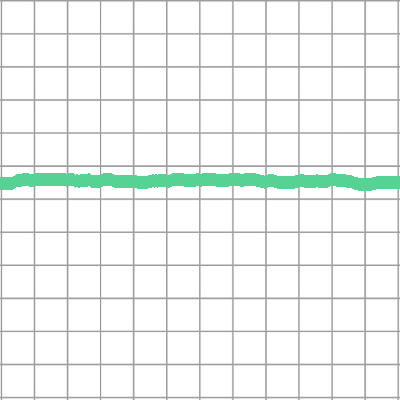

pitch75_thick1_color5_1_train.png


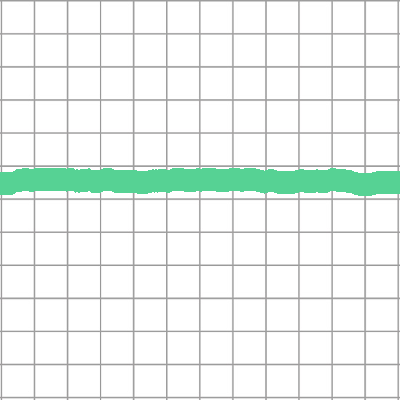

pitch75_thick2_color5_1_train.png


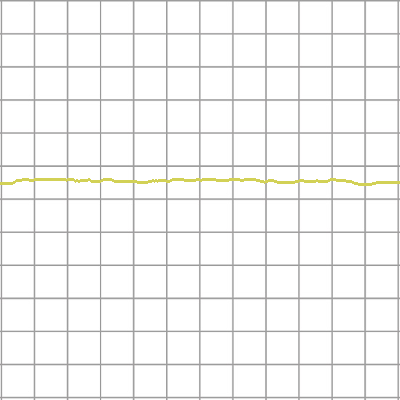

pitch75_thick0_color6_1_train.png


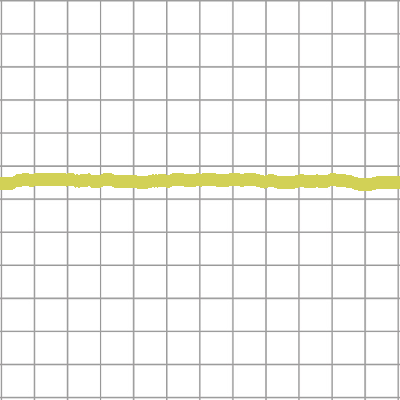

pitch75_thick1_color6_1_train.png


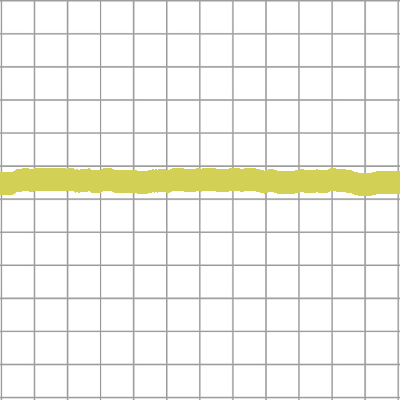

pitch75_thick2_color6_1_train.png


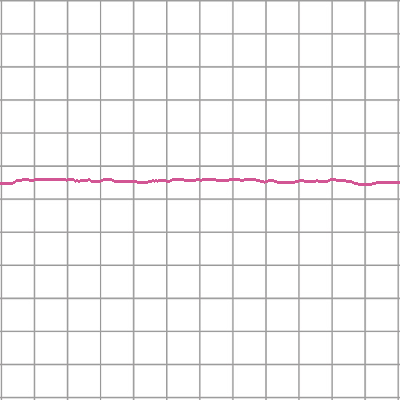

pitch75_thick0_color7_1_train.png


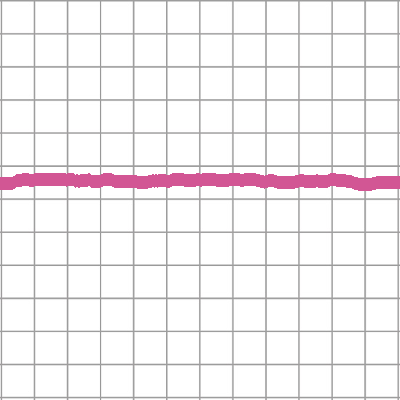

pitch75_thick1_color7_1_train.png


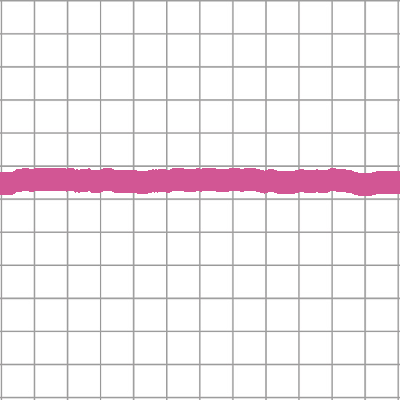

pitch75_thick2_color7_1_train.png


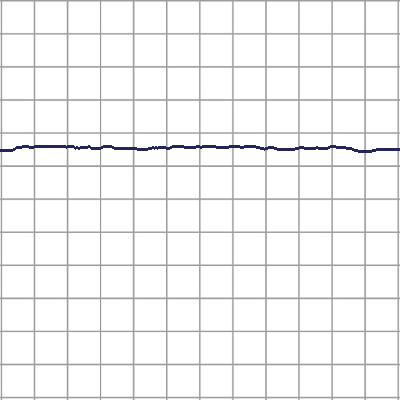

pitch76_thick0_color0_1_train.png


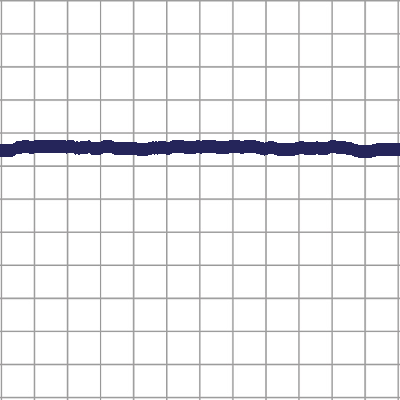

pitch76_thick1_color0_1_train.png


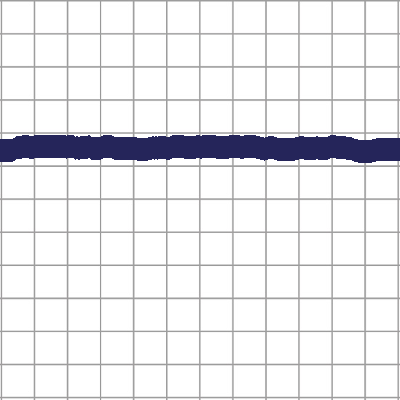

pitch76_thick2_color0_1_train.png


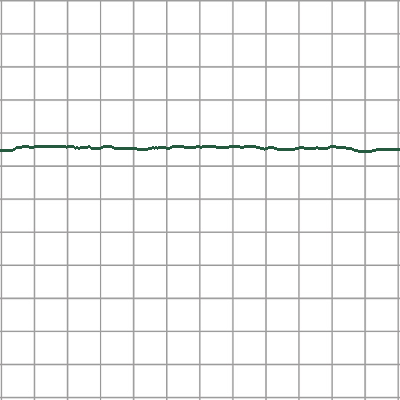

pitch76_thick0_color1_1_train.png


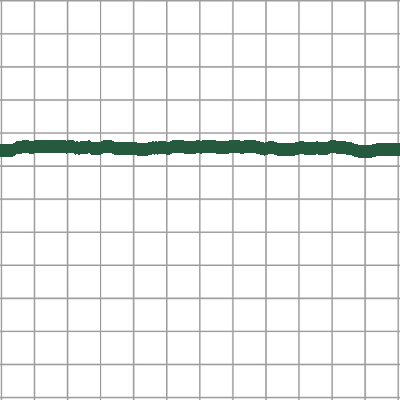

pitch76_thick1_color1_1_train.png


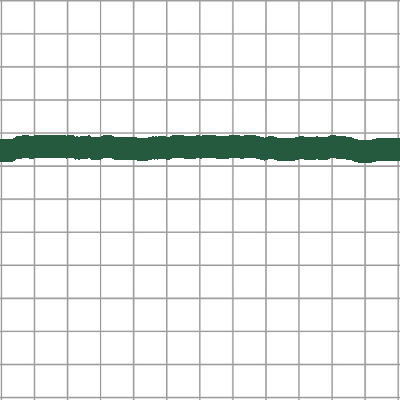

pitch76_thick2_color1_1_train.png


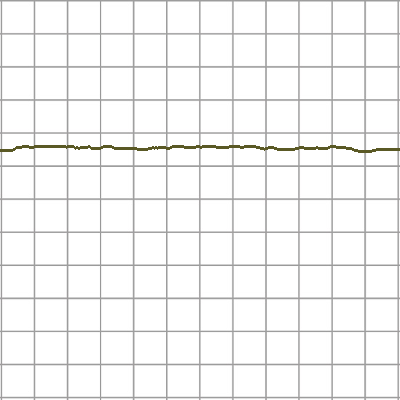

pitch76_thick0_color2_1_train.png


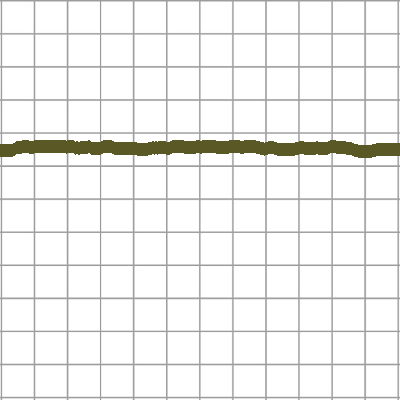

pitch76_thick1_color2_1_train.png


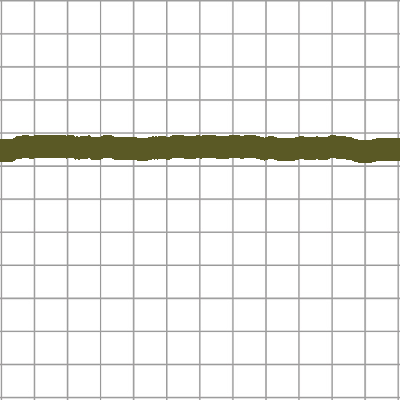

pitch76_thick2_color2_1_train.png


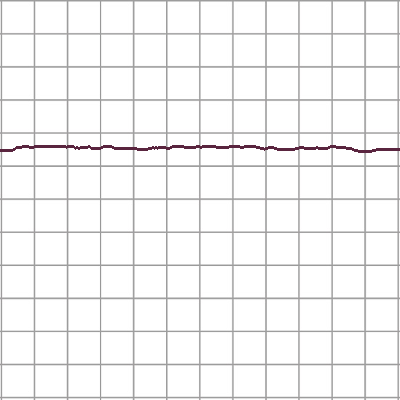

pitch76_thick0_color3_1_train.png


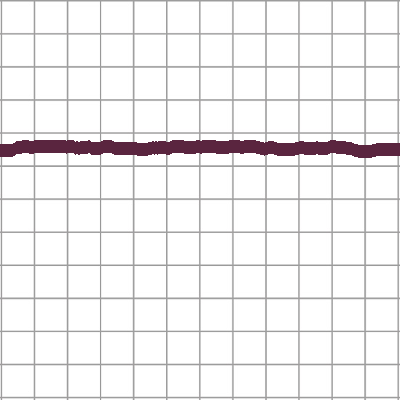

pitch76_thick1_color3_1_train.png


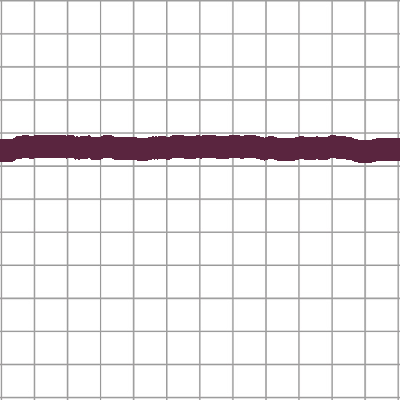

pitch76_thick2_color3_1_train.png


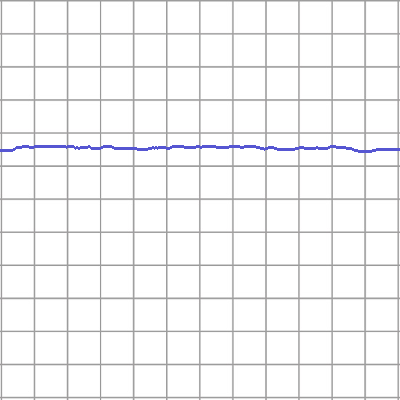

pitch76_thick0_color4_1_train.png


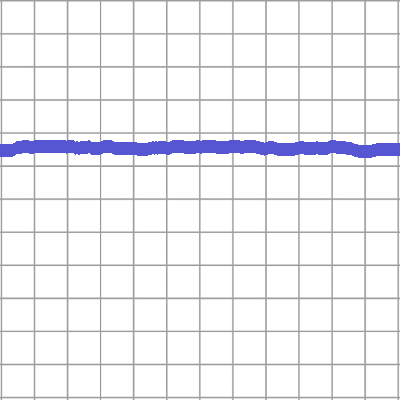

pitch76_thick1_color4_1_train.png


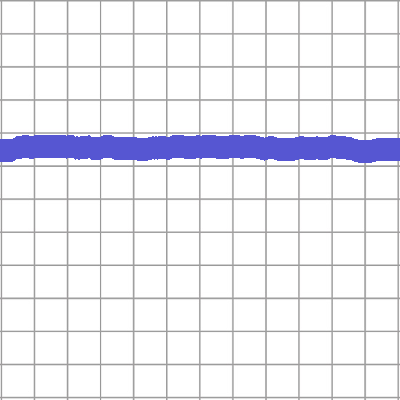

pitch76_thick2_color4_1_train.png


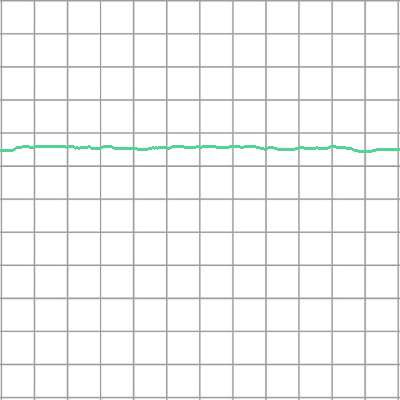

pitch76_thick0_color5_1_train.png


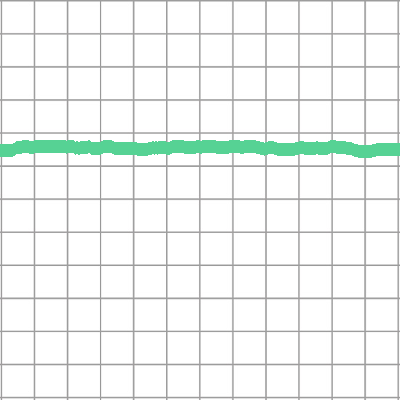

pitch76_thick1_color5_1_train.png


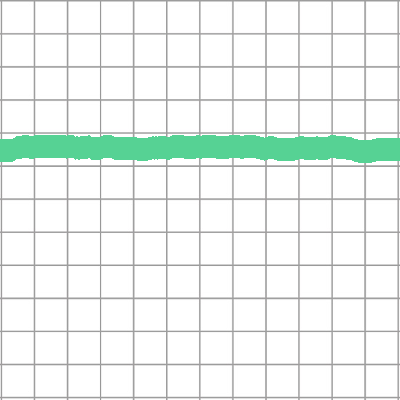

pitch76_thick2_color5_1_train.png


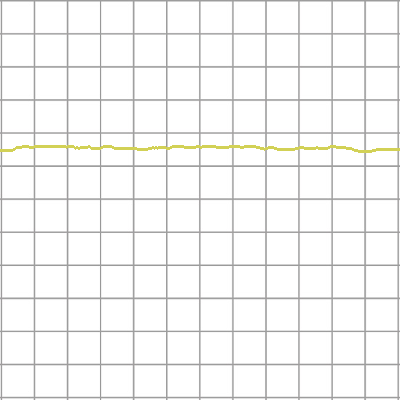

pitch76_thick0_color6_1_train.png


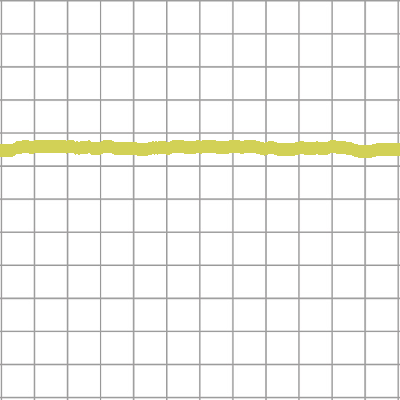

pitch76_thick1_color6_1_train.png


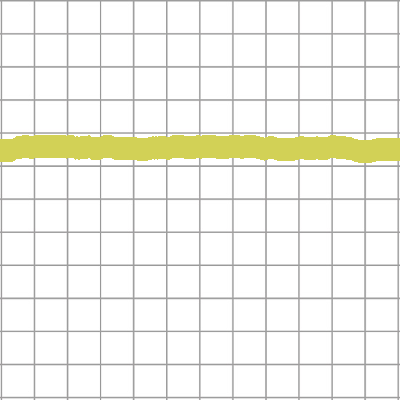

pitch76_thick2_color6_1_train.png


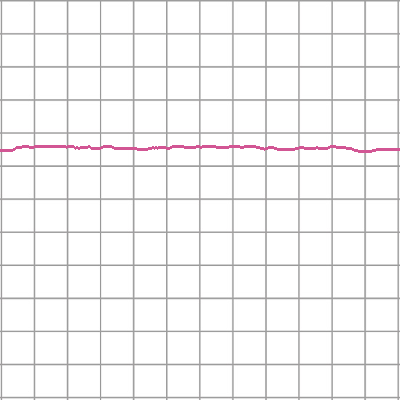

pitch76_thick0_color7_1_train.png


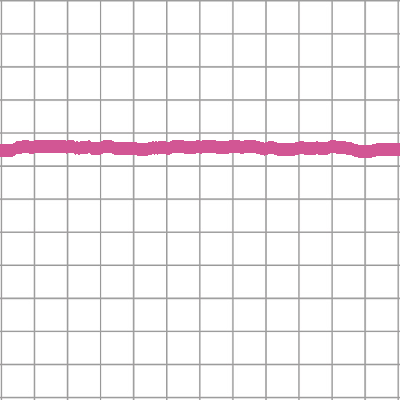

pitch76_thick1_color7_1_train.png


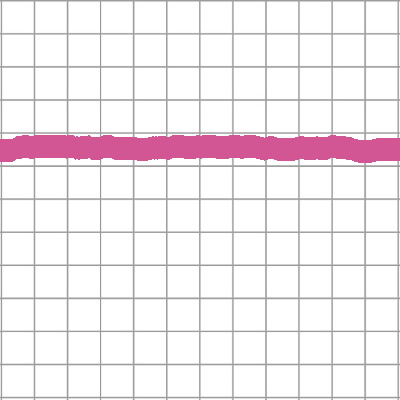

pitch76_thick2_color7_1_train.png


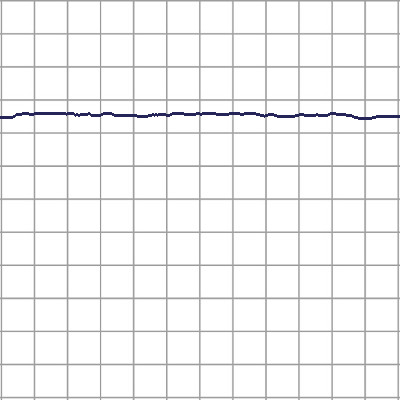

pitch77_thick0_color0_1_train.png


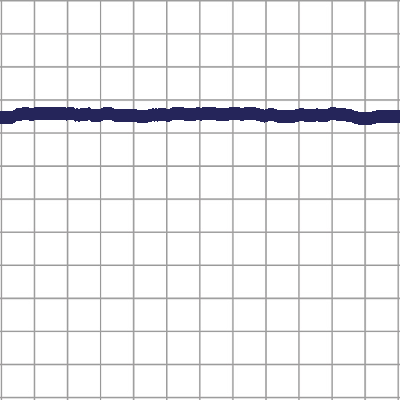

pitch77_thick1_color0_1_train.png


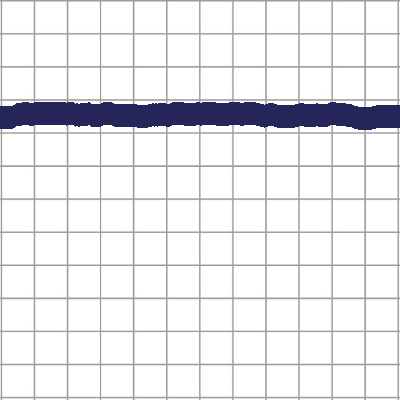

pitch77_thick2_color0_1_train.png


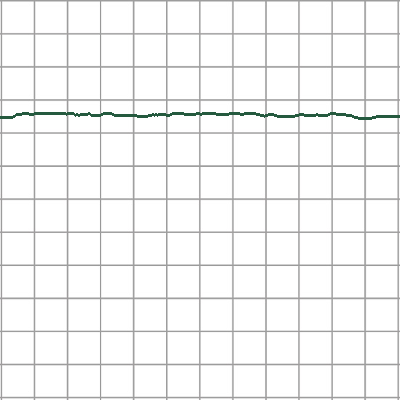

pitch77_thick0_color1_1_train.png


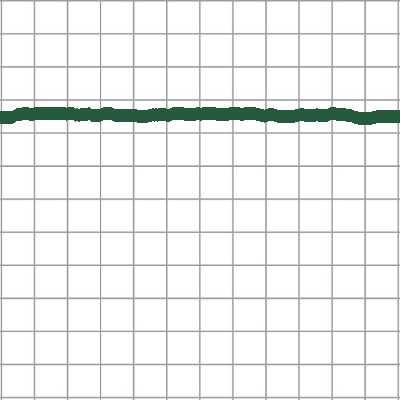

pitch77_thick1_color1_1_train.png


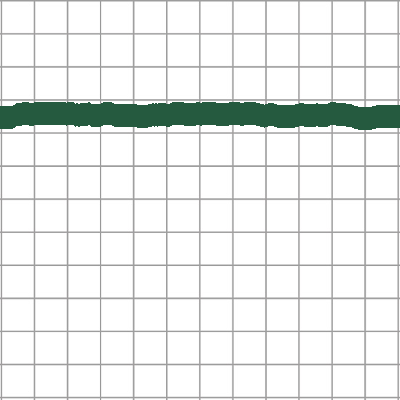

pitch77_thick2_color1_1_train.png


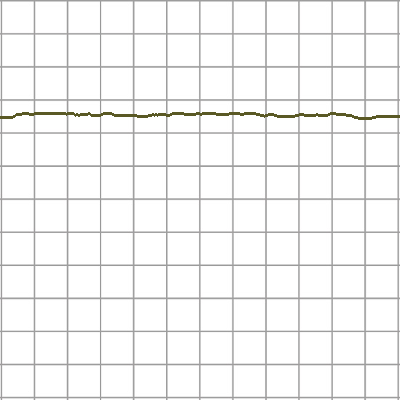

pitch77_thick0_color2_1_train.png


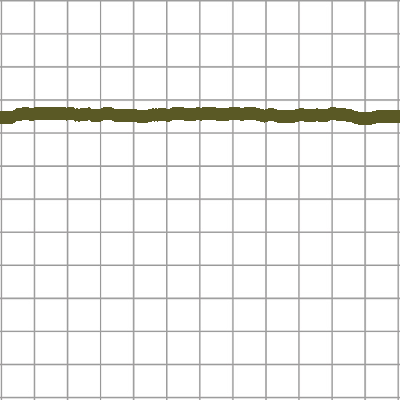

pitch77_thick1_color2_1_train.png


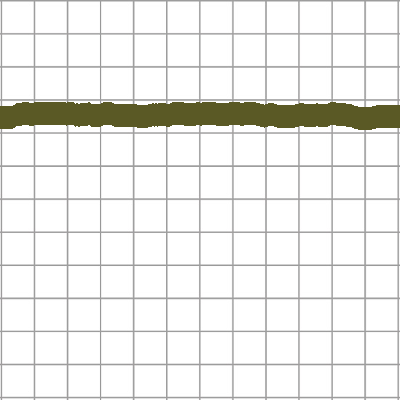

pitch77_thick2_color2_1_train.png


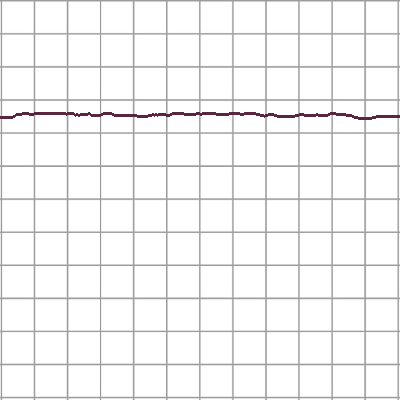

pitch77_thick0_color3_1_train.png


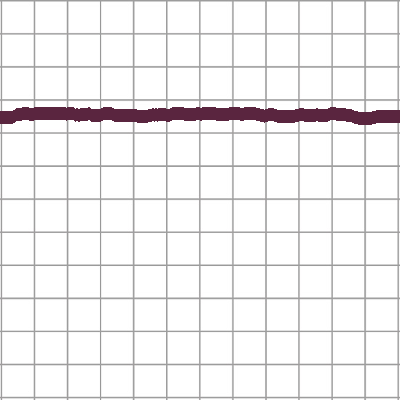

pitch77_thick1_color3_1_train.png


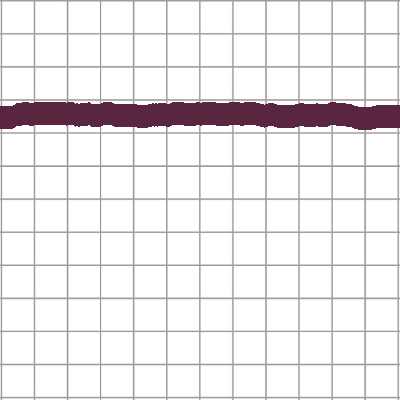

pitch77_thick2_color3_1_train.png


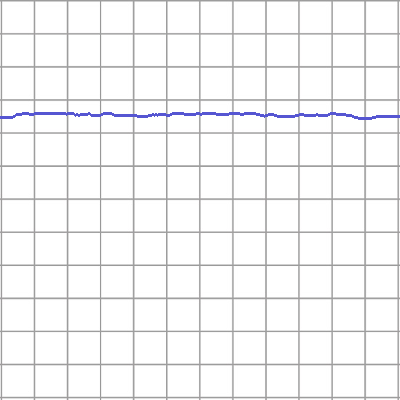

pitch77_thick0_color4_1_train.png


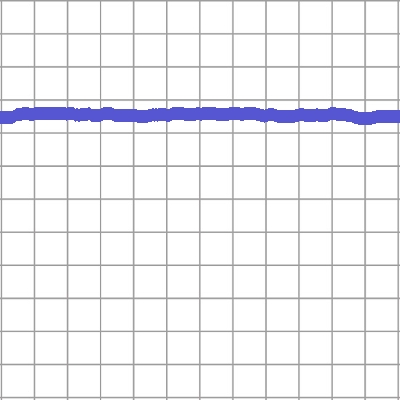

pitch77_thick1_color4_1_train.png


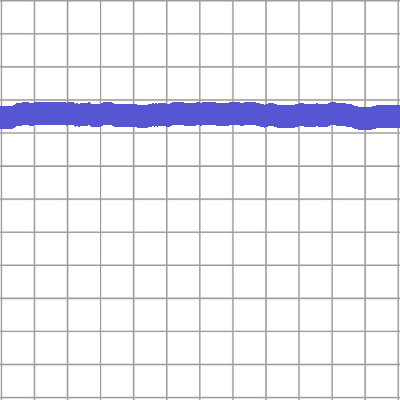

pitch77_thick2_color4_1_train.png


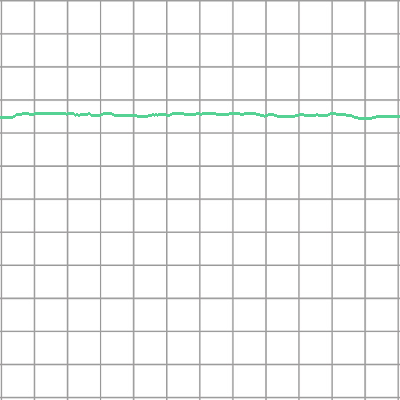

pitch77_thick0_color5_1_train.png


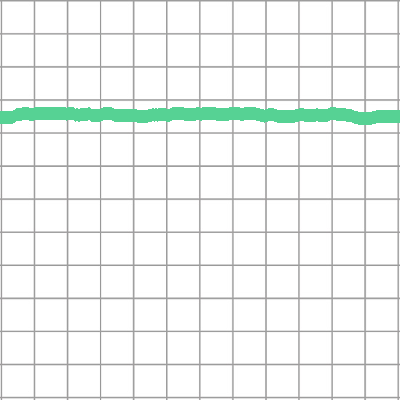

pitch77_thick1_color5_1_train.png


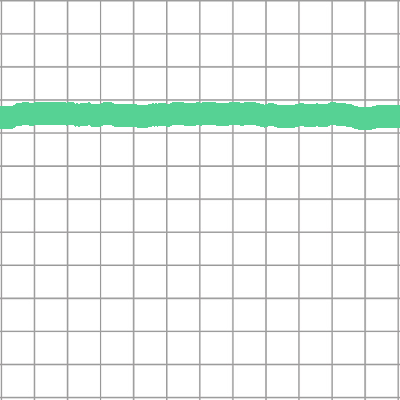

pitch77_thick2_color5_1_train.png


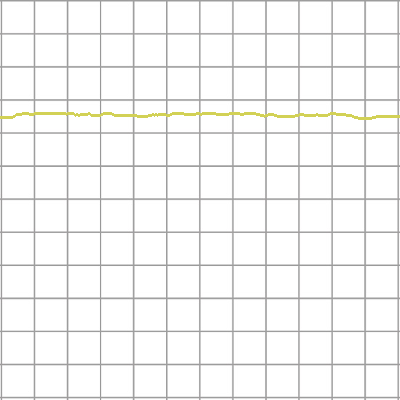

pitch77_thick0_color6_1_train.png


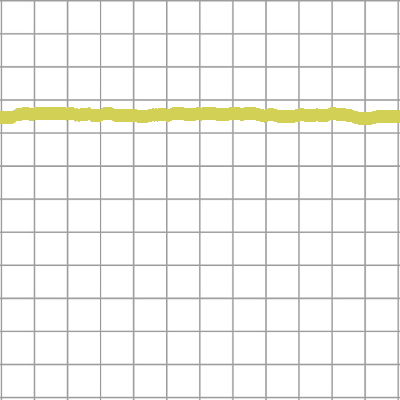

pitch77_thick1_color6_1_train.png


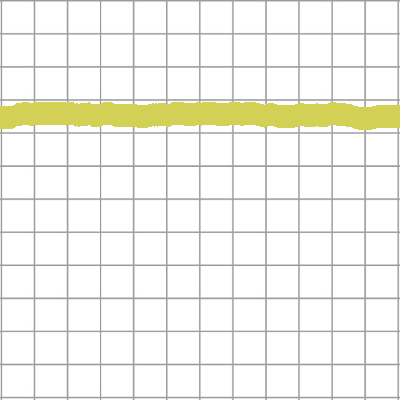

pitch77_thick2_color6_1_train.png


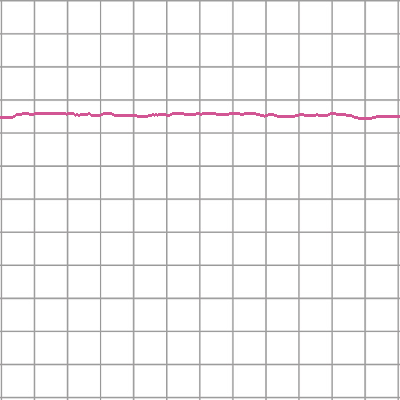

pitch77_thick0_color7_1_train.png


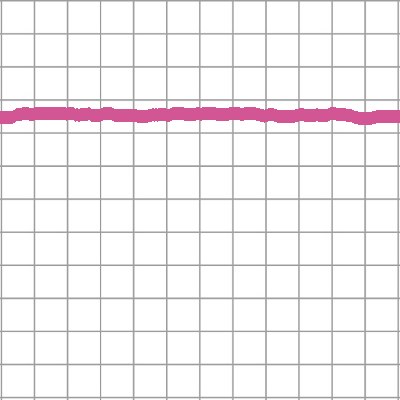

pitch77_thick1_color7_1_train.png


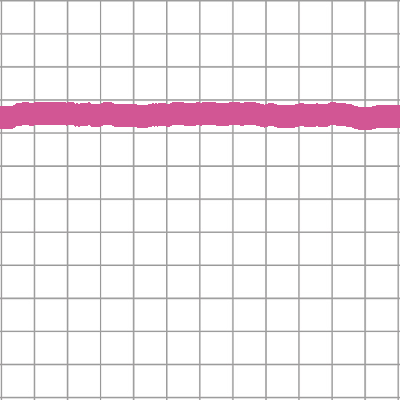

pitch77_thick2_color7_1_train.png


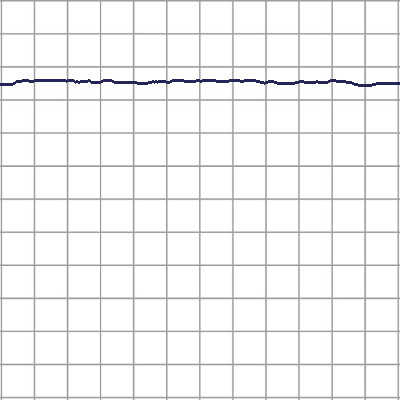

pitch78_thick0_color0_1_train.png


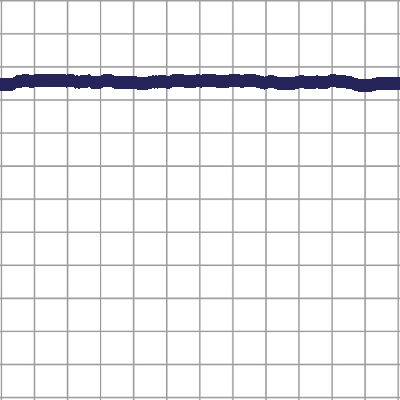

pitch78_thick1_color0_1_train.png


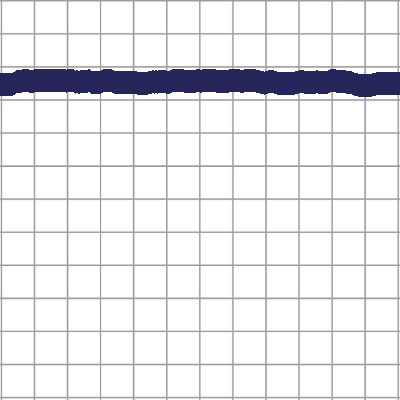

pitch78_thick2_color0_1_train.png


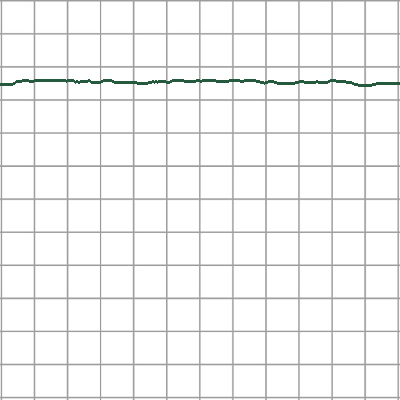

pitch78_thick0_color1_1_train.png


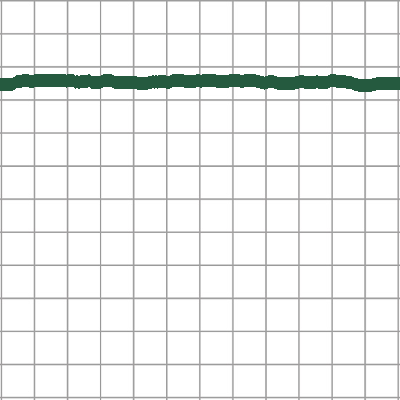

pitch78_thick1_color1_1_train.png


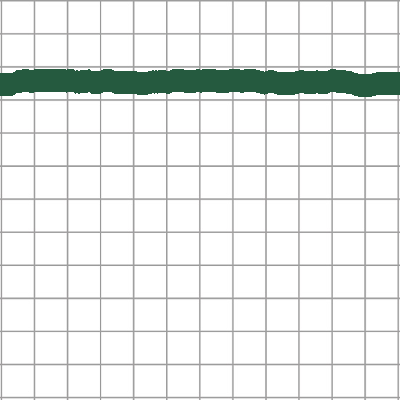

pitch78_thick2_color1_1_train.png


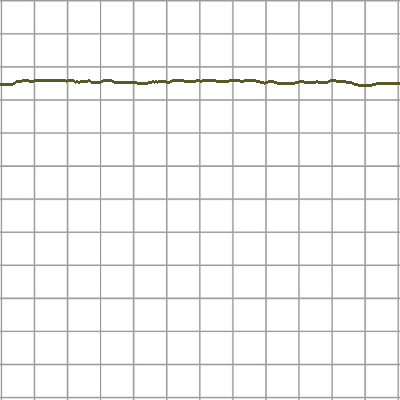

pitch78_thick0_color2_1_train.png


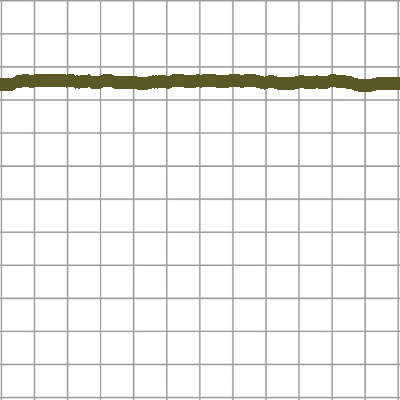

pitch78_thick1_color2_1_train.png


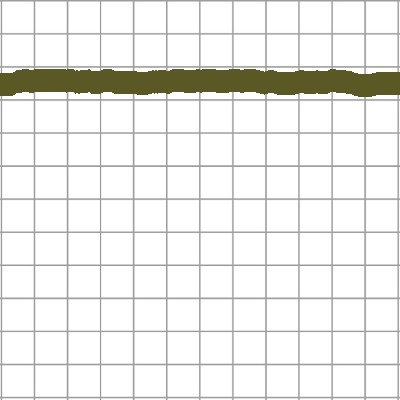

pitch78_thick2_color2_1_train.png


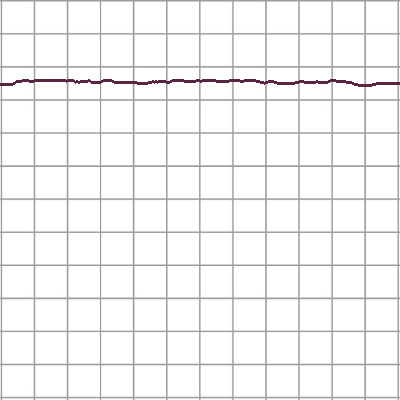

pitch78_thick0_color3_1_train.png


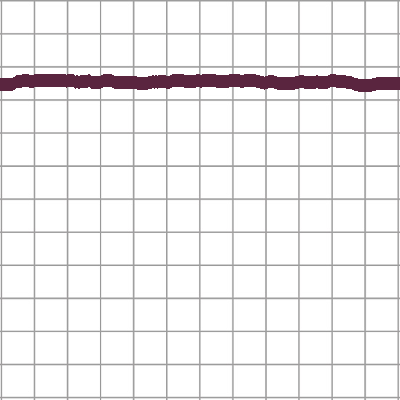

pitch78_thick1_color3_1_train.png


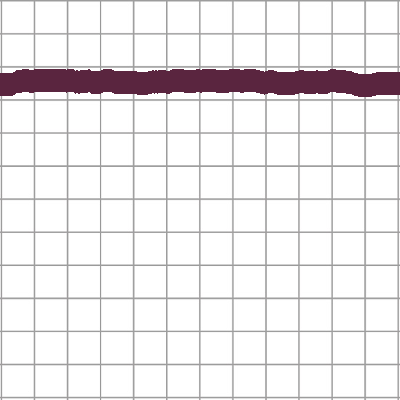

pitch78_thick2_color3_1_train.png


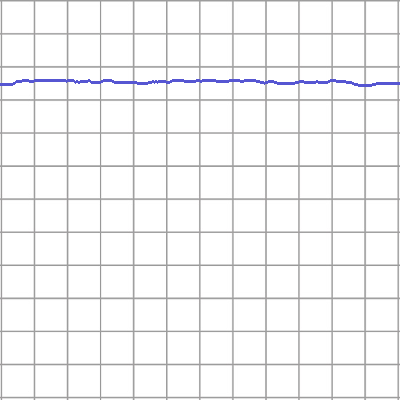

pitch78_thick0_color4_1_train.png


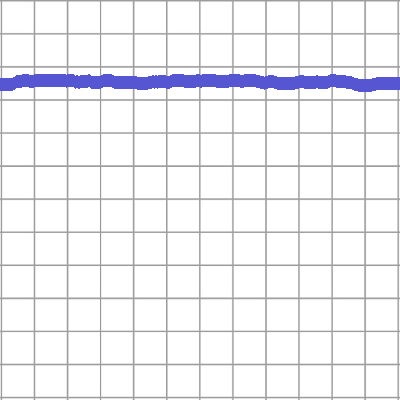

pitch78_thick1_color4_1_train.png


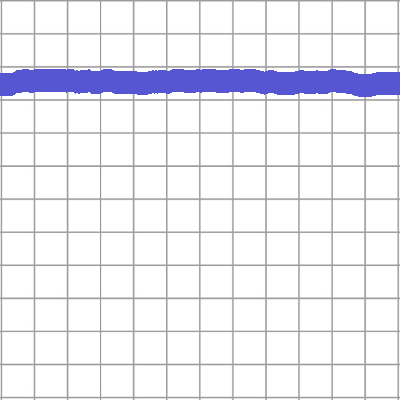

pitch78_thick2_color4_1_train.png


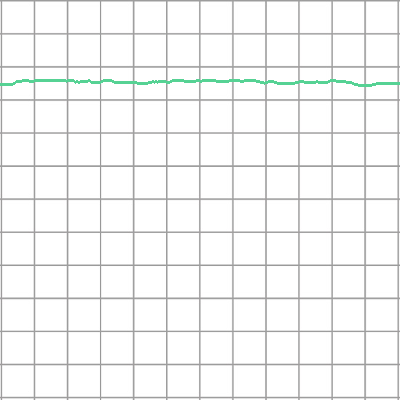

pitch78_thick0_color5_1_train.png


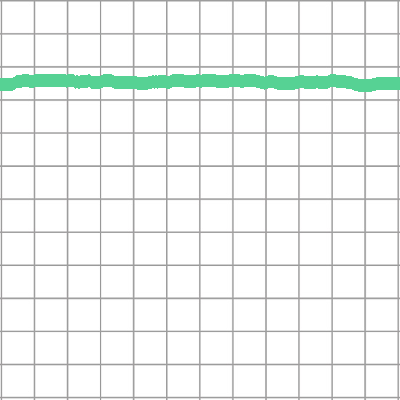

pitch78_thick1_color5_1_train.png


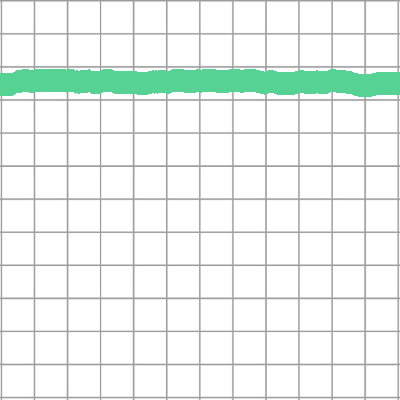

pitch78_thick2_color5_1_train.png


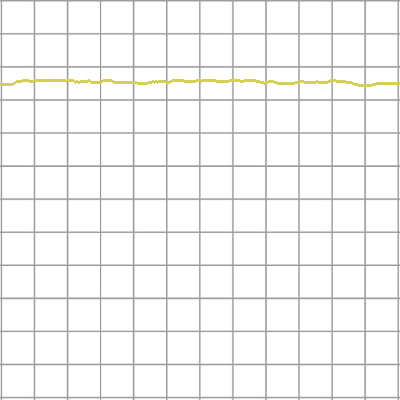

pitch78_thick0_color6_1_train.png


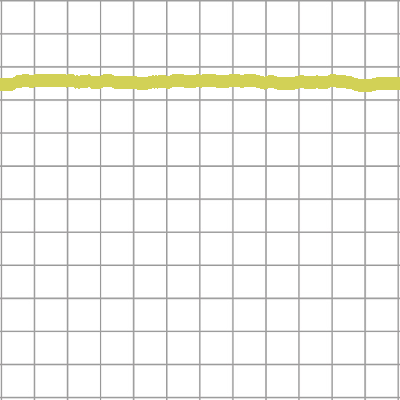

pitch78_thick1_color6_1_train.png


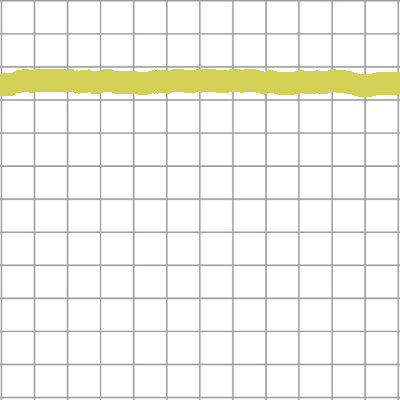

pitch78_thick2_color6_1_train.png


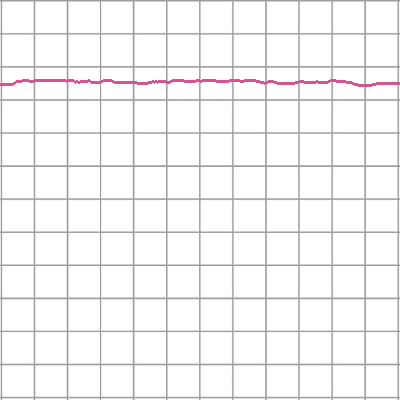

pitch78_thick0_color7_1_train.png


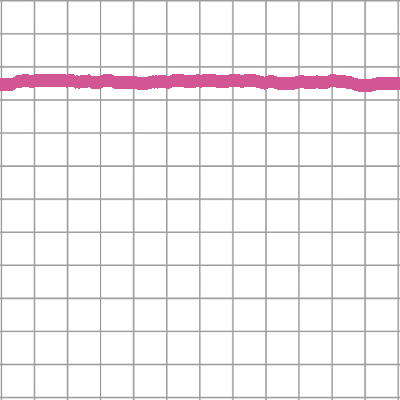

pitch78_thick1_color7_1_train.png


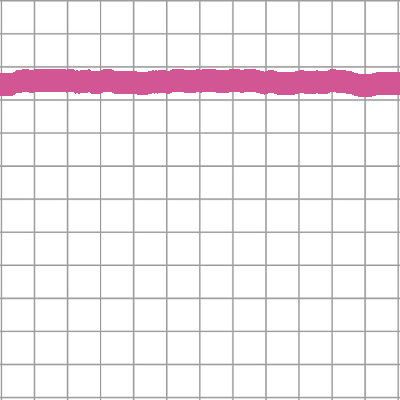

pitch78_thick2_color7_1_train.png


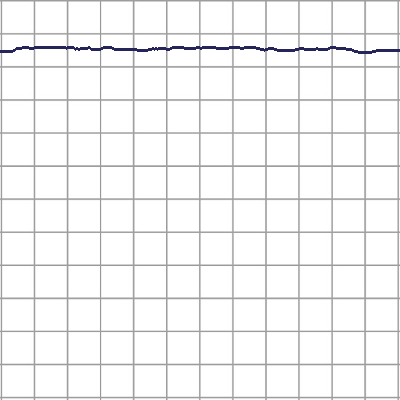

pitch79_thick0_color0_1_train.png


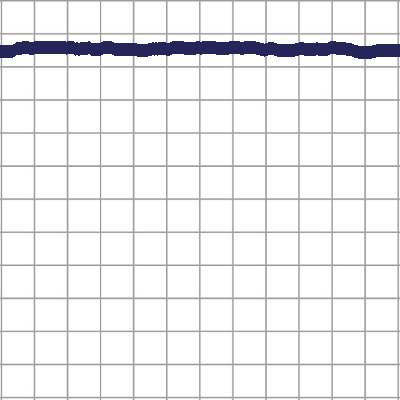

pitch79_thick1_color0_1_train.png


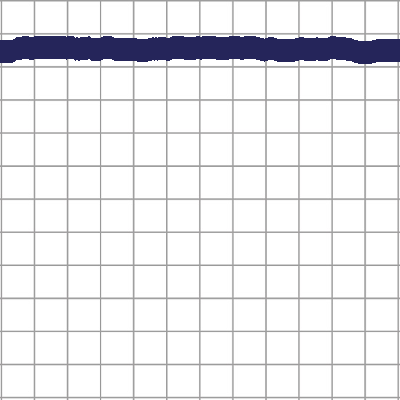

pitch79_thick2_color0_1_train.png


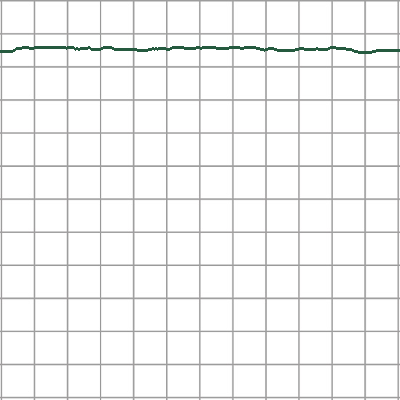

pitch79_thick0_color1_1_train.png


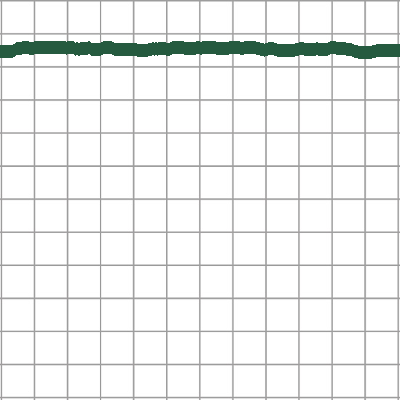

pitch79_thick1_color1_1_train.png


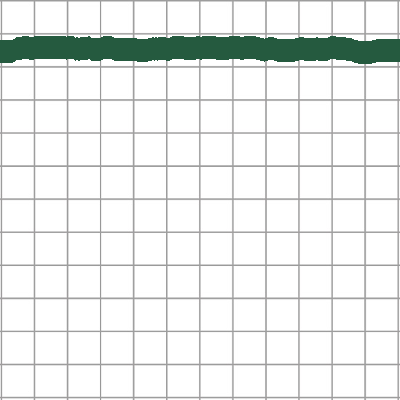

pitch79_thick2_color1_1_train.png


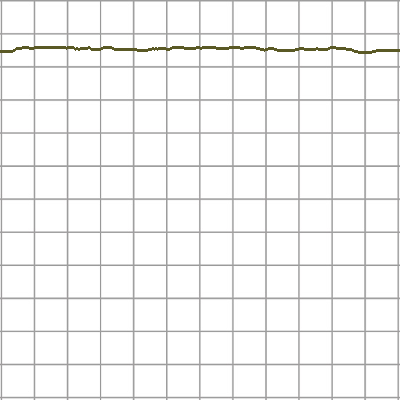

pitch79_thick0_color2_1_train.png


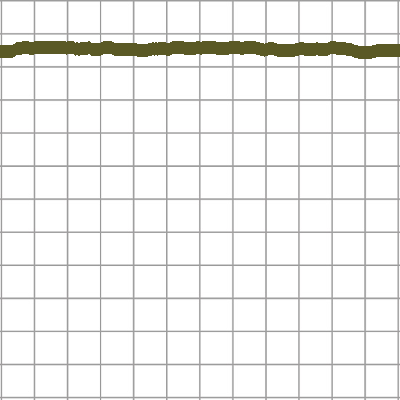

pitch79_thick1_color2_1_train.png


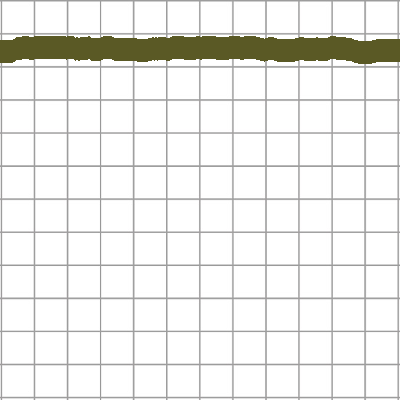

pitch79_thick2_color2_1_train.png


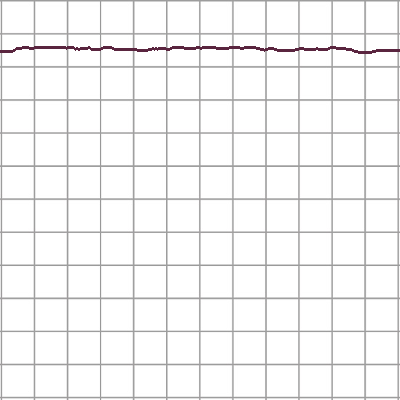

pitch79_thick0_color3_1_train.png


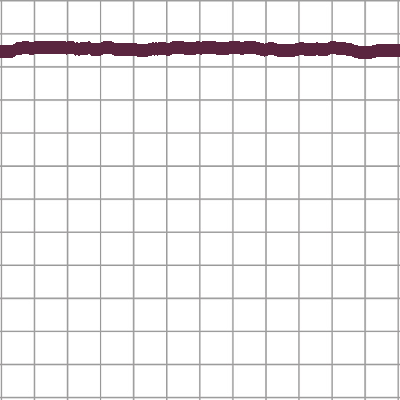

pitch79_thick1_color3_1_train.png


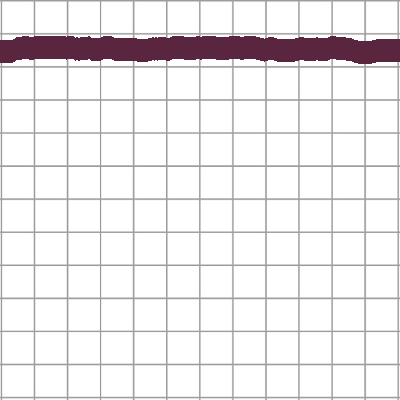

pitch79_thick2_color3_1_train.png


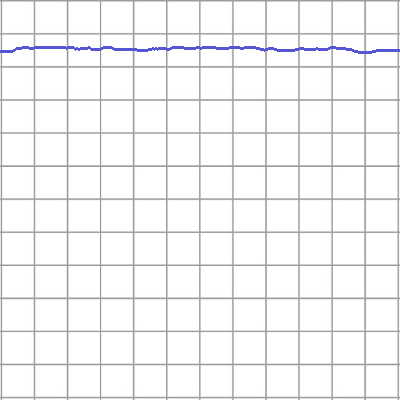

pitch79_thick0_color4_1_train.png


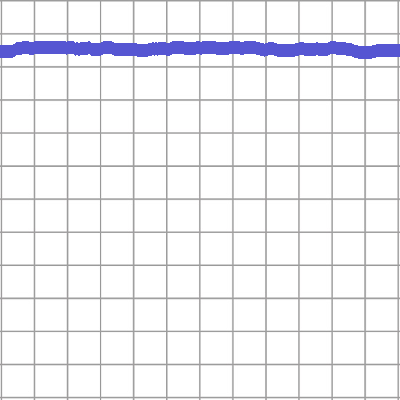

pitch79_thick1_color4_1_train.png


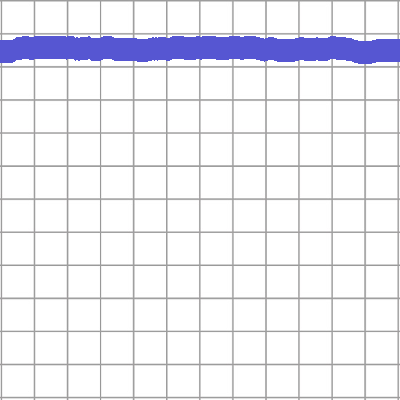

pitch79_thick2_color4_1_train.png


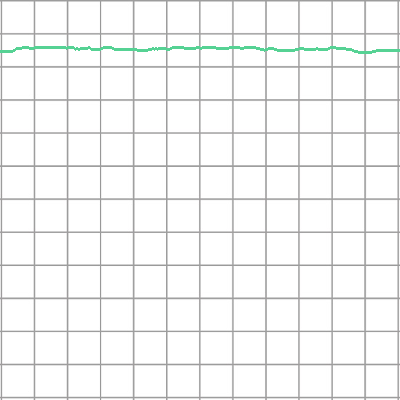

pitch79_thick0_color5_1_train.png


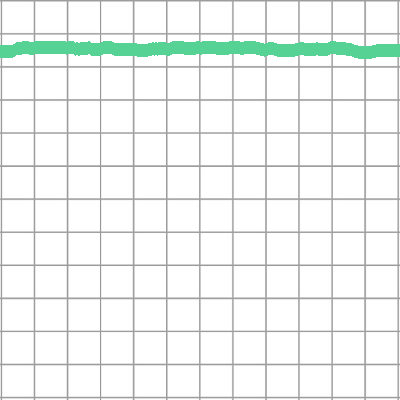

pitch79_thick1_color5_1_train.png


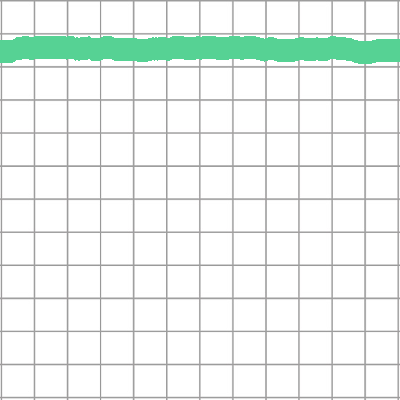

pitch79_thick2_color5_1_train.png


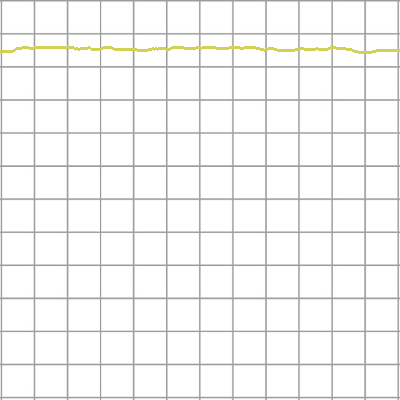

pitch79_thick0_color6_1_train.png


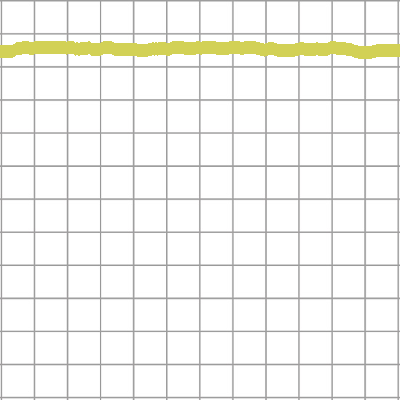

pitch79_thick1_color6_1_train.png


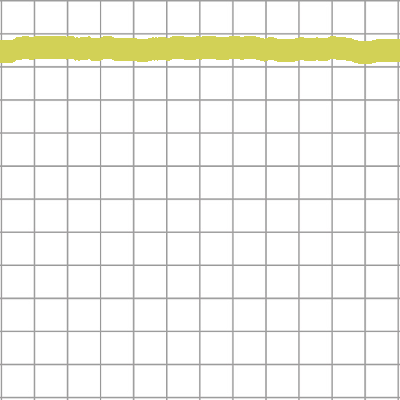

pitch79_thick2_color6_1_train.png


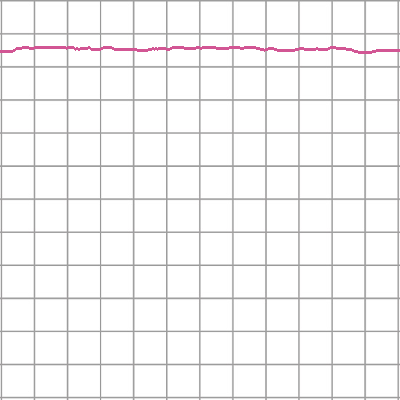

pitch79_thick0_color7_1_train.png


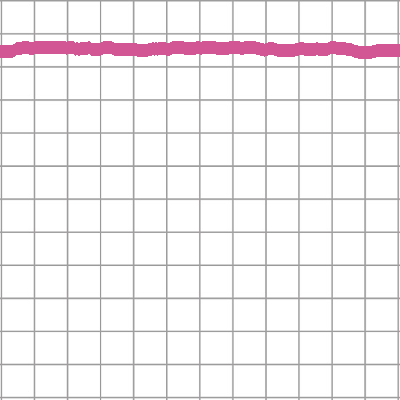

pitch79_thick1_color7_1_train.png


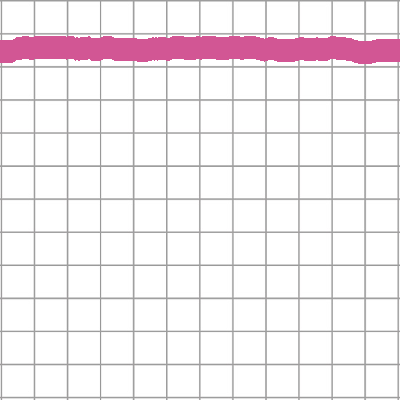

pitch79_thick2_color7_1_train.png


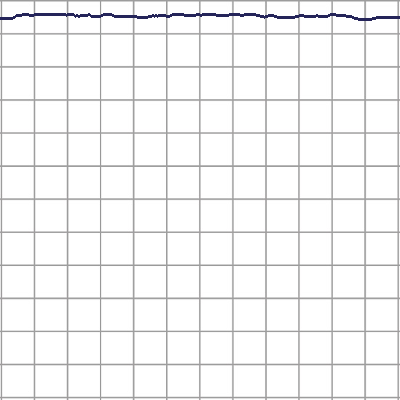

pitch80_thick0_color0_1_train.png


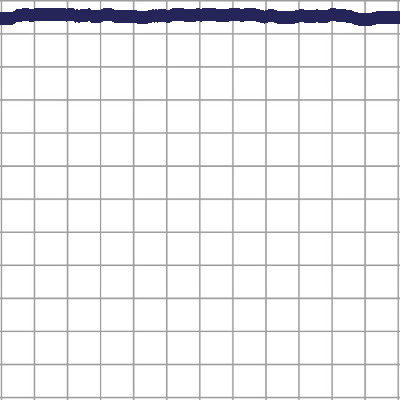

pitch80_thick1_color0_1_train.png


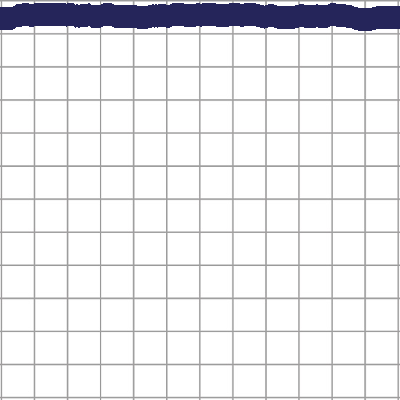

pitch80_thick2_color0_1_train.png


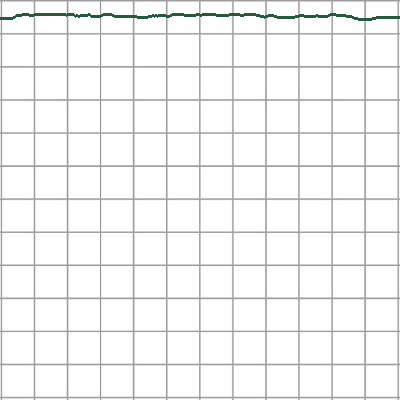

pitch80_thick0_color1_1_train.png


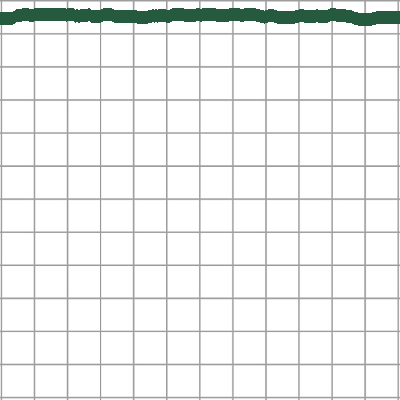

pitch80_thick1_color1_1_train.png


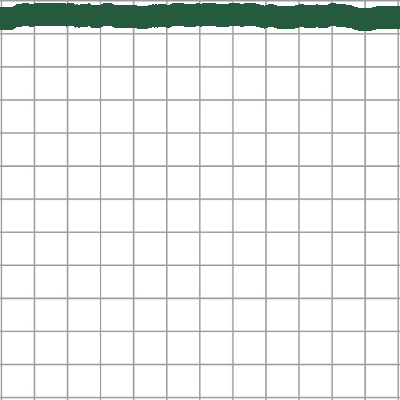

pitch80_thick2_color1_1_train.png


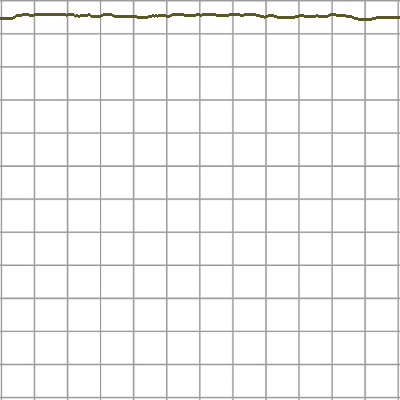

pitch80_thick0_color2_1_train.png


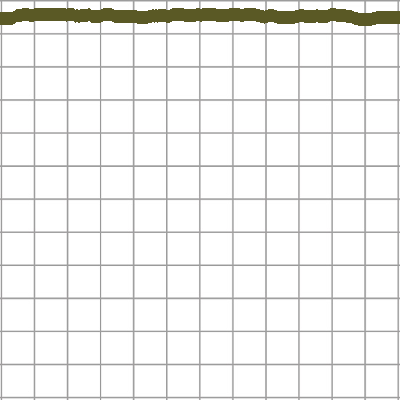

pitch80_thick1_color2_1_train.png


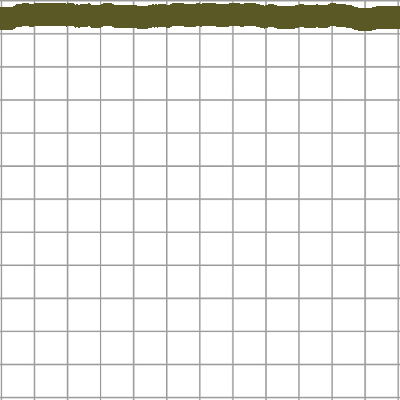

pitch80_thick2_color2_1_train.png


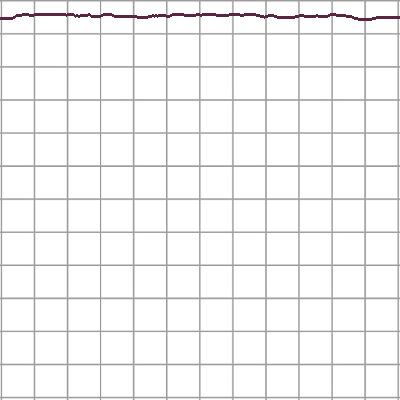

pitch80_thick0_color3_1_train.png


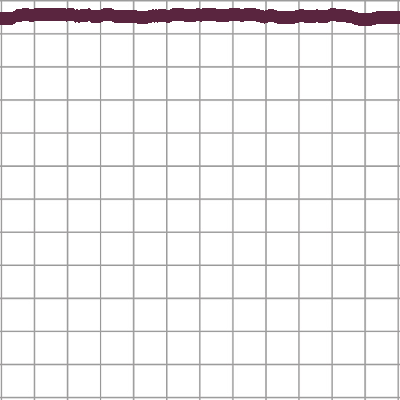

pitch80_thick1_color3_1_train.png


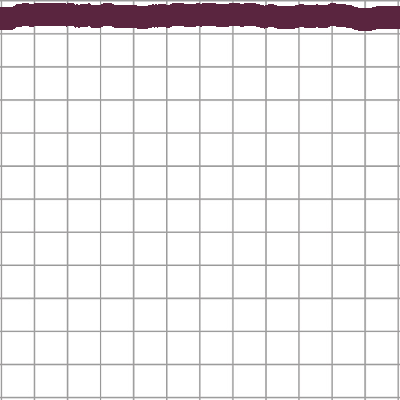

pitch80_thick2_color3_1_train.png


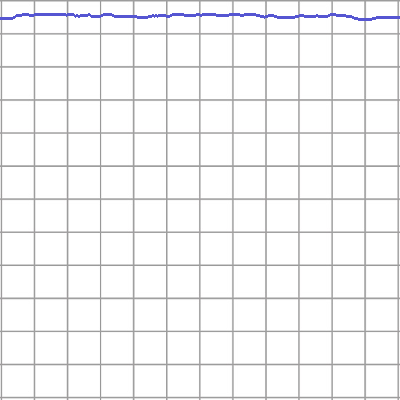

pitch80_thick0_color4_1_train.png


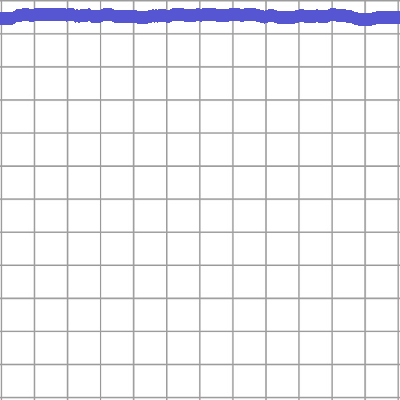

pitch80_thick1_color4_1_train.png


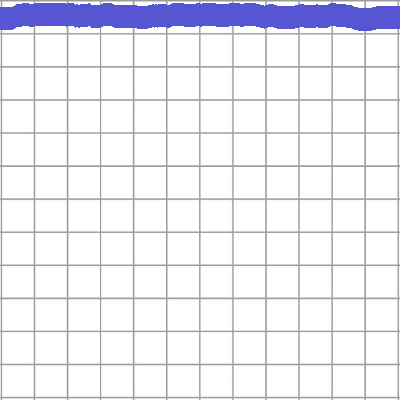

pitch80_thick2_color4_1_train.png


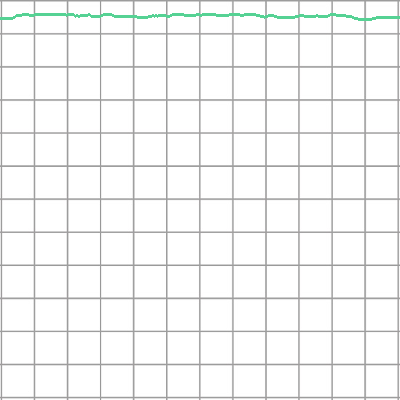

pitch80_thick0_color5_1_train.png


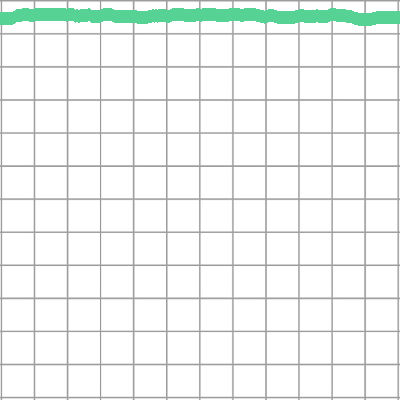

pitch80_thick1_color5_1_train.png


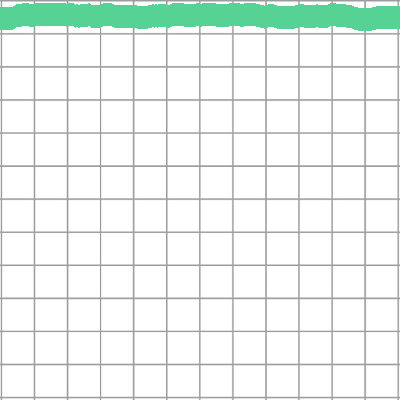

pitch80_thick2_color5_1_train.png


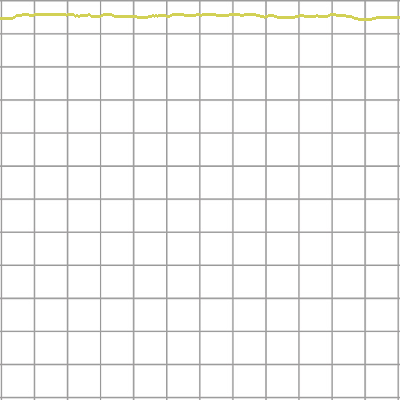

pitch80_thick0_color6_1_train.png


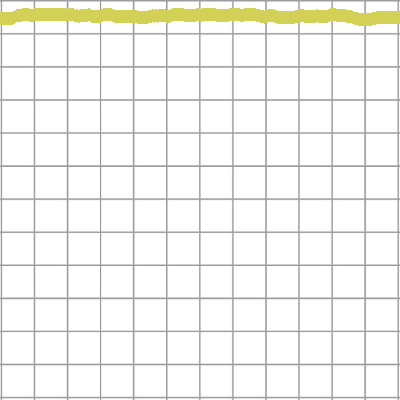

pitch80_thick1_color6_1_train.png


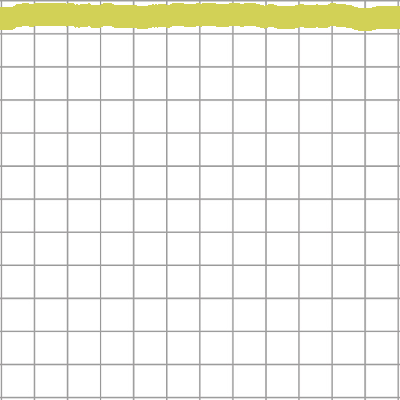

pitch80_thick2_color6_1_train.png


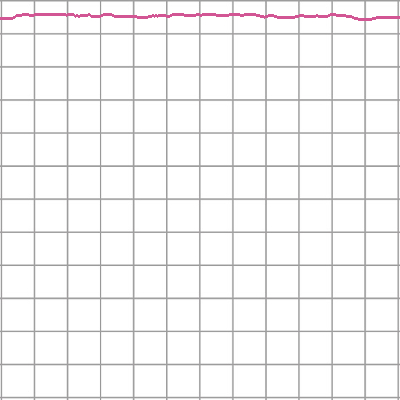

pitch80_thick0_color7_1_train.png


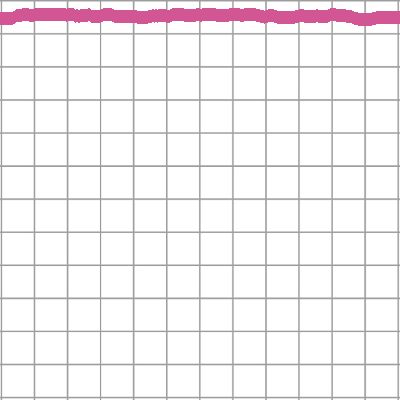

pitch80_thick1_color7_1_train.png


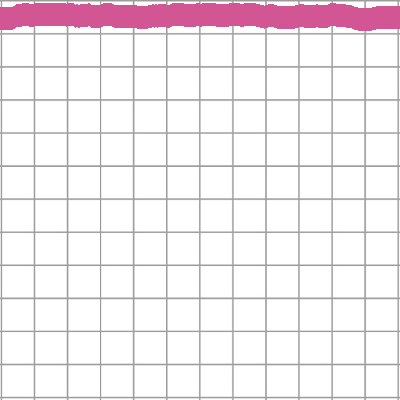

pitch80_thick2_color7_1_train.png
[INFO] generating training dataset...


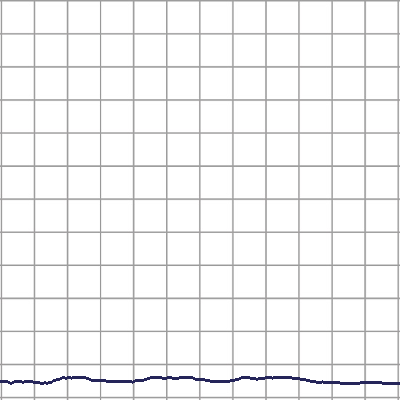

pitch69_thick0_color0_0_validation.png


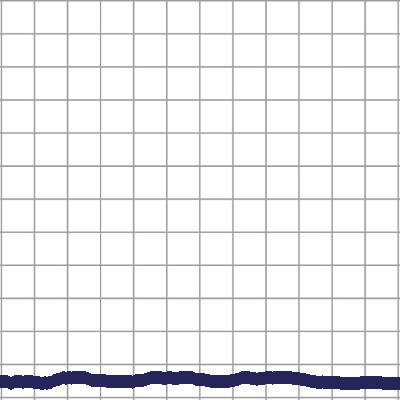

pitch69_thick1_color0_0_validation.png


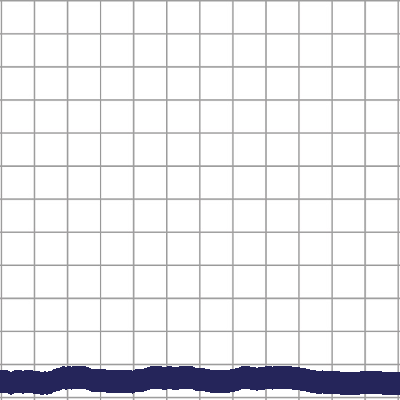

pitch69_thick2_color0_0_validation.png


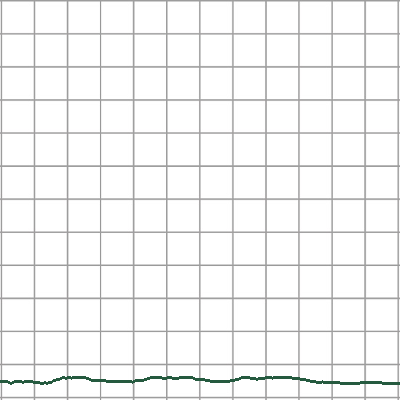

pitch69_thick0_color1_0_validation.png


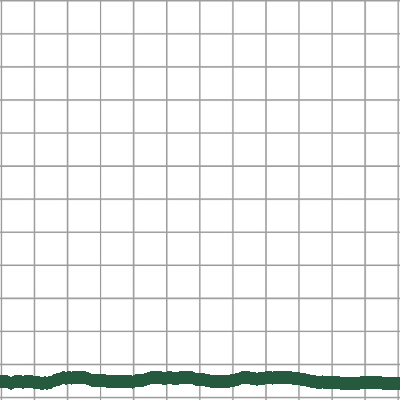

pitch69_thick1_color1_0_validation.png


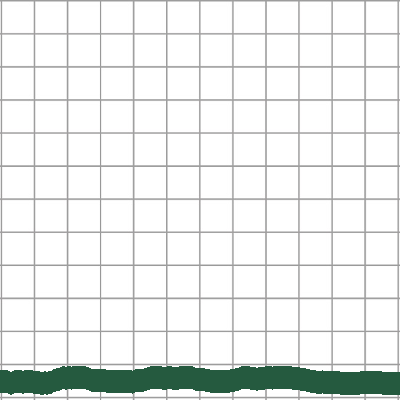

pitch69_thick2_color1_0_validation.png


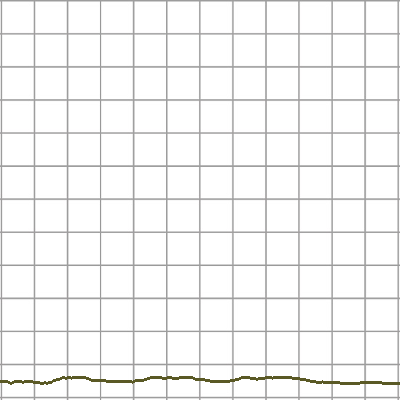

pitch69_thick0_color2_0_validation.png


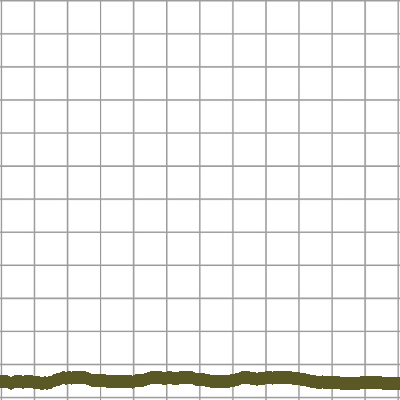

pitch69_thick1_color2_0_validation.png


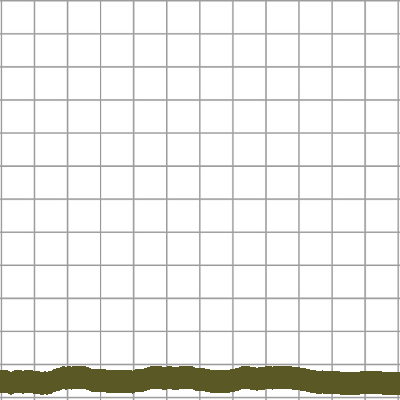

pitch69_thick2_color2_0_validation.png


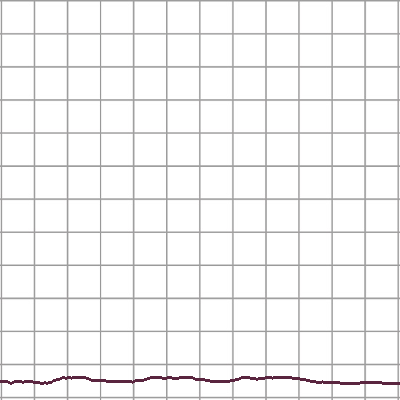

pitch69_thick0_color3_0_validation.png


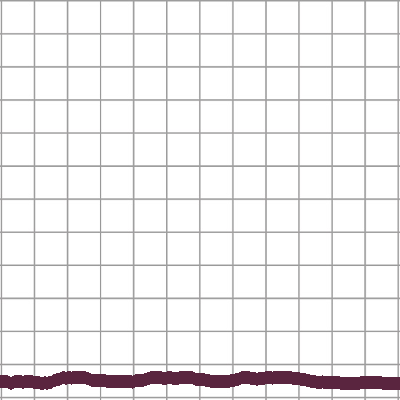

pitch69_thick1_color3_0_validation.png


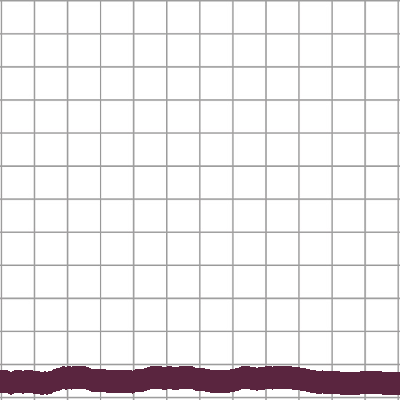

pitch69_thick2_color3_0_validation.png


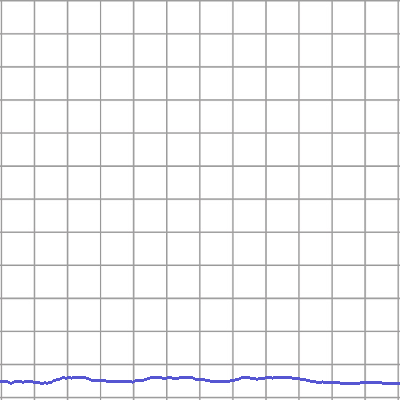

pitch69_thick0_color4_0_validation.png


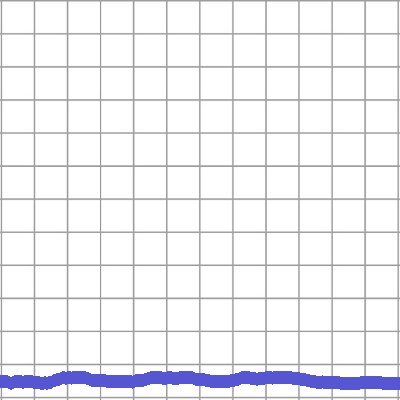

pitch69_thick1_color4_0_validation.png


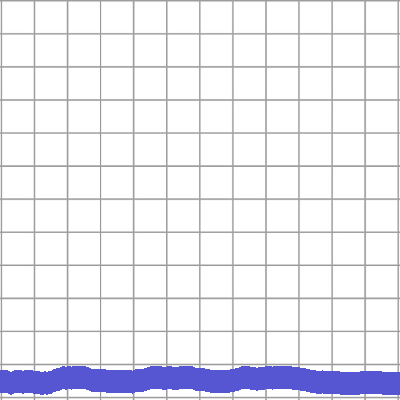

pitch69_thick2_color4_0_validation.png


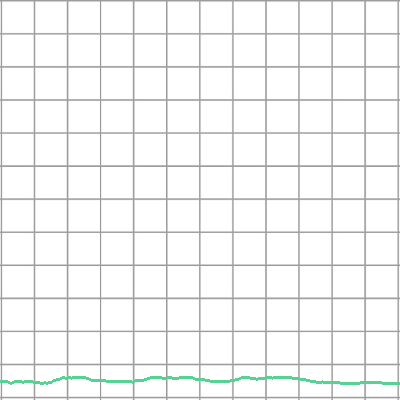

pitch69_thick0_color5_0_validation.png


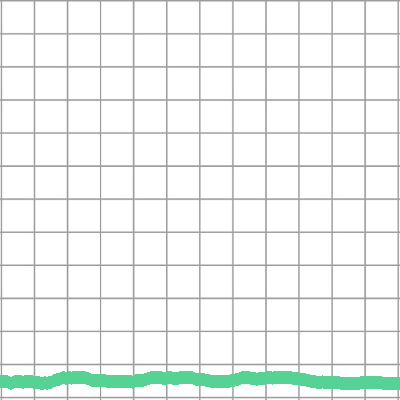

pitch69_thick1_color5_0_validation.png


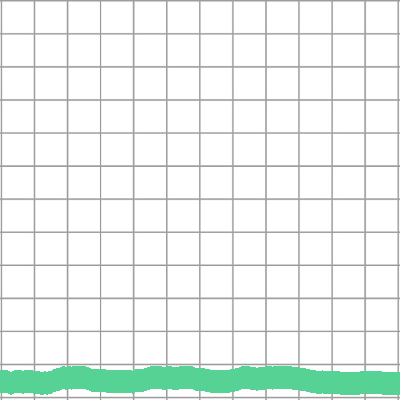

pitch69_thick2_color5_0_validation.png


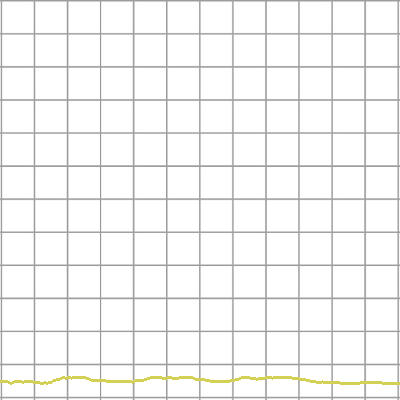

pitch69_thick0_color6_0_validation.png


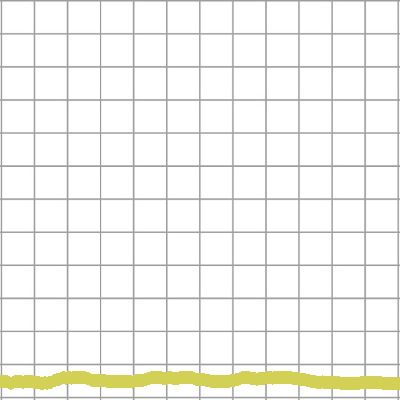

pitch69_thick1_color6_0_validation.png


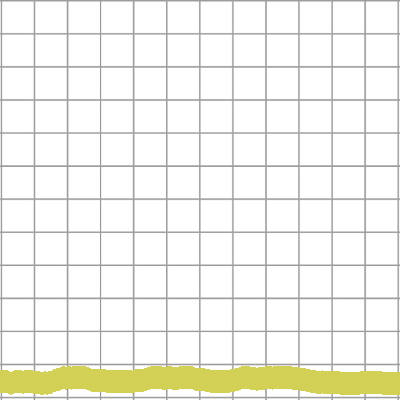

pitch69_thick2_color6_0_validation.png


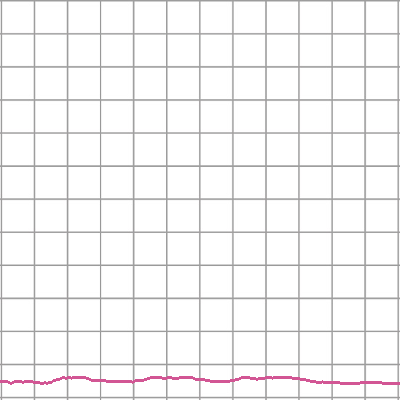

pitch69_thick0_color7_0_validation.png


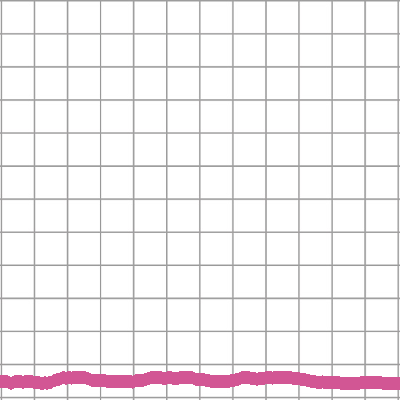

pitch69_thick1_color7_0_validation.png


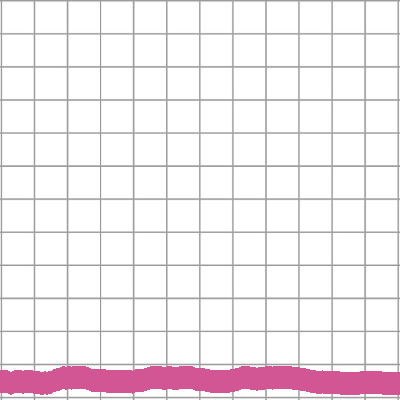

pitch69_thick2_color7_0_validation.png


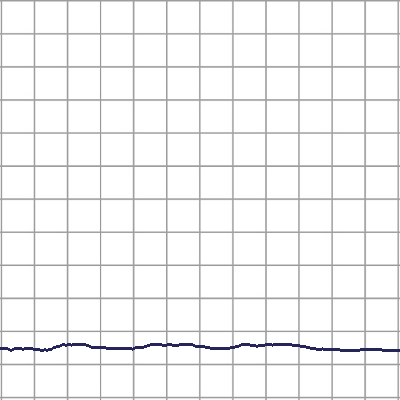

pitch70_thick0_color0_0_validation.png


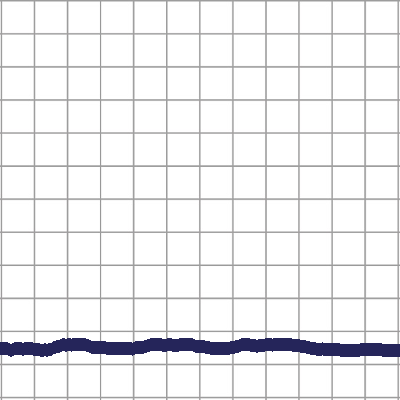

pitch70_thick1_color0_0_validation.png


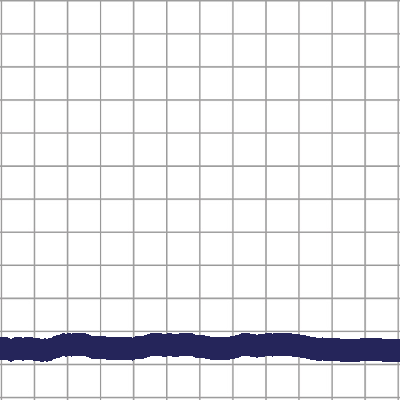

pitch70_thick2_color0_0_validation.png


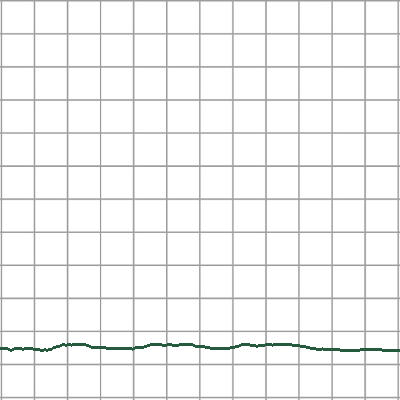

pitch70_thick0_color1_0_validation.png


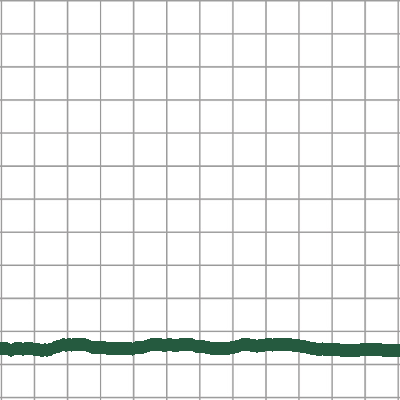

pitch70_thick1_color1_0_validation.png


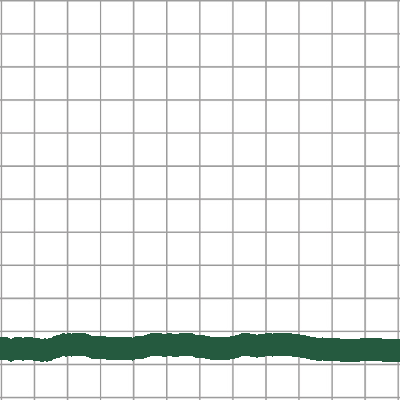

pitch70_thick2_color1_0_validation.png


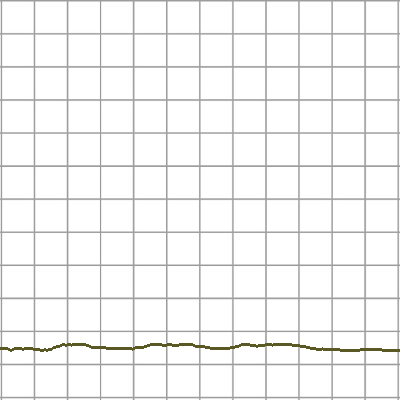

pitch70_thick0_color2_0_validation.png


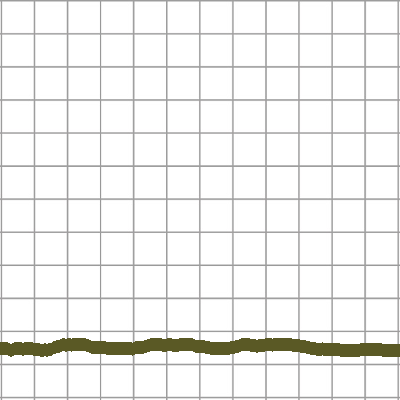

pitch70_thick1_color2_0_validation.png


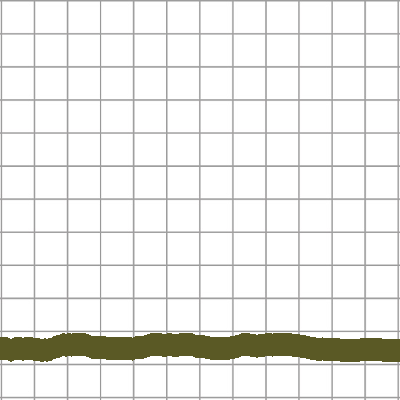

pitch70_thick2_color2_0_validation.png


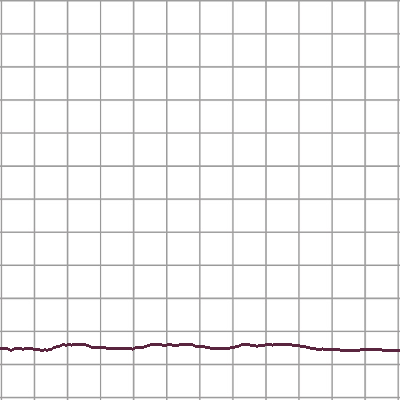

pitch70_thick0_color3_0_validation.png


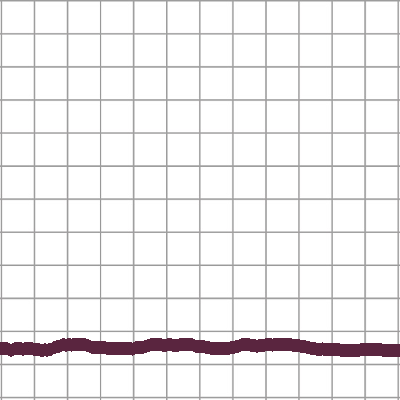

pitch70_thick1_color3_0_validation.png


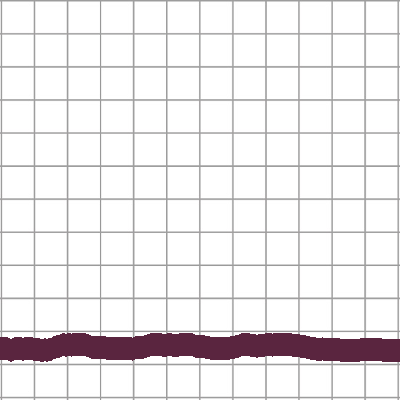

pitch70_thick2_color3_0_validation.png


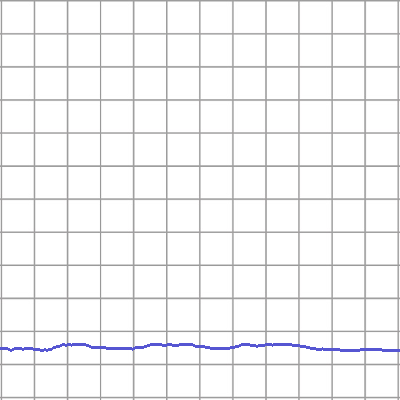

pitch70_thick0_color4_0_validation.png


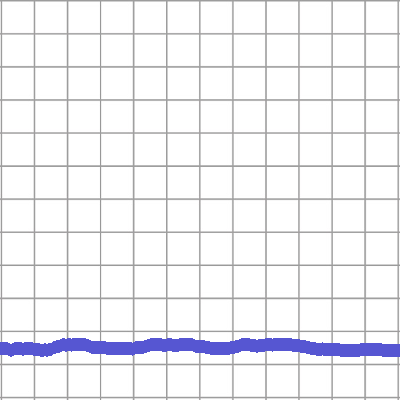

pitch70_thick1_color4_0_validation.png


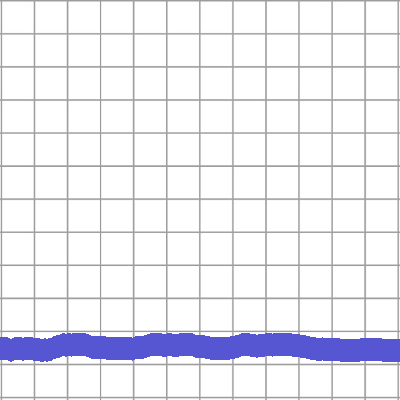

pitch70_thick2_color4_0_validation.png


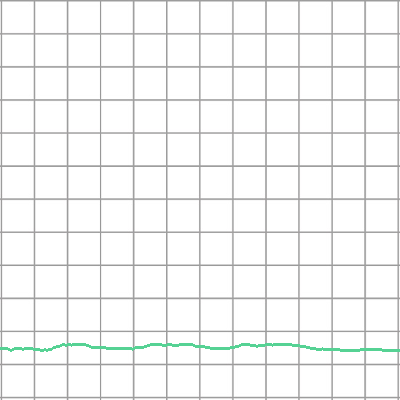

pitch70_thick0_color5_0_validation.png


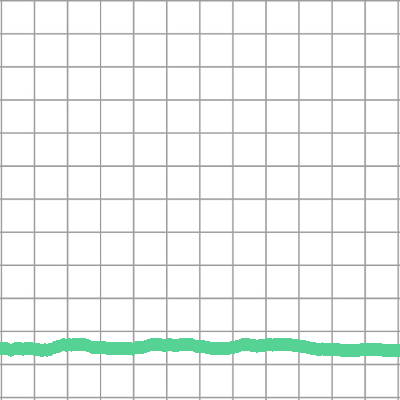

pitch70_thick1_color5_0_validation.png


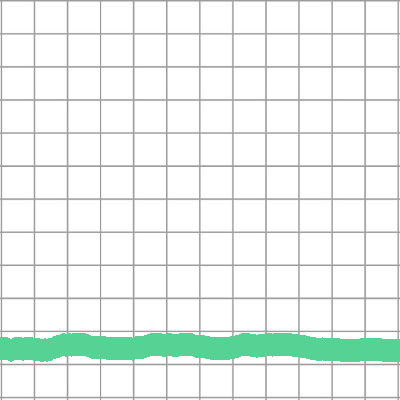

pitch70_thick2_color5_0_validation.png


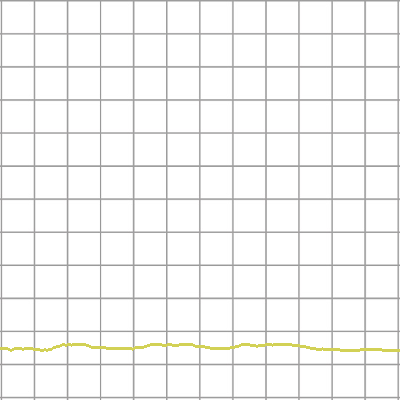

pitch70_thick0_color6_0_validation.png


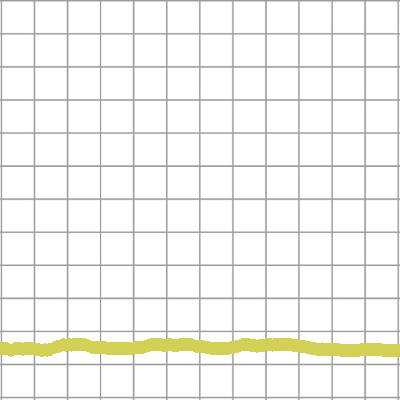

pitch70_thick1_color6_0_validation.png


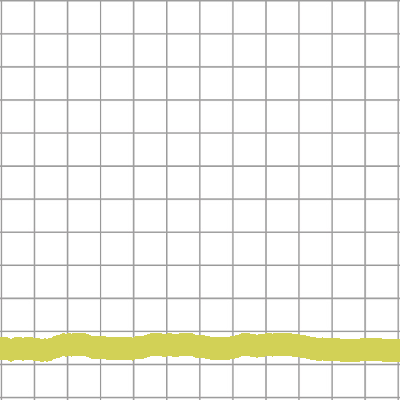

pitch70_thick2_color6_0_validation.png


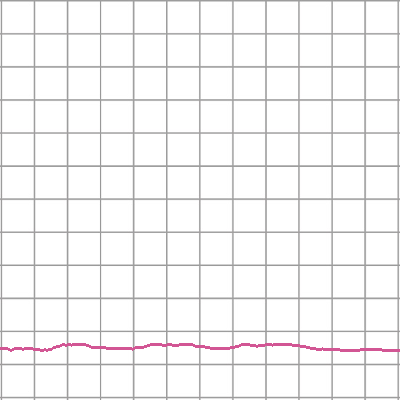

pitch70_thick0_color7_0_validation.png


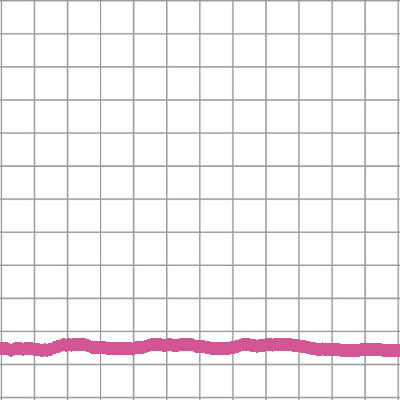

pitch70_thick1_color7_0_validation.png


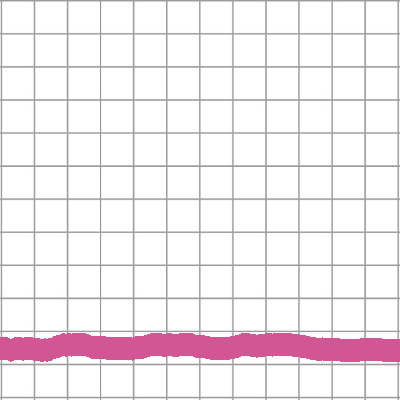

pitch70_thick2_color7_0_validation.png


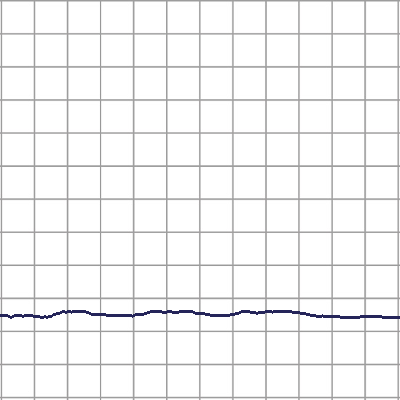

pitch71_thick0_color0_0_validation.png


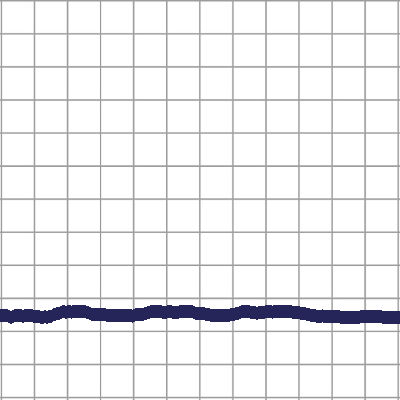

pitch71_thick1_color0_0_validation.png


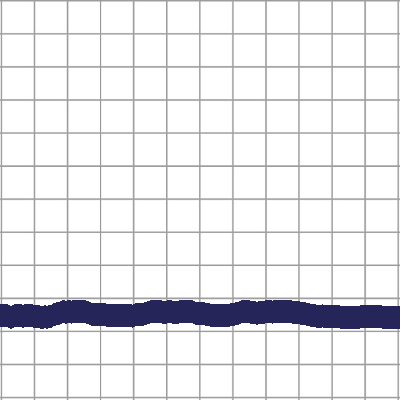

pitch71_thick2_color0_0_validation.png


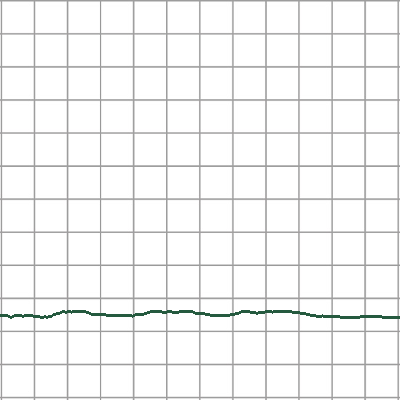

pitch71_thick0_color1_0_validation.png


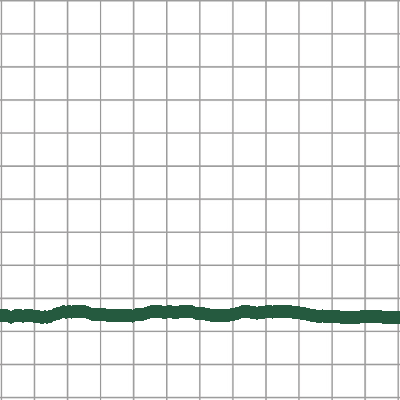

pitch71_thick1_color1_0_validation.png


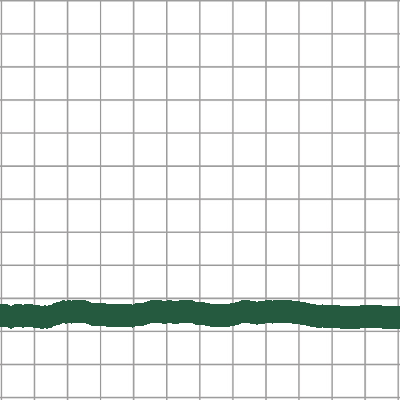

pitch71_thick2_color1_0_validation.png


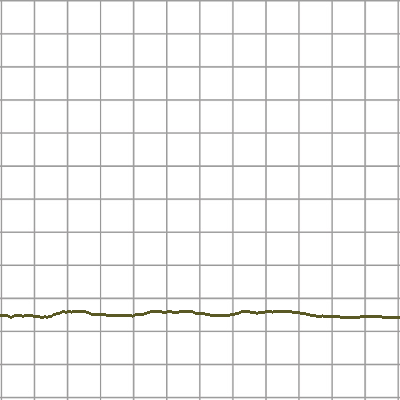

pitch71_thick0_color2_0_validation.png


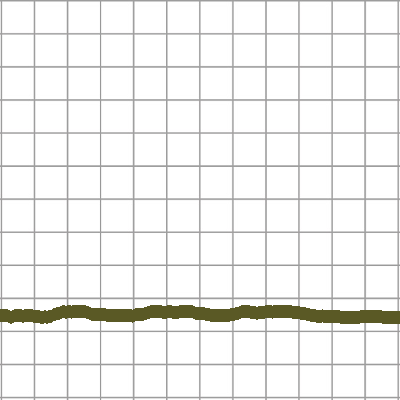

pitch71_thick1_color2_0_validation.png


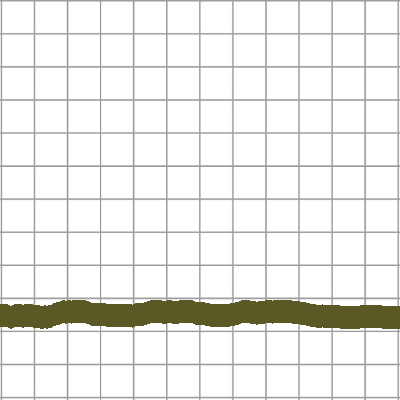

pitch71_thick2_color2_0_validation.png


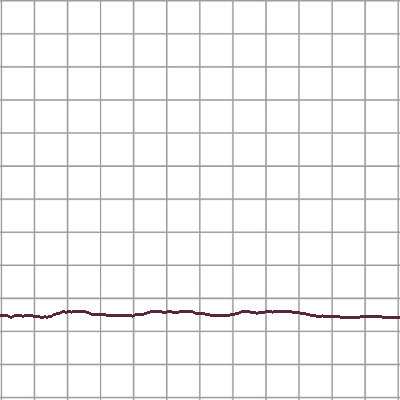

pitch71_thick0_color3_0_validation.png


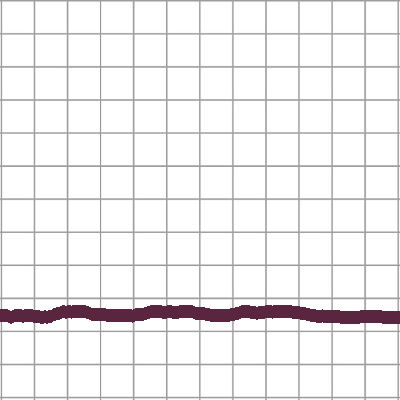

pitch71_thick1_color3_0_validation.png


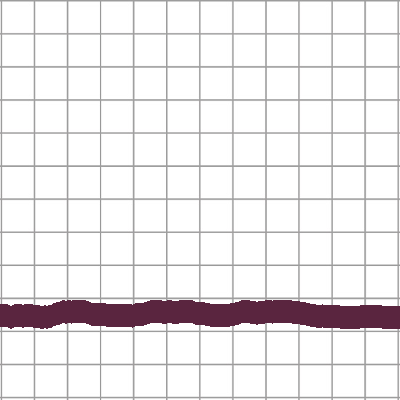

pitch71_thick2_color3_0_validation.png


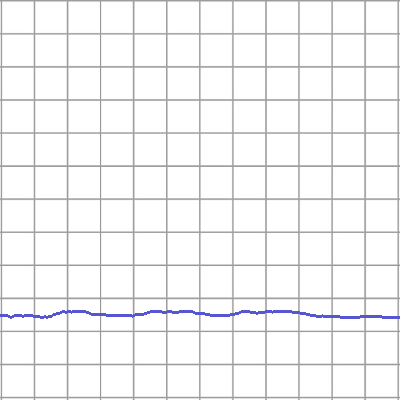

pitch71_thick0_color4_0_validation.png


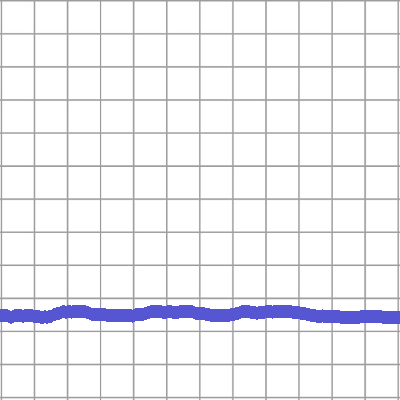

pitch71_thick1_color4_0_validation.png


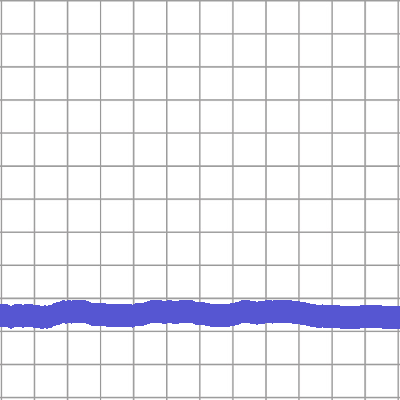

pitch71_thick2_color4_0_validation.png


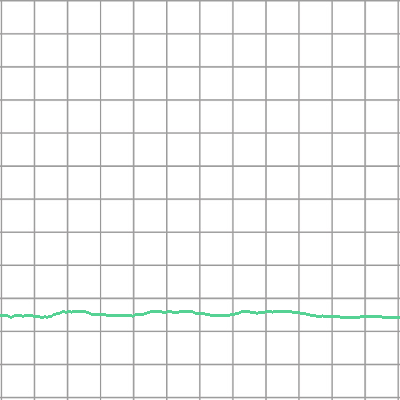

pitch71_thick0_color5_0_validation.png


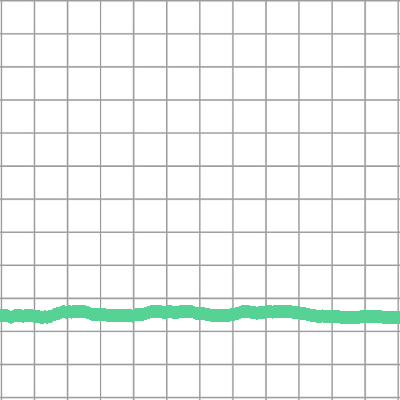

pitch71_thick1_color5_0_validation.png


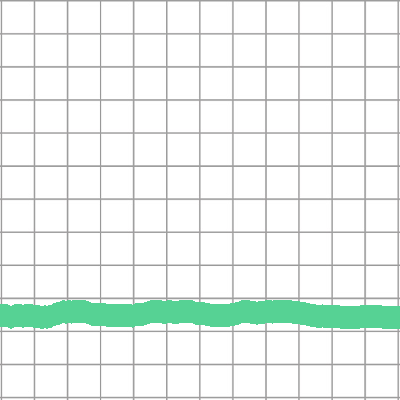

pitch71_thick2_color5_0_validation.png


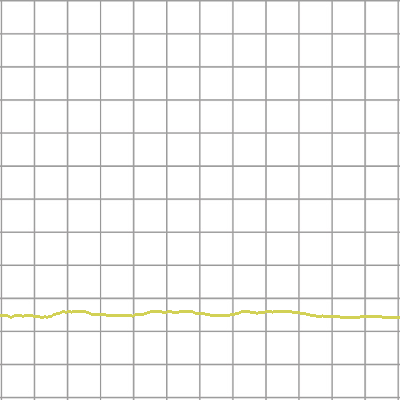

pitch71_thick0_color6_0_validation.png


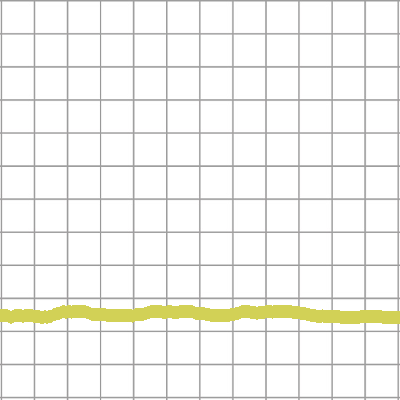

pitch71_thick1_color6_0_validation.png


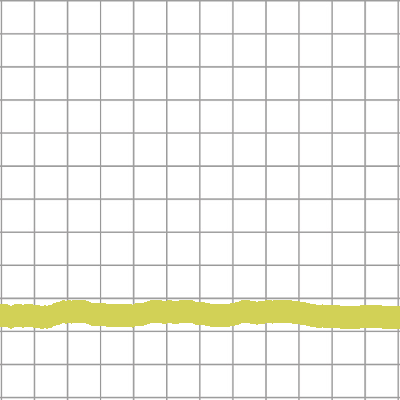

pitch71_thick2_color6_0_validation.png


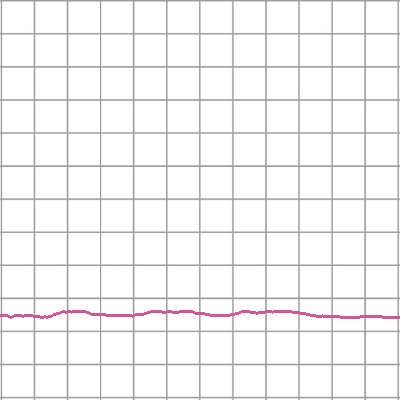

pitch71_thick0_color7_0_validation.png


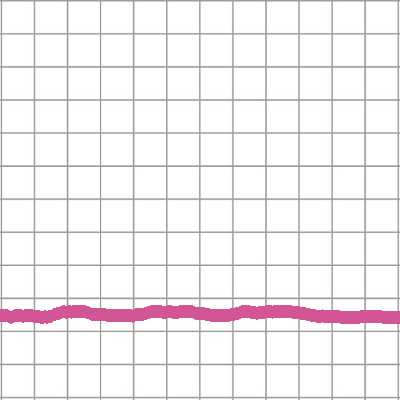

pitch71_thick1_color7_0_validation.png


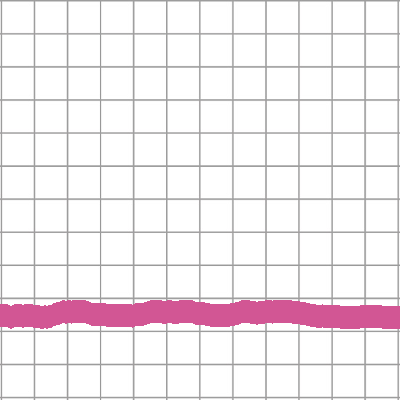

pitch71_thick2_color7_0_validation.png


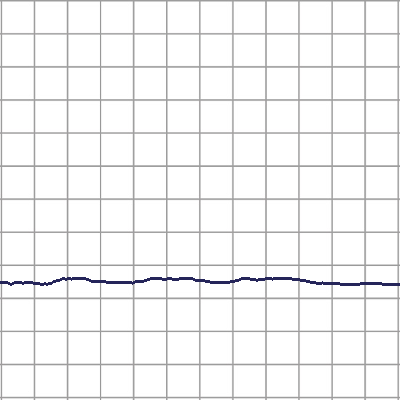

pitch72_thick0_color0_0_validation.png


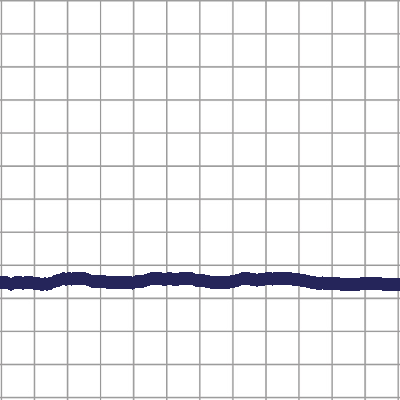

pitch72_thick1_color0_0_validation.png


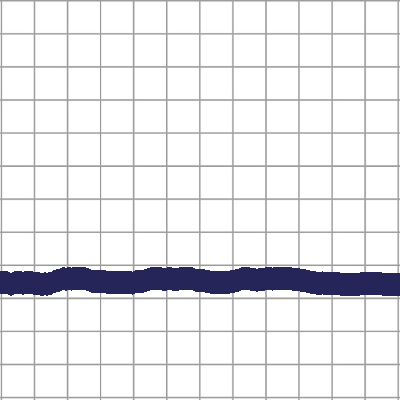

pitch72_thick2_color0_0_validation.png


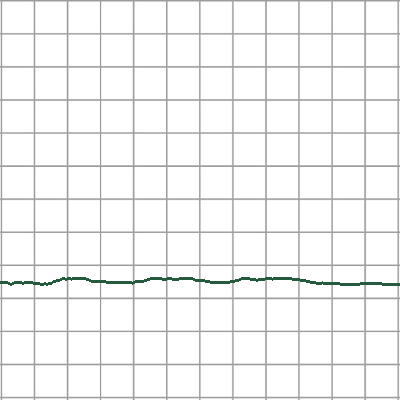

pitch72_thick0_color1_0_validation.png


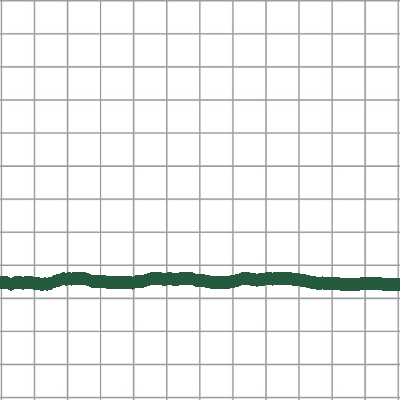

pitch72_thick1_color1_0_validation.png


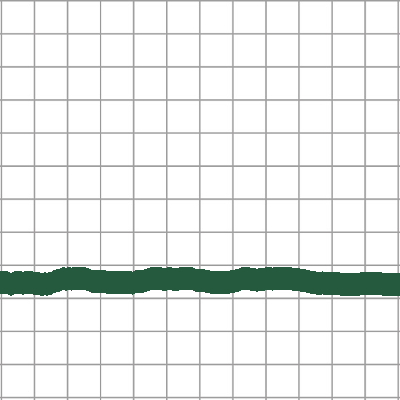

pitch72_thick2_color1_0_validation.png


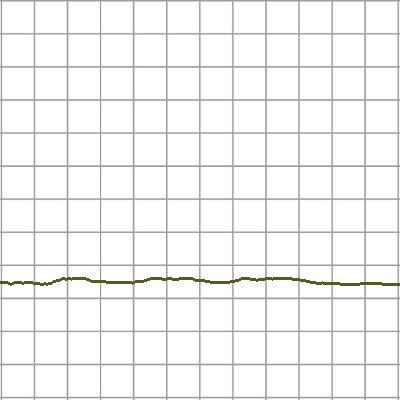

pitch72_thick0_color2_0_validation.png


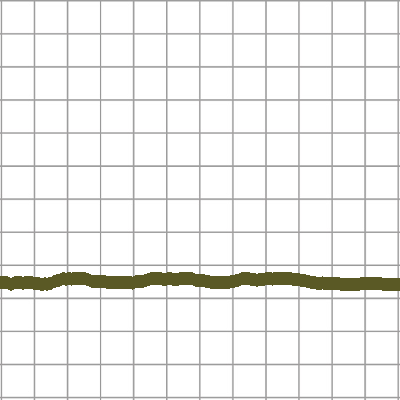

pitch72_thick1_color2_0_validation.png


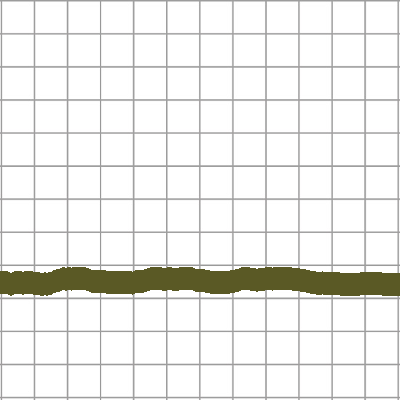

pitch72_thick2_color2_0_validation.png


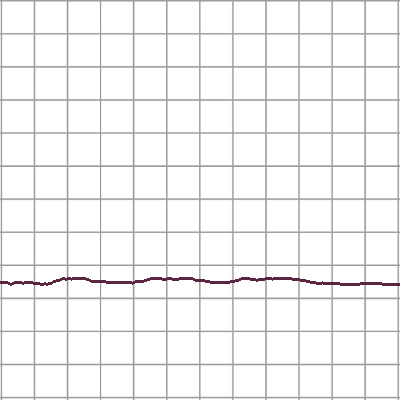

pitch72_thick0_color3_0_validation.png


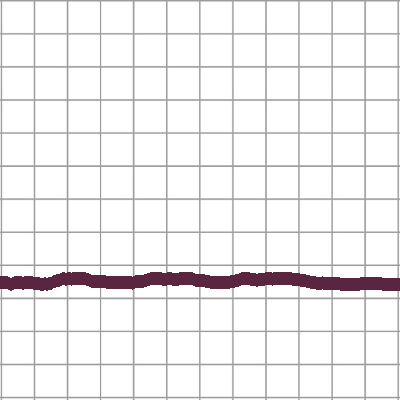

pitch72_thick1_color3_0_validation.png


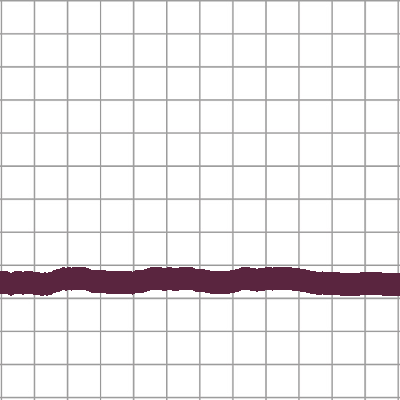

pitch72_thick2_color3_0_validation.png


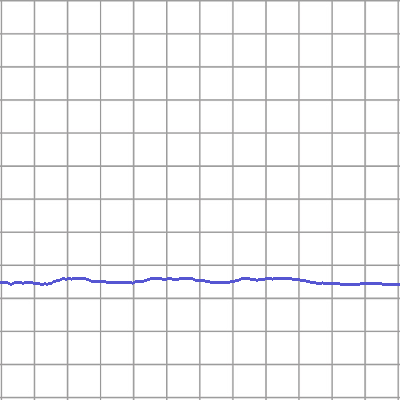

pitch72_thick0_color4_0_validation.png


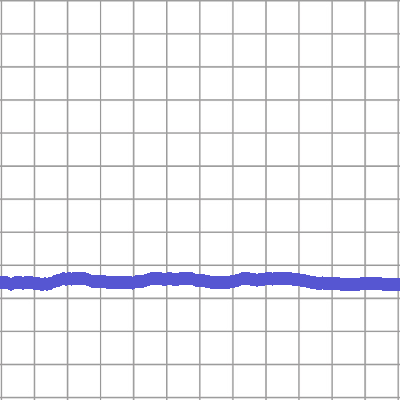

pitch72_thick1_color4_0_validation.png


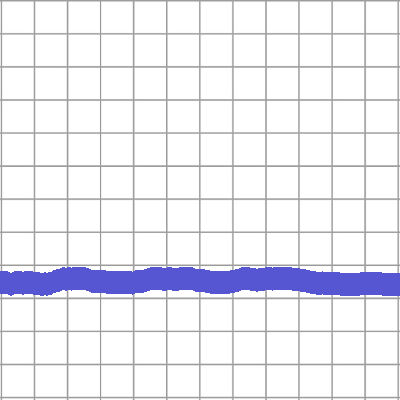

pitch72_thick2_color4_0_validation.png


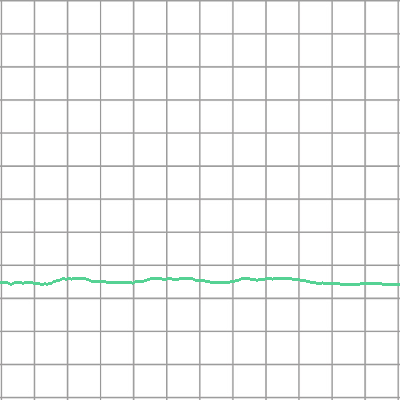

pitch72_thick0_color5_0_validation.png


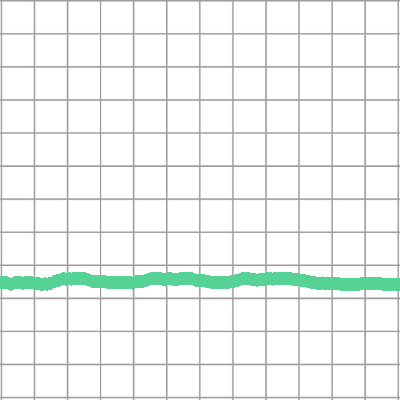

pitch72_thick1_color5_0_validation.png


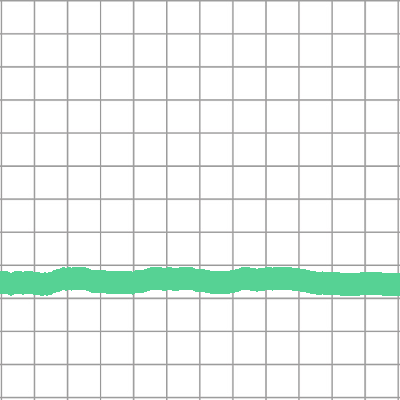

pitch72_thick2_color5_0_validation.png


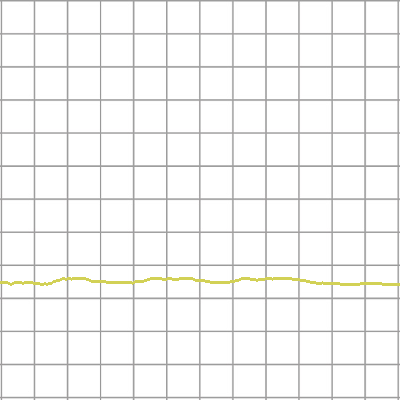

pitch72_thick0_color6_0_validation.png


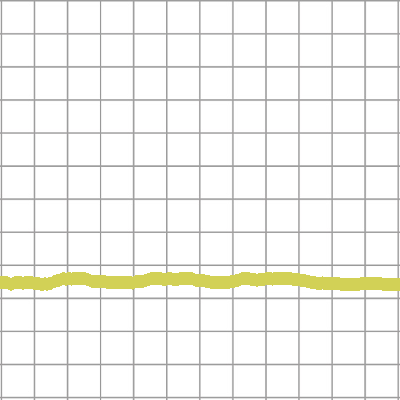

pitch72_thick1_color6_0_validation.png


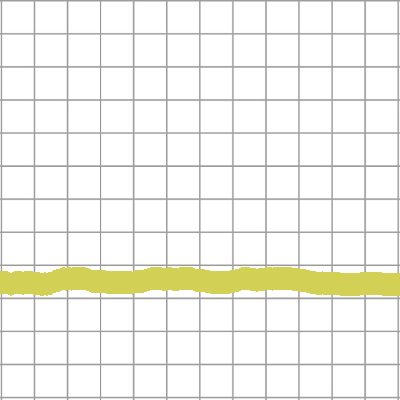

pitch72_thick2_color6_0_validation.png


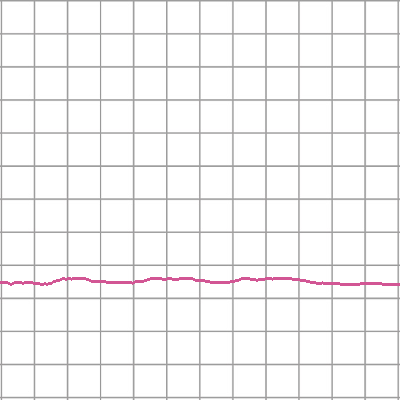

pitch72_thick0_color7_0_validation.png


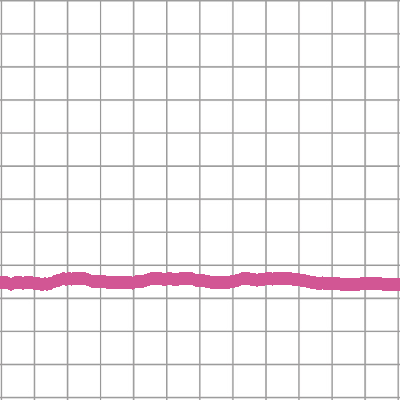

pitch72_thick1_color7_0_validation.png


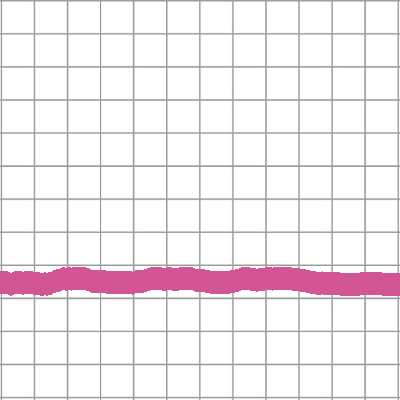

pitch72_thick2_color7_0_validation.png


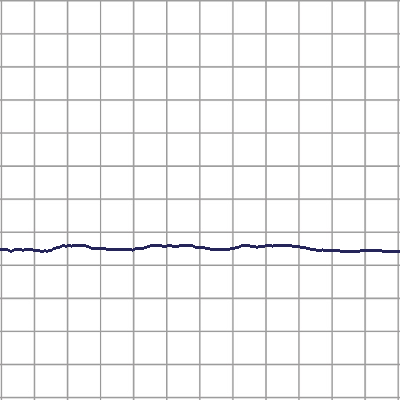

pitch73_thick0_color0_0_validation.png


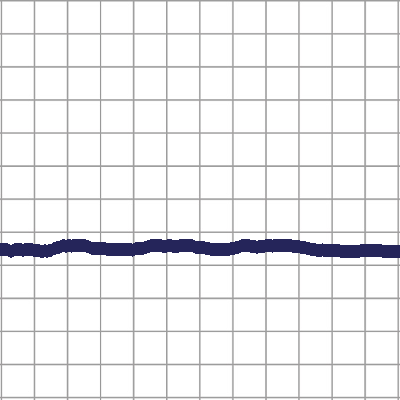

pitch73_thick1_color0_0_validation.png


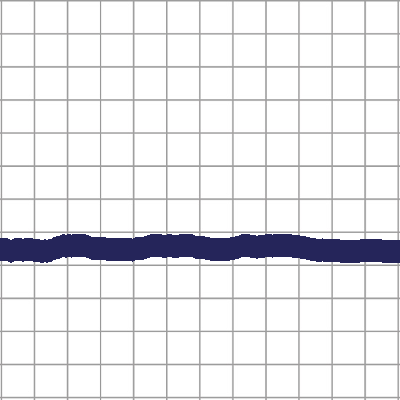

pitch73_thick2_color0_0_validation.png


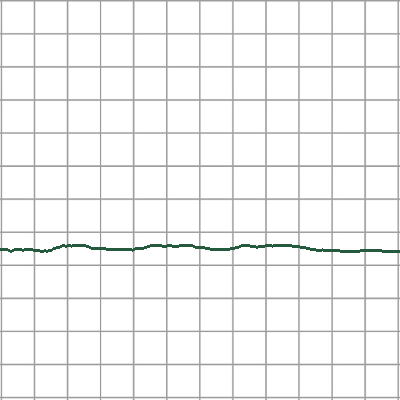

pitch73_thick0_color1_0_validation.png


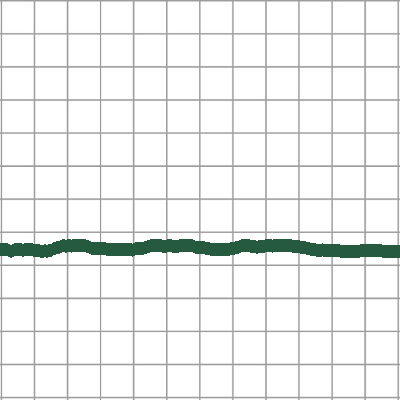

pitch73_thick1_color1_0_validation.png


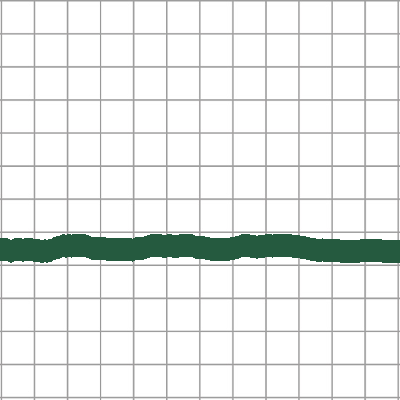

pitch73_thick2_color1_0_validation.png


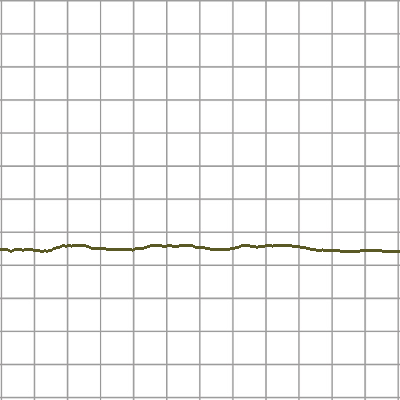

pitch73_thick0_color2_0_validation.png


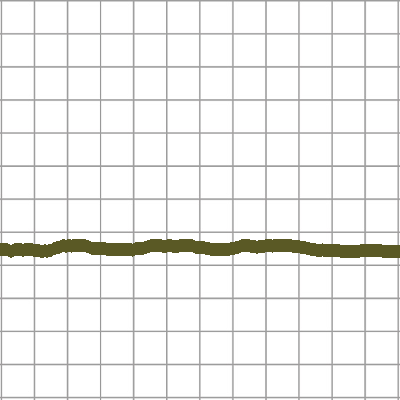

pitch73_thick1_color2_0_validation.png


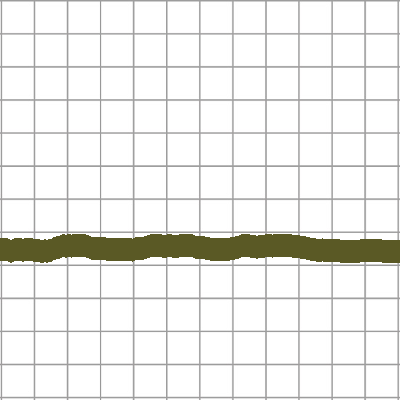

pitch73_thick2_color2_0_validation.png


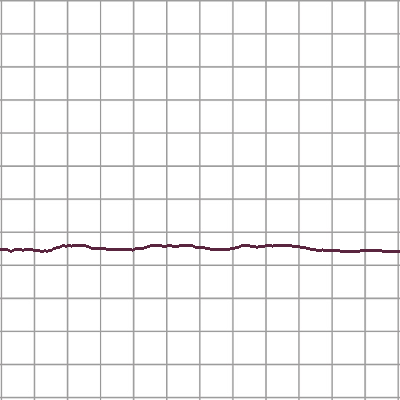

pitch73_thick0_color3_0_validation.png


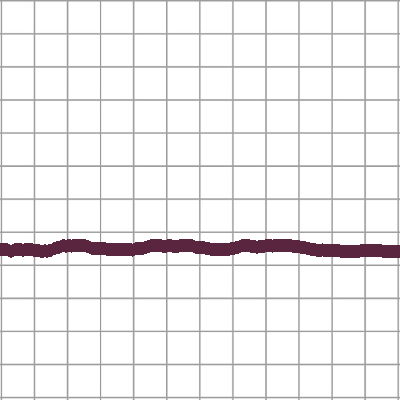

pitch73_thick1_color3_0_validation.png


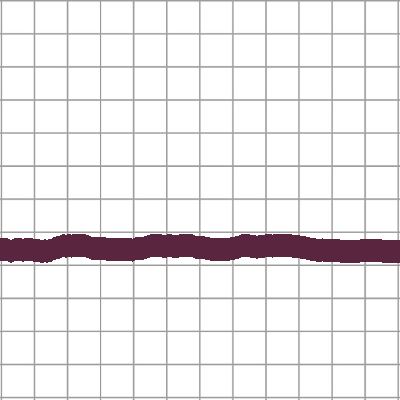

pitch73_thick2_color3_0_validation.png


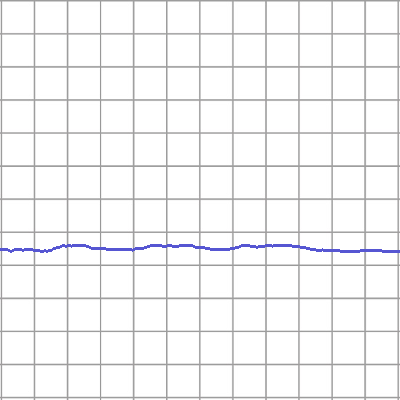

pitch73_thick0_color4_0_validation.png


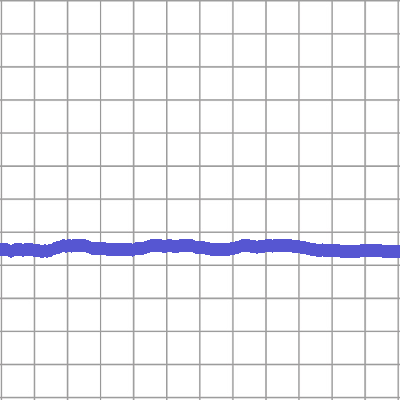

pitch73_thick1_color4_0_validation.png


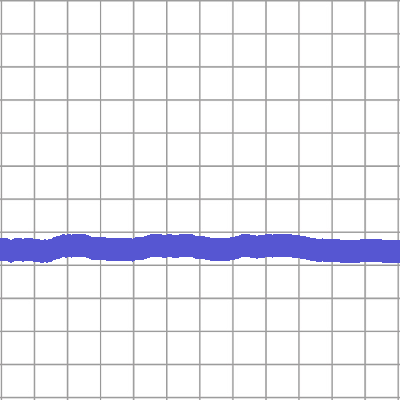

pitch73_thick2_color4_0_validation.png


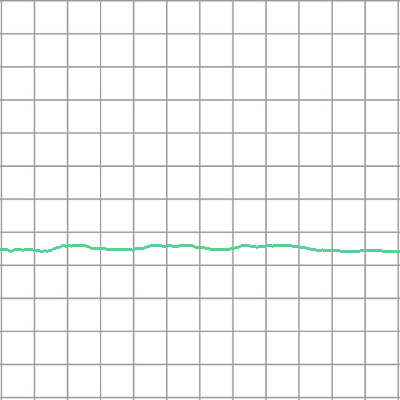

pitch73_thick0_color5_0_validation.png


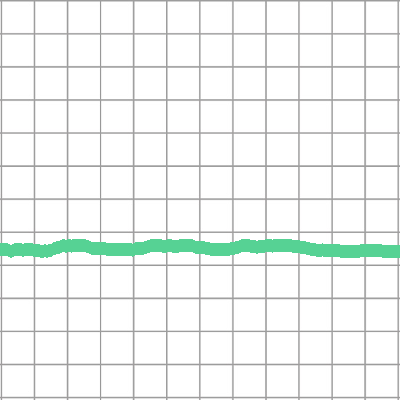

pitch73_thick1_color5_0_validation.png


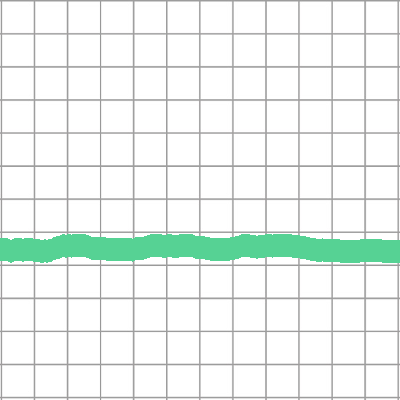

pitch73_thick2_color5_0_validation.png


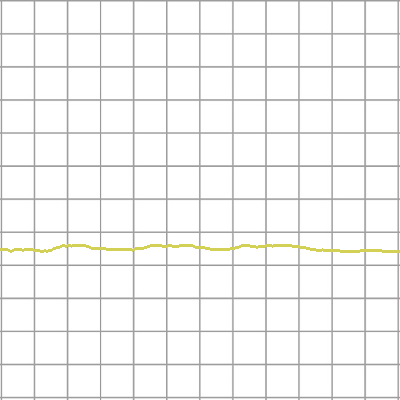

pitch73_thick0_color6_0_validation.png


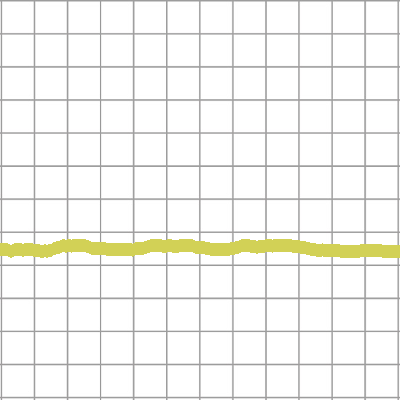

pitch73_thick1_color6_0_validation.png


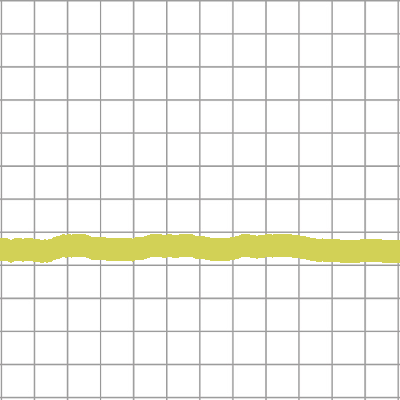

pitch73_thick2_color6_0_validation.png


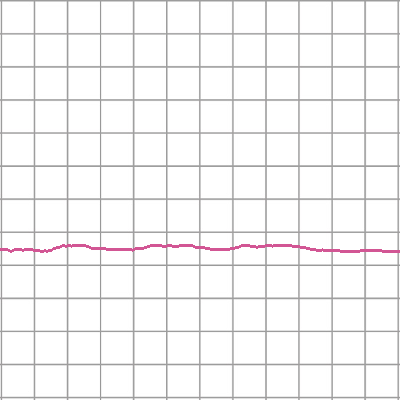

pitch73_thick0_color7_0_validation.png


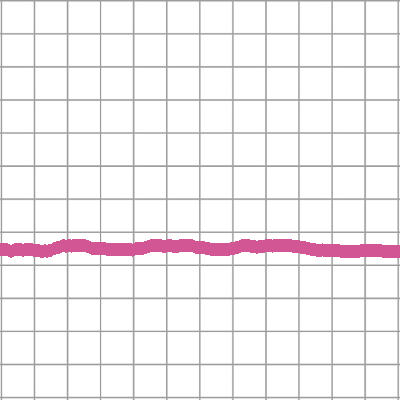

pitch73_thick1_color7_0_validation.png


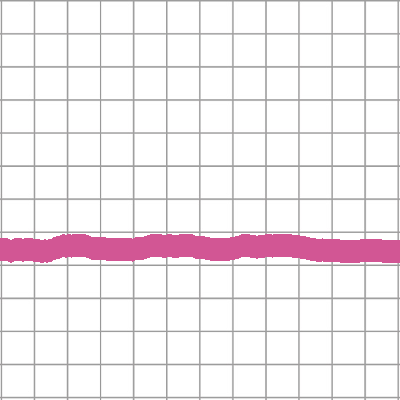

pitch73_thick2_color7_0_validation.png


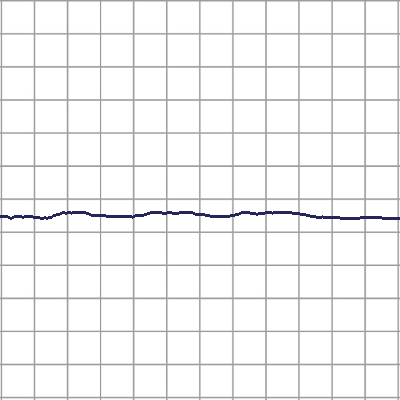

pitch74_thick0_color0_0_validation.png


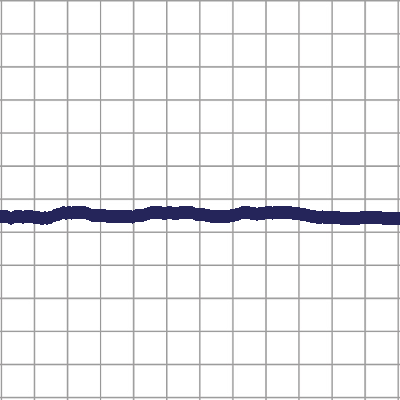

pitch74_thick1_color0_0_validation.png


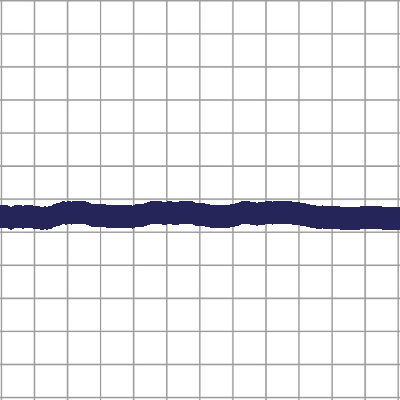

pitch74_thick2_color0_0_validation.png


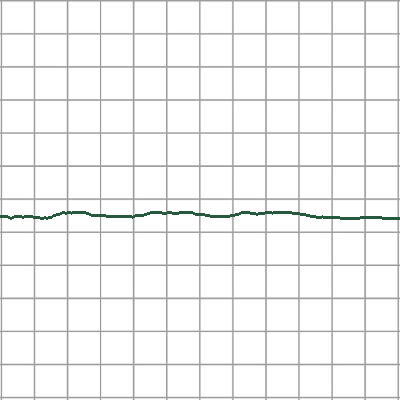

pitch74_thick0_color1_0_validation.png


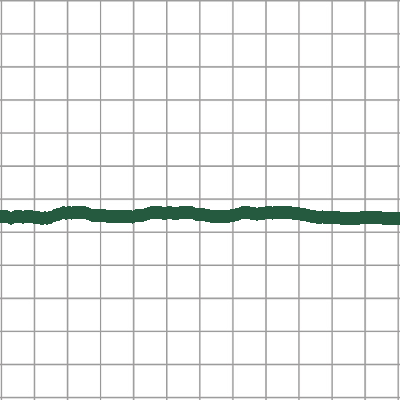

pitch74_thick1_color1_0_validation.png


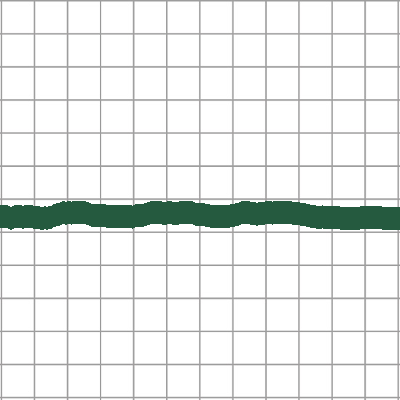

pitch74_thick2_color1_0_validation.png


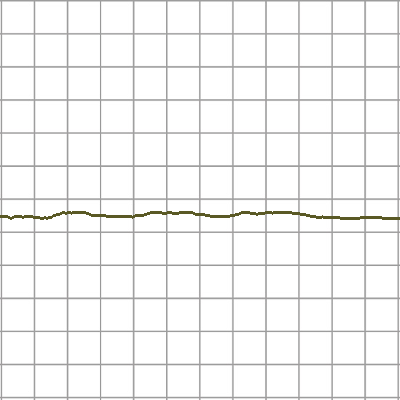

pitch74_thick0_color2_0_validation.png


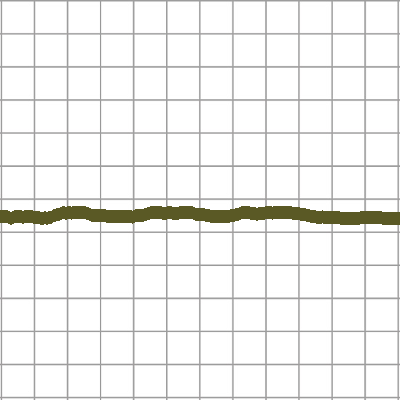

pitch74_thick1_color2_0_validation.png


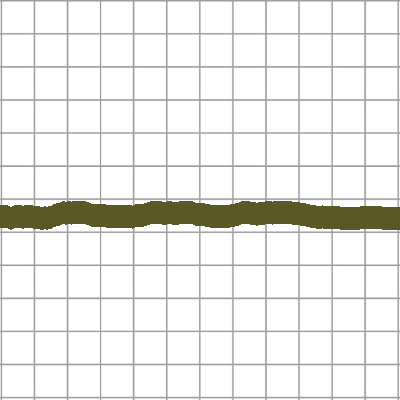

pitch74_thick2_color2_0_validation.png


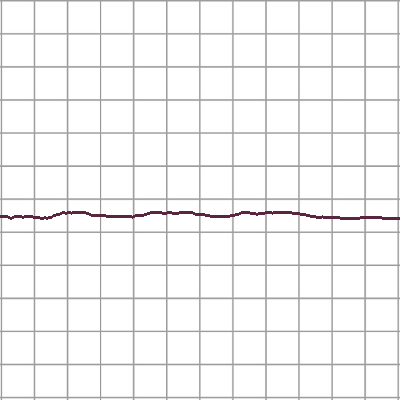

pitch74_thick0_color3_0_validation.png


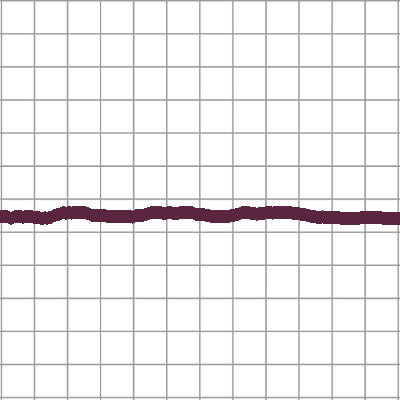

pitch74_thick1_color3_0_validation.png


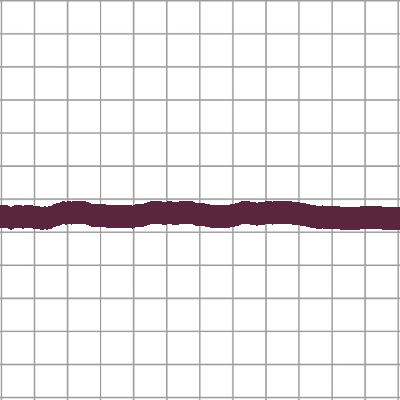

pitch74_thick2_color3_0_validation.png


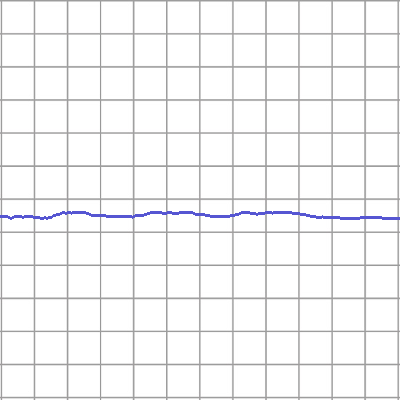

pitch74_thick0_color4_0_validation.png


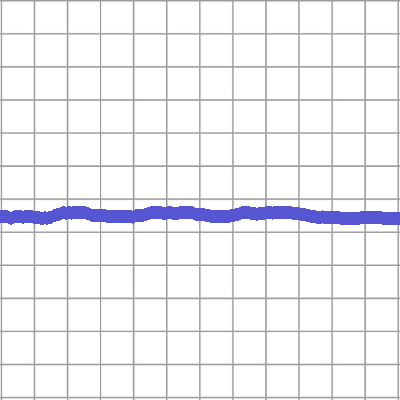

pitch74_thick1_color4_0_validation.png


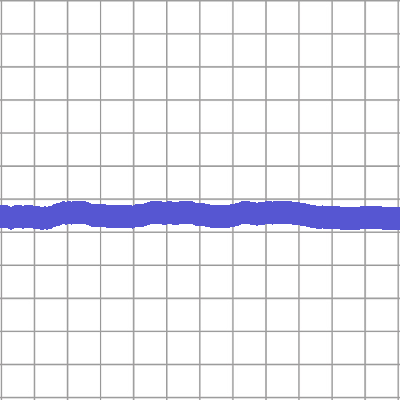

pitch74_thick2_color4_0_validation.png


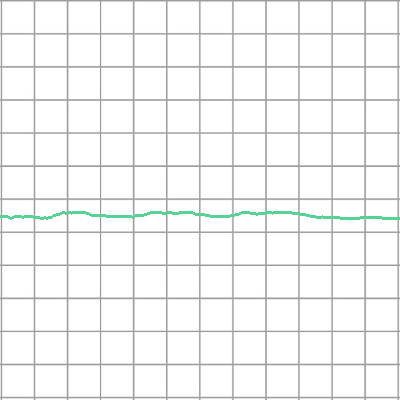

pitch74_thick0_color5_0_validation.png


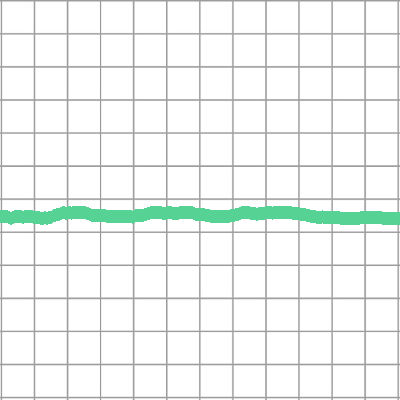

pitch74_thick1_color5_0_validation.png


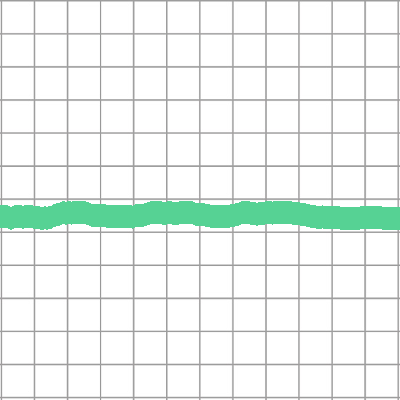

pitch74_thick2_color5_0_validation.png


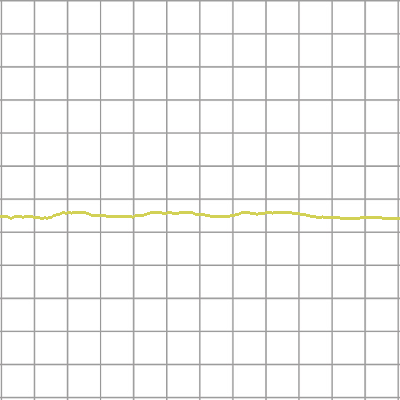

pitch74_thick0_color6_0_validation.png


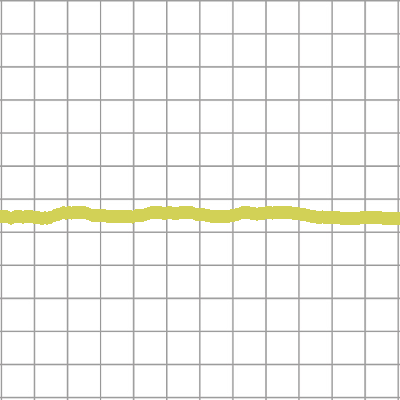

pitch74_thick1_color6_0_validation.png


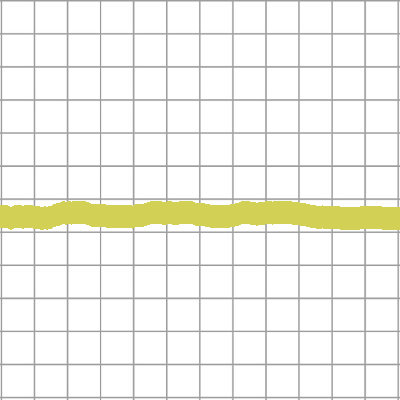

pitch74_thick2_color6_0_validation.png


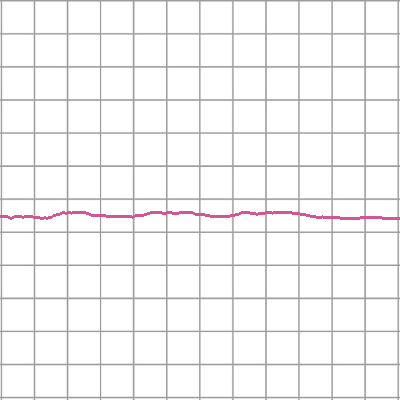

pitch74_thick0_color7_0_validation.png


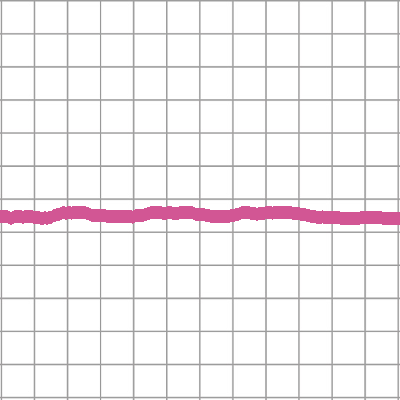

pitch74_thick1_color7_0_validation.png


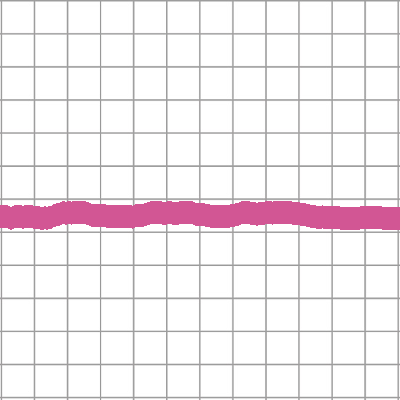

pitch74_thick2_color7_0_validation.png


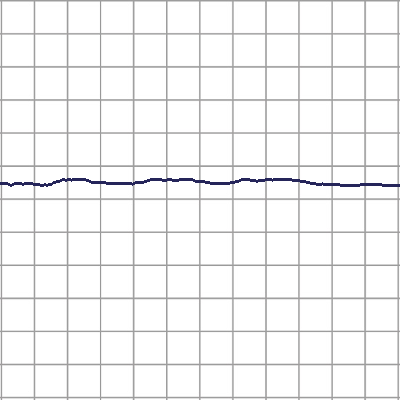

pitch75_thick0_color0_0_validation.png


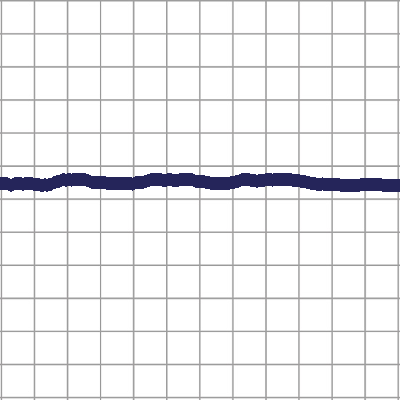

pitch75_thick1_color0_0_validation.png


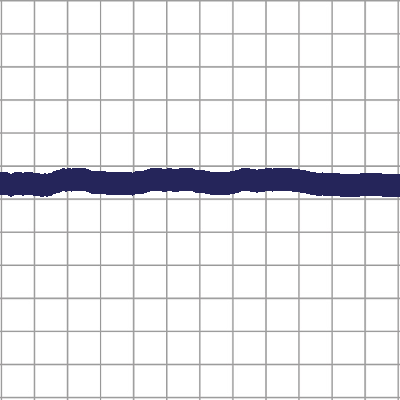

pitch75_thick2_color0_0_validation.png


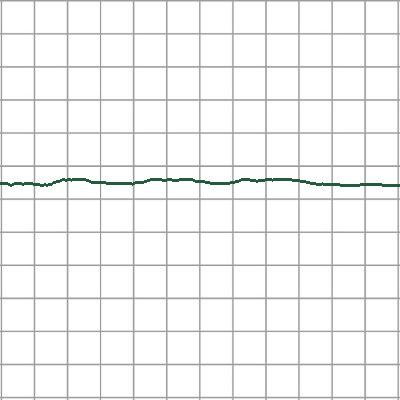

pitch75_thick0_color1_0_validation.png


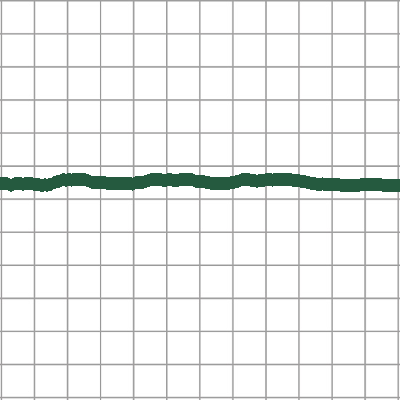

pitch75_thick1_color1_0_validation.png


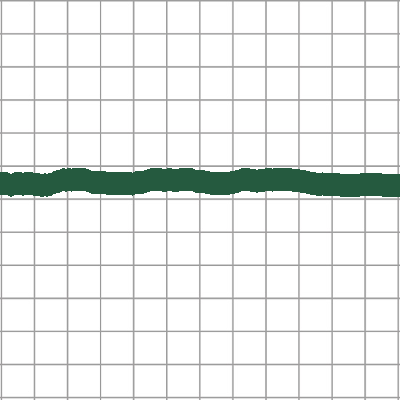

pitch75_thick2_color1_0_validation.png


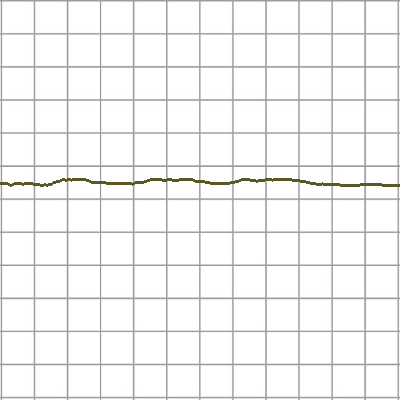

pitch75_thick0_color2_0_validation.png


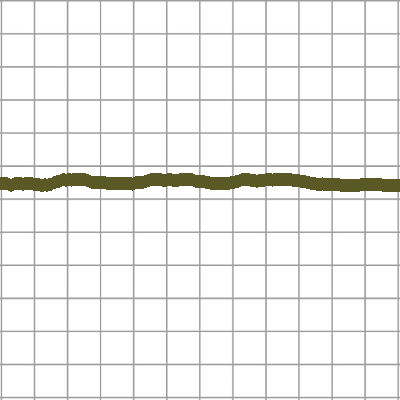

pitch75_thick1_color2_0_validation.png


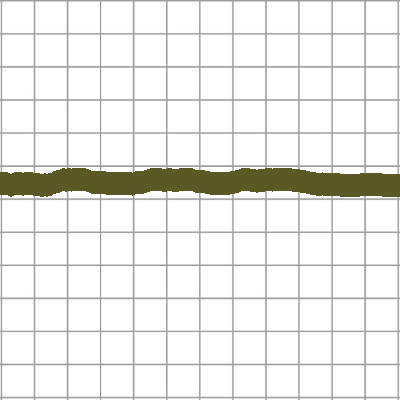

pitch75_thick2_color2_0_validation.png


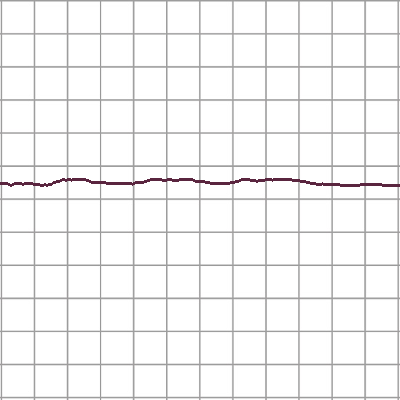

pitch75_thick0_color3_0_validation.png


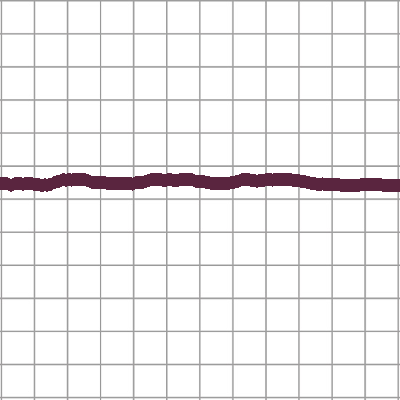

pitch75_thick1_color3_0_validation.png


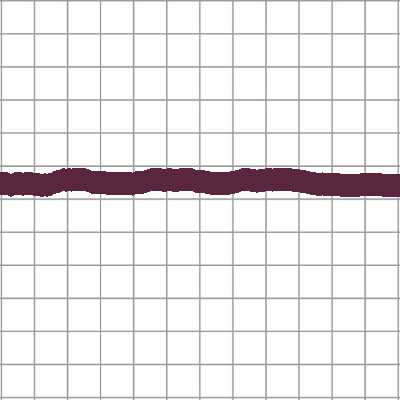

pitch75_thick2_color3_0_validation.png


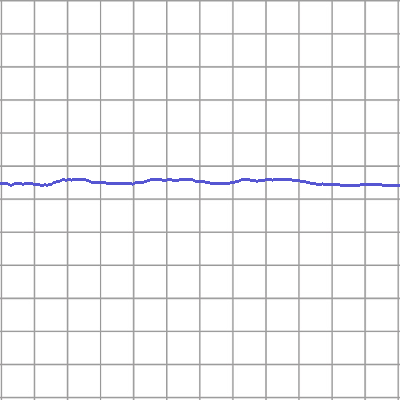

pitch75_thick0_color4_0_validation.png


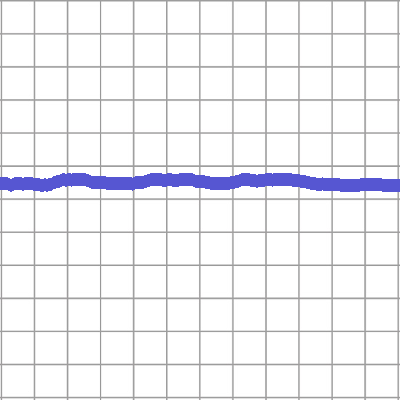

pitch75_thick1_color4_0_validation.png


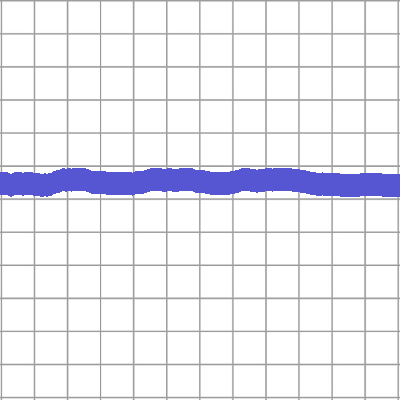

pitch75_thick2_color4_0_validation.png


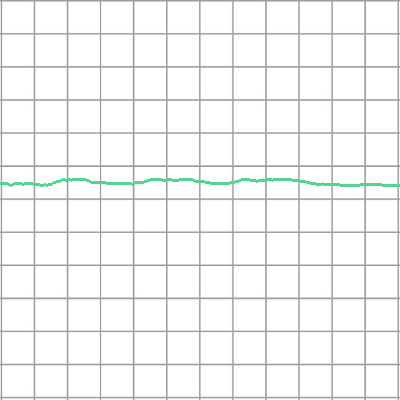

pitch75_thick0_color5_0_validation.png


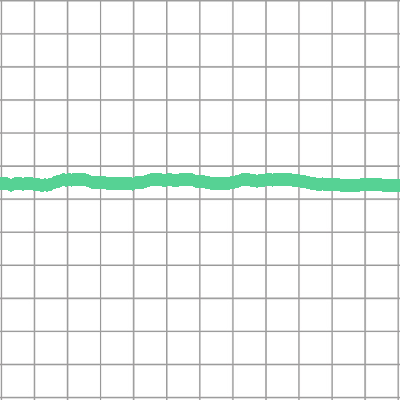

pitch75_thick1_color5_0_validation.png


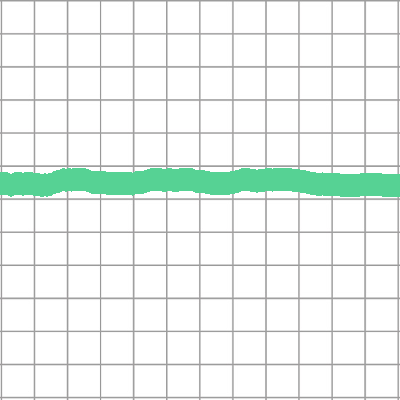

pitch75_thick2_color5_0_validation.png


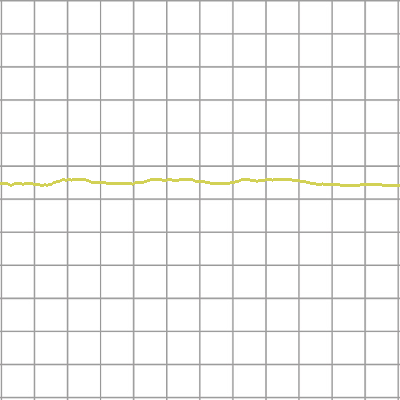

pitch75_thick0_color6_0_validation.png


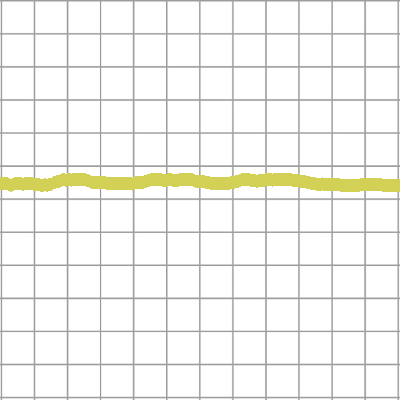

pitch75_thick1_color6_0_validation.png


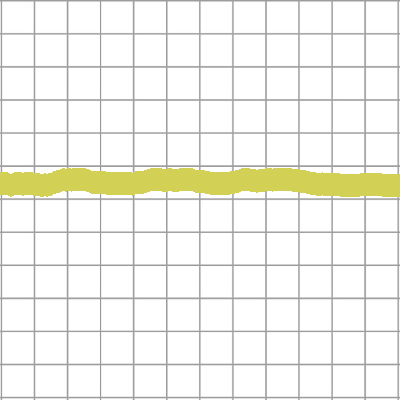

pitch75_thick2_color6_0_validation.png


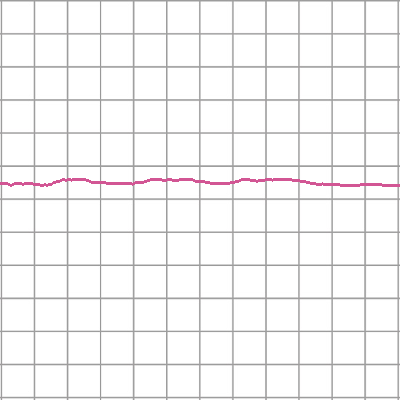

pitch75_thick0_color7_0_validation.png


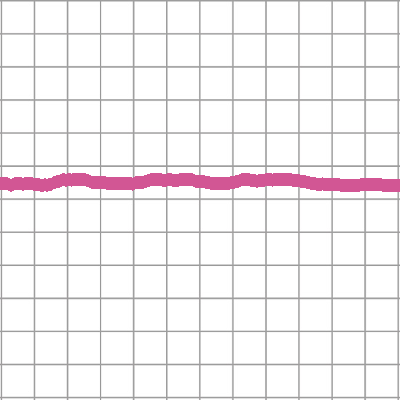

pitch75_thick1_color7_0_validation.png


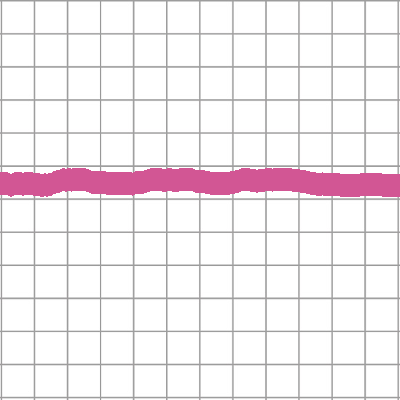

pitch75_thick2_color7_0_validation.png


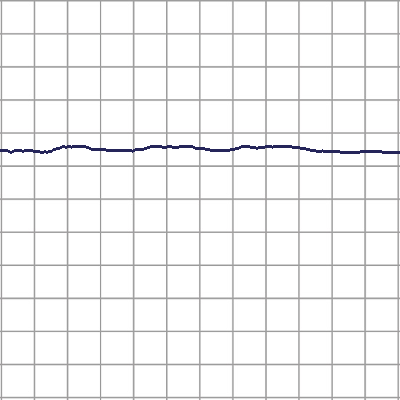

pitch76_thick0_color0_0_validation.png


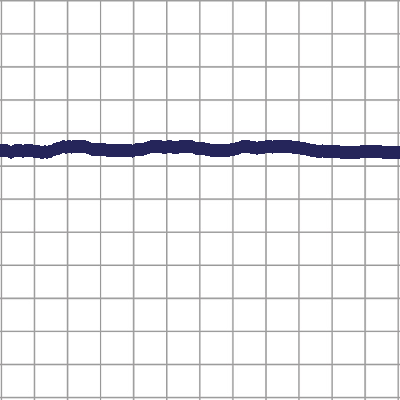

pitch76_thick1_color0_0_validation.png


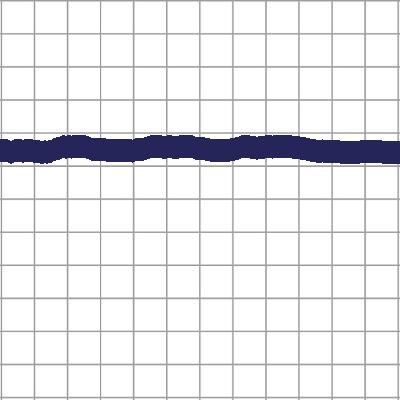

pitch76_thick2_color0_0_validation.png


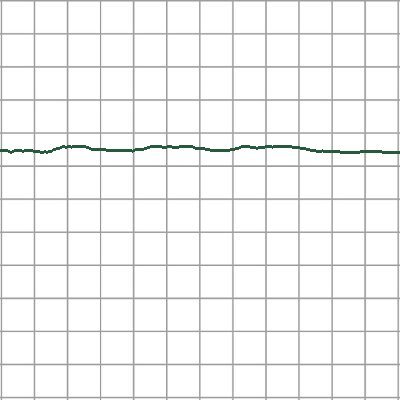

pitch76_thick0_color1_0_validation.png


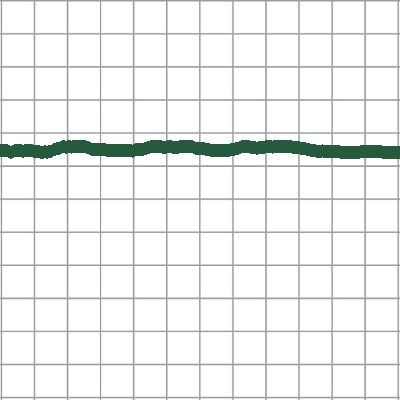

pitch76_thick1_color1_0_validation.png


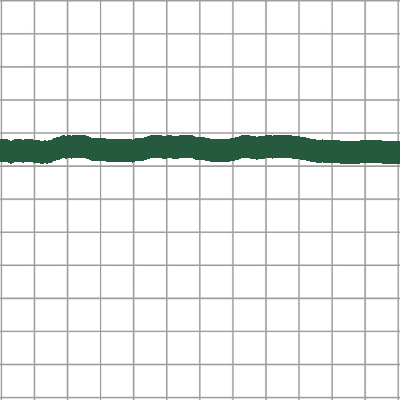

pitch76_thick2_color1_0_validation.png


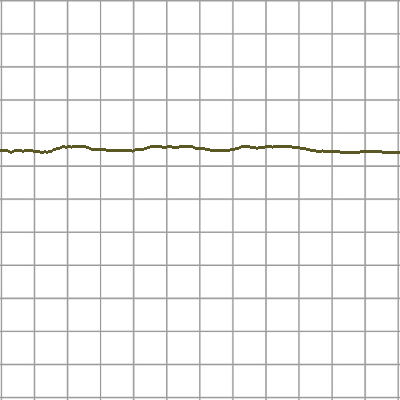

pitch76_thick0_color2_0_validation.png


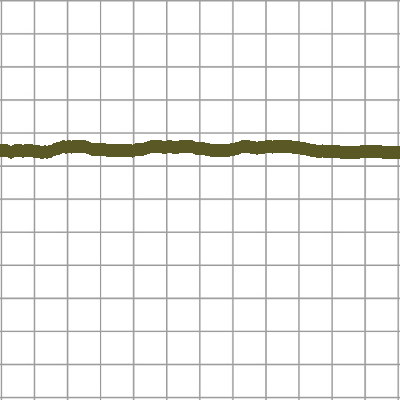

pitch76_thick1_color2_0_validation.png


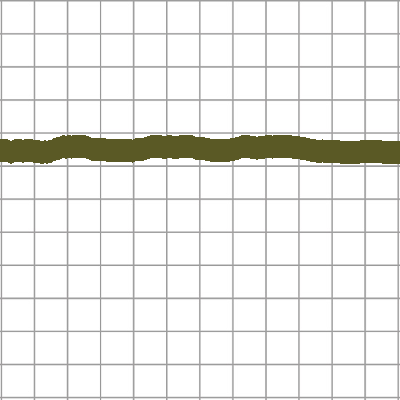

pitch76_thick2_color2_0_validation.png


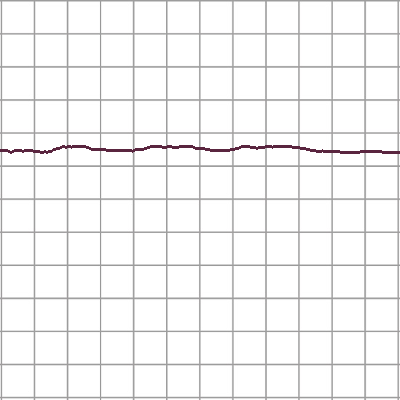

pitch76_thick0_color3_0_validation.png


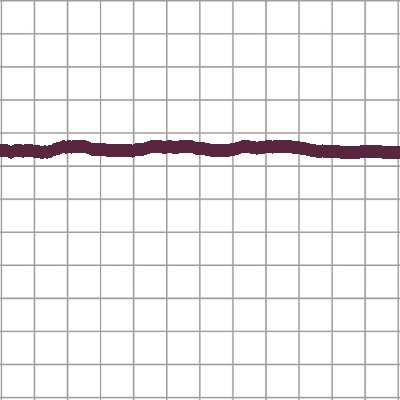

pitch76_thick1_color3_0_validation.png


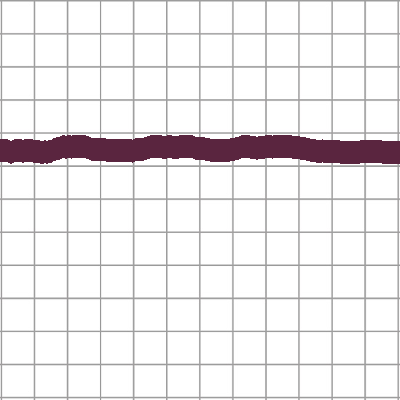

pitch76_thick2_color3_0_validation.png


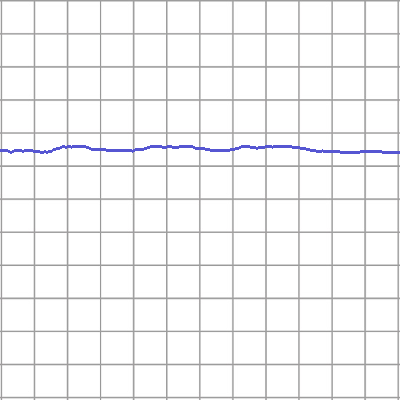

pitch76_thick0_color4_0_validation.png


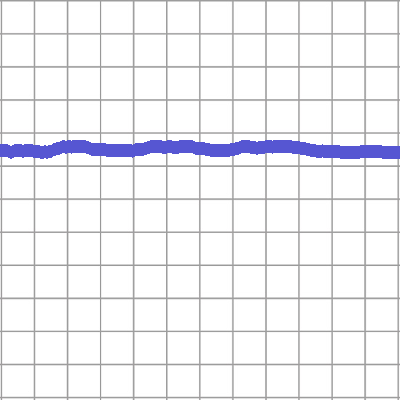

pitch76_thick1_color4_0_validation.png


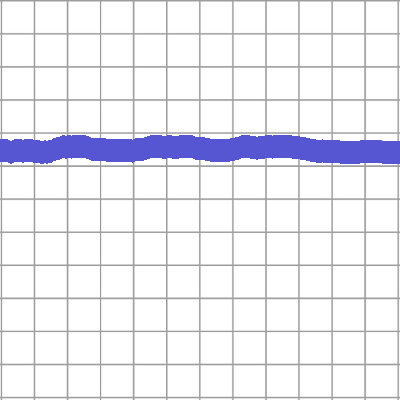

pitch76_thick2_color4_0_validation.png


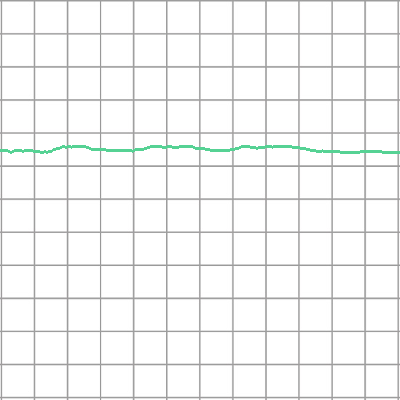

pitch76_thick0_color5_0_validation.png


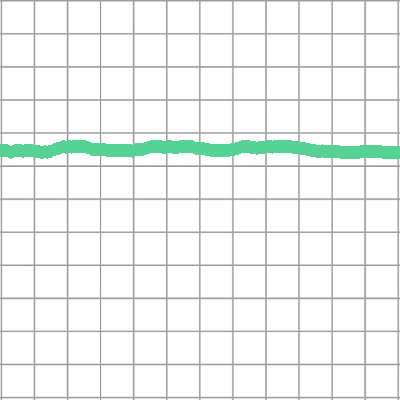

pitch76_thick1_color5_0_validation.png


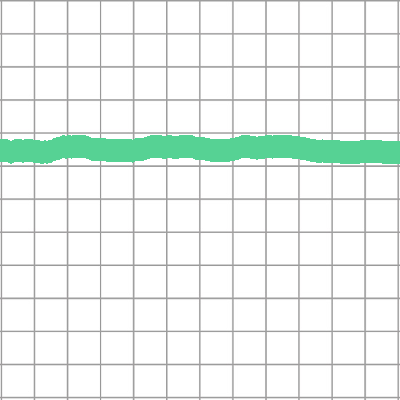

pitch76_thick2_color5_0_validation.png


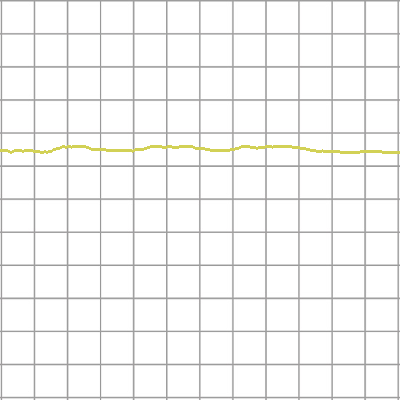

pitch76_thick0_color6_0_validation.png


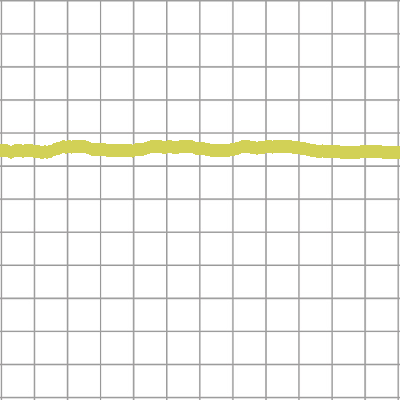

pitch76_thick1_color6_0_validation.png


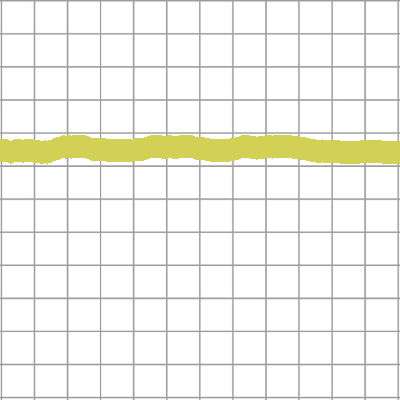

pitch76_thick2_color6_0_validation.png


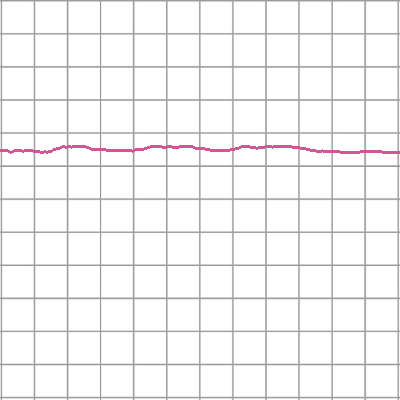

pitch76_thick0_color7_0_validation.png


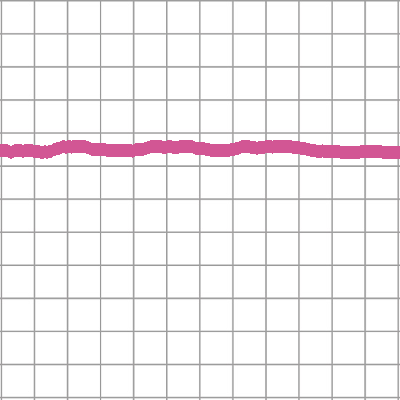

pitch76_thick1_color7_0_validation.png


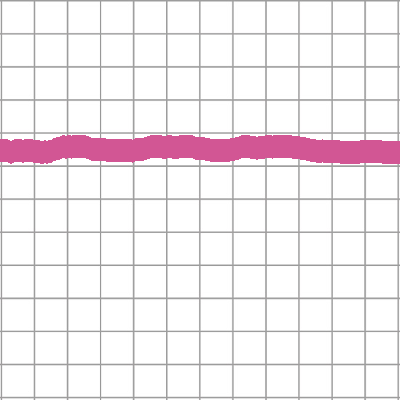

pitch76_thick2_color7_0_validation.png


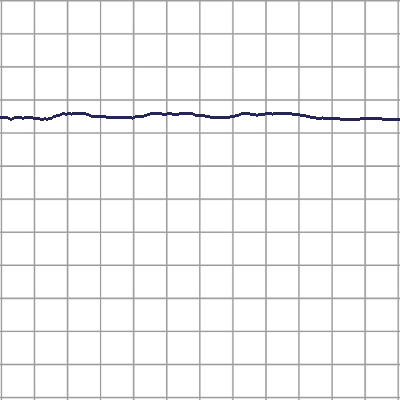

pitch77_thick0_color0_0_validation.png


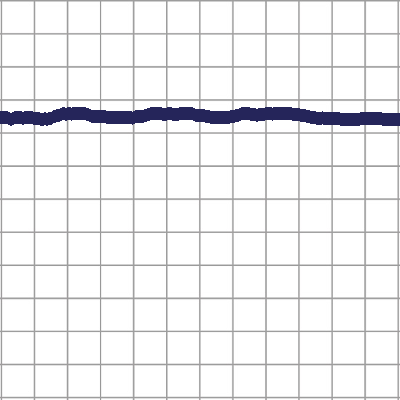

pitch77_thick1_color0_0_validation.png


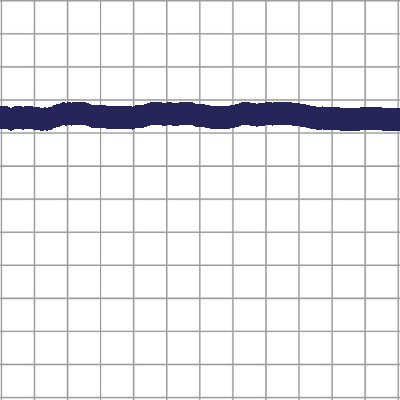

pitch77_thick2_color0_0_validation.png


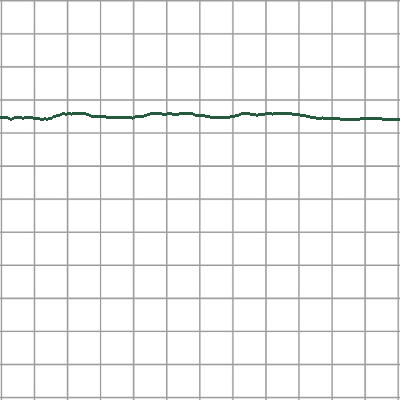

pitch77_thick0_color1_0_validation.png


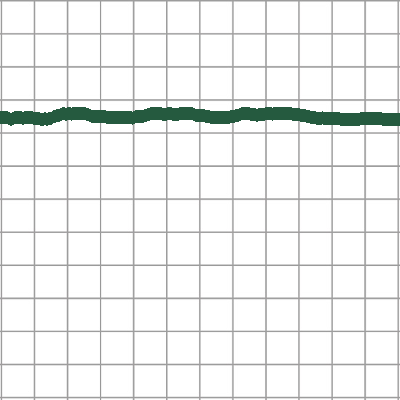

pitch77_thick1_color1_0_validation.png


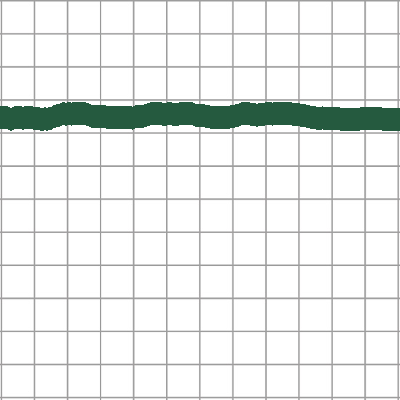

pitch77_thick2_color1_0_validation.png


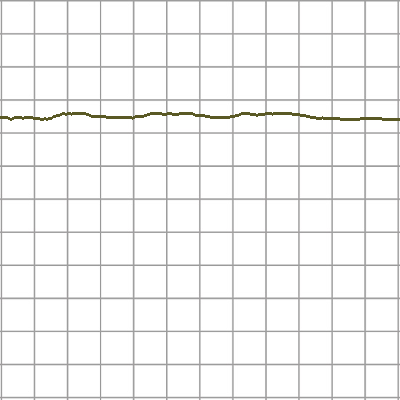

pitch77_thick0_color2_0_validation.png


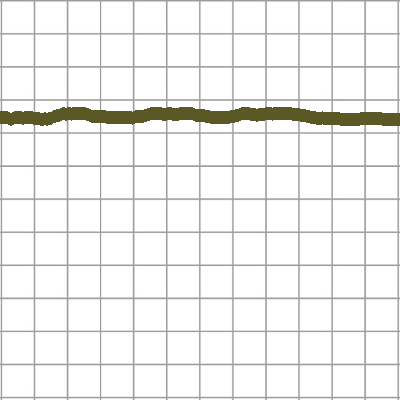

pitch77_thick1_color2_0_validation.png


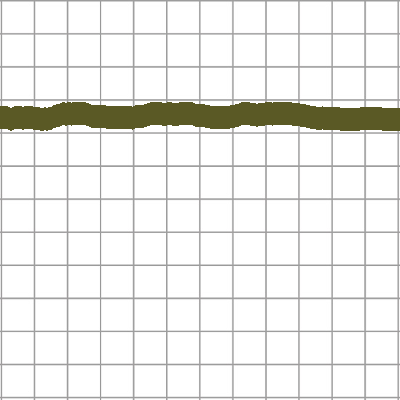

pitch77_thick2_color2_0_validation.png


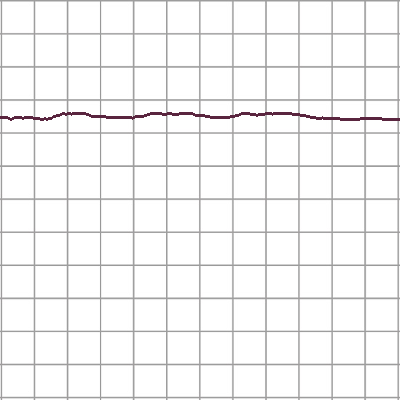

pitch77_thick0_color3_0_validation.png


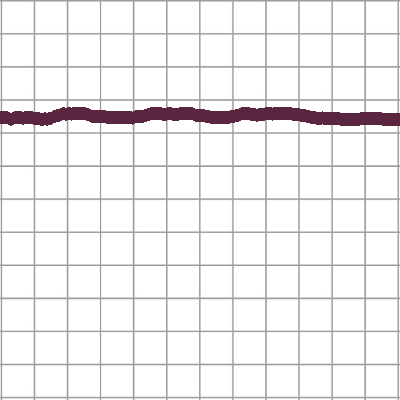

pitch77_thick1_color3_0_validation.png


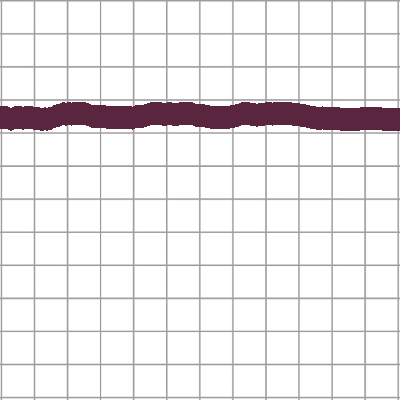

pitch77_thick2_color3_0_validation.png


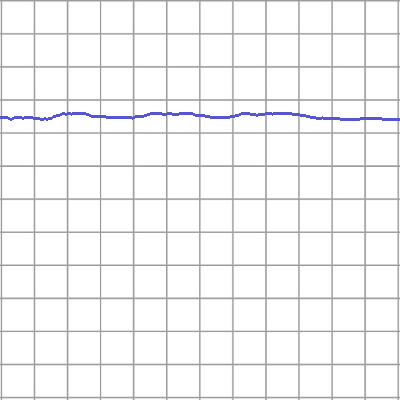

pitch77_thick0_color4_0_validation.png


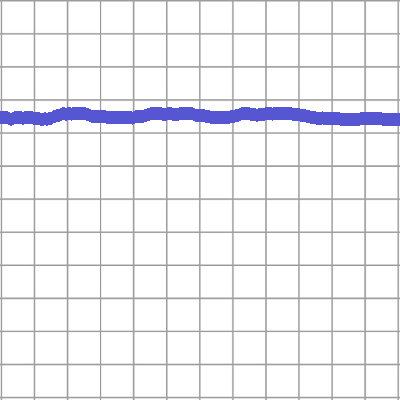

pitch77_thick1_color4_0_validation.png


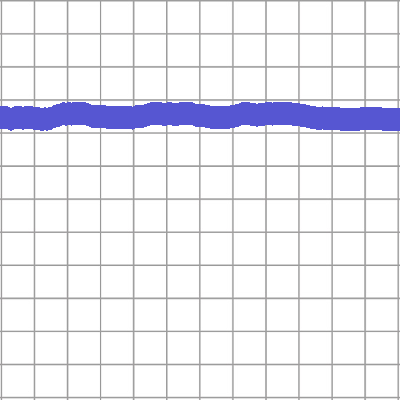

pitch77_thick2_color4_0_validation.png


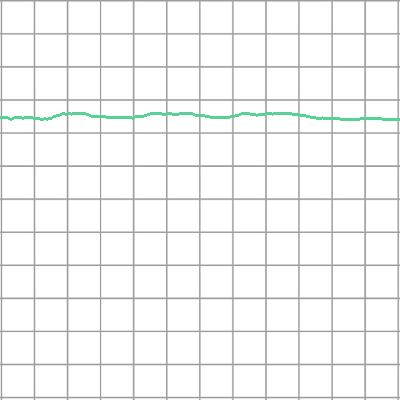

pitch77_thick0_color5_0_validation.png


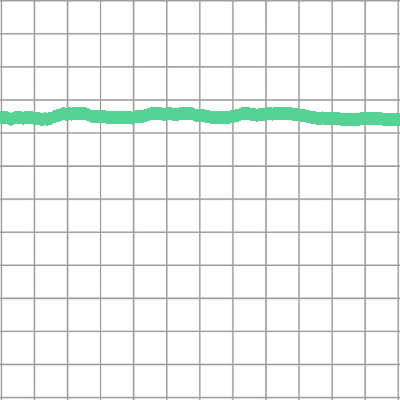

pitch77_thick1_color5_0_validation.png


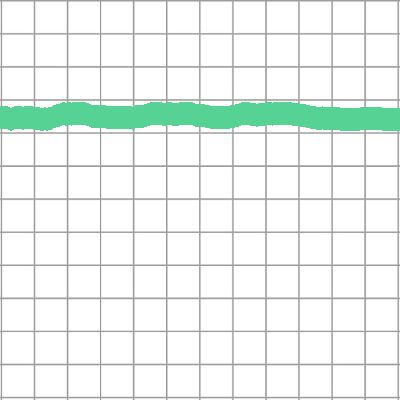

pitch77_thick2_color5_0_validation.png


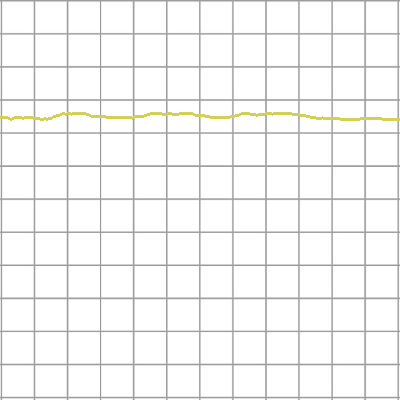

pitch77_thick0_color6_0_validation.png


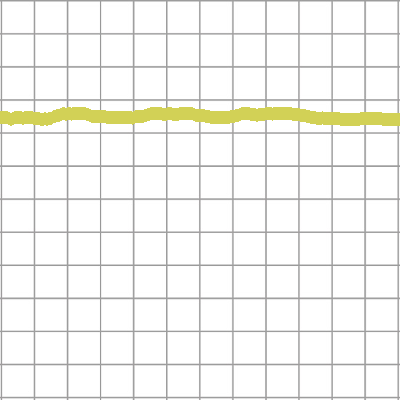

pitch77_thick1_color6_0_validation.png


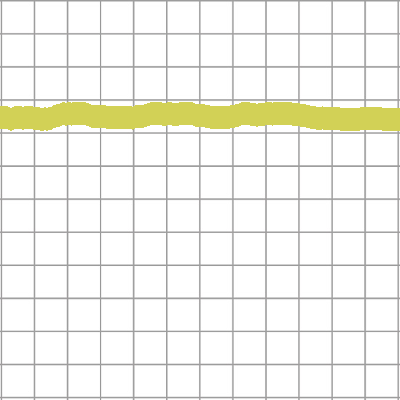

pitch77_thick2_color6_0_validation.png


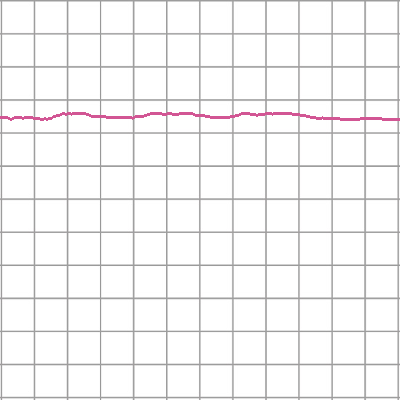

pitch77_thick0_color7_0_validation.png


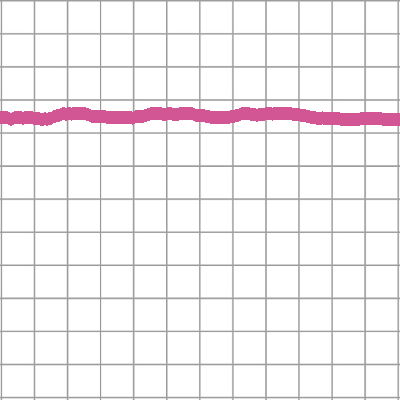

pitch77_thick1_color7_0_validation.png


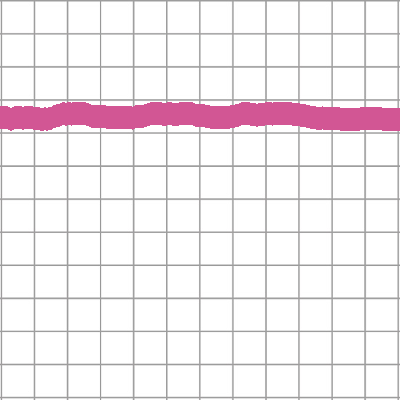

pitch77_thick2_color7_0_validation.png


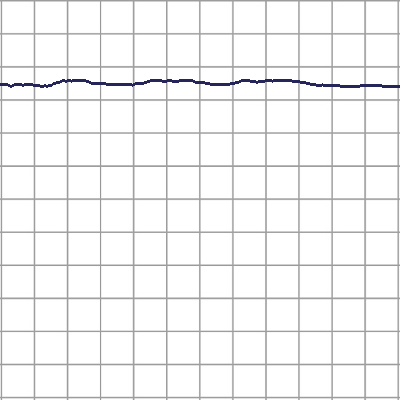

pitch78_thick0_color0_0_validation.png


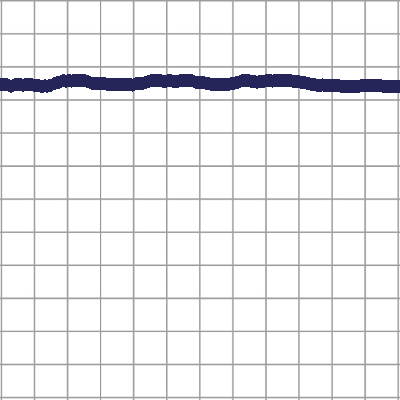

pitch78_thick1_color0_0_validation.png


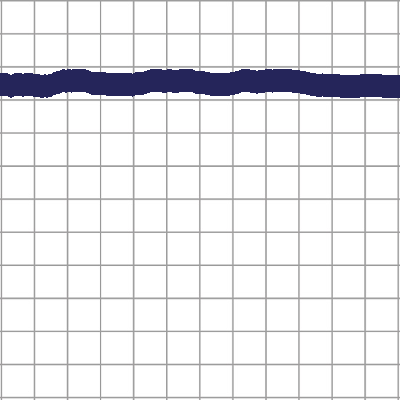

pitch78_thick2_color0_0_validation.png


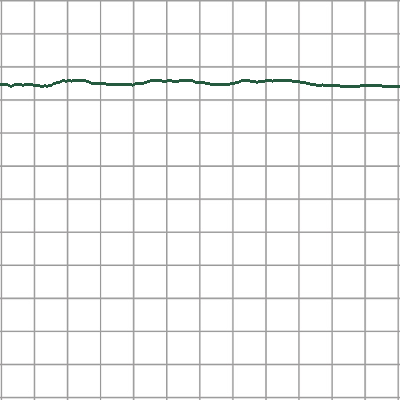

pitch78_thick0_color1_0_validation.png


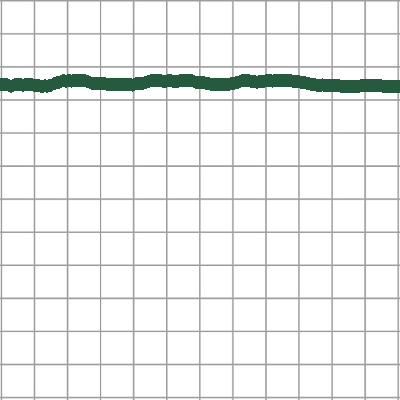

pitch78_thick1_color1_0_validation.png


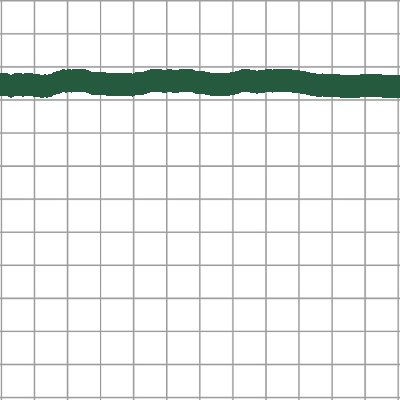

pitch78_thick2_color1_0_validation.png


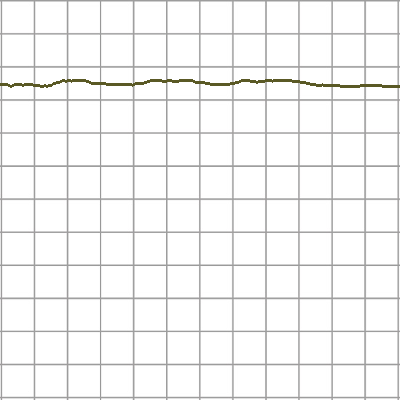

pitch78_thick0_color2_0_validation.png


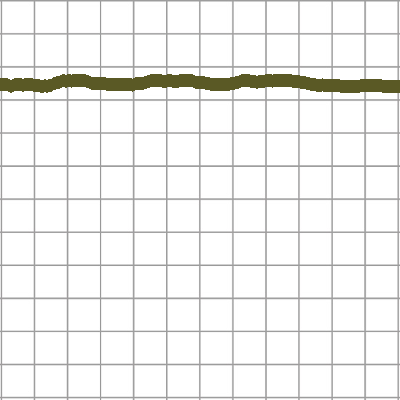

pitch78_thick1_color2_0_validation.png


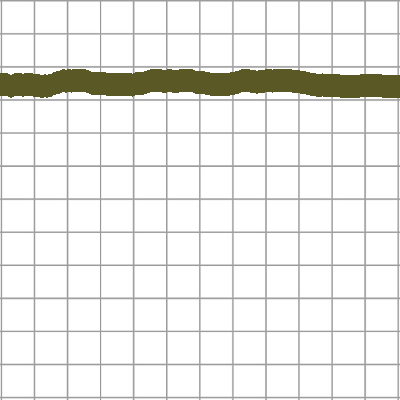

pitch78_thick2_color2_0_validation.png


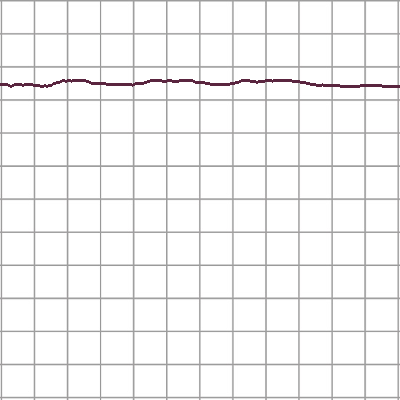

pitch78_thick0_color3_0_validation.png


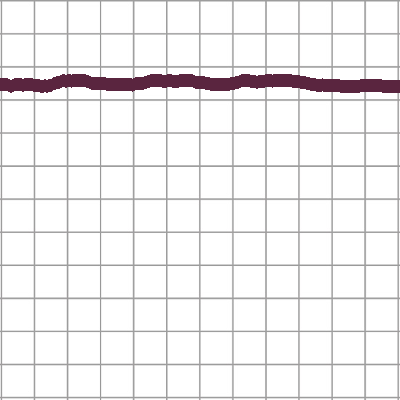

pitch78_thick1_color3_0_validation.png


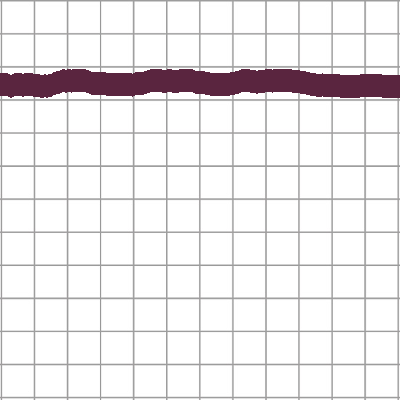

pitch78_thick2_color3_0_validation.png


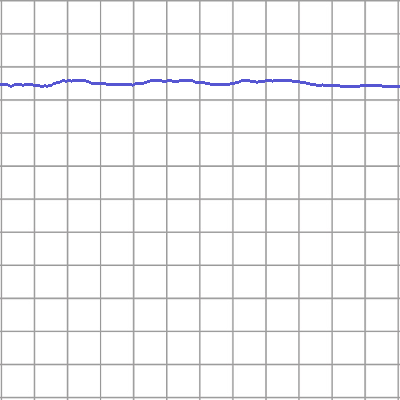

pitch78_thick0_color4_0_validation.png


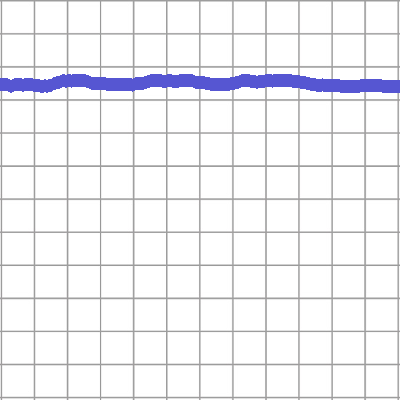

pitch78_thick1_color4_0_validation.png


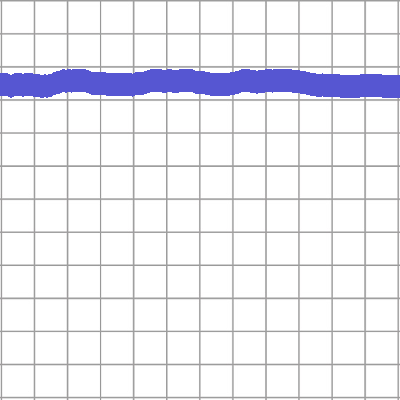

pitch78_thick2_color4_0_validation.png


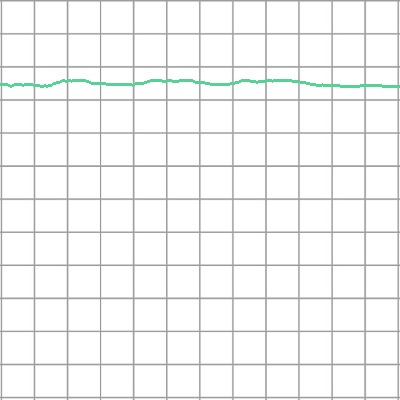

pitch78_thick0_color5_0_validation.png


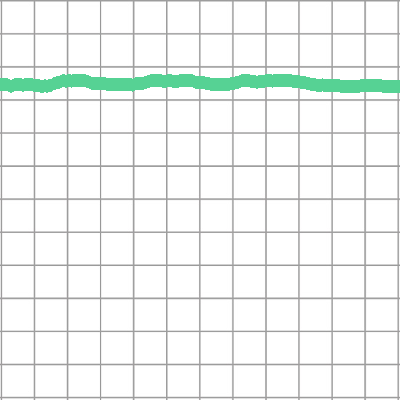

pitch78_thick1_color5_0_validation.png


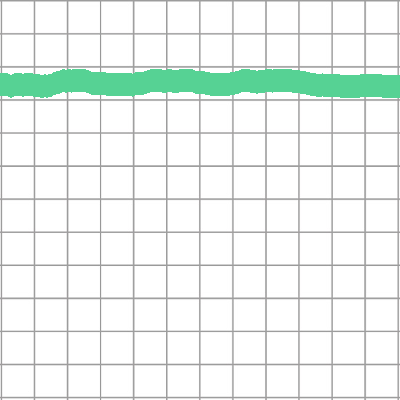

pitch78_thick2_color5_0_validation.png


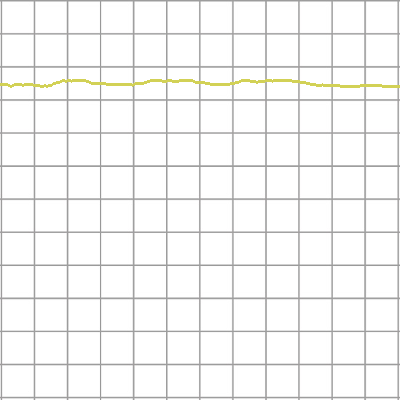

pitch78_thick0_color6_0_validation.png


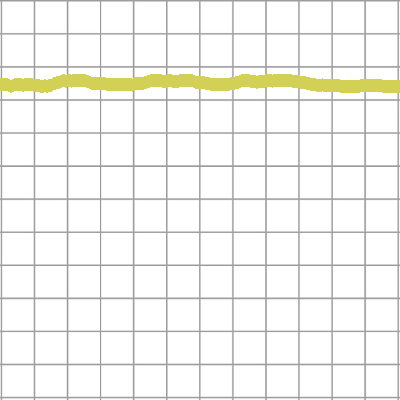

pitch78_thick1_color6_0_validation.png


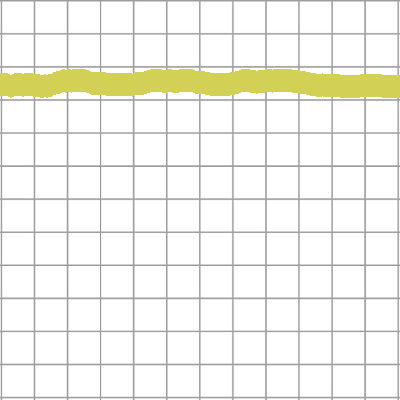

pitch78_thick2_color6_0_validation.png


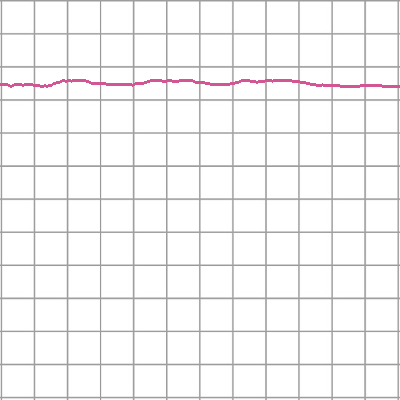

pitch78_thick0_color7_0_validation.png


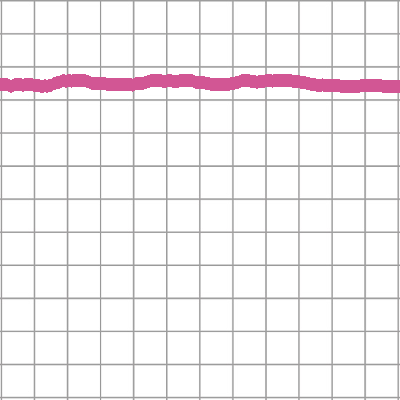

pitch78_thick1_color7_0_validation.png


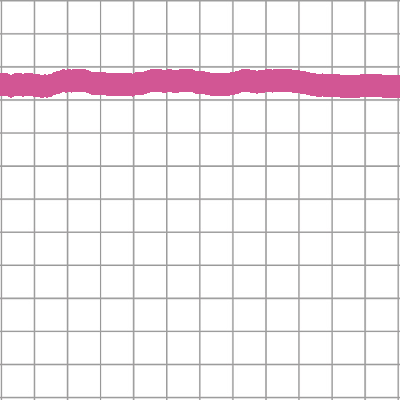

pitch78_thick2_color7_0_validation.png


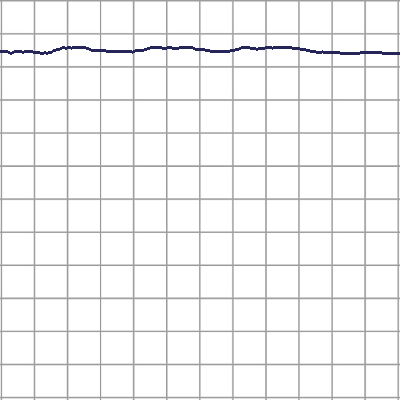

pitch79_thick0_color0_0_validation.png


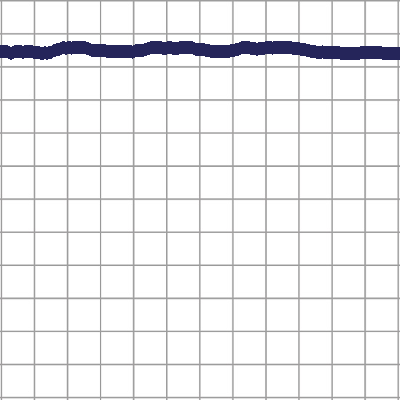

pitch79_thick1_color0_0_validation.png


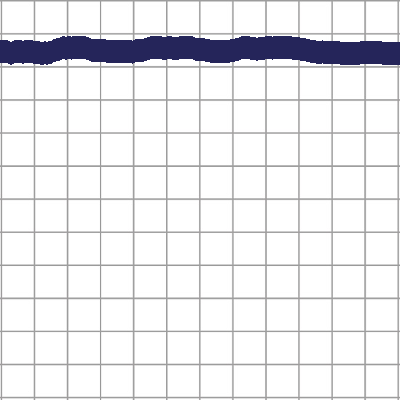

pitch79_thick2_color0_0_validation.png


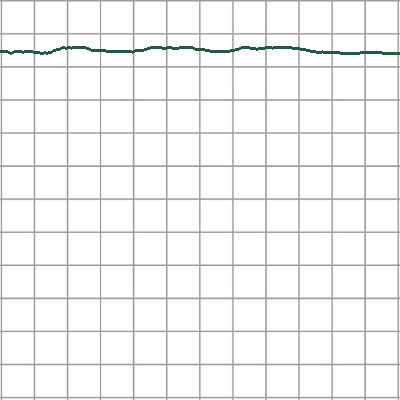

pitch79_thick0_color1_0_validation.png


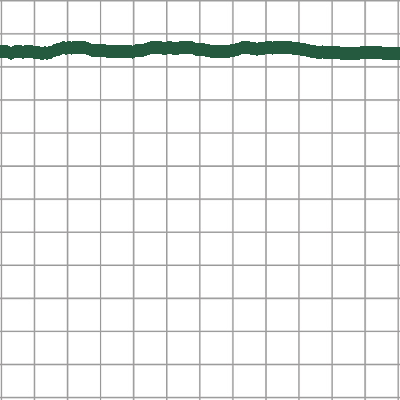

pitch79_thick1_color1_0_validation.png


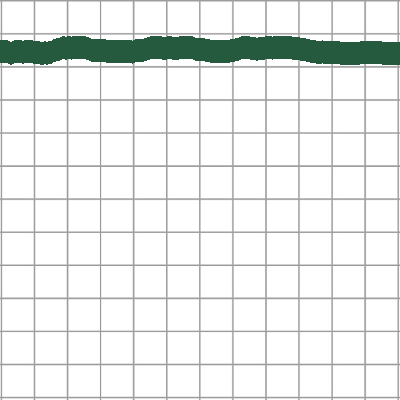

pitch79_thick2_color1_0_validation.png


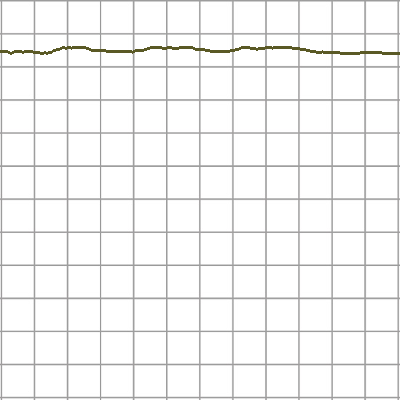

pitch79_thick0_color2_0_validation.png


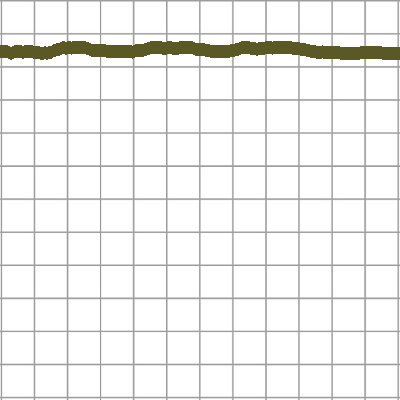

pitch79_thick1_color2_0_validation.png


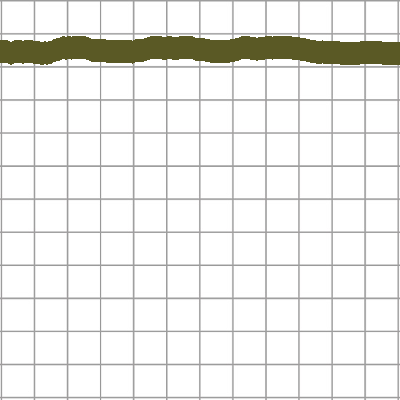

pitch79_thick2_color2_0_validation.png


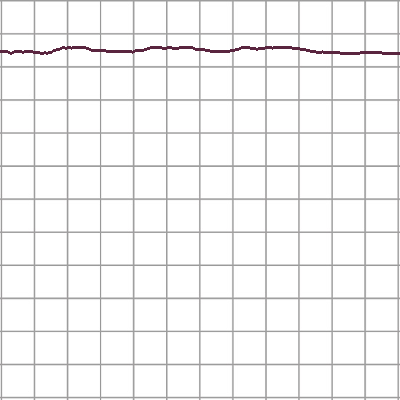

pitch79_thick0_color3_0_validation.png


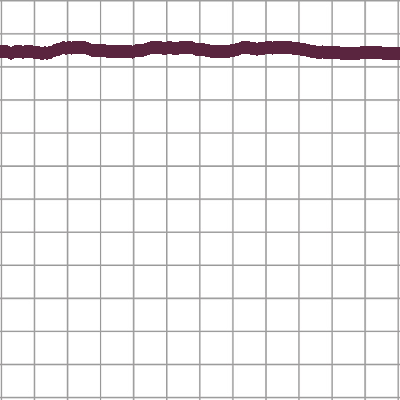

pitch79_thick1_color3_0_validation.png


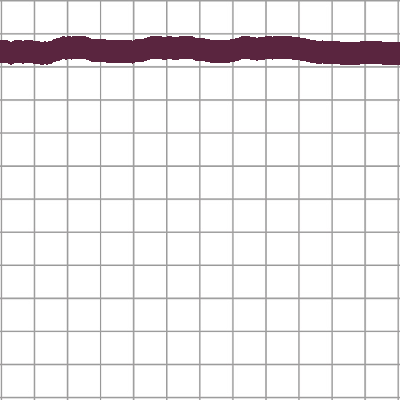

pitch79_thick2_color3_0_validation.png


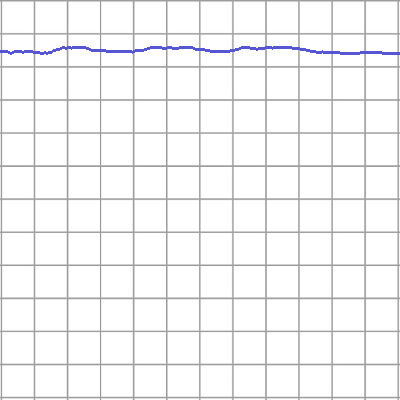

pitch79_thick0_color4_0_validation.png


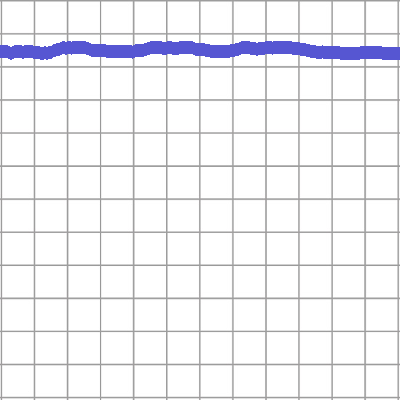

pitch79_thick1_color4_0_validation.png


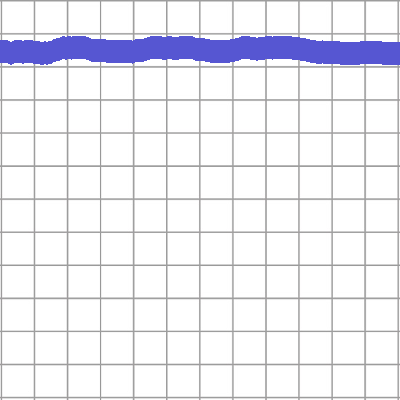

pitch79_thick2_color4_0_validation.png


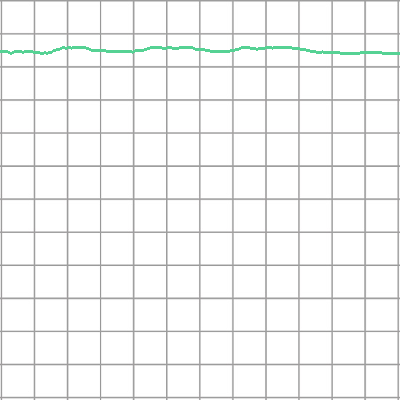

pitch79_thick0_color5_0_validation.png


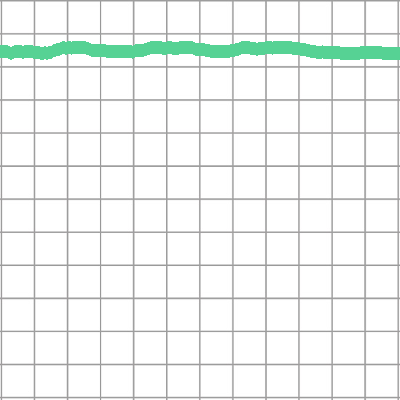

pitch79_thick1_color5_0_validation.png


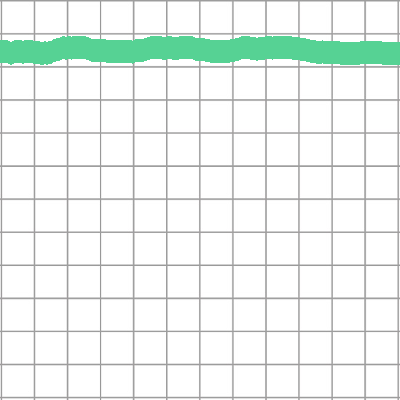

pitch79_thick2_color5_0_validation.png


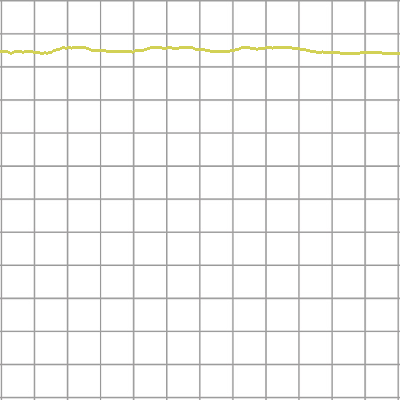

pitch79_thick0_color6_0_validation.png


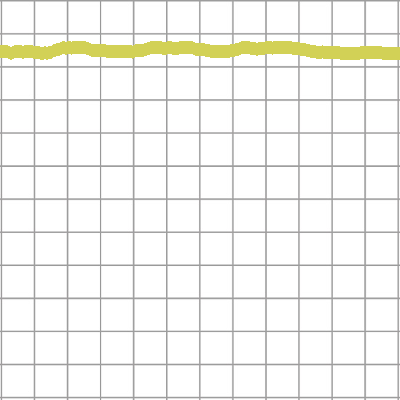

pitch79_thick1_color6_0_validation.png


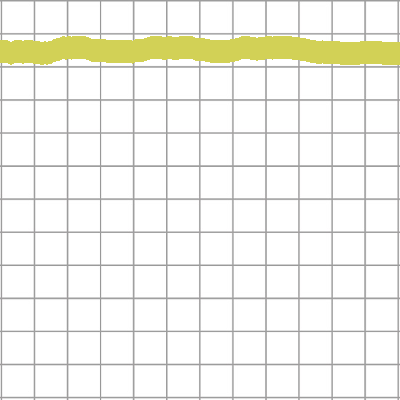

pitch79_thick2_color6_0_validation.png


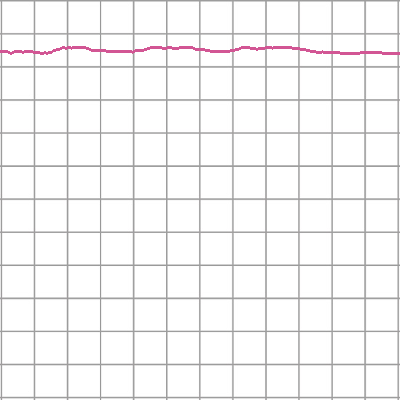

pitch79_thick0_color7_0_validation.png


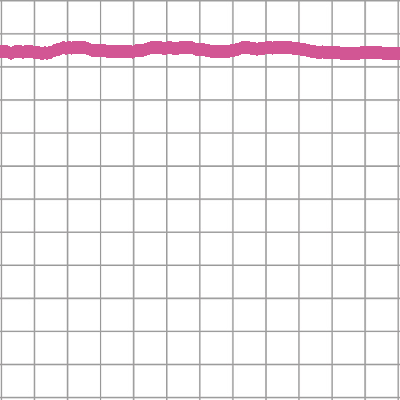

pitch79_thick1_color7_0_validation.png


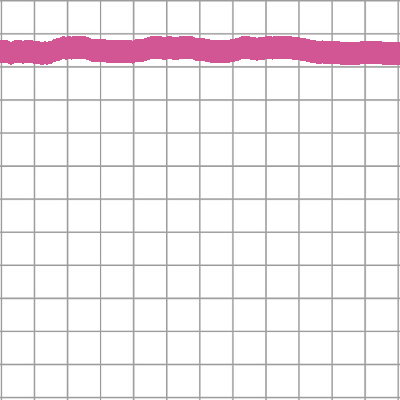

pitch79_thick2_color7_0_validation.png


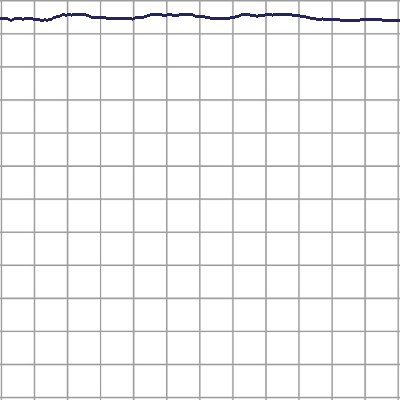

pitch80_thick0_color0_0_validation.png


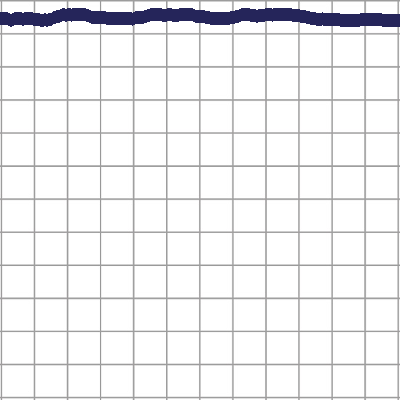

pitch80_thick1_color0_0_validation.png


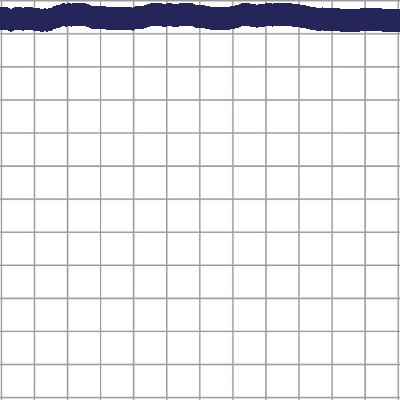

pitch80_thick2_color0_0_validation.png


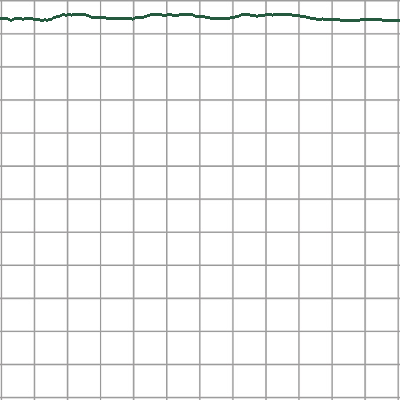

pitch80_thick0_color1_0_validation.png


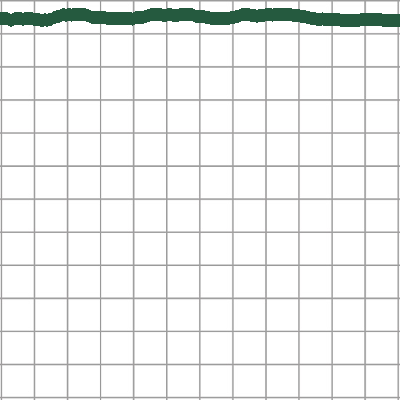

pitch80_thick1_color1_0_validation.png


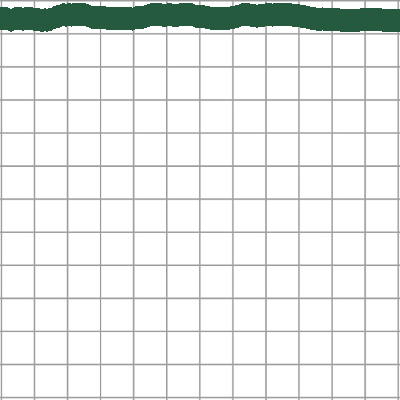

pitch80_thick2_color1_0_validation.png


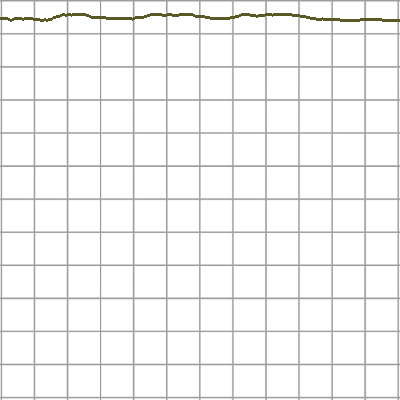

pitch80_thick0_color2_0_validation.png


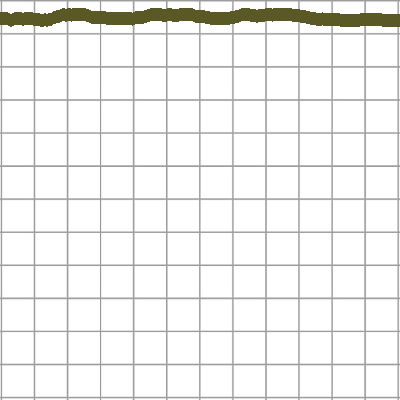

pitch80_thick1_color2_0_validation.png


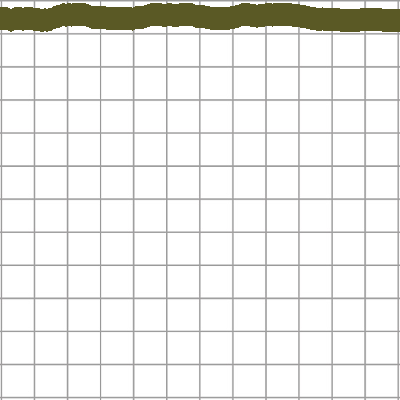

pitch80_thick2_color2_0_validation.png


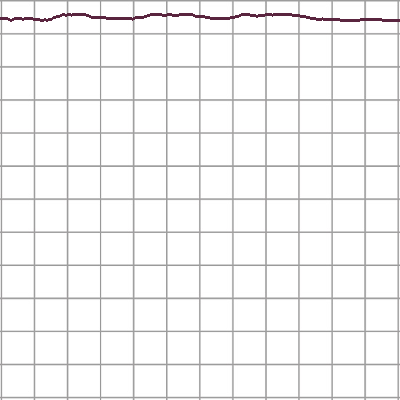

pitch80_thick0_color3_0_validation.png


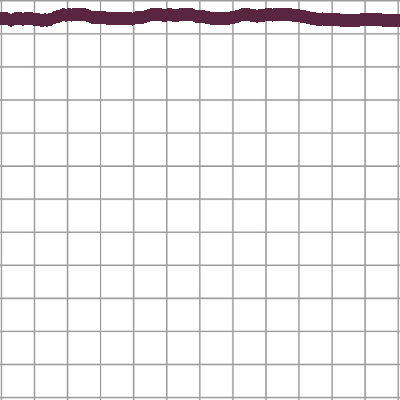

pitch80_thick1_color3_0_validation.png


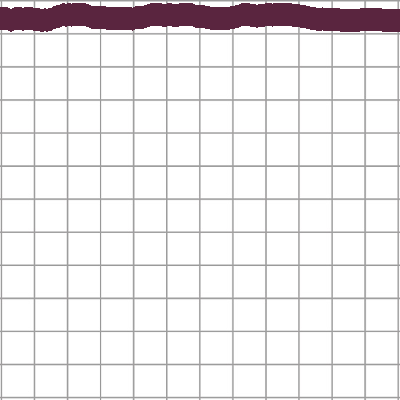

pitch80_thick2_color3_0_validation.png


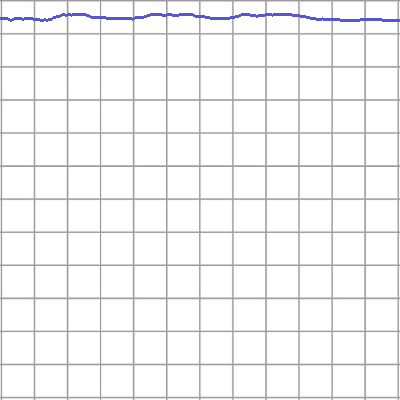

pitch80_thick0_color4_0_validation.png


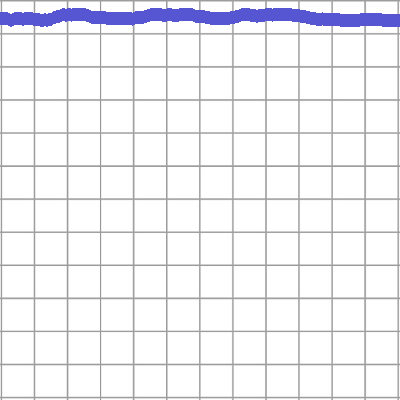

pitch80_thick1_color4_0_validation.png


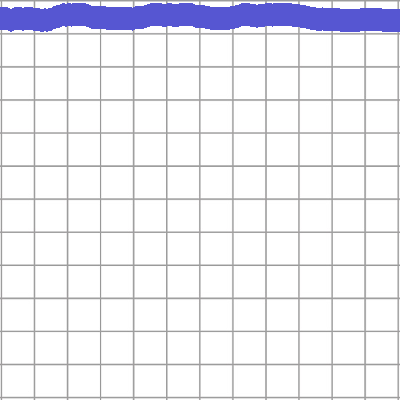

pitch80_thick2_color4_0_validation.png


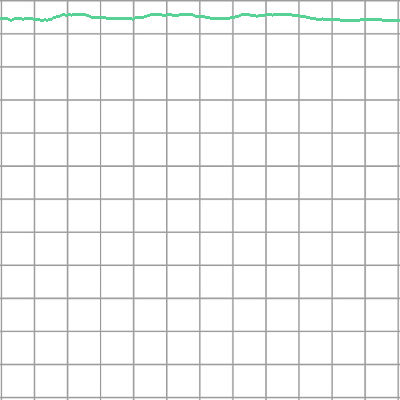

pitch80_thick0_color5_0_validation.png


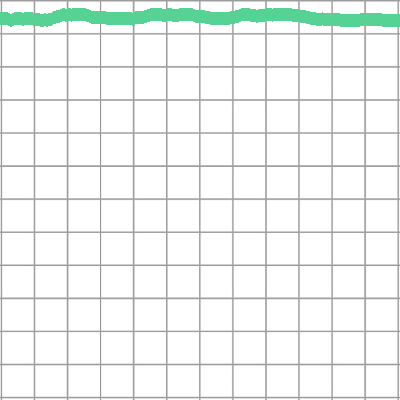

pitch80_thick1_color5_0_validation.png


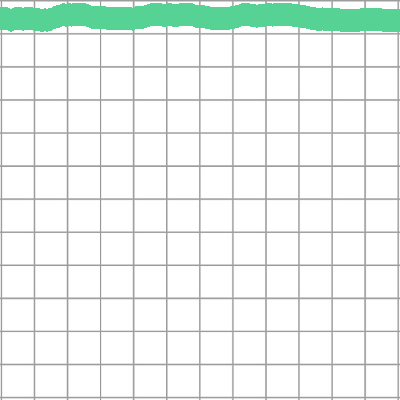

pitch80_thick2_color5_0_validation.png


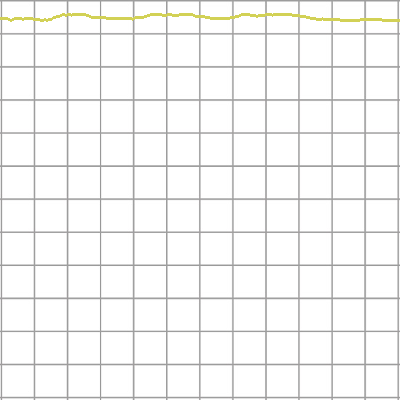

pitch80_thick0_color6_0_validation.png


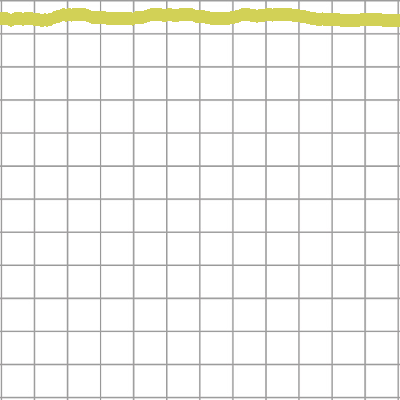

pitch80_thick1_color6_0_validation.png


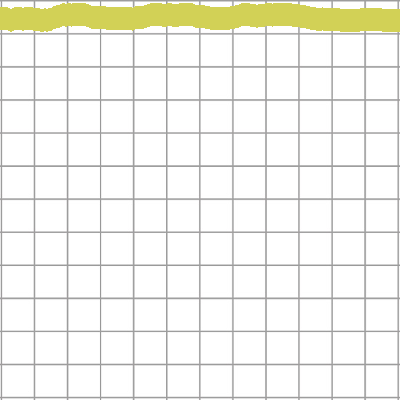

pitch80_thick2_color6_0_validation.png


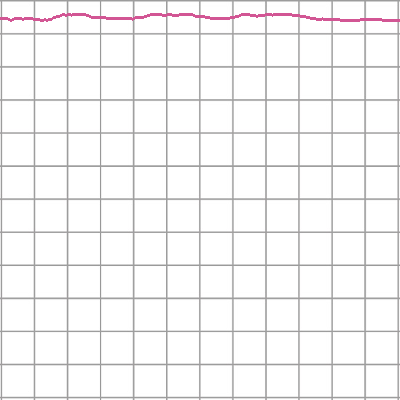

pitch80_thick0_color7_0_validation.png


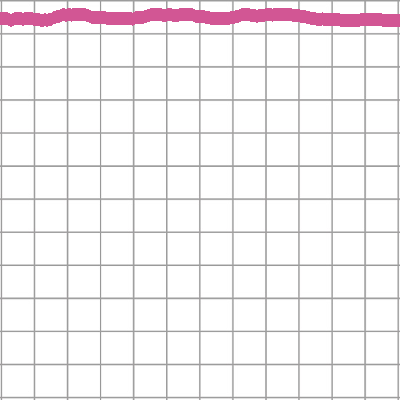

pitch80_thick1_color7_0_validation.png


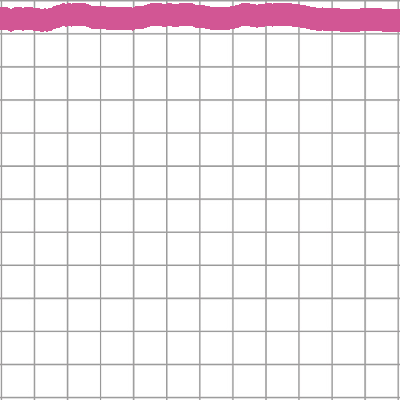

pitch80_thick2_color7_0_validation.png


In [0]:
print('[INFO] generating training dataset...')
generate_pict(NB_VERSION_TRAIN, 'train', 0, [1,1,1])
print('[INFO] generating training dataset...')
generate_pict(NB_VERSION_VALIDATION, 'validation', 0, [1,1,1])

## Loading the datas


In [0]:
## LOADING THE PICTURES

#TODO : trouver un moyen d'optimiser

imagePath_train = sorted(os.listdir( "./audiosynthesis_dl/data/pitch_img/img_train")[:])
imagePath_validation = sorted(os.listdir( "./audiosynthesis_dl/data/pitch_img/img_validation")[:])

label_train = []
label_validation = []

print('[INFO] loading training dataset...')

img_train = np.empty((0,400,400,NB_CHANNEL))
for imgP in imagePath_train :
  if imgP.split(".")[-1] != "git" and imgP.split(".")[-1] != "gitignore":
    img = image.load_img( "./audiosynthesis_dl/data/pitch_img/img_train/"+imgP, 
                             target_size=(400, 400),
                             color_mode='rgb')
    # To input our values in our network Conv2D layer, we need to reshape the 
    # datasets, i.e., pass from (60, 400, 400) to (60, 400, 400, 1) where 1 is 
    # the number of channels of our images
    img_train = np.concatenate((img_train,np.reshape(img,(1,400,400,NB_CHANNEL))),axis=0)
    l = imgP.split("_")
    labels = l[1:1+NB_CARACTERISTICS]
    label_train.append(labels)
    
print('[INFO] loading validation dataset...')
    
img_validation = np.empty((0,400,400,NB_CHANNEL))
for imgP in imagePath_validation :
  if imgP.split(".")[-1] != "git" and imgP.split(".")[-1] != "gitignore":
    img = image.load_img( "./audiosynthesis_dl/data/pitch_img/img_validation/"+imgP, 
                             target_size=(400, 400),
                             color_mode='rgb')
    img_validation = np.concatenate((img_validation,np.reshape(img,(1,400,400,NB_CHANNEL))),axis=0)
    l = imgP.split("_")
    labels = l[1:1+NB_CARACTERISTICS]
    label_validation.append(labels)

print(label_validation)
print('img_train.shape=', img_train.shape)
print('img_validation.shape=', img_validation.shape)

[INFO] loading training dataset...
[INFO] loading validation dataset...
[['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick1'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick2'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['thick0'], ['t

In [0]:
## CONVERTING THE DATA

def converting_data(img_tab) :
  """ convert the data in float between 0 et 1"""
  # Convert to float
  img_tab = img_tab.astype('float32')
  # Normalize inputs from [0; 255] to [0; 1]
  imgnorm_tab = img_tab / 255

  return imgnorm_tab

In [0]:
## MIXING THE DATA FOR A GOOD LEARNING
def shuffle_data(img_tab, label_tab, nb_pict) :
  """ create shuffled tabs of data and corresponding labels """
  imgnorm_tab = converting_data(img_tab)
  print(imgnorm_tab.shape)
    
  xy_tab = []
  for i in range(nb_pict):
    label_tab_i = []
    thick = int(label_tab[i][0].split('thick')[1]) #labels are converted into integer between 0 and the number of classes
    label_tab_i.append(thick)
    
    xy = [imgnorm_tab[i],label_tab_i]
    xy_tab.append(xy)
  
  random.shuffle(xy_tab)
  
  x_tab = np.empty((nb_pict,400,400,NB_CHANNEL))
  y_tab = np.empty((nb_pict, NB_CARACTERISTICS))
  
  for i in range(nb_pict):
    x_tab[i] = xy_tab[i][0]
    y_tab[i] = xy_tab[i][1]
  
  del imgnorm_tab
  del xy_tab
  
  return [x_tab,y_tab]

In [0]:
x_train = np.copy(img_train)
x_validation = np.copy(img_validation)
y_train = np.copy((label_train,NB_CARACTERISTICS))
y_validation = np.copy((label_validation,NB_CARACTERISTICS))

print('[INFO] shuffle datasets...')
[x_train, y_train] = shuffle_data(img_train, label_train, NB_TRAIN)
[x_validation, y_validation] = shuffle_data(img_validation, label_validation, NB_VALIDATION)

print('x_train.shape=', x_train.shape)
print('x_validation.shape=', x_validation.shape)


print('y_train.shape=', y_train.shape)
print('y_validation.shape=', y_validation.shape)
print(y_validation)

del img_train
del img_validation
del label_train
del label_validation


[INFO] shuffle datasets...
(576, 400, 400, 3)
(288, 400, 400, 3)
x_train.shape= (576, 400, 400, 3)
x_validation.shape= (288, 400, 400, 3)
y_train.shape= (576, 1)
y_validation.shape= (288, 1)
[[2.]
 [0.]
 [2.]
 [1.]
 [0.]
 [2.]
 [2.]
 [1.]
 [0.]
 [1.]
 [0.]
 [0.]
 [1.]
 [0.]
 [0.]
 [1.]
 [1.]
 [1.]
 [1.]
 [0.]
 [0.]
 [1.]
 [0.]
 [0.]
 [1.]
 [1.]
 [2.]
 [2.]
 [0.]
 [1.]
 [1.]
 [0.]
 [0.]
 [1.]
 [0.]
 [0.]
 [1.]
 [2.]
 [1.]
 [1.]
 [2.]
 [2.]
 [1.]
 [2.]
 [1.]
 [1.]
 [1.]
 [2.]
 [1.]
 [0.]
 [0.]
 [0.]
 [2.]
 [0.]
 [2.]
 [1.]
 [0.]
 [2.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [2.]
 [0.]
 [0.]
 [2.]
 [0.]
 [2.]
 [2.]
 [0.]
 [1.]
 [2.]
 [2.]
 [1.]
 [2.]
 [2.]
 [0.]
 [0.]
 [1.]
 [0.]
 [0.]
 [2.]
 [2.]
 [1.]
 [1.]
 [2.]
 [1.]
 [1.]
 [0.]
 [2.]
 [1.]
 [2.]
 [1.]
 [2.]
 [0.]
 [2.]
 [0.]
 [0.]
 [1.]
 [0.]
 [0.]
 [2.]
 [1.]
 [2.]
 [0.]
 [0.]
 [2.]
 [2.]
 [1.]
 [1.]
 [2.]
 [2.]
 [2.]
 [0.]
 [2.]
 [0.]
 [1.]
 [2.]
 [2.]
 [1.]
 [2.]
 [0.]
 [0.]
 [0.]
 [2.]
 [1.]
 [2.]
 [0.]
 [0.]
 [0.]
 [2.]

In [0]:
## GENERATION OF THE COLOR FEATURES TABS

def gen_features_tabs(y_tab, y_feature, i_feature) :
  ''' generate a tab containing the labels for one specific feature '''
  for i in range(len(y_tab)) :
    y_feature[i] = y_tab[i][i_feature]

In [0]:
y_train_thick = np.empty(NB_TRAIN)
y_validation_thick = np.empty(NB_VALIDATION)
gen_features_tabs(y_train, y_train_thick, 0)
gen_features_tabs(y_validation, y_validation_thick, 0)

print('[INFO] generating color label tabs...')
print('y_train_color.shape=', y_train_thick.shape)
print('y_validation_color.shape=', y_validation_thick.shape)

print(y_validation_thick)

[INFO] generating color label tabs...
y_train_color.shape= (576,)
y_validation_color.shape= (288,)
[2. 0. 2. 1. 0. 2. 2. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0.
 1. 1. 2. 2. 0. 1. 1. 0. 0. 1. 0. 0. 1. 2. 1. 1. 2. 2. 1. 2. 1. 1. 1. 2.
 1. 0. 0. 0. 2. 0. 2. 1. 0. 2. 1. 1. 1. 1. 1. 1. 1. 1. 2. 0. 0. 2. 0. 2.
 2. 0. 1. 2. 2. 1. 2. 2. 0. 0. 1. 0. 0. 2. 2. 1. 1. 2. 1. 1. 0. 2. 1. 2.
 1. 2. 0. 2. 0. 0. 1. 0. 0. 2. 1. 2. 0. 0. 2. 2. 1. 1. 2. 2. 2. 0. 2. 0.
 1. 2. 2. 1. 2. 0. 0. 0. 2. 1. 2. 0. 0. 0. 2. 1. 0. 2. 2. 2. 1. 1. 0. 0.
 1. 1. 1. 2. 0. 2. 2. 2. 1. 2. 0. 0. 0. 0. 1. 0. 0. 1. 1. 2. 1. 0. 1. 1.
 1. 0. 0. 2. 0. 1. 2. 1. 0. 2. 2. 2. 2. 0. 1. 1. 2. 1. 0. 0. 2. 2. 0. 0.
 1. 2. 1. 2. 2. 0. 1. 2. 0. 2. 1. 1. 0. 1. 0. 1. 2. 2. 2. 0. 0. 0. 2. 0.
 0. 1. 1. 1. 2. 2. 1. 0. 0. 0. 1. 2. 1. 0. 1. 2. 1. 0. 2. 0. 1. 0. 0. 0.
 2. 2. 0. 0. 2. 1. 2. 0. 2. 1. 2. 2. 1. 2. 1. 1. 1. 0. 1. 2. 2. 0. 1. 2.
 0. 1. 1. 0. 2. 2. 0. 2. 0. 0. 2. 1. 1. 2. 0. 2. 2. 0. 1. 2. 2. 2. 1. 0.]


In [0]:
# Convert class vectors to binary class matrices ("one hot encoding")
y_train_thick = keras.utils.to_categorical(y_train_thick, NB_CLASS)
y_validation_thick = keras.utils.to_categorical(y_validation_thick, NB_CLASS)

## The Convolutional Neural Network

Now we need to create and compile the CNN that will classify our datas.

In [0]:
## CREATION OF THE NEURAL NETWORK


model_thick = Sequential()

model_thick.add(Conv2D(filters=32, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_thick.add(BatchNormalization(axis=-1))
model_thick.add(MaxPooling2D(pool_size=(3,3), strides=None, padding='valid', data_format=None))
              
# (CONV => RELU) * 2 => POOL
model_thick.add(Conv2D(filters=64, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_thick.add(BatchNormalization(axis=-1))
model_thick.add(MaxPooling2D(pool_size=(2,2), strides=None, padding='valid', data_format=None))

# (CONV => RELU) * 3 => POOL
model_thick.add(Conv2D(filters=128, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_thick.add(BatchNormalization(axis=-1))
model_thick.add(Dropout(rate=0.75))


# first (and only) set of FC => RELU layers
model_thick.add(Flatten())
model_thick.add(Dense(64))
model_thick.add(Activation("relu"))
model_thick.add(BatchNormalization())
 
# use a *sigmoid* activation for multi-label classification
model_thick.add(Dense(NB_CLASS))
model_thick.add(Activation('softmax'))  

opt = keras.optimizers.Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
model_thick.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
cb = callbacks.ModelCheckpoint('model_thick.h5', save_best_only=True, period=1)

hist_thick = model_thick.fit(x_train, y_train_thick, validation_data=(x_validation, y_validation_thick), epochs= 100, batch_size=32, callbacks = [cb])
loss_and_metrics_thick = model_thick.evaluate(x_validation, y_validation_thick, batch_size=32)
print('loss =', loss_and_metrics_thick[0],'accuracy =', loss_and_metrics_thick[1]);

model_thick.summary();

Train on 576 samples, validate on 288 samples
Epoch 1/100
576/576 [==============================] - 9s 16ms/step - loss: 0.5441 - acc: 0.7934 - val_loss: 0.0962 - val_acc: 0.9722
Epoch 2/100
576/576 [==============================] - 7s 12ms/step - loss: 0.0460 - acc: 1.0000 - val_loss: 0.0224 - val_acc: 1.0000
Epoch 3/100
576/576 [==============================] - 7s 12ms/step - loss: 0.0231 - acc: 1.0000 - val_loss: 0.0179 - val_acc: 1.0000
Epoch 4/100
576/576 [==============================] - 7s 12ms/step - loss: 0.0140 - acc: 1.0000 - val_loss: 0.0162 - val_acc: 1.0000
Epoch 5/100
576/576 [==============================] - 7s 12ms/step - loss: 0.0150 - acc: 1.0000 - val_loss: 0.0177 - val_acc: 1.0000
Epoch 6/100
576/576 [==============================] - 7s 12ms/step - loss: 0.0088 - acc: 1.0000 - val_loss: 0.0146 - val_acc: 1.0000
Epoch 7/100
576/576 [==============================] - 7s 12ms/step - loss: 0.0097 - acc: 1.0000 - val_loss: 0.0134 - val_acc: 1.0000
Epoch 8/100
576/

## Results

Only thickness (3) :
*  data : 1x1x3x200 (train) +1x1x3x100 (validation) 
* 2D(34)+MaxPool+2D(64)+MaxPool+2D(128)+MaxPool+Dropout(0.75)+Dense(64)+Dense(8) opt = adam default
* epoch=100 batch=32 :
* loss = 0.003424074562887351 acc = 1.0, val_accuracy 1.0 very sharply

## Graphics


In [0]:
import matplotlib
import matplotlib.pyplot as plt

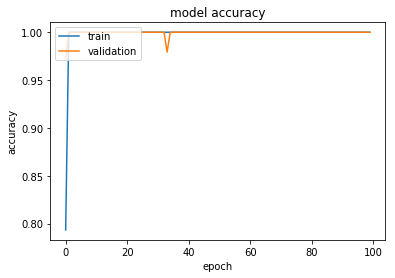

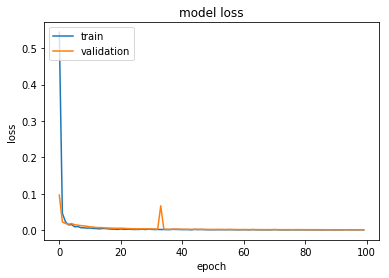

In [0]:
# summarize history for accuracy
plt.plot(hist_thick.history['acc'])
plt.plot(hist_thick.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(hist_thick.history['loss'])
plt.plot(hist_thick.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()


## Test

In [0]:
def test_accuracy(y_tab, y_guessed):
  accuracy_sum = 0
  for i in range(len(y_tab)) :
    if(y_tab[i] == y_guessed[i]):
      accuracy_sum += 1
  accuracy = accuracy_sum / len(y_tab)
  print('accuracy = ', accuracy)
  

In [0]:
NB_VERSION_TESTGEN = 1
NB_TESTGEN = NB_COLOR*NB_PITCH*NB_THICK*NB_VERSION_TESTGEN

print("[INFO] generating testgen dataset...")
generate_pict(NB_VERSION_TESTGEN, 'testgen',0, [1,1,1])

In [0]:
label_testgen = []

print("[INFO] loading the testgen dataset...")
img_testgen = np.empty((0,400,400,NB_CHANNEL))
for imgP in sorted(os.listdir( "./audiosynthesis_dl/data/pitch_img/img_testgen")[:]) :
  if imgP.split(".")[-1] != "git" and imgP.split(".")[-1] != "gitignore":
    img = image.load_img( "./audiosynthesis_dl/data/pitch_img/img_testgen/"+imgP, 
                             target_size=(400, 400),
                             color_mode='rgb')
    img_testgen = np.concatenate((img_testgen,np.reshape(img,(1,400,400,NB_CHANNEL))),axis=0)
    l = imgP.split("_")
    labels = l[1:1+NB_CARACTERISTICS]
    label_testgen.append(labels)


x_testgen = np.copy(img_testgen)
y_testgenstat = np.copy((label_testgen,NB_CARACTERISTICS))


[INFO] loading the testgen dataset...


In [0]:
print("[INFO] shuffle testgen dataset...")
[x_testgen, y_testgenstat] = shuffle_data(img_testgen, label_testgen, NB_TESTGEN)  

# load the trained convolutional neural network and the multi-label binarizer
print("[INFO] loading network...")
model = load_model('model_thick.h5')

y_testgen = model_thick.predict_classes(x_testgen)

print('x_testgen.shape=', x_testgen.shape)
print('y_testgenstat.shape=', y_testgenstat.shape)

# show the inputs and predicted outputs
for i in range(len(y_testgen)):
  print("label y_testgen[%s] = %s" % (i, y_testgen[i]))
  
test_accuracy(y_testgenstat, y_testgen)
  

[INFO] shuffle testgen dataset...
(288, 400, 400, 3)
x_testgen.shape= (288, 400, 400, 3)
y_testgenstat.shape= (288, 1)
label y_testgen[0] = 1
label y_testgen[1] = 1
label y_testgen[2] = 1
label y_testgen[3] = 2
label y_testgen[4] = 0
label y_testgen[5] = 1
label y_testgen[6] = 0
label y_testgen[7] = 2
label y_testgen[8] = 0
label y_testgen[9] = 2
label y_testgen[10] = 0
label y_testgen[11] = 0
label y_testgen[12] = 1
label y_testgen[13] = 0
label y_testgen[14] = 1
label y_testgen[15] = 2
label y_testgen[16] = 2
label y_testgen[17] = 1
label y_testgen[18] = 0
label y_testgen[19] = 2
label y_testgen[20] = 2
label y_testgen[21] = 0
label y_testgen[22] = 0
label y_testgen[23] = 2
label y_testgen[24] = 2
label y_testgen[25] = 1
label y_testgen[26] = 1
label y_testgen[27] = 2
label y_testgen[28] = 1
label y_testgen[29] = 0
label y_testgen[30] = 1
label y_testgen[31] = 1
label y_testgen[32] = 1
label y_testgen[33] = 0
label y_testgen[34] = 0
label y_testgen[35] = 1
label y_testgen[36] = 1
lab

In [0]:
i = 3;
print('x_testgen.shape', x_testgen.shape, 'dtype', x_testgen.dtype)
print('y_testgen[{}]={}'.format(i, y_testgen[i]))
print('y_testgenstat[{}]={}'.format(i, y_testgenstat[i]))
plt.imshow(x_testgen[i,:].reshape(400,400,NB_CHANNEL), cmap = matplotlib.cm.binary)
plt.axis("off")
plt.show()
plt.gcf().clear()

## Sound synthesis according to the labelisation

full independant code here : https://colab.research.google.com/drive/1KzM-NMSlj87XU_--cifmipAuYd57zZc4


In [0]:
import math as m
import IPython

In [0]:
volume = 0.5     # range [0.0, 1.0]
fs = 44100       # sampling rate, Hz, must be integer
duration = 4.0   # in seconds, may be float
f0 = 440.0        # sine frequency, Hz, may be float
label = 0 # default value, take the one given by the neural network

In [0]:
def sinusoid(label, duration) :
  """ generate an audio of a sinusoid """
  samples = []
  fm  =  (2**(0/12))*f0
  # generate samples
  for i in range(int(fs*duration)) :
    t = i/fs # seconds
    a = 2*m.pi*fm*t # radians
    v = (label+1/NB_THICK)*m.sin(a)
    samples.append(v)
  return samples


In [0]:
i = 1
label_i = y_testgen[i]

# TODO : gérer le volume qui est normalisé avec display.Audio

sin = sinusoid(label_i, duration)
IPython.display.Audio(sin, rate=fs)

## Tests with VGG16

code here :
https://colab.research.google.com/drive/1YG-4crZ56U0_Idz4r5Mu04R5zzrM5-1L